In [237]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['hatch.color']='g'
import xarray as xr
from misc.jupyter import end_interactive
from scipy.stats import ttest_1samp
import matplotlib.ticker as mticker
import pandas as pd

from datetime import datetime, timedelta
from urllib.request import urlopen

import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
#from metpy.units import masked_array, units

from netCDF4 import Dataset

#from geoplots import mapplot, xticksyear, xticksmonth, yticks2lat
#import geoxarray
plt.rcParams['figure.dpi'] = 300

In [2]:
land = xr.open_dataset('/tigress/tessj/data/land_mask.FLOR.atmos_month.nc')
land_mask = land.land_mask.rename({'grid_yt':'lat','grid_xt':'lon'}).squeeze(drop=True)

In [3]:
def shift_longitude(da):
    return da.roll(lon=da.lon.size//2).pipe(lambda x: x.assign_coords(lon=x.lon.where(x.lon<180, other=x.lon-360)))


In [2]:
plt.figure(figsize=(5,5))
box_x = [-19.75, 10, 10, -19.75, -19.75]
box_y = [10, 10, 20, 20, 10]

ax1=plt.subplot(1,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
plt.plot(box_x, box_y, color='red', label='Sahel region')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.legend()
#plt.savefig('sahel.png')


NameError: name 'plt' is not defined

In [2]:
#%matplotlib notebook

In [4]:
#get data as dataarray

pinatubo = xr.open_dataarray('/tigress/wenchang/analysis/volcanic_impact/data/Pinatubo_PI_ens_noleap.atmos_month.precip.nc/') 
stmaria = xr.open_dataarray('/tigress/wenchang/analysis/volcanic_impact/data/StMaria_PI_ens_noleap.atmos_month.precip.nc/') 
agung = xr.open_dataarray('/tigress/wenchang/analysis/volcanic_impact/data/Agung_PI_ens_noleap.atmos_month.precip.nc/') 
ctl = xr.open_dataarray('/tigress/wenchang/analysis/volcanic_impact/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.precip.nc/') 

In [50]:
ctl_p_all = scale_factor*xr.open_dataarray('/tigress/wenchang/analysis/volcanic_impact/data/precip.CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.0101_0300.nc')
ctl_p_all = ctl_p_all.rename({'grid_yt':'lat','grid_xt':'lon'}).squeeze(drop=True)

# Precipitation anomaly

In [6]:
# scale precip from km/year to mm/day
# get precip anomaly
scale_factor = 3600*24


## Pinatubo

In [7]:
# avg time and ensembles, plot PINATUBO precip anomaly
da_ctl = ctl * scale_factor
da_pinatubo = pinatubo * scale_factor
#time average of (5 year, all ensembles)
da = da_pinatubo.mean('time') - da_ctl.mean('time')

In [19]:
#da.where(land_mask>0.9)

### Global precip anomaly

Text(0.5, 0.98, 'Pinatubo precip anomaly')

/tigress/wenchang/miniconda3p7/lib/python3.7/site-packages/cartopy/io/__init__.py:260: DownloadWarning: Downloading: http://naciscdn.org/naturalearth/110m/physical/ne_110m_land.zip
  warnings.warn('Downloading: {}'.format(url), DownloadWarning)
/tigress/wenchang/miniconda3p7/lib/python3.7/site-packages/cartopy/io/__init__.py:260: DownloadWarning: Downloading: http://naciscdn.org/naturalearth/110m/physical/ne_110m_coastline.zip
  warnings.warn('Downloading: {}'.format(url), DownloadWarning)


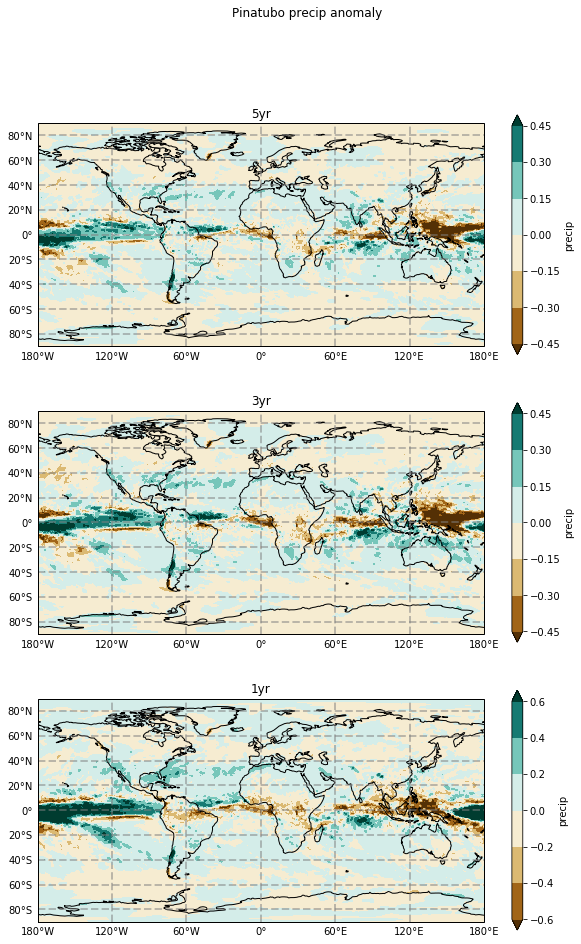

In [7]:
'''#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_pinatubo3 = da_pinatubo[:,5:41]
da3 = da_pinatubo3.mean('time') - da_ctl.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_pinatubo1 = da_pinatubo[:,5:17]
da1 = da_pinatubo1.mean('time') - da_ctl.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('Pinatubo precip anomaly')

#
'''

Text(0.5, 1.0, 'Pinatubo')

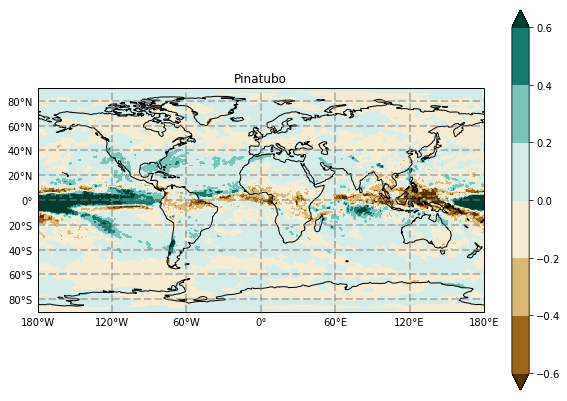

In [14]:
plt.figure(figsize=(10,7))
ax1=plt.subplot(1,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75') 
ax1.coastlines()
plt.title('Pinatubo')
#plt.savefig('global5yr_pinatubo.png')

### Sahel Precip anomaly

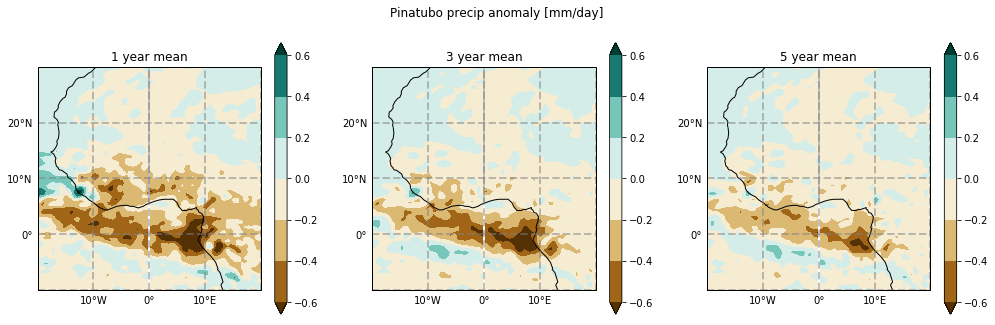

In [221]:
#using cartopy, local

plt.figure(figsize=(17,5))

ax1=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.6, vmax=0.6,add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5 year mean')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
da_pinatubo3 = da_pinatubo[:,5:41]
da = da_pinatubo3.mean('time') - da_ctl.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.6, vmax=0.6,add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3 year mean')

ax3=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
da_pinatubo1 = da_pinatubo[:,5:17]
da = da_pinatubo1.mean('time') - da_ctl.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6,add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1 year mean')

plt.suptitle('Pinatubo precip anomaly [mm/day]')
#plt.savefig('pinatubo_sahel.png')
#


### Time series (Sahel) 

/tigress/wenchang/miniconda3p7/lib/python3.7/site-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


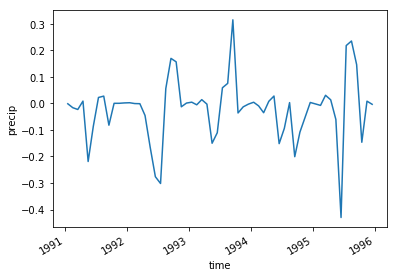

In [5]:
da_ctl['time']=da_pinatubo['time']
da_ctl_s = da_ctl.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

# select sahel region
da_p_s = da_pinatubo.mean('en').isel(lon=(da_pinatubo.lon<=10)|(da_pinatubo.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_p_s = da_p_s - da_ctl_s
da_p_s.plot()
#

### Monthly climatology (Sahel)

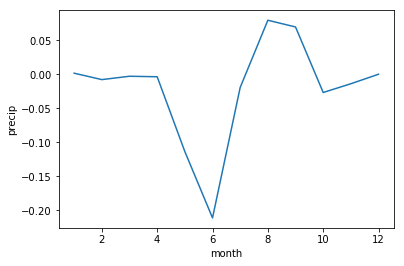

In [6]:

p_clim = da_p_s[11:].groupby('time.month').mean('time')
da_p_s.groupby('time.month').mean('time').plot()
#

## Santa Maria

In [8]:
# avg time and ensembles, plot SANTA MARIA precip anomaly
da_stmaria = stmaria * scale_factor
da = da_stmaria.mean('time') - da_ctl.mean('time')

### Global precip anomaly

Text(0.5,0.98,'Santa Maria precip anomaly')

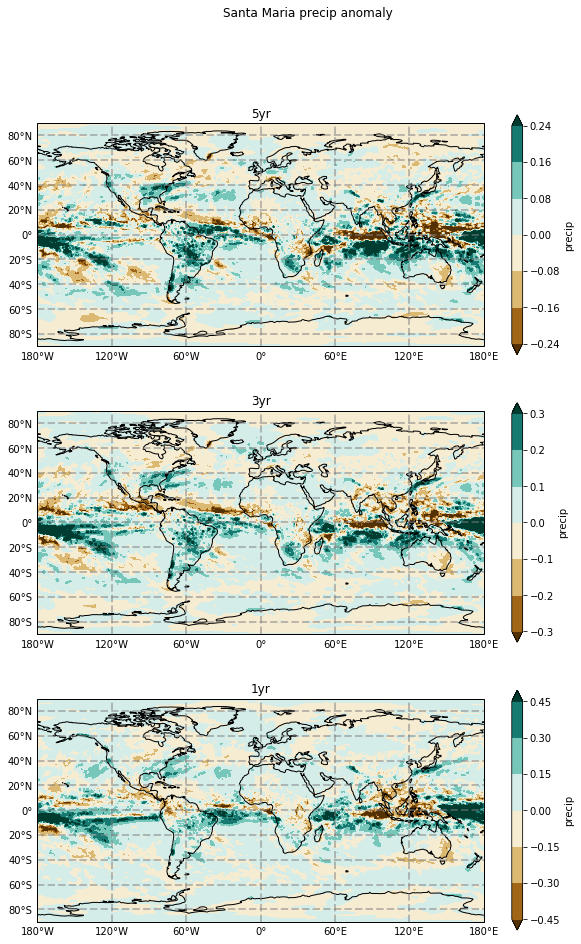

In [148]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_stmaria3 = da_stmaria[:,5:41]
da3 = da_stmaria3.mean('time') - da_ctl.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_stmaria1 = da_stmaria[:,5:17]
da1 = da_stmaria1.mean('time') - da_ctl.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('Santa Maria precip anomaly')

#


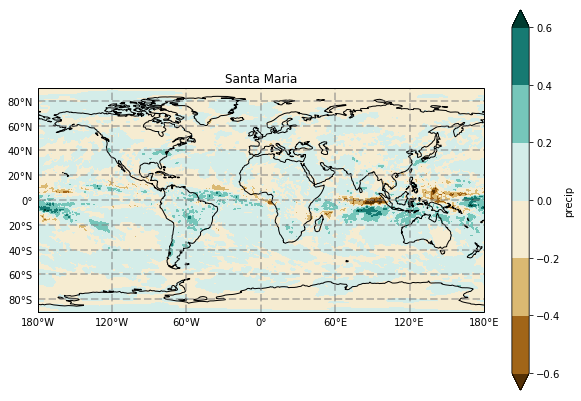

In [29]:
plt.figure(figsize=(10,7))
ax1=plt.subplot(1,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da.mean('en').plot.contourf(robust=True, vmin=-0.6, vmax=0.6,cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Santa Maria')
#plt.savefig('global5yr_stmaria.png')

### Sahel precip anomaly

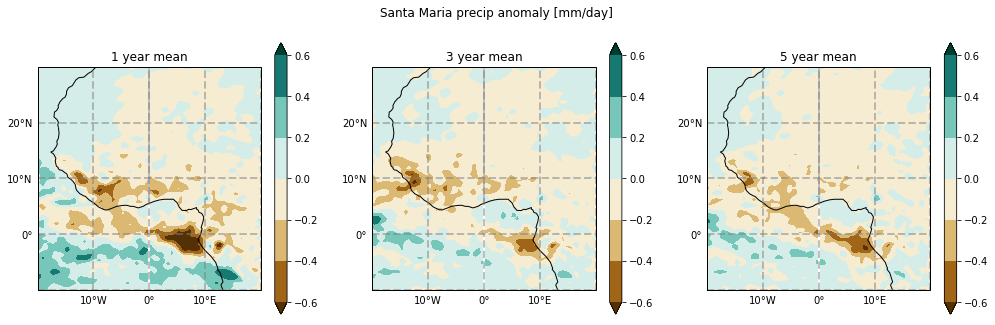

In [227]:
#using cartopy, local

plt.figure(figsize=(17,5))

ax1=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.6, vmax=0.6,add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5 year mean')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
da_stmaria3 = da_stmaria[:,5:41]
da = da_stmaria3.mean('time') - da_ctl.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.6, vmax=0.6,add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3 year mean')

ax3=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
da_stmaria1 = da_stmaria[:,5:17]
da = da_stmaria1.mean('time') - da_ctl.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6,add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1 year mean')

plt.suptitle('Santa Maria precip anomaly [mm/day]')
#plt.savefig('stmaria_sahel.png')

### Time series (Sahel)

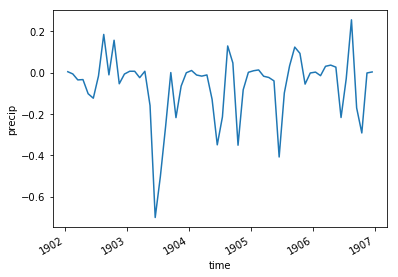

In [232]:
da_ctl['time']=da_stmaria['time']
da_ctl_s = da_ctl.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

# select sahel region
da_s_s = da_stmaria.mean('en').isel(lon=(da_stmaria.lon<=10)|(da_stmaria.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_s_s = da_s_s - da_ctl_s
da_s_s.plot()
#


In [233]:
da_ctl_s.mean('time')

<xarray.DataArray 'precip' ()>
array(1.627171)

### Monthly climatology (Sahel)

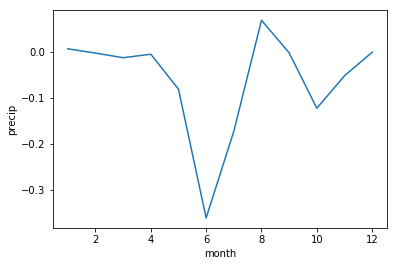

In [9]:
s_clim = da_s_s.groupby('time.month').mean('time')
da_s_s.groupby('time.month').mean('time').plot()
#

## Agung

In [9]:
# avg time and ensembles, plot AGUNG precip anomaly
da_agung = agung * scale_factor
da = da_agung.mean('time') - da_ctl.mean('time')


### Global precip anomaly

Text(0.5, 0.98, 'Agung precip anomaly')

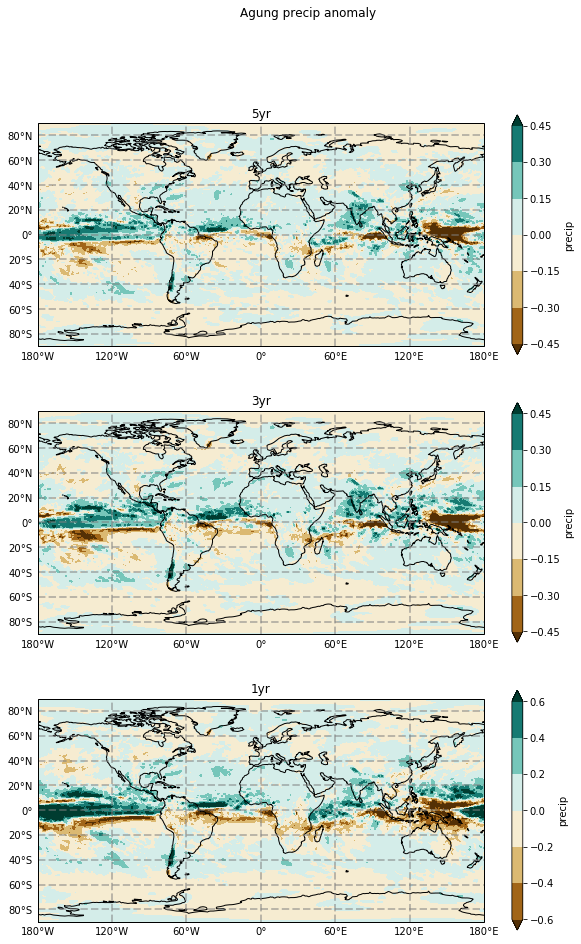

In [21]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5 yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_agung3 = da_agung[:,5:41]
da3 = da_agung3.mean('time') - da_ctl.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_agung1 = da_agung[:,5:17]
da1 = da_agung1.mean('time') - da_ctl.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('Agung precip anomaly')

#


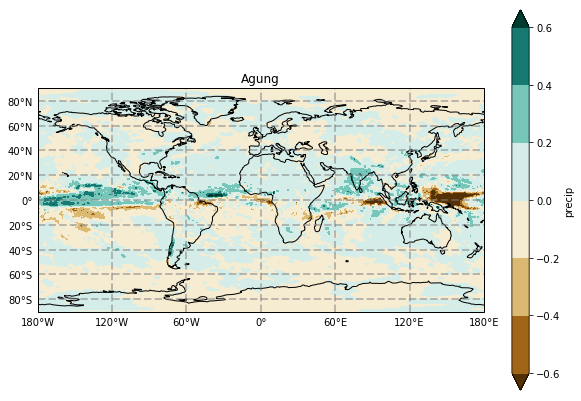

In [27]:
plt.figure(figsize=(10,7))
ax1=plt.subplot(1,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da.mean('en').plot.contourf(robust=True, vmin=-0.6, vmax=0.6, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Agung')
#plt.savefig('global5yr_agung.png')

### Sahel precip anomaly

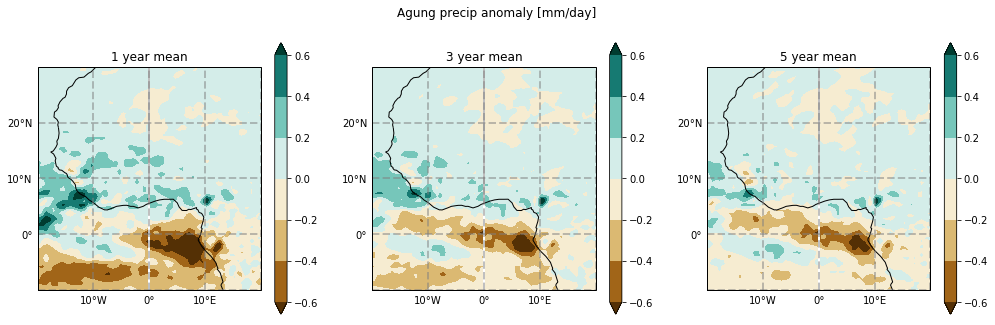

In [230]:
#using cartopy, local

plt.figure(figsize=(17,5))

ax1=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.6, vmax=0.6,add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5 year mean')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
da_agung3 = da_agung[:,5:41]
da = da_agung3.mean('time') - da_ctl.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.6, vmax=0.6,add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3 year mean')

ax3=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
da_agung1 = da_agung[:,5:17]
da = da_agung1.mean('time') - da_ctl.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6,add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1 year mean')

plt.suptitle('Agung precip anomaly [mm/day]')
#plt.savefig('agung_sahel.png')

### Time series (Sahel)

In [9]:
da_ctl['time']=da_agung['time']
da_ctl_s = da_ctl.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])


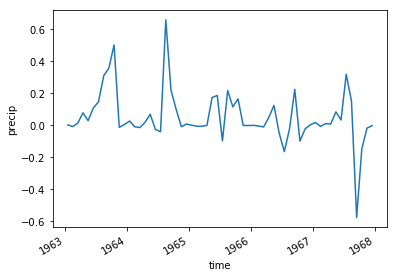

In [12]:
da_ctl['time']=da_agung['time']
da_ctl_s = da_ctl.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

# select sahel region
da_a_s = da_agung.mean('en').isel(lon=(da_agung.lon<=10)|(da_agung.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_a_s = da_a_s - da_ctl_s
da_a_s.plot()
#

### Monthly climatology (Sahel)

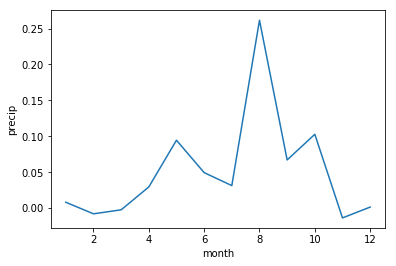

In [13]:
a_clim = da_a_s.groupby('time.month').mean('time')
da_a_s.groupby('time.month').mean('time').plot()
#

## Monthly Sahel Climatologies (together)

### control climatology

ValueError: Input passed into argument "'y1'"is not 1-dimensional.

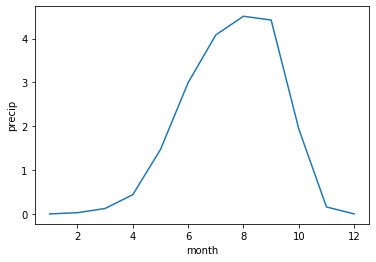

In [25]:
Z = 1.96
n = len(da_ctl.en)
ctl_clim = da_ctl_s.groupby('time.month').mean('time')
ctl_clim.plot()
plt.fill_between(da_ctl_s.groupby('time.month').mean('time').month,
        ctl_clim - (Z * da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat']).groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        ctl_clim + (Z * da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat']).groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='orange', alpha=0.2, label='95% confidence interval')
#

30

In [10]:
da_ctl_s = da_ctl.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])


In [39]:
#ctl_clim.to_netcdf('/tigress/tessj/flor_ctl_clim.nc')

<xarray.DataArray 'land_mask' (record: 1, lat: 360, lon: 576)>
array([[[1., 1., ..., 1., 1.],
        [1., 1., ..., 1., 1.],
        ...,
        [0., 0., ..., 0., 0.],
        [0., 0., ..., 0., 0.]]], dtype=float32)
Coordinates:
  * lat      (lat) float64 -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 0.3125 0.9375 1.562 2.188 ... 357.8 358.4 359.1 359.7
Dimensions without coordinates: record
Attributes:
    long_name:      fractional amount of land
    units:          none
    valid_range:    [-0.01  1.01]
    cell_methods:   time: point
    interp_method:  conserve_order1

In [39]:
da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])

<xarray.DataArray 'precip' (en: 30, time: 60)>
array([[4.49846844e-02, 1.98927332e-03, 2.12911743e-01, ...,
        2.57342520e+00, 5.29325693e-02, 2.66963026e-05],
       [2.26234345e-03, 4.06026031e-03, 7.28698730e-02, ...,
        1.79771409e+00, 3.32912449e-01, 8.07414783e-04],
       [2.31454139e-05, 2.36971382e-02, 9.20152572e-02, ...,
        2.36912999e+00, 6.40750277e-03, 2.17345191e-05],
       ...,
       [7.34153844e-03, 1.46201053e-01, 3.12734778e-02, ...,
        2.39715831e+00, 3.51440014e-02, 3.14906601e-05],
       [2.00193329e-02, 2.51750966e-02, 3.50577159e-02, ...,
        3.55694079e+00, 4.33839096e-01, 6.84355156e-06],
       [4.73829252e-06, 2.61906747e-02, 1.80144731e-01, ...,
        3.46300331e+00, 2.04380235e-02, 8.59350625e-04]])
Coordinates:
  * time     (time) datetime64[ns] 1963-01-16T12:00:00 ... 1967-12-16T12:00:00
  * en       (en) int64 1 2 3 4 5 6 7 8 9 10 ... 21 22 23 24 25 26 27 28 29 30

### Volcano climatologies

In [372]:
da_p_s[:,:48]

<xarray.DataArray 'precip' (en: 30, time: 48)>
array([[-4.23790383e-02, -1.82954276e-03, -1.35549358e-01, ...,
        -5.80934533e-01,  6.31141320e-02,  1.17505923e-06],
       [ 2.48655157e-03,  2.00937196e-02,  9.39526243e-02, ...,
        -5.72062564e-01,  9.50490437e-02, -7.91479097e-06],
       [ 5.20342495e-03, -1.14447881e-02,  1.05053395e-01, ...,
        -3.33809232e-01, -3.30778289e-01,  9.92787375e-04],
       ...,
       [-2.36225068e-03, -1.45704679e-01,  2.75371532e-02, ...,
        -7.66968156e-01,  1.05844067e-01, -2.08078672e-04],
       [-1.92091859e-02, -2.40916572e-02, -1.90640434e-02, ...,
        -1.14225239e+00,  9.00175964e-03,  1.89914079e-05],
       [ 1.96284430e-06, -1.58025118e-02, -5.59419384e-03, ...,
        -4.23051547e-01, -3.83288135e-01,  7.26414627e-05]])
Coordinates:
  * time     (time) datetime64[ns] 1991-01-16T12:00:00 ... 1994-12-16T12:00:00
  * en       (en) int64 1 2 3 4 5 6 7 8 9 10 ... 21 22 23 24 25 26 27 28 29 30

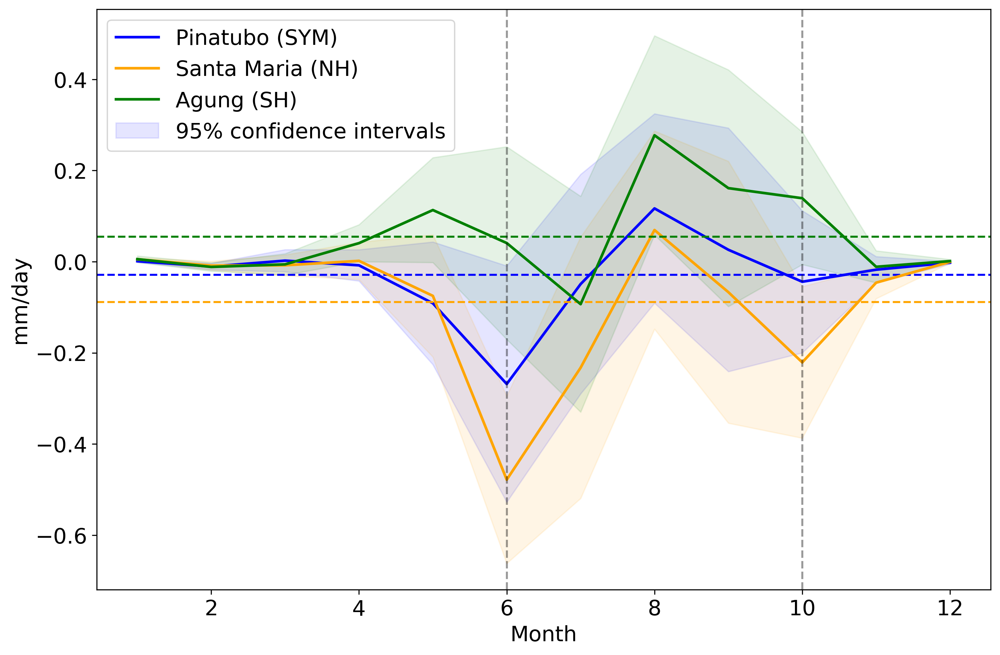

In [46]:
 #drop first year for climatology(response)
#p_clim = da_p_s[11:].groupby('time.month').mean('time')
#s_clim = da_s_s[11:].groupby('time.month').mean('time')
#a_clim = da_a_s[11:].groupby('time.month').mean('time')
Z = 1.96
n = len(da_ctl.en)
#undo ensemble mean to get confidence intervals
da_ctl['time']=da_agung['time']
da_ctl_s = da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])

da_p_s = da_pinatubo.isel(lon=(da_pinatubo.lon<=10)|(da_pinatubo.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_s_s = da_stmaria.isel(lon=(da_pinatubo.lon<=10)|(da_pinatubo.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_a_s = da_agung.isel(lon=(da_pinatubo.lon<=10)|(da_pinatubo.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])

da_ctl['time']=da_pinatubo['time']
da_ctl_s = da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_p_s = da_p_s - da_ctl_s

da_ctl['time']=da_stmaria['time']
da_ctl_s = da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_s_s = da_s_s - da_ctl_s

da_ctl['time']=da_agung['time']
da_ctl_s = da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_a_s = da_a_s - da_ctl_s

p_clim = da_p_s[:,12:].groupby('time.month').mean(['time','en'])
s_clim = da_s_s[:,12:].groupby('time.month').mean(['time','en'])
a_clim = da_a_s[:,:48].groupby('time.month').mean(['time','en'])

plt.figure(figsize=(12,8))
plt.plot(p_clim.month, p_clim, label='Pinatubo (SYM)',color='b',linewidth=2)
plt.axhline(y=p_clim.mean(), color='b', linestyle="--")
plt.fill_between(p_clim.month,
        p_clim - (Z * da_p_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        p_clim + (Z * da_p_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='b', alpha=0.1, label='95% confidence intervals')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)',color='orange',linewidth=2)
plt.fill_between(s_clim.month,
        s_clim - (Z * da_s_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        s_clim + (Z * da_s_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='orange', alpha=0.1)#, label='95% confidence interval')
plt.axhline(y=s_clim.mean(), color='orange', linestyle="--" )
plt.plot(a_clim.month, a_clim, label='Agung (SH)',color='g',linewidth=2)
plt.fill_between(p_clim.month,
        a_clim - (Z * da_a_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        a_clim + (Z * da_a_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='g', alpha=0.1)#, label='95% confidence interval')
plt.axhline(y=a_clim.mean(), color='g', linestyle="--")
plt.axvline(x=6,color='k',linestyle='--',alpha=0.4)
plt.axvline(x=10,color='k',linestyle='--',alpha=0.4)



'''plt.figure(figsize=[12,8])
plt.plot(p_clim.month, p_clim, label='Pinatubo',color='b')
plt.axhline(y=p_clim.mean(), color='b', linestyle="--")
plt.fill_between(p_clim.month,
        p_clim - da_p_s.groupby('time.month').mean('time').std('en'),
        p_clim + da_p_s.groupby('time.month').mean('time').std('en'),
        color='b', alpha=0.2, label='std')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)',color='orange')
plt.fill_between(s_clim.month,
        s_clim - da_s_s.groupby('time.month').mean('time').std('en'),
        s_clim + da_s_s.groupby('time.month').mean('time').std('en'),
        color='orange', alpha=0.2, label='std')
plt.axhline(y=s_clim.mean(), color='orange', linestyle="--" )
plt.plot(a_clim.month, a_clim, label='Agung (SH)',color='g')
plt.fill_between(p_clim.month,
        a_clim - da_a_s.groupby('time.month').mean('time').std('en'),
        a_clim + da_a_s.groupby('time.month').mean('time').std('en'),
        color='g', alpha=0.2, label='std')
plt.axhline(y=a_clim.mean(), color='g', linestyle="--")'''

plt.legend(fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('Month',size=16)
plt.ylabel('mm/day',size=16)
#plt.title('Monthly climatology in Sahel, 5-year average',fontsize=20, fontweight='bold')
#plt.savefig('flor_clim_response.png', bbox_inches='tight')
#

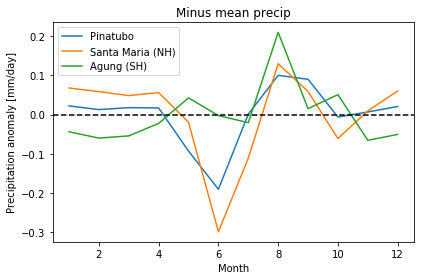

In [16]:
plt.plot(p_clim.month, p_clim-p_clim.mean(), label='Pinatubo')
plt.plot(s_clim.month, s_clim-s_clim.mean(), label='Santa Maria (NH)')
plt.plot(a_clim.month, a_clim-a_clim.mean(), label='Agung (SH)')
plt.axhline(y=0, color='k', linestyle="--")
plt.legend()
plt.xlabel('Month')
plt.ylabel('Precipitation anomaly [mm/day]')
plt.title('Minus mean precip')
plt.tight_layout()
#plt.savefig('minus_mean.png')
#

In [47]:
da_s_s_ms= da_s_s[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
da_a_s_ms= da_a_s[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
da_p_s_ms= da_p_s[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')

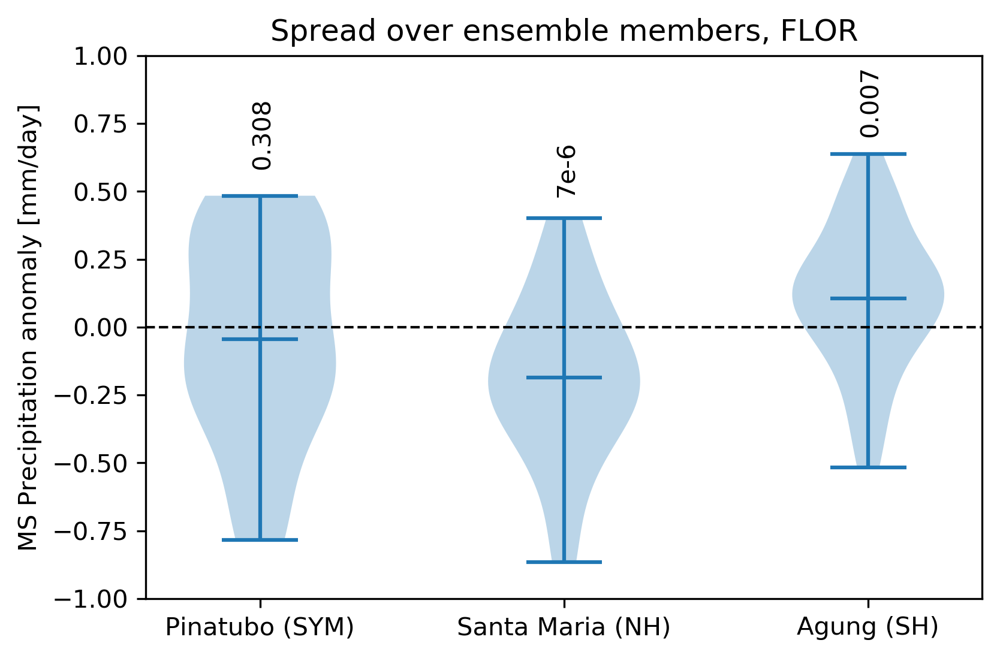

In [48]:

plt.violinplot([da_p_s_ms,da_s_s_ms,da_a_s_ms],showmeans=True,showmedians=False)
ax2 = plt.gca()
plt.text(.97,0.6,'0.308',rotation=90)
plt.text(1.97,0.5,'7e-6',rotation=90)
plt.text(2.97,0.72,'0.007',rotation=90)

plt.xticks([1,2,3], ['Pinatubo (SYM)','Santa Maria (NH)','Agung (SH)'])
ax2.set_ylim([-1,1])
plt.axhline(y=0, color='k', linestyle='--',lw=1)
plt.ylabel('MS Precipitation anomaly [mm/day]')
plt.title('Spread over ensemble members, FLOR')
#plt.savefig('violin_en_flor.png')
#-0.0501863, -0.14789164, 0.06877699

In [75]:
da_a_s_ms.mean()

<xarray.DataArray 'precip' ()>
array(0.06877699)

### Precip stats

In [51]:
ctl_p_all_s = ctl_p_all.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat']).groupby('time.year').mean('time').squeeze()
precip_5p = ctl_p_all_s.sortby(ctl_p_all_s)[9].squeeze().values.item()
precip_95p = ctl_p_all_s.sortby(ctl_p_all_s)[-10].squeeze().values.item()
precip_p_s = scale_factor*pinatubo[:,12:].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat']).groupby('time.year').mean('time').squeeze()
precip_s_s = scale_factor*stmaria[:,12:].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat']).groupby('time.year').mean('time').squeeze()
precip_a_s = scale_factor*agung[:,:48].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat']).groupby('time.year').mean('time').squeeze()


In [507]:
precip_95p

1.9385787462890385

In [52]:
pinatubo_dry = [0,0,0,0]
for i in [0,1,2,3]:
    pinatubo_dry[i]=100*len(precip_p_s.isel(year=i).where(precip_p_s.isel(year=i)<=precip_5p,drop=True))/30.
    
stmaria_dry = [0,0,0,0]
for i in [0,1,2,3]:
    stmaria_dry[i]=100*len(precip_s_s.isel(year=i).where(precip_s_s.isel(year=i)<=precip_5p,drop=True))/30.
    
agung_dry = [0,0,0,0]
for i in [0,1,2,3]:
    agung_dry[i]=100*len(precip_a_s.isel(year=i).where(precip_a_s.isel(year=i)<=precip_5p,drop=True))/30.
    
volc_dry = [pinatubo_dry,stmaria_dry,agung_dry]

In [53]:
pinatubo_wet = [0,0,0,0]
for i in [0,1,2,3]:
    pinatubo_wet[i]=100*len(precip_p_s.isel(year=i).where(precip_p_s.isel(year=i)>=precip_95p,drop=True))/30.
    
stmaria_wet = [0,0,0,0]
for i in [0,1,2,3]:
    stmaria_wet[i]=100*len(precip_s_s.isel(year=i).where(precip_s_s.isel(year=i)>=precip_95p,drop=True))/30.
    
agung_wet = [0,0,0,0]
for i in [0,1,2,3]:
    agung_wet[i]=100*len(precip_a_s.isel(year=i).where(precip_a_s.isel(year=i)>=precip_95p,drop=True))/30.
    
volc_wet = [pinatubo_wet,stmaria_wet,agung_wet]

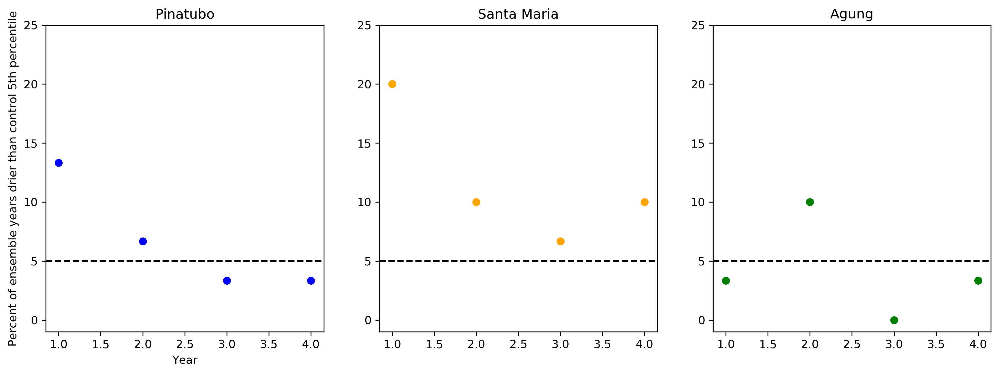

In [21]:
fig, axes = plt.subplots(1,3, figsize=(15,5))
years = [1,2,3,4]
titles=['Pinatubo','Santa Maria', 'Agung']
colors = ['b','orange','g']

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1)
    plt.scatter(years,volc_dry[ii],color=colors[ii])
    ax.set_ylim([-1,25])
    plt.axhline(5,color='k',ls='--')
    if ii==0:
        plt.ylabel('Percent of ensemble years drier than control 5th percentile')
        plt.xlabel('Year')
    plt.title(titles[ii])
    


In [54]:
pinatubo_dry_m = [0,0,0]
years=[[0,1],[2,3],[0,1,2,3]]
for i in [0,1,2]:
    pinatubo_dry_m[i]=100*len(precip_p_s.isel(year=years[i]).where(precip_p_s.isel(year=years[i])<=precip_5p,drop=True))/30.
    
stmaria_dry_m = [0,0,0]
for i in [0,1,2]:
    stmaria_dry_m[i]=100*len(precip_s_s.isel(year=years[i]).where(precip_s_s.isel(year=years[i])<=precip_5p,drop=True))/30.
    
agung_dry_m = [0,0,0]
for i in [0,1,2]:
    agung_dry_m[i]=100*len(precip_a_s.isel(year=years[i]).where(precip_a_s.isel(year=years[i])<=precip_5p,drop=True))/30.
    
volc_dry_m = [pinatubo_dry_m,stmaria_dry_m,agung_dry_m]

yrs2 = 1-(1-0.05)**2
yrs4 = 1-(1-0.05)**4

In [55]:
pinatubo_wet_m = [0,0,0]
years=[[0,1],[2,3],[0,1,2,3]]
for i in [0,1,2]:
    pinatubo_wet_m[i]=100*len(precip_p_s.isel(year=years[i]).where(precip_p_s.isel(year=years[i])>=precip_95p,drop=True))/30.
    
stmaria_wet_m = [0,0,0]
for i in [0,1,2]:
    stmaria_wet_m[i]=100*len(precip_s_s.isel(year=years[i]).where(precip_s_s.isel(year=years[i])>=precip_95p,drop=True))/30.
    
agung_wet_m = [0,0,0]
for i in [0,1,2]:
    agung_wet_m[i]=100*len(precip_a_s.isel(year=years[i]).where(precip_a_s.isel(year=years[i])>=precip_95p,drop=True))/30.
    
volc_wet_m = [pinatubo_wet_m,stmaria_wet_m,agung_wet_m]


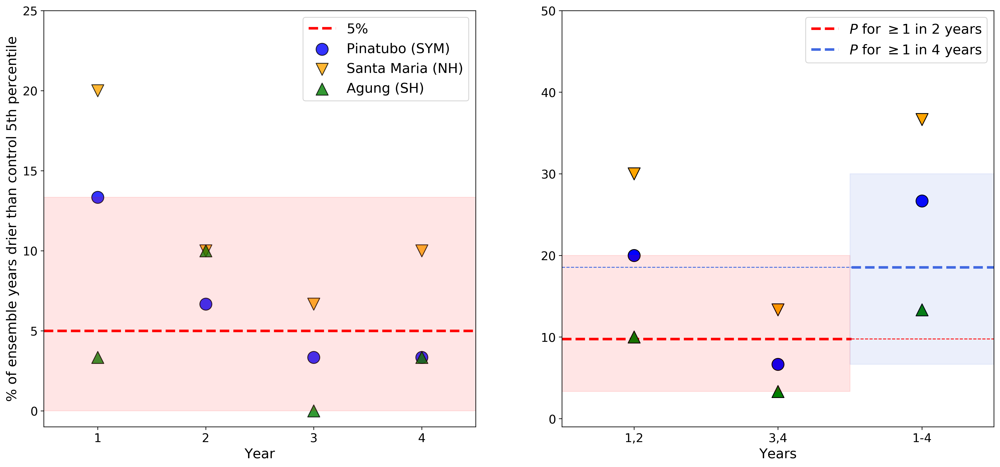

In [56]:
plt.subplots(1,2, figsize=(20,9))
years = [1,2,3,4]
titles=['Pinatubo (SYM)','Santa Maria (NH)', 'Agung (SH)']
colors = ['b','orange','g']
markers=['o','v','^']

ax1 = plt.subplot(1,2,1)

for i in range(3):
    ax1.scatter(years,volc_dry[i],color=colors[i],label=titles[i],marker=markers[i],s=200,edgecolor='k',alpha=0.8)
ax1.set_ylim(-1,25)
ax1.set_xlim(.5,4.5)
ax1.fill_between([0,6],0,13+1/3,color='r',alpha=.1)
ax1.set_ylabel('% of ensemble years drier than control 5th percentile',size=16)
ax1.set_xlabel('Year',size=16)
ax1.set_xticks(years)
ax1.tick_params(labelsize=14)
ax1.axhline(5,color='r',ls='--',label='5%',lw=3)  
ax1.legend(prop={'size': 16})
ax1.set_title('') 
years=[1,2,3]

ax2 = plt.subplot(1,2,2)
ax2.axhline(100*yrs2,xmax=0.67,color='r',ls='--',label='$P$ for $\geq 1$ in 2 years',lw=3,zorder=0)
ax2.axhline(100*yrs4, xmin=0.67,color='royalblue',ls='--',label='$P$ for $\geq 1$ in 4 years',lw=3)
ax2.axhline(100*yrs4, xmax=0.67,color='royalblue',ls='--',lw=1)
ax2.axhline(100*yrs2,xmin=0.67,color='r',ls='--',lw=1)
for i in range(3):
    ax2.scatter(years,volc_dry_m[i],color=colors[i],marker=markers[i],s=200,edgecolor='k')
ax2.set_ylim([-1,50])
ax2.set_xlim(0.5,3.5)
ax2.fill_between([0,2.5],3+1/3,20,color='r',alpha=.1)
ax2.fill_between([2.5,4],6+2/3,30,color='royalblue',alpha=.1)
ax2.set_ylabel('')
ax2.set_xticks([1,2,3])
ax2.set_xticklabels(['1,2','3,4','1-4'])
ax2.set_xlabel('Years',size=16)
ax2.tick_params(labelsize=14)
ax2.legend(prop={'size': 16})
plt.title('')

#plt.savefig('precip_stats.png',bbox_inches='tight')

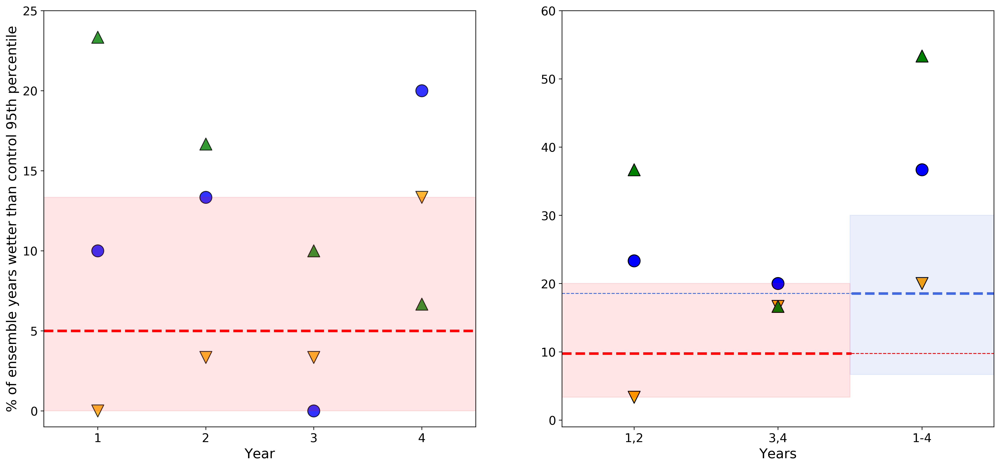

In [57]:
plt.subplots(1,2, figsize=(20,9))
years = [1,2,3,4]
titles=['Pinatubo (SYM)','Santa Maria (NH)', 'Agung (SH)']
colors = ['b','orange','g']
markers=['o','v','^']

ax1 = plt.subplot(1,2,1)

for i in range(3):
    ax1.scatter(years,volc_wet[i],color=colors[i],label=titles[i],marker=markers[i],s=200,edgecolor='k',alpha=0.8)
ax1.set_ylim(-1,25)
ax1.set_xlim(.5,4.5)
ax1.fill_between([0,6],0,13+1/3,color='r',alpha=.1)
ax1.set_ylabel('% of ensemble years wetter than control 95th percentile',size=16)
ax1.set_xlabel('Year',size=16)
ax1.set_xticks(years)
ax1.tick_params(labelsize=14)
ax1.axhline(5,color='r',ls='--',label='5%',lw=3)  
#ax1.legend(prop={'size': 16})
ax1.set_title('') 
years=[1,2,3]

ax2 = plt.subplot(1,2,2)
ax2.axhline(100*yrs2,xmax=0.67,color='r',ls='--',label='$P$ for $\geq 1$ in 2 years',lw=3,zorder=0)
ax2.axhline(100*yrs4, xmin=0.67,color='royalblue',ls='--',label='$P$ for $\geq 1$ in 4 years',lw=3)
ax2.axhline(100*yrs4, xmax=0.67,color='royalblue',ls='--',lw=1)
ax2.axhline(100*yrs2,xmin=0.67,color='r',ls='--',lw=1)
for i in range(3):
    ax2.scatter(years,volc_wet_m[i],color=colors[i],marker=markers[i],s=200,edgecolor='k')
ax2.set_ylim([-1,60])
ax2.set_xlim(0.5,3.5)
ax2.fill_between([0,2.5],3+1/3,20,color='r',alpha=.1)
ax2.fill_between([2.5,4],6+2/3,30,color='royalblue',alpha=.1)
ax2.set_ylabel('')
ax2.set_xticks([1,2,3])
ax2.set_xticklabels(['1,2','3,4','1-4'])
ax2.set_xlabel('Years',size=16)
ax2.tick_params(labelsize=14)
#ax2.legend(prop={'size': 16})
plt.title('')

#plt.savefig('precip_stats_wet.png',bbox_inches='tight')

# 

<xarray.DataArray 'precip' (en: 30, time: 60, lat: 360, lon: 576)>
array([[[[2.170420e-06, ..., 2.170420e-06],
         ...,
         [3.431800e-06, ..., 3.431800e-06]],

        ...,

        [[1.120884e-06, ..., 1.120884e-06],
         ...,
         [4.503343e-06, ..., 4.503343e-06]]],


       ...,


       [[[1.538403e-06, ..., 1.538403e-06],
         ...,
         [1.257858e-06, ..., 1.257858e-06]],

        ...,

        [[3.760427e-07, ..., 3.760427e-07],
         ...,
         [3.715590e-06, ..., 3.715590e-06]]]], dtype=float32)
Coordinates:
  * lat      (lat) float64 -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 0.3125 0.9375 1.562 2.188 ... 357.8 358.4 359.1 359.7
  * time     (time) datetime64[ns] 1902-01-16T12:00:00 ... 1906-12-16T12:00:00
  * en       (en) int64 1 2 3 4 5 6 7 8 9 10 ... 21 22 23 24 25 26 27 28 29 30
Attributes:
    long_name:      Total precipitation rate
    units:          kg/m2/s
    cell_methods:   time: mean
    time_avg

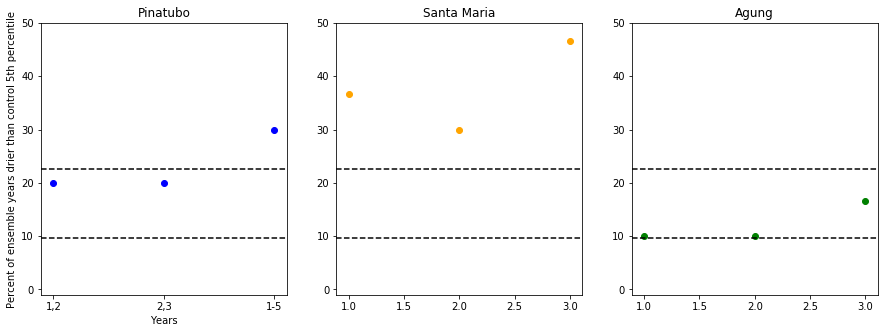

In [153]:
fig, axes = plt.subplots(1,3, figsize=(15,5))
years = [1,2,3]
titles=['Pinatubo','Santa Maria', 'Agung']
colors = ['b','orange','g']

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1)
    plt.scatter(years,volc_dry_m[ii],color=colors[ii])
    plt.ylim([-1,50])
    plt.axhline(100*yrs2,color='k',ls='--')
    plt.axhline(100*yrs5, color='k',ls='--')
    if ii==0:
        plt.ylabel('Percent of ensemble years drier than control 5th percentile')
        plt.xticks([1,2,3], ['1,2','2,3','1-5'])
        plt.xlabel('Years')
    plt.title(titles[ii])
    

In [156]:
ctl_p_all_s.var()

<xarray.DataArray 'precip' ()>
array(0.03350845)

## Seasonal means

### Pinatubo - seasonal

Text(0.5,0.98,'Pinatubo seasonal means (5 yr)')

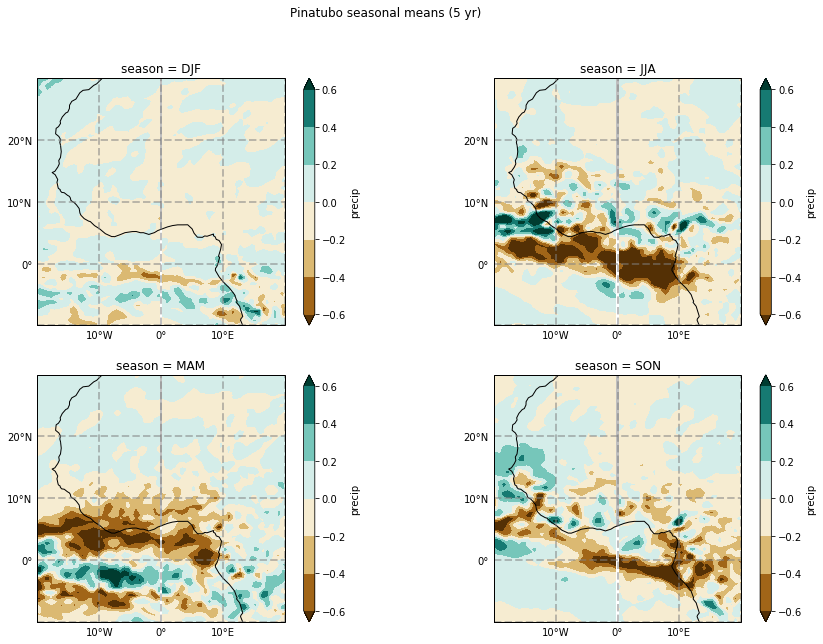

In [5]:

da_pinatubo_szn = da_pinatubo.groupby('time.season').mean('time')
da_ctl_szn = da_ctl.groupby('time.season').mean('time')
da = da_pinatubo_szn - da_ctl_szn
da = da.mean('en')
pinatubo_jja = da.sel(season='JJA')

# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(2, 2, figsize=(15,10))

# f = da.plot.contourf(col='season', col_wrap=2,
#     robust=True, levels=10, center=0, extend='both', cmap='BrBG')

# for ii, ax in enumerate(f.axes.flat):
for ii, ax in enumerate(axes.flat):
    #mapplot(ax=ax, lw=0.2)
    ax=plt.subplot(2,2,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    da[ii].plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 

plt.suptitle('Pinatubo seasonal means (5 yr)')
#plt.savefig('pinatubo_szn.png')



<xarray.DataArray 'precip' (lat: 360, lon: 576)>
array([[-0.010593, -0.010593, -0.010593, ..., -0.010593, -0.010593, -0.010593],
       [-0.008951, -0.008961, -0.008971, ..., -0.008921, -0.008931, -0.00894 ],
       [-0.007485, -0.007494, -0.007503, ..., -0.007458, -0.007467, -0.007476],
       ...,
       [-0.032549, -0.032506, -0.032462, ..., -0.032679, -0.032636, -0.032593],
       [-0.02791 , -0.027939, -0.027968, ..., -0.027823, -0.027852, -0.027881],
       [-0.032645, -0.032645, -0.032645, ..., -0.032645, -0.032645, -0.032645]])
Coordinates:
  * lat      (lat) float64 -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 0.3125 0.9375 1.562 2.188 ... 357.8 358.4 359.1 359.7
    season   <U3 'JJA'

### Pinatubo - JJA

Text(0.5, 0.98, 'Pinatubo JJA mean precip (5 yr)')

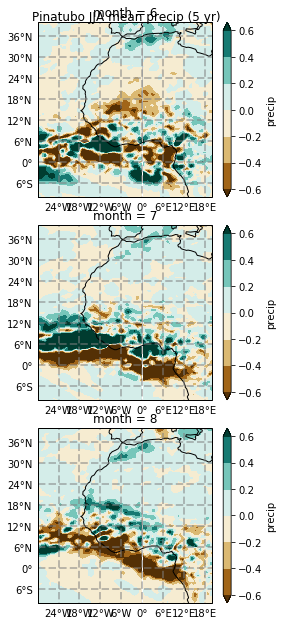

In [24]:

da_pinatubo_jja = da_pinatubo.groupby('time.month').mean('time')[:,5:8]
da_ctl_jja = da_ctl.groupby('time.month').mean('time')[:,5:8]
da = da_pinatubo_jja - da_ctl_jja
da = da.mean('en')

f = da.plot.contourf(col='month', col_wrap=1,
    robust=True, levels=10, center=0, extend='both', cmap='BrBG')

for ii, ax in enumerate(f.axes.flat):
    #mapplot(ax=ax, lw=0.2)
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
    da[ii].plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    
plt.suptitle('Pinatubo JJA mean precip (5 yr)')

#


### Santa Maria - seasonal

Text(0.5, 0.98, 'Santa Maria seasonal means (5 yr)')

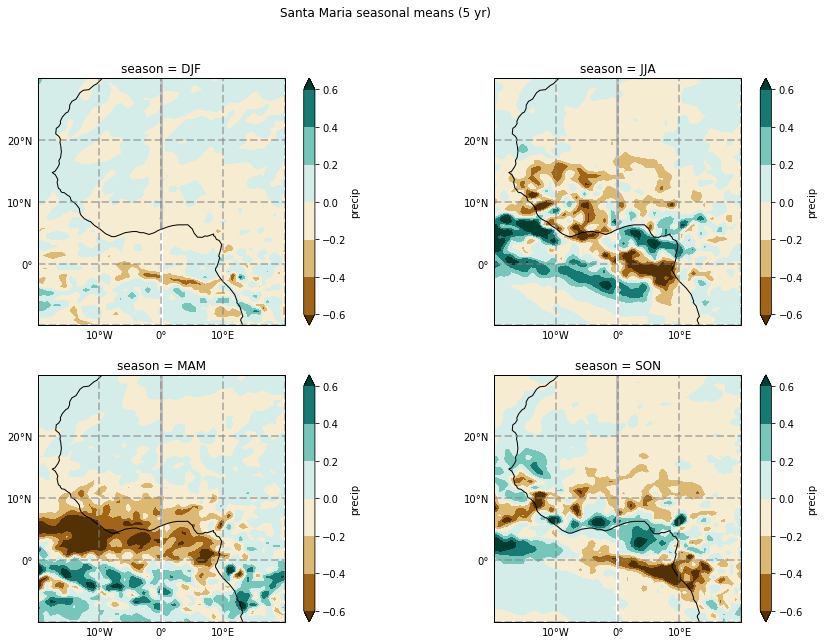

In [217]:

da_stmaria_szn = da_stmaria.groupby('time.season').mean('time')
da = da_stmaria_szn - da_ctl_szn
da = da.mean('en')
stmaria_jja = da.sel(season='JJA')

# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(2, 2, figsize=(15,10))

# f = da.plot.contourf(col='season', col_wrap=2,
#     robust=True, levels=10, center=0, extend='both', cmap='BrBG')

# for ii, ax in enumerate(f.axes.flat):
for ii, ax in enumerate(axes.flat):
    #mapplot(ax=ax, lw=0.2)
    ax=plt.subplot(2,2,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    da[ii].plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 

plt.suptitle('Santa Maria seasonal means (5 yr)')

#plt.savefig('stmaria_szn.png')



### Santa Maria - JJA 

In [ ]:

da_stmaria_jja = da_stmaria.groupby('time.month').mean('time')[:,5:8]
da = da_stmaria_jja - da_ctl_jja
da = da.mean('en')

f = da.plot.contourf(col='month', col_wrap=1,
    robust=True, levels=10, center=0, extend='both', cmap='BrBG')

for ii, ax in enumerate(f.axes.flat):
    #mapplot(ax=ax, lw=0.2)
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
    da[ii].plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    
plt.suptitle('Santa Maria JJA mean precip (5 yr)')




### Agung - seasonal

Text(0.5, 0.98, 'Agung seasonal means (5 yr)')

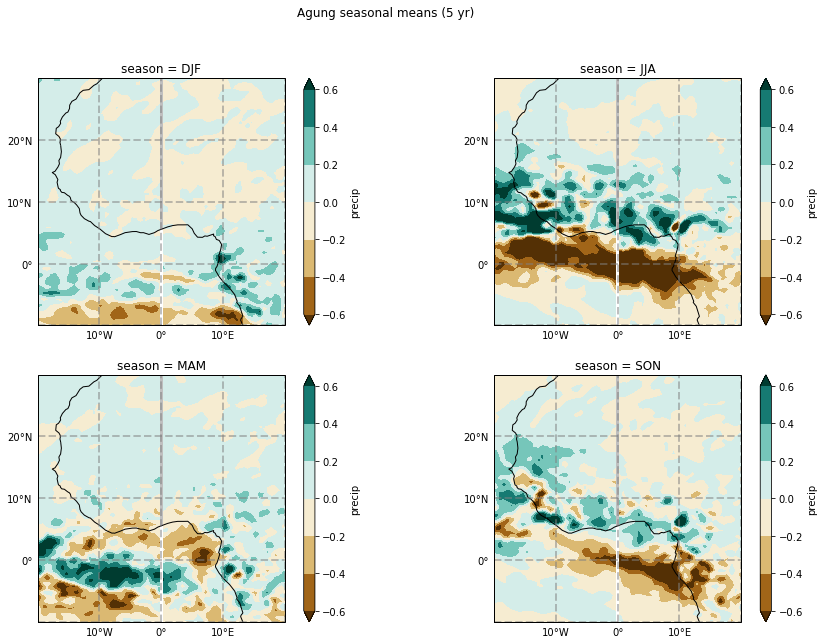

In [218]:
da_agung_szn = da_agung.groupby('time.season').mean('time')
da = da_agung_szn - da_ctl_szn
da = da.mean('en')
agung_jja = da.sel(season='JJA')

# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(2, 2, figsize=(15,10))

# f = da.plot.contourf(col='season', col_wrap=2,
#     robust=True, levels=10, center=0, extend='both', cmap='BrBG')

# for ii, ax in enumerate(f.axes.flat):
for ii, ax in enumerate(axes.flat):
    #mapplot(ax=ax, lw=0.2)
    ax=plt.subplot(2,2,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    da[ii].plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 

plt.suptitle('Agung seasonal means (5 yr)')
#plt.savefig('agung_szn.png')


### Agung - JJA

<IPython.core.display.Javascript object>


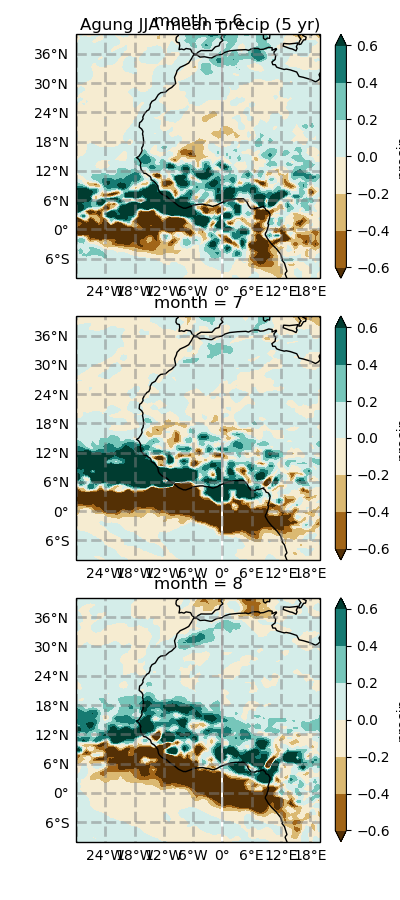

In [29]:

da_agung_jja = da_agung.groupby('time.month').mean('time')[:,5:8]
da = da_agung_jja - da_ctl_jja
da = da.mean('en')

f = da.plot.contourf(col='month', col_wrap=1,
    robust=True, levels=10, center=0, extend='both', cmap='BrBG')

for ii, ax in enumerate(f.axes.flat):
    #mapplot(ax=ax, lw=0.2)
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
    da[ii].plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    
plt.suptitle('Agung JJA mean precip (5 yr)')


# ALL JJA SEASONAL 

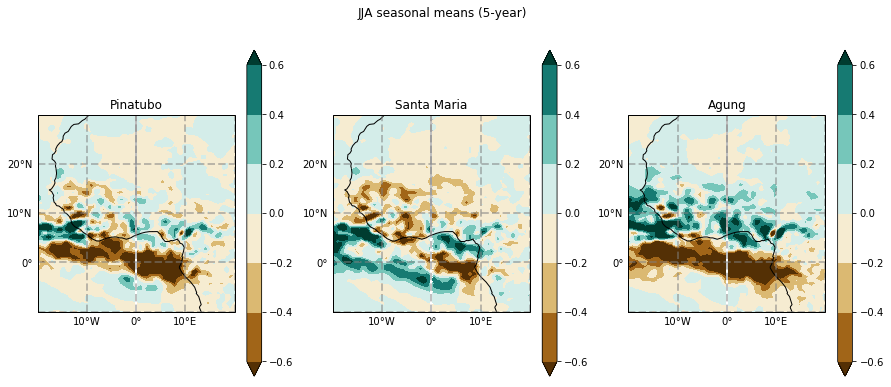

In [219]:

da = [pinatubo_jja, stmaria_jja, agung_jja]
titles = ['Pinatubo', 'Santa Maria', 'Agung']

# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(1, 3, figsize=(15,6))


# for ii, ax in enumerate(f.axes.flat):
for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    da[ii].plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6, add_labels=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

plt.suptitle('JJA seasonal means (5-year)')
#plt.savefig('all_jja.png')

## MS Seasonal

In [238]:
da_ctl['time'] = da_pinatubo['time']
daa_pinatubo_ms = (da_pinatubo - da_ctl)[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
da_ctl_ms = da_ctl[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(daa_pinatubo_ms, 0)
da_pinatubo_ms = daa_pinatubo_ms.mean('en').load()
pvalue_p = xr.DataArray(pp, dims=da_pinatubo_ms.dims, coords=[da_pinatubo_ms[dim] for dim in da_pinatubo_ms.dims])


#da_pinatubo_ms_sum = (da_pinatubo + da_ctl).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
#da_pinatubo_ms_frac = da_pinatubo_ms/da_pinatubo_ms_sum


da_ctl['time'] = da_stmaria['time']
daa_stmaria_ms = (da_stmaria - da_ctl)[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(daa_stmaria_ms, 0)
da_stmaria_ms = daa_stmaria_ms.mean('en').load()
pvalue_s = xr.DataArray(pp, dims=da_stmaria_ms.dims, coords=[da_stmaria_ms[dim] for dim in da_stmaria_ms.dims])

#da_stmaria_ms_sum = (da_stmaria + da_ctl).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
#da_stmaria_ms_frac = da_stmaria_ms/da_stmaria_ms_sum

da_ctl['time'] = da_agung['time']
daa_agung_ms = (da_agung - da_ctl)[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(daa_agung_ms, 0)
da_agung_ms = daa_agung_ms.mean('en').load()
pvalue_a = xr.DataArray(pp, dims=da_agung_ms.dims, coords=[da_agung_ms[dim] for dim in da_agung_ms.dims])

#da_agung_ms_sum = (da_agung + da_ctl).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
#da_agung_ms_frac = da_agung_ms/da_agung_ms_sum

In [370]:
da_pinatubo_ms


<xarray.DataArray 'precip' (lat: 360, lon: 576)>
array([[-0.00637274, -0.00637274, -0.00637274, ..., -0.00637274,
        -0.00637274, -0.00637274],
       [-0.00621426, -0.00621523, -0.00621621, ..., -0.00621137,
        -0.00621233, -0.00621329],
       [-0.00612702, -0.00612748, -0.00612793, ..., -0.00612567,
        -0.00612612, -0.00612657],
       ...,
       [-0.0427541 , -0.04271526, -0.0426763 , ..., -0.04287004,
        -0.04283149, -0.04279285],
       [-0.0378917 , -0.03789405, -0.03789642, ..., -0.03788472,
        -0.03788704, -0.03788936],
       [-0.03827478, -0.03827478, -0.03827478, ..., -0.03827478,
        -0.03827478, -0.03827478]])
Coordinates:
  * lat      (lat) float64 -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 0.3125 0.9375 1.562 2.188 ... 357.8 358.4 359.1 359.7

In [395]:
import scipy.stats


In [397]:
## p-value calculations
da_ctl[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['month','lon','lat']).std()

<xarray.DataArray 'precip' ()>
array(0.23508817)

In [393]:
da_pinatubo_ms.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])

<xarray.DataArray 'precip' ()>
array(-0.04371082)

In [399]:
da_agung_ms.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])

<xarray.DataArray 'precip' ()>
array(0.1051073)

In [402]:
da_stmaria_ms.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])

<xarray.DataArray 'precip' ()>
array(-0.18588453)

In [401]:
p_agung=1-scipy.stats.norm.cdf(0.1051073,0,0.23508817/np.sqrt(30))
p_agung

0.007165594372297024

In [403]:
p_stmaria=scipy.stats.norm.cdf(-0.18588453,0,0.23508817/np.sqrt(30))
p_stmaria

7.426756472916193e-06

In [398]:
p_pinatubo = scipy.stats.norm.cdf(-0.04371082,0,0.23508817/np.sqrt(30))*2
p_pinatubo

0.308487439705722

In [99]:
#da.roll(lon=da.lon.size//2).pipe(lambda x: x.assign_coords(lon=x.lon.where(x.lon<180, other=x.lon-360)))


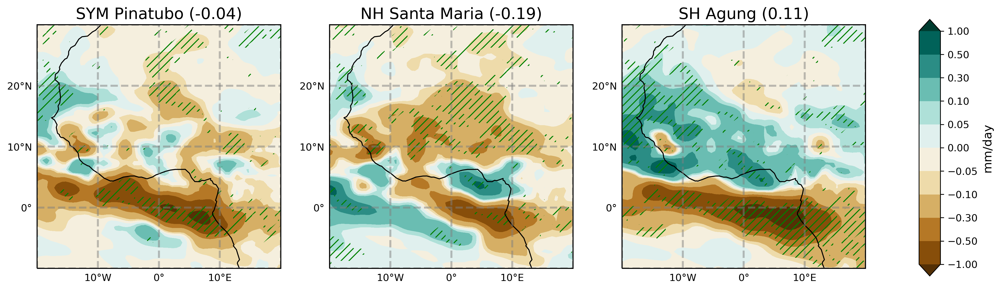

In [240]:
da = [da_pinatubo_ms, da_stmaria_ms, da_agung_ms]
pvalue = [pvalue_p,pvalue_s,pvalue_a]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['SYM Pinatubo (%.2f)' %da_s[0], 'NH Santa Maria (%.2f)' %da_s[1], 'SH Agung (%.2f)' %da_s[2]]

fig, axes = plt.subplots(1, 3, figsize=(15,6))


for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='BrBG',levels=[-1,-0.5,-0.3,-0.1,-0.05,0,0.05,0.1,0.3,0.5,1],extend='both', add_labels=False, add_colorbar=False)
    #im = shift_longitude(da[ii]).plot.contourf(robust=True, cmap='BrBG',levels=[-1,-0.5,-0.3,-0.1,-0.05,0,0.05,0.1,0.3,0.5,1],extend='both', add_labels=False, add_colorbar=False)
    shift_longitude(pvalue[ii].where(pvalue[ii]<0.05).pipe(lambda x:x*0)).plot.contourf(colors='None', hatches=['///'], add_colorbar=False, add_labels=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii],fontsize=16)

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =[-1,-0.5,-0.3,-0.1,-0.05,0,0.05,0.1,0.3,0.5,1], cax=ax,orientation='vertical').set_label(label='mm/day',size=12)
#plt.tight_layout()#(rect=(0,0,1,1))

#plt.suptitle('MS mean precipitation anomaly [mm/day]',fontsize=20, fontweight='demi',y=.95)
#smoothed over 5x5 degrees
plt.savefig('ms_precip.png', bbox_inches='tight')



In [334]:
da[i][11:]

<xarray.DataArray 'precip' (lat: 349, lon: 576)>
array([[-0.01039754, -0.01037696, -0.01018441, ..., -0.01042461,
        -0.0104156 , -0.01040658],
       [-0.01006998, -0.00989913, -0.0099284 , ..., -0.01136673,
        -0.01134514, -0.01122238],
       [-0.01041859, -0.01036601, -0.01031331, ..., -0.01318493,
        -0.01281859, -0.01086253],
       ...,
       [-0.02548957, -0.02547571, -0.02546181, ..., -0.02553093,
        -0.02551718, -0.02550339],
       [-0.02319472, -0.02317716, -0.02315951, ..., -0.02324684,
        -0.02322956, -0.02321218],
       [-0.02033382, -0.02033382, -0.02033382, ..., -0.02033382,
        -0.02033382, -0.02033382]])
Coordinates:
  * lat      (lat) float64 -84.25 -83.75 -83.25 -82.75 ... 88.75 89.25 89.75
  * lon      (lon) float64 0.3125 0.9375 1.562 2.188 ... 357.8 358.4 359.1 359.7

Text(0.5, 0.93, 'Monsoon season fractional precipitation change')

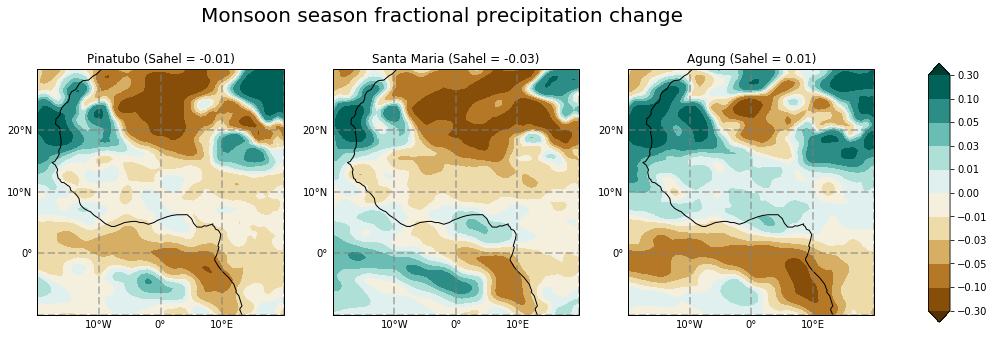

In [449]:
da = [da_pinatubo_ms_frac, da_stmaria_ms_frac, da_agung_ms_frac]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo (Sahel = %.2f)' %da_s[0], 'Santa Maria (Sahel = %.2f)' %da_s[1], 'Agung (Sahel = %.2f)' %da_s[2]]

fig, axes = plt.subplots(1, 3, figsize=(15,6))
levels=[-0.3,-0.1,-0.05,-0.03,-0.01,0,0.01,0.03,0.05,0.1,0.3]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='BrBG',levels=levels,extend='both', add_labels=False, add_colorbar=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =levels, cax=ax,orientation='vertical')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('Monsoon season fractional precipitation change',fontsize=20,y=.93)
#smoothed over 5x5 degrees
#plt.savefig('ms_precip.png', bbox_inches='tight')


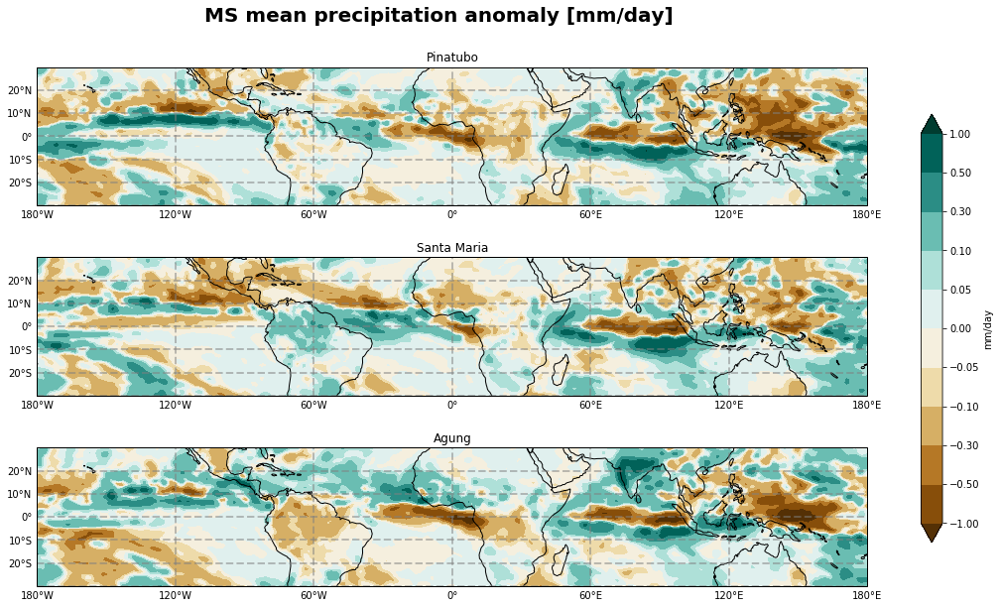

In [62]:
da = [da_pinatubo_ms, da_stmaria_ms, da_agung_ms]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo', 'Santa Maria', 'Agung' ]

fig, axes = plt.subplots(3, 1, figsize=(15,10))


for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-180,180, -30, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='BrBG',levels=[-1,-0.5,-0.3,-0.1,-0.05,0,0.05,0.1,0.3,0.5,1],extend='both', add_labels=False, add_colorbar=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER

    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =[-1,-0.5,-0.3,-0.1,-0.05,0,0.05,0.1,0.3,0.5,1], cax=ax,orientation='vertical',label='mm/day')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('MS mean precipitation anomaly [mm/day]',fontsize=20, fontweight='demi',y=.95)
#smoothed over 5x5 degrees
#plt.savefig('glob_tropic_precip.png', bbox_inches='tight')

## Zonal averages

In [241]:
da_ctl['time'] = da_pinatubo['time']
da_pinatubo_ms_za = (da_pinatubo - da_ctl)[:,12:].groupby('time.month').mean(['time'])
da_pinatubo_max = da_pinatubo[:,12:].groupby('time.month').mean(['time','en'])

da_ctl['time'] = da_stmaria['time']
da_stmaria_ms_za = (da_stmaria - da_ctl)[:,12:].groupby('time.month').mean(['time'])
da_stmaria_max = da_stmaria[:,12:].groupby('time.month').mean(['time','en'])

da_ctl['time'] = da_agung['time']
da_agung_ms_za = (da_agung - da_ctl)[:,:48].groupby('time.month').mean(['time'])
da_agung_max = da_agung[:,:48].groupby('time.month').mean(['time','en'])

da_ctl_max = da_ctl[:,12:].groupby('time.month').mean(['time','en'])

da = [da_pinatubo_ms_za, da_stmaria_ms_za, da_agung_ms_za]
da_max = [da_ctl_max,da_pinatubo_max,da_stmaria_max,da_agung_max]

da_za = [0,1,2]
pvalue=[0,0,0]
for i in da_za:
    da_za[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(-10,30)).mean(['lon'])
    da1 = da_za[i].sel(month=12)
    da1['month'] = da1['month']-12
    da2 = da_za[i].sel(month=1)
    da2['month'] = da2['month']+12
    da_za[i]=xr.concat([da1,da_za[i],da2],dim='month')
    da_za[i] = da_za[i].rolling(month=3,center=True).mean().dropna('month')
    tt, pp = ttest_1samp(da_za[i], 0)
    da_za[i] = da_za[i].mean('en').load()
    pvalue[i] = xr.DataArray(pp, dims=da_za[i].dims, coords=[da_za[i][dim] for dim in da_za[i].dims])

    
    
for i in range(len(da_max)):
    da_max[i] = da_max[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(-10,30)).mean(['lon'])
    
for i in range(len(da_max)):    
    da_max[i]= da_max[i].isel(lat=da_max[i].argmax('lat')).lat

/home/tessj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:25: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


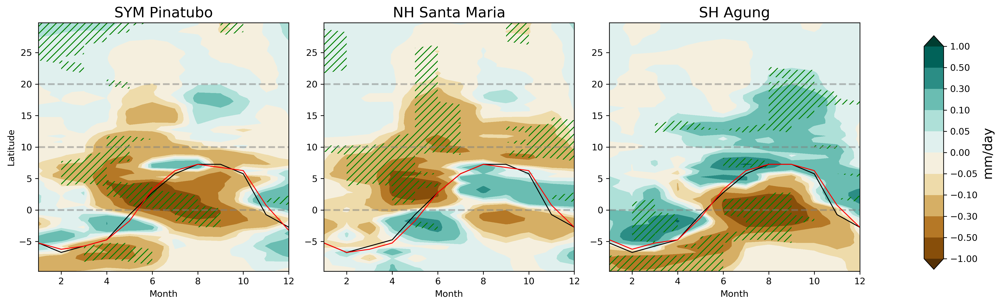

In [242]:
# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(1, 3, figsize=(15,6))
titles = ['SYM Pinatubo','NH Santa Maria', 'SH Agung']
levels=[-1,-0.5,-0.3,-0.1,-0.05,0,0.05,0.1,0.3,0.5,1]

# for ii, ax in enumerate(f.axes.flat):
for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1)
    im = da_za[ii].plot.contourf(y='lat',robust=True, cmap='BrBG',levels=levels,extend='both', add_colorbar=False)
    pvalue[ii].where(pvalue[ii]<0.05).pipe(lambda x:x*0).plot.contourf(y='lat',colors='None', hatches=['///'], add_colorbar=False, add_labels=False)
    ax.axhline(0, lw = 2, color='gray', alpha=.5, linestyle='--')
    ax.axhline(10, lw = 2, color='gray', alpha=.5, linestyle='--')
    ax.axhline(20, lw = 2, color='gray', alpha=.5, linestyle='--')
    da_max[0].plot(c='k',lw=1)
    da_max[ii+1].plot(c='r', lw=1)
    if ii==0:
        ax.set_ylabel('Latitude')
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Month')
    ax.set_title(titles[ii],fontsize=16)
    
ax = fig.add_axes((.95,.1,.02,.6))
plt.colorbar(im,cax=ax,orientation='vertical',ticks=levels).set_label(label='mm/day',size=14)
plt.tight_layout(rect=(0,0,.9,.8))

#plt.suptitle('Precipitation anomaly ZA (20W-10E)[mm/day]',fontsize=20, fontweight='demi',y=.82)
plt.savefig('precip_za_szn_smooth.png', bbox_inches='tight')

In [281]:
for i in range(len(da_max)):
    print(da_max[i][5:10].mean())

<xarray.DataArray 'lat' ()>
array(5.75)
<xarray.DataArray 'lat' ()>
array(6.05)
<xarray.DataArray 'lat' ()>
array(5.65)
<xarray.DataArray 'lat' ()>
array(6.05)


In [10]:
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

In [175]:
da_ctl['time'] = da_pinatubo['time']
da_pinatubo_ms_1 = (da_pinatubo - da_ctl)[:24].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

da_ctl['time'] = da_stmaria['time']
da_stmaria_ms_1 = (da_stmaria - da_ctl)[:24].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

da_ctl['time'] = da_agung['time']
da_agung_ms_1 = (da_agung - da_ctl)[:24].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

da = [da_pinatubo_ms_1, da_stmaria_ms_1, da_agung_ms_1]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
    
da_s

[<xarray.DataArray 'precip' ()>
 array(0.032164), <xarray.DataArray 'precip' ()>
 array(-0.075717), <xarray.DataArray 'precip' ()>
 array(0.125765)]

Text(0.5, 1.0, 'Ctl monsoon season')

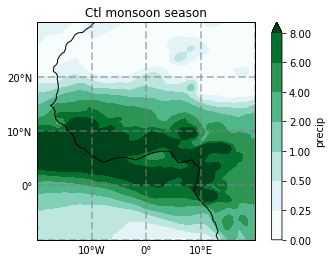

In [487]:
levels = [0,.25,.5,1,2,4,6,8]
ax1=plt.subplot(1,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(da_ctl_ms).plot.contourf(robust=True, levels = levels,cmap='BuGn')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Ctl monsoon season')


# Evaporation anomaly 

In [176]:
#get evap data as dataarray (in kg/m2/s)

pinatubo_e = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.evap.nc/') 
stmaria_e = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.evap.nc/') 
agung_e = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.evap.nc/') 
ctl_e = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.evap.nc/') 

/tigress/wenchang/miniconda3/lib/python3.6/site-packages/xarray/coding/times.py:132: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using dummy cftime.datetime objects instead, reason: dates out of range
  enable_cftimeindex)
/tigress/wenchang/miniconda3/lib/python3.6/site-packages/xarray/coding/variables.py:66: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using dummy cftime.datetime objects instead, reason: dates out of range
  return self.func(self.array[key])


In [177]:
#1 kg/m2/s = 86400 mm/day
scale_factor_e = 86400

## Pinatubo

In [178]:
# avg time and ensembles, plot PINATUBO evap
da_ctl_e = ctl_e * scale_factor_e
da_pinatubo_e = pinatubo_e * scale_factor_e
#time average of (5 year, all ensembles)
#da = da_pinatubo_e.mean('time') - da_ctl_e.mean('time')

### Global evap anomaly

<IPython.core.display.Javascript object>


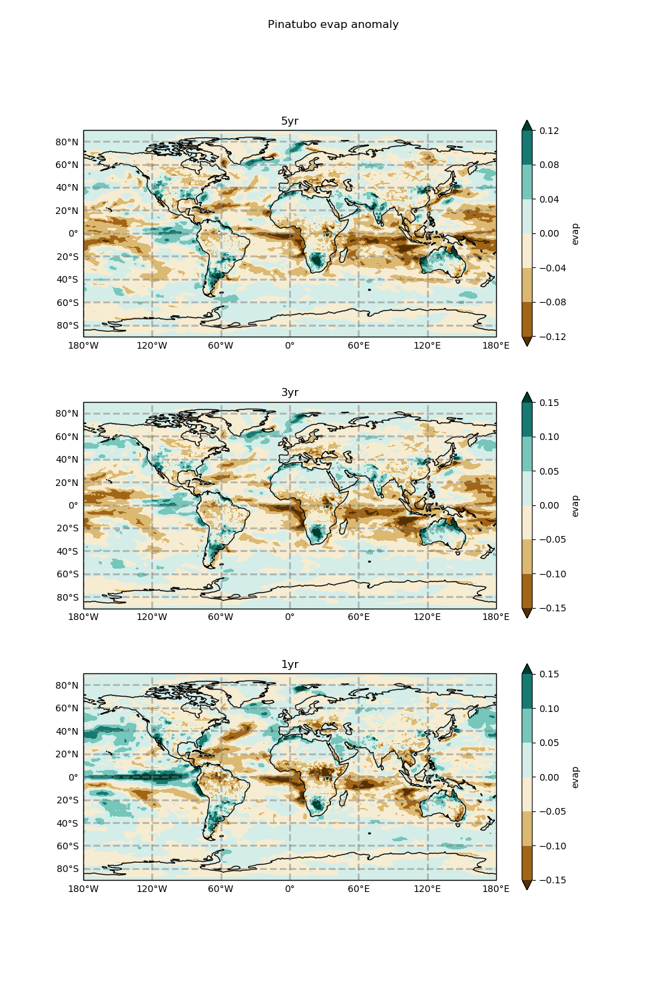

In [33]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da = da_pinatubo_e.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_pinatubo3 = da_pinatubo_e[:,5:41]
da3 = da_pinatubo3.mean('time') - da_ctl_e.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_pinatubo1 = da_pinatubo_e[:,5:17]
da1 = da_pinatubo1.mean('time') - da_ctl_e.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('Pinatubo evap anomaly')




### Sahel evap anomaly

<IPython.core.display.Javascript object>


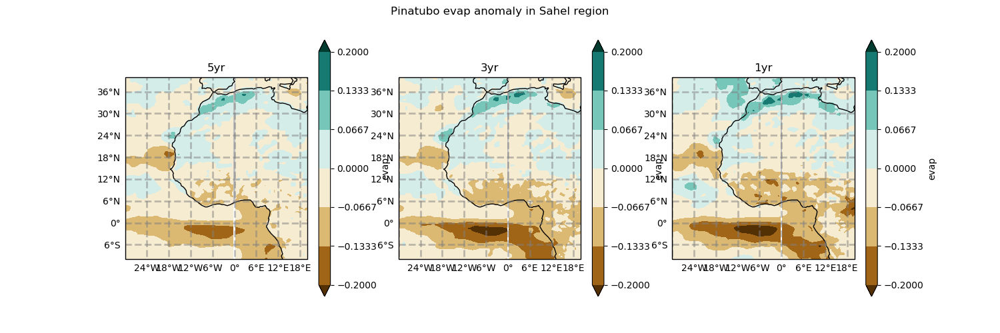

In [34]:
#using cartopy, local

plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da = da_pinatubo_e.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.2, vmax=0.2)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da = da_pinatubo3.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.2, vmax=0.2)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
#da_pinatubo1 = da_pinatubo[:,5:17]
da = da_pinatubo1.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG',vmin=-0.2, vmax=0.2)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('Pinatubo evap anomaly in Sahel region')




### Sahel evap time series

In [28]:
da_ctl_e['time']=da_pinatubo_e['time']
da_ctl_s = da_ctl_e.mean('en').isel(lon=(da_ctl_e.lon<=10)|(da_ctl_e.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

# select sahel region
da_p_s = da_pinatubo_e.mean('en').isel(lon=(da_pinatubo_e.lon<=10)|(da_pinatubo_e.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_p_s = da_p_s - da_ctl_s
da_p_s.plot()



### Sahel monthly climatology

In [ ]:
p_clim = da_p_s.groupby('time.month').mean('time')
da_p_s.groupby('time.month').mean('time').plot()


## Santa Maria

In [179]:
# avg time and ensembles, plot SANTA MARIA evap
da_stmaria_e = stmaria_e * scale_factor_e

### Global evap anomaly

<IPython.core.display.Javascript object>


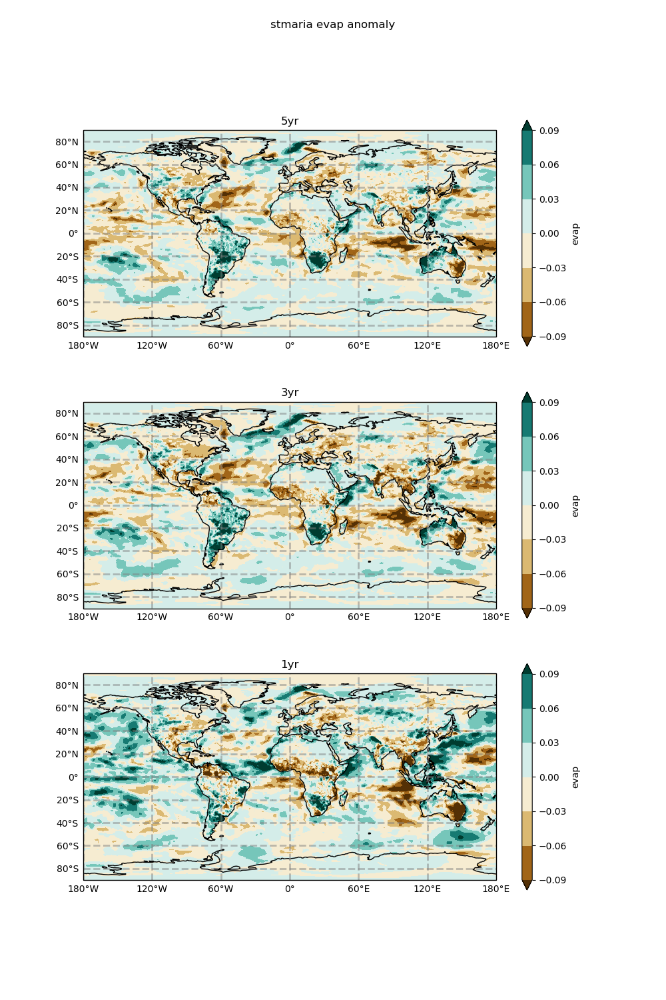

In [38]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da = da_stmaria_e.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_stmaria3 = da_stmaria_e[:,5:41]
da3 = da_stmaria3.mean('time') - da_ctl_e.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_stmaria1 = da_stmaria_e[:,5:17]
da1 = da_stmaria1.mean('time') - da_ctl_e.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('stmaria evap anomaly')




### Sahel evap anomaly

<IPython.core.display.Javascript object>


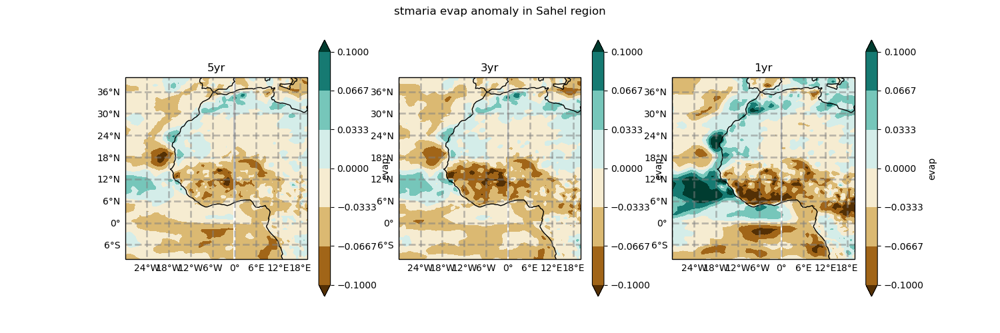

In [39]:
#using cartopy, local

plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da = da_stmaria_e.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.1, vmax=0.1)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da = da_stmaria3.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.1, vmax=0.1)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
#da_stmaria1 = da_stmaria[:,5:17]
da = da_stmaria1.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG',vmin=-0.1, vmax=0.1)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('stmaria evap anomaly in Sahel region')




### Sahel evap time series

In [31]:
da_ctl_e['time']=da_stmaria_e['time']
da_ctl_s = da_ctl_e.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

# select sahel region
da_s_s = da_stmaria_e.mean('en').isel(lon=(da_stmaria.lon<=10)|(da_stmaria.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_s_s = da_s_s - da_ctl_s
da_s_s.plot()



### Sahel monthly climatology

In [32]:
s_clim = da_s_s.groupby('time.month').mean('time')
da_s_s.groupby('time.month').mean('time').plot()


## Agung

In [180]:
# avg time and ensembles, plot AGUNG evap
da_agung_e = agung_e * scale_factor_e

### Global evap anomaly

<IPython.core.display.Javascript object>


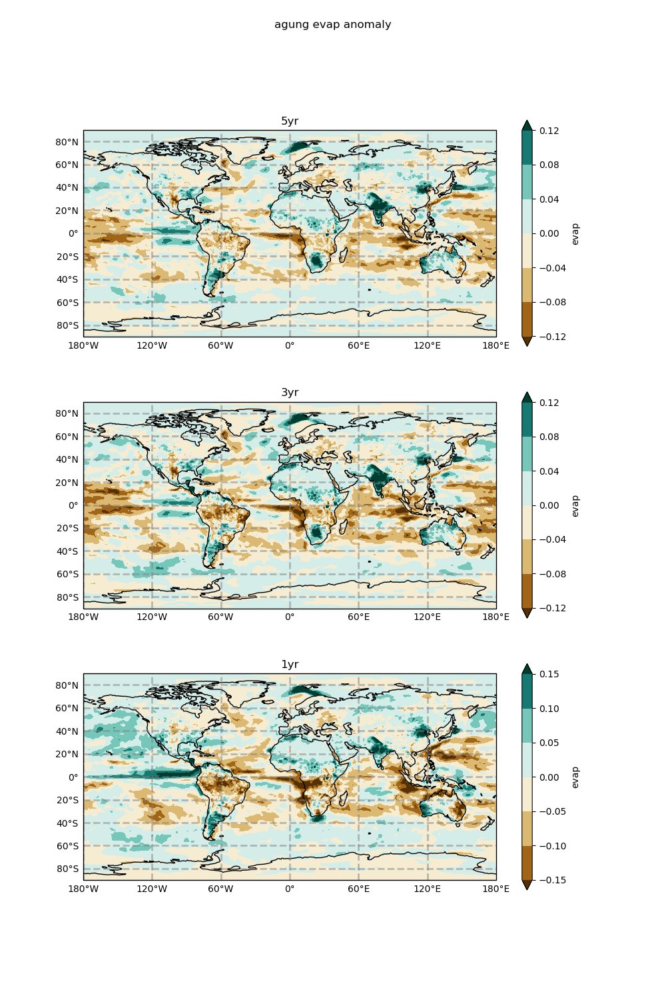

In [43]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da = da_agung_e.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_agung3 = da_agung_e[:,5:41]
da3 = da_agung3.mean('time') - da_ctl_e.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_agung1 = da_agung_e[:,5:17]
da1 = da_agung1.mean('time') - da_ctl_e.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('agung evap anomaly')




### Sahel evap anomaly

<IPython.core.display.Javascript object>


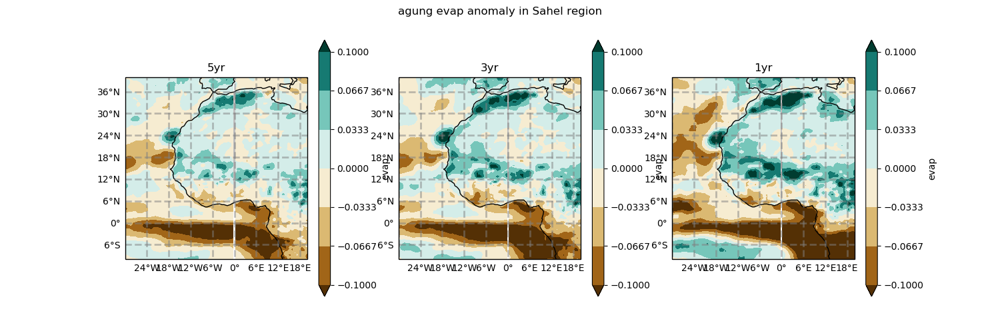

In [44]:
#using cartopy, local

plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da = da_agung_e.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.1, vmax=0.1)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da = da_agung3.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG', vmin=-0.1, vmax=0.1)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
#da_agung1 = da_agung[:,5:17]
da = da_agung1.mean('time') - da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG',vmin=-0.1, vmax=0.1)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('agung evap anomaly in Sahel region')




### Sahel evap time series

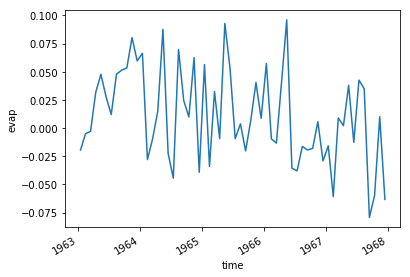

In [35]:
da_ctl_e['time']=da_agung_e['time']
da_ctl_s = da_ctl_e.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

# select sahel region
da_a_s = da_agung_e.mean('en').isel(lon=(da_agung.lon<=10)|(da_agung.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_a_s = da_a_s - da_ctl_s
da_a_s.plot()
#


### Sahel monthly climatology

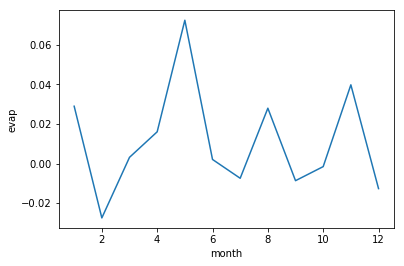

In [36]:
a_clim = da_a_s.groupby('time.month').mean('time')
da_a_s.groupby('time.month').mean('time').plot()


## All 3 monthly  evap climatologies

Text(0.5, 1.0, 'Monthly evaporation climatology in Sahel, 5-year average')

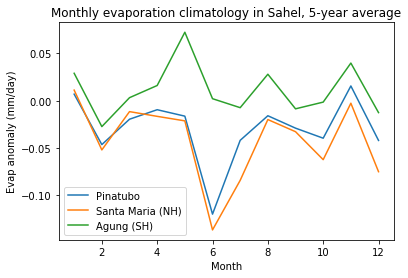

In [38]:
plt.plot(p_clim.month, p_clim, label='Pinatubo')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)')
plt.plot(a_clim.month, a_clim, label='Agung (SH)')
plt.legend()
plt.xlabel('Month')
plt.ylabel('Evap anomaly (mm/day)')
plt.title('Monthly evaporation climatology in Sahel, 5-year average')


In [182]:
da_ctl_e['time'] = da_pinatubo_e['time']
da_pinatubo_e_ms = (da_pinatubo_e - da_ctl_e).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

da_ctl_e['time'] = da_stmaria_e['time']
da_stmaria_e_ms = (da_stmaria_e - da_ctl_e).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

da_ctl_e['time'] = da_agung_e['time']
da_agung_e_ms = (da_agung_e - da_ctl_e).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

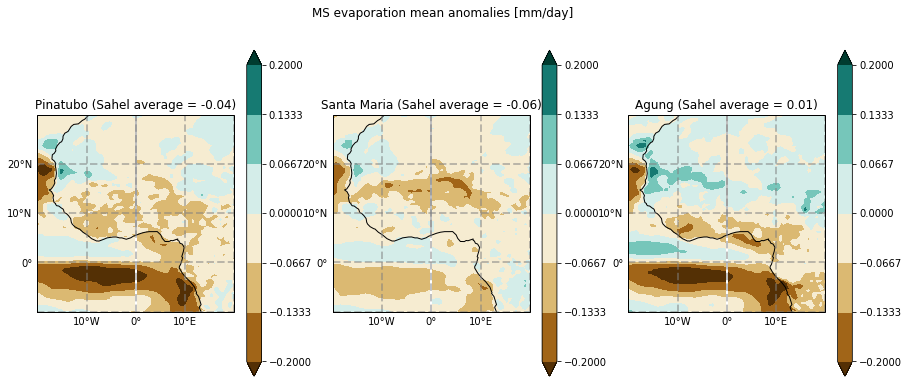

In [188]:
da = [da_pinatubo_e_ms, da_stmaria_e_ms, da_agung_e_ms]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(da_ctl.lon<=16)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
titles = ['Pinatubo (Sahel average = %.2f)' %da_s[0], 'Santa Maria (Sahel average = %.2f)' %da_s[1], 'Agung (Sahel average = %.2f)' %da_s[2]]


# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(1, 3, figsize=(15,6))


# for ii, ax in enumerate(f.axes.flat):
for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    da[ii].plot.contourf(robust=True, cmap='BrBG',vmin=-0.2, vmax=0.2, add_labels=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

plt.suptitle('MS evaporation mean anomalies [mm/day]')
plt.savefig('ms_evap.png')

# Precip - Evap

## Pinatubo

### Global P-E anomaly

Text(0.5,0.98,'Pinatubo P-E anomaly')

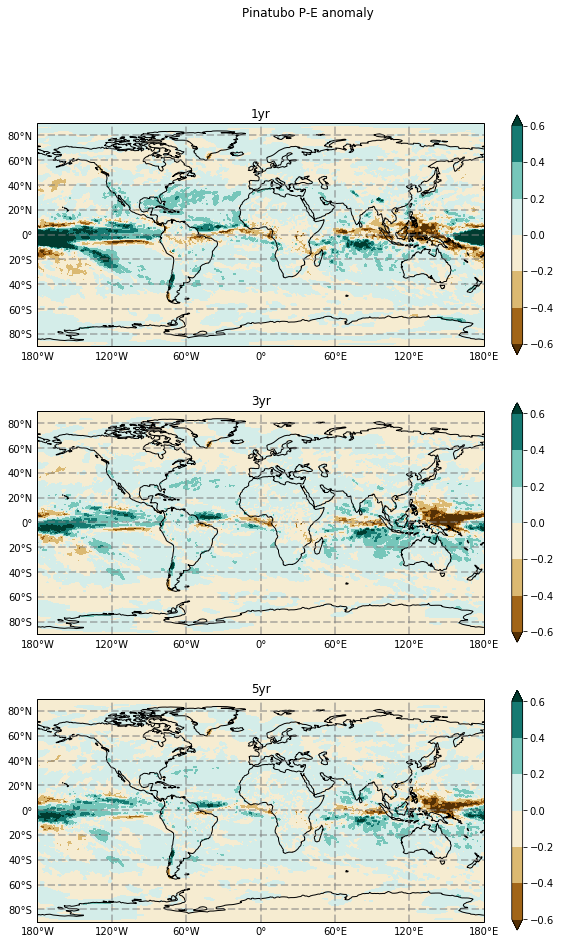

In [187]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da = da_pinatubo.mean('time')-da_ctl.mean('time')-da_pinatubo_e.mean('time')+da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_pinatubo3 = da_pinatubo[:,5:41]
da_pinatubo3_e = da_pinatubo_e[:,5:41]
da3 = da_pinatubo3.mean('time')-da_ctl.mean('time')-da_pinatubo3_e.mean('time')+da_ctl_e.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax3.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_pinatubo1 = da_pinatubo[:,5:17]
da_pinatubo1_e = da_pinatubo_e[:,5:17]
da1 = da_pinatubo1.mean('time')-da_ctl.mean('time')-da_pinatubo1_e.mean('time')+da_ctl_e.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG',vmin=-0.6, vmax=0.6)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('Pinatubo P-E anomaly')



### Sahel P-E anomaly

<IPython.core.display.Javascript object>


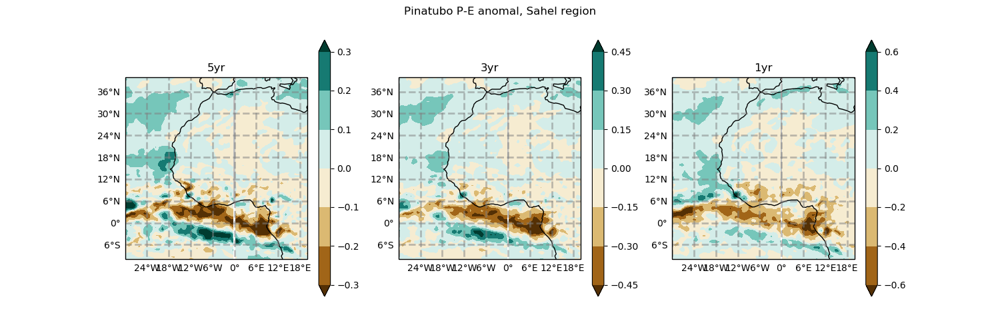

In [49]:
#using cartopy, global

plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da = da_pinatubo.mean('time')-da_ctl.mean('time')-da_pinatubo_e.mean('time')+da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG',vm)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da_pinatubo3 = da_pinatubo[:,5:41]
da_pinatubo3_e = da_pinatubo_e[:,5:41]
da3 = da_pinatubo3.mean('time')-da_ctl.mean('time')-da_pinatubo3_e.mean('time')+da_ctl_e.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da_pinatubo1 = da_pinatubo[:,5:17]
da_pinatubo1_e = da_pinatubo_e[:,5:17]
da1 = da_pinatubo1.mean('time')-da_ctl.mean('time')-da_pinatubo1_e.mean('time')+da_ctl_e.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('Pinatubo P-E anomaly, Sahel region')



### Time series (Sahel)

<IPython.core.display.Javascript object>


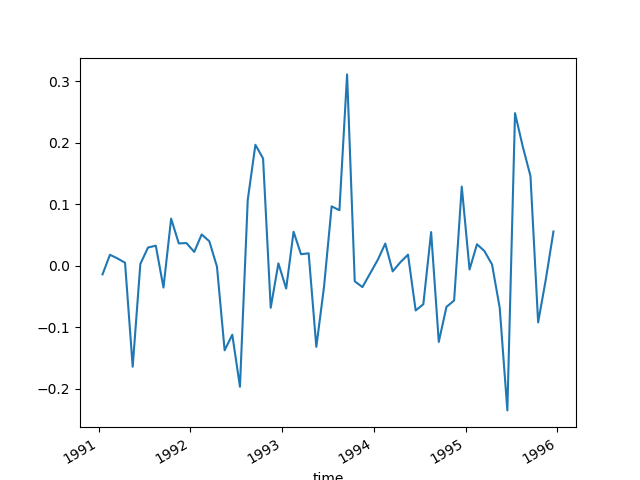

In [50]:
da_ctl['time']=da_pinatubo['time']
da_ctl_e['time']=da_pinatubo_e['time']
da_ctl_s = da_ctl.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_ctl_s_e = da_ctl_e.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

# select sahel region
da_p_s = da_pinatubo.mean('en').isel(lon=(da_pinatubo.lon<=10)|(da_pinatubo.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_p_s_e = da_pinatubo_e.mean('en').isel(lon=(da_pinatubo.lon<=10)|(da_pinatubo.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_p_s = da_p_s - da_ctl_s - da_p_s_e + da_ctl_s_e
da_p_s.plot()




### Monthly Climatology (Sahel)

<IPython.core.display.Javascript object>


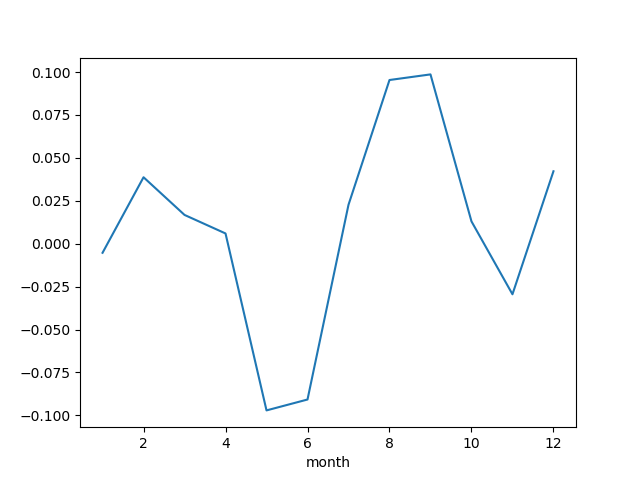

In [51]:
p_clim = da_p_s.groupby('time.month').mean('time')
da_p_s.groupby('time.month').mean('time').plot()


## Santa Maria 

### Global P-E anomaly

<IPython.core.display.Javascript object>


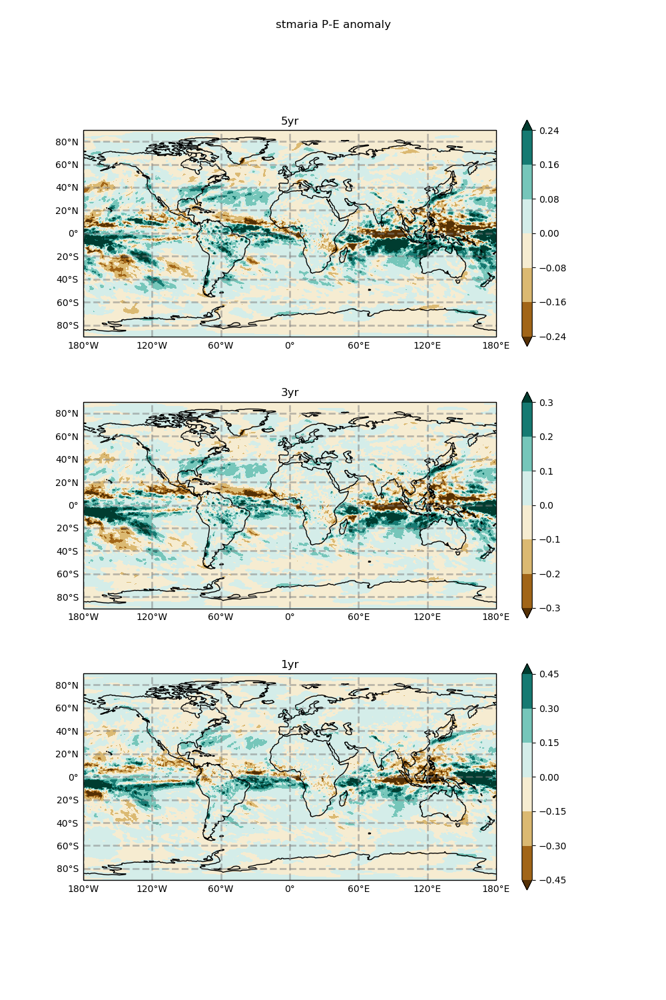

In [52]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da = da_stmaria.mean('time')-da_ctl.mean('time')-da_stmaria_e.mean('time')+da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_stmaria3 = da_stmaria[:,5:41]
da_stmaria3_e = da_stmaria_e[:,5:41]
da3 = da_stmaria3.mean('time')-da_ctl.mean('time')-da_stmaria3_e.mean('time')+da_ctl_e.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_stmaria1 = da_stmaria[:,5:17]
da_stmaria1_e = da_stmaria_e[:,5:17]
da1 = da_stmaria1.mean('time')-da_ctl.mean('time')-da_stmaria1_e.mean('time')+da_ctl_e.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('stmaria P-E anomaly')




### Sahel P-E anomaly

<IPython.core.display.Javascript object>


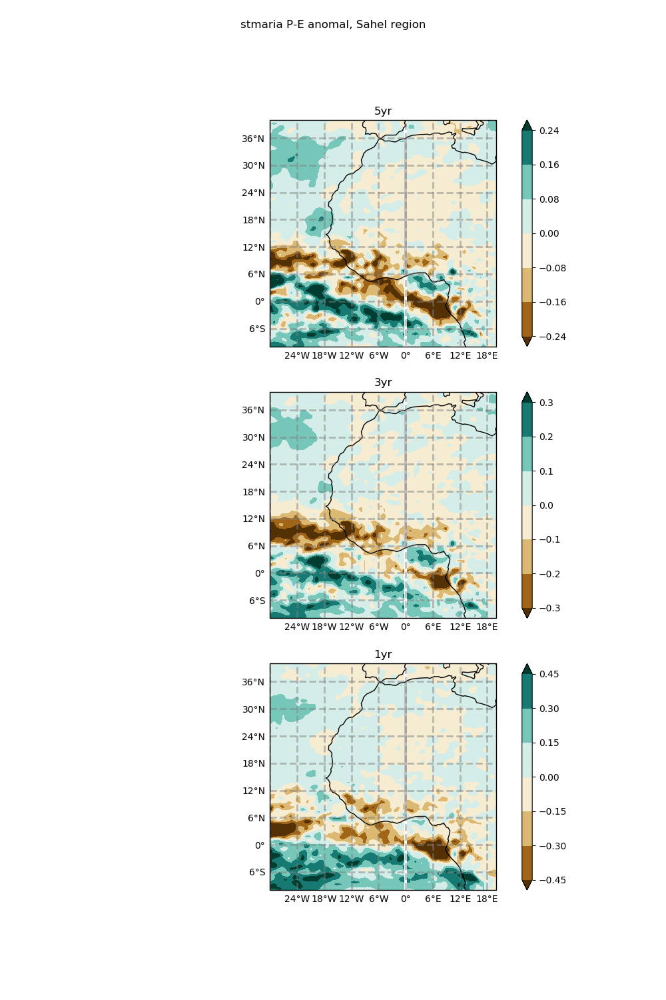

In [53]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da = da_stmaria.mean('time')-da_ctl.mean('time')-da_stmaria_e.mean('time')+da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da_stmaria3 = da_stmaria[:,5:41]
da_stmaria3_e = da_stmaria_e[:,5:41]
da3 = da_stmaria3.mean('time')-da_ctl.mean('time')-da_stmaria3_e.mean('time')+da_ctl_e.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da_stmaria1 = da_stmaria[:,5:17]
da_stmaria1_e = da_stmaria_e[:,5:17]
da1 = da_stmaria1.mean('time')-da_ctl.mean('time')-da_stmaria1_e.mean('time')+da_ctl_e.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('stmaria P-E anomal, Sahel region')




### Sahel time series 

<IPython.core.display.Javascript object>


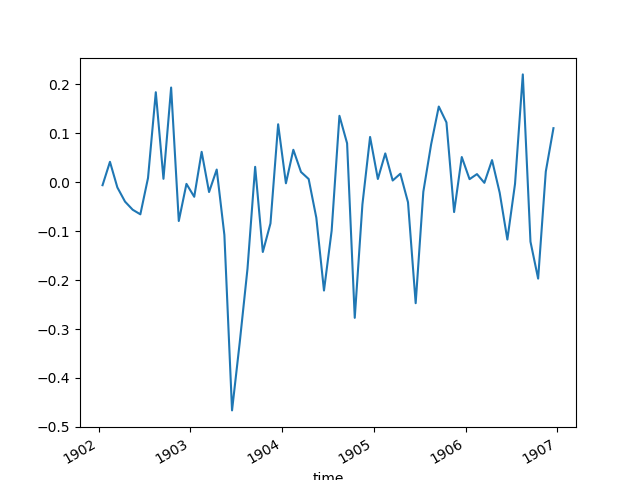

In [54]:
da_ctl['time']=da_stmaria['time']
da_ctl_e['time']=da_stmaria_e['time']
da_ctl_s = da_ctl.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_ctl_s_e = da_ctl_e.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

# select sahel region
da_s_s = da_stmaria.mean('en').isel(lon=(da_stmaria.lon<=10)|(da_stmaria.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_s_s_e = da_stmaria_e.mean('en').isel(lon=(da_stmaria.lon<=10)|(da_stmaria.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_s_s = da_s_s - da_ctl_s - da_s_s_e + da_ctl_s_e
da_s_s.plot()


### Sahel monthly climatology (P-E)

<IPython.core.display.Javascript object>


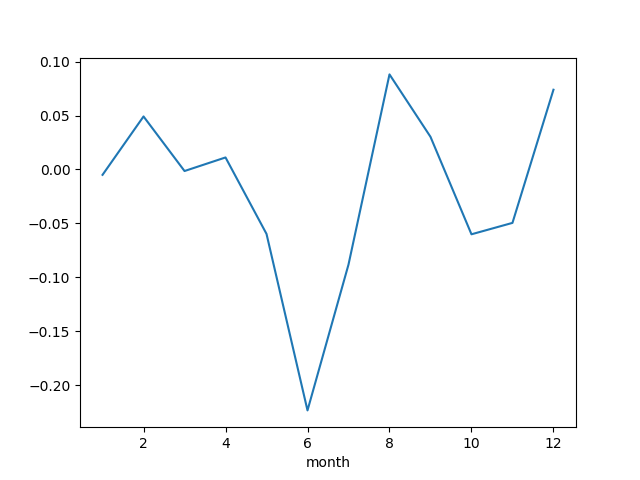

In [55]:
s_clim = da_s_s.groupby('time.month').mean('time')
da_s_s.groupby('time.month').mean('time').plot()


## Agung

### Global P-E anomaly

<IPython.core.display.Javascript object>


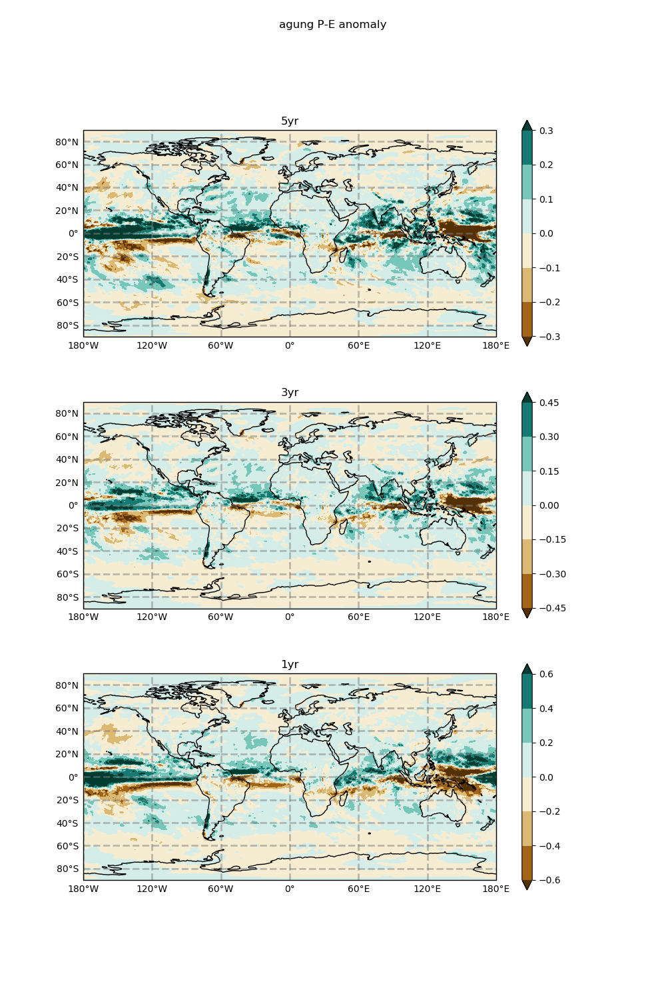

In [56]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da = da_agung.mean('time')-da_ctl.mean('time')-da_agung_e.mean('time')+da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_agung3 = da_agung[:,5:41]
da_agung3_e = da_agung_e[:,5:41]
da3 = da_agung3.mean('time')-da_ctl.mean('time')-da_agung3_e.mean('time')+da_ctl_e.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-180, 180, -90, 90], ccrs.PlateCarree())
da_agung1 = da_agung[:,5:17]
da_agung1_e = da_agung_e[:,5:17]
da1 = da_agung1.mean('time')-da_ctl.mean('time')-da_agung1_e.mean('time')+da_ctl_e.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('agung P-E anomaly')




### Sahel P-E anomaly

<IPython.core.display.Javascript object>


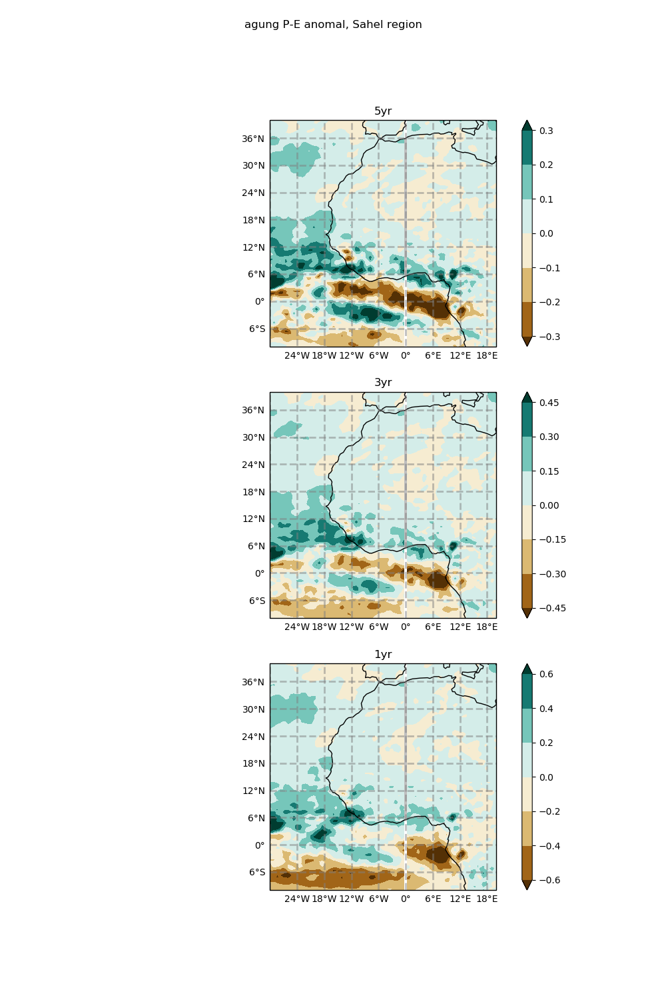

In [57]:
#using cartopy, global

plt.figure(figsize=(10,15))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
ax1.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da = da_agung.mean('time')-da_ctl.mean('time')-da_agung_e.mean('time')+da_ctl_e.mean('time')
da.mean('en').plot.contourf(robust=True, cmap='BrBG')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('5yr')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
ax2.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da_agung3 = da_agung[:,5:41]
da_agung3_e = da_agung_e[:,5:41]
da3 = da_agung3.mean('time')-da_ctl.mean('time')-da_agung3_e.mean('time')+da_ctl_e.mean('time')
da3.mean('en').plot.contourf(robust=True, cmap='BrBG')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('3yr')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
ax3.set_extent([-30, 20, -10, 40], ccrs.PlateCarree())
da_agung1 = da_agung[:,5:17]
da_agung1_e = da_agung_e[:,5:17]
da1 = da_agung1.mean('time')-da_ctl.mean('time')-da_agung1_e.mean('time')+da_ctl_e.mean('time')
da1.mean('en').plot.contourf(robust=True, cmap='BrBG')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('1yr')

plt.suptitle('agung P-E anomal, Sahel region')




### Time series (Sahel)

<IPython.core.display.Javascript object>


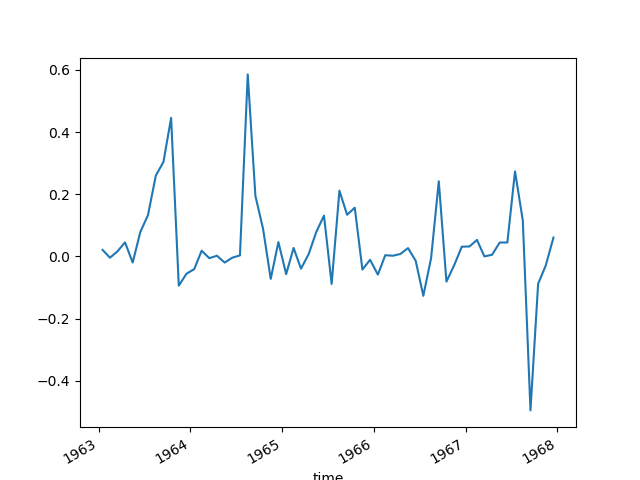

In [58]:
da_ctl['time']=da_agung['time']
da_ctl_e['time']=da_agung_e['time']
da_ctl_s = da_ctl.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_ctl_s_e = da_ctl_e.mean('en').isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

# select sahel region
da_a_s = da_agung.mean('en').isel(lon=(da_agung.lon<=10)|(da_agung.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_a_s_e = da_agung_e.mean('en').isel(lon=(da_agung.lon<=10)|(da_agung.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_a_s = da_a_s - da_ctl_s - da_a_s_e + da_ctl_s_e
da_a_s.plot()


### Monthly climatology (Sahel)

<IPython.core.display.Javascript object>


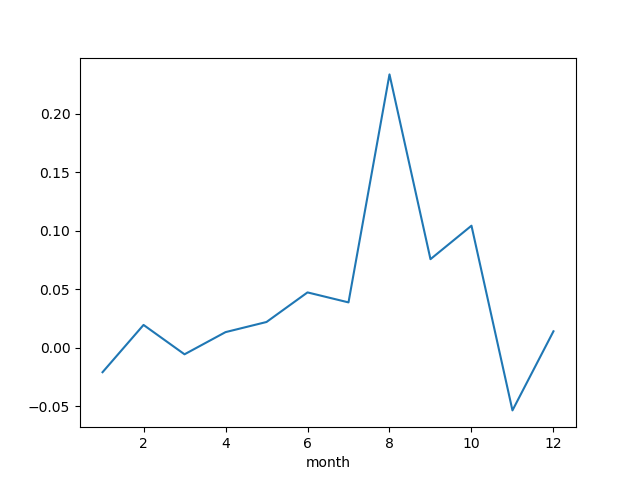

In [59]:
a_clim = da_a_s.groupby('time.month').mean('time')
da_a_s.groupby('time.month').mean('time').plot()


## Monthly climatologies (together)

<IPython.core.display.Javascript object>


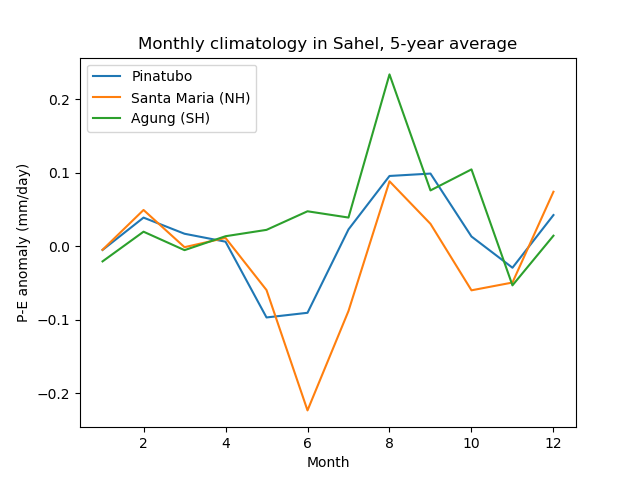

In [60]:
plt.plot(p_clim.month, p_clim, label='Pinatubo')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)')
plt.plot(a_clim.month, a_clim, label='Agung (SH)')
plt.legend()
plt.xlabel('Month')
plt.ylabel('P-E anomaly (mm/day)')
plt.title('Monthly climatology in Sahel, 5-year average')


# MSE = c$_p$T + gZ + Lq

## 850 hPa

In [58]:
pinatubo_sphum850 = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.sphum.850hPa.nc/') 
stmaria_sphum850 = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.sphum.850hPa.nc/') 
agung_sphum850 = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.sphum.850hPa.nc/')
ctl_sphum850 = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.sphum.850hPa.nc/') 

pinatubo_temp850 = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.temp.850hPa.nc/') 
stmaria_temp850 = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.temp.850hPa.nc/') 
agung_temp850 = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.temp.850hPa.nc/')
ctl_temp850 = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.temp.850hPa.nc/') 

pinatubo_z850 = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.z_full.850hPa.nc/') 
stmaria_z850 = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.z_full.850hPa.nc/') 
agung_z850 = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.z_full.850hPa.nc/')
ctl_z850 = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.z_full.850hPa.nc/') 


In [59]:
# check c_p values
c_p = 1004 #J/kgK
L = 2.5e6 #J/kg
g = 9.8 #m/s^2

In [60]:
pinatubo_MSE850 = c_p*pinatubo_temp850 + L*pinatubo_sphum850 + g*pinatubo_z850
stmaria_MSE850 = c_p*stmaria_temp850 + L*stmaria_sphum850 + g*stmaria_z850
agung_MSE850 = c_p*agung_temp850 + L*agung_sphum850 + g*agung_z850
ctl_MSE850 = c_p*ctl_temp850 + L*ctl_sphum850 + g*ctl_z850

In [61]:
# subtract ctl
ctl_MSE850['time']=pinatubo_MSE850['time']
ctl_sphum850['time']=pinatubo_sphum850['time']
pinatubo_MSE850 = pinatubo_MSE850 - ctl_MSE850
pinatubo_lq850 =  L*pinatubo_sphum850 - L*ctl_sphum850

ctl_MSE850['time']=stmaria_MSE850['time']
ctl_sphum850['time']=stmaria_sphum850['time']
stmaria_MSE850 = stmaria_MSE850 - ctl_MSE850
stmaria_lq850 =  L*stmaria_sphum850 - L*ctl_sphum850

ctl_MSE850['time']=agung_MSE850['time']
ctl_sphum850['time']=agung_sphum850['time']
agung_MSE850 = agung_MSE850 - ctl_MSE850
agung_lq850 =  L*agung_sphum850 - L*ctl_sphum850


In [35]:
pinatubo_MSE850_jja = pinatubo_MSE850.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_MSE850_jja = stmaria_MSE850.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_MSE850_jja = agung_MSE850.groupby('time.season').mean(['time','en']).sel(season='JJA')

Text(0.5, 0.98, 'MSE$_{850hPa}$ anomaly [J/kg]')

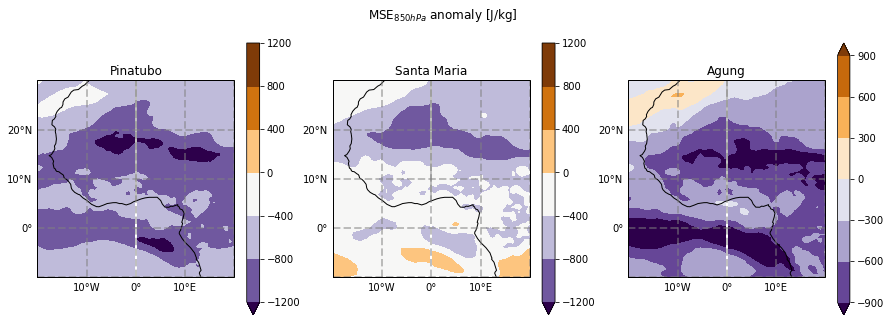

In [108]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
pinatubo_MSE850_jja.plot.contourf(robust=True, cmap='PuOr_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
stmaria_MSE850_jja.plot.contourf(robust=True, cmap='PuOr_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
agung_MSE850_jja.plot.contourf(robust=True, cmap='PuOr_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('MSE$_{850hPa}$ anomaly [J/kg]')

In [109]:
agung_MSE850_jja-stmaria_MSE850_jja

<xarray.DataArray (lat: 360, lon: 576)>
array([[-70.34938 , -70.34938 , -70.34938 , ..., -70.34938 , -70.34938 ,
        -70.34938 ],
       [-79.319885, -79.26521 , -79.20947 , ..., -79.48398 , -79.42999 ,
        -79.375656],
       [-83.25667 , -83.239685, -83.22247 , ..., -83.31093 , -83.29323 ,
        -83.27518 ],
       ...,
       [224.81937 , 224.84064 , 224.85757 , ..., 224.76492 , 224.78354 ,
        224.8016  ],
       [229.1441  , 229.20743 , 229.2702  , ..., 228.95819 , 229.01895 ,
        229.08243 ],
       [239.42792 , 239.42792 , 239.42792 , ..., 239.42792 , 239.42792 ,
        239.42792 ]], dtype=float32)
Coordinates:
  * lat      (lat) float64 -89.75 -89.25 -88.75 -88.25 ... 88.75 89.25 89.75
  * lon      (lon) float64 0.3125 0.9375 1.562 2.188 ... 357.8 358.4 359.1 359.7
    pfull    int64 850
    season   <U3 'JJA'

## 200 hPa

In [62]:
pinatubo_sphum200 = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.sphum.200hPa.nc/') 
stmaria_sphum200 = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.sphum.200hPa.nc/') 
agung_sphum200 = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.sphum.200hPa.nc/')
ctl_sphum200 = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.sphum.200hPa.nc/') 

pinatubo_temp200 = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.temp.200hPa.nc/') 
stmaria_temp200 = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.temp.200hPa.nc/') 
agung_temp200 = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.temp.200hPa.nc/')
ctl_temp200 = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.temp.200hPa.nc/')

pinatubo_z200 = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.z_full.200hPa.nc/') 
stmaria_z200 = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.z_full.200hPa.nc/') 
agung_z200 = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.z_full.200hPa.nc/')
ctl_z200 = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.z_full.200hPa.nc/') 

In [63]:
pinatubo_MSE200 = c_p*pinatubo_temp200 + L*pinatubo_sphum200 + g*pinatubo_z200
stmaria_MSE200 = c_p*stmaria_temp200 + L*stmaria_sphum200 + g*stmaria_z200
agung_MSE200 = c_p*agung_temp200 + L*agung_sphum200 + g*agung_z200
ctl_MSE200 = c_p*ctl_temp200 + L*ctl_sphum200 + g*ctl_z200


In [64]:
# subtract ctl
ctl_MSE200['time']=pinatubo_MSE200['time']
ctl_sphum200['time']=pinatubo_sphum200['time']
pinatubo_MSE200 = pinatubo_MSE200 - ctl_MSE200
pinatubo_lq200 =  L*pinatubo_sphum200 - L*ctl_sphum200

ctl_MSE200['time']=stmaria_MSE200['time']
ctl_sphum200['time']=stmaria_sphum200['time']
stmaria_MSE200 = stmaria_MSE200 - ctl_MSE200
stmaria_lq200 =  L*stmaria_sphum200 - L*ctl_sphum200

ctl_MSE200['time']=agung_MSE200['time']
ctl_sphum200['time']=agung_sphum200['time']
agung_MSE200 = agung_MSE200 - ctl_MSE200
agung_lq200 =  L*agung_sphum200 - L*ctl_sphum200

## 200 - 850

In [65]:
pinatubo_stab = pinatubo_MSE200 - pinatubo_MSE850
stmaria_stab = stmaria_MSE200 - stmaria_MSE850
agung_stab = agung_MSE200 - agung_MSE850

pinatubo_stab_lq = pinatubo_lq200 - pinatubo_lq850
stmaria_stab_lq = stmaria_lq200 - stmaria_lq850
agung_stab_lq = agung_lq200 - agung_lq850

pinatubo_stab_jja = pinatubo_stab.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_stab_jja = stmaria_stab.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_stab_jja = agung_stab.groupby('time.season').mean(['time','en']).sel(season='JJA')

In [40]:
pinatubo_stab_jja_m = pinatubo_stab.groupby('time.month').mean('time')[:,5:8].mean(['en'])
stmaria_stab_jja_m = stmaria_stab.groupby('time.month').mean('time')[:,5:8].mean(['en'])
agung_stab_jja_m = agung_stab.groupby('time.month').mean('time')[:,5:8].mean(['en'])

In [243]:
pinatubo_stab_ms = pinatubo_stab[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_stab_ms, 0)
pinatubo_stab_ms=pinatubo_stab_ms.mean('en').load()
pvalue_p = xr.DataArray(pp, dims=pinatubo_stab_ms.dims, coords=[pinatubo_stab_ms[dim] for dim in list(pinatubo_stab_ms.dims)])

stmaria_stab_ms = stmaria_stab[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_stab_ms, 0)
stmaria_stab_ms=stmaria_stab_ms.mean('en').load()
pvalue_s = xr.DataArray(pp, dims=pinatubo_stab_ms.dims, coords=[pinatubo_stab_ms[dim] for dim in list(pinatubo_stab_ms.dims)])

agung_stab_ms = agung_stab[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_stab_ms, 0)
agung_stab_ms=agung_stab_ms.mean('en').load()
pvalue_a = xr.DataArray(pp, dims=pinatubo_stab_ms.dims, coords=[pinatubo_stab_ms[dim] for dim in list(pinatubo_stab_ms.dims)])



In [42]:
pinatubo_stab_lq_ms = pinatubo_stab_lq.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_stab_lq_ms = stmaria_stab_lq.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_stab_lq_ms = agung_stab_lq.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

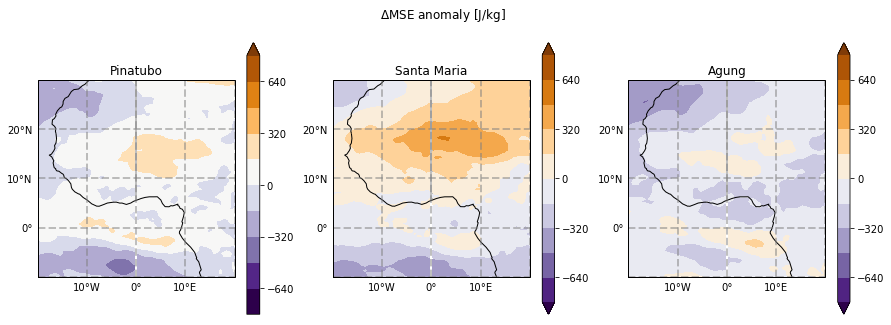

In [16]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
pinatubo_stab.mean(['en','time']).plot.contourf(robust=True, center=0,  vmin = -800, vmax=800, levels=11,cmap='PuOr_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
stmaria_stab.mean(['en','time']).plot.contourf(robust=True, center=0,  vmin = -800, vmax=800, levels=11,cmap='PuOr_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
agung_stab.mean(['en','time']).plot.contourf(robust=True, center=0,  vmin = -800, vmax=800, levels=11,cmap='PuOr_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('$\Delta$MSE anomaly [J/kg]')
#plt.savefig('del_mse.png')

Text(0.5,0.98,'MS $\\Delta$MSE anomaly [J/kg]')

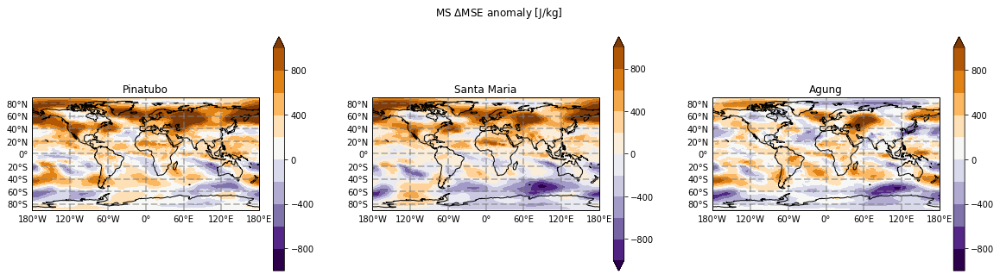

In [66]:
plt.figure(figsize=(20,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
#ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
pinatubo_stab_ms.plot.contourf(robust=True, center=0, vmin = -1000, vmax=1000,levels=11,cmap='PuOr_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
#gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
#gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
#ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
stmaria_stab_ms.plot.contourf(robust=True, center=0, vmin = -1000, vmax=1000,levels = 11, cmap='PuOr_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
#g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
#g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
#ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
agung_stab_ms.plot.contourf(robust=True, center=0,  vmin = -1000, vmax=1000, levels=11,cmap='PuOr_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
#g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
#g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('MS $\Delta$MSE anomaly [J/kg]')


In [119]:
pinatubo_stab_trop = pinatubo_stab_ms.sel(lat=slice(-20,20)).mean(['lon','lat'])
stmaria_stab_trop = stmaria_stab_ms.sel(lat=slice(-20,20)).mean(['lon','lat'])
agung_stab_trop = agung_stab_ms.sel(lat=slice(-20,20)).mean(['lon','lat'])

In [ ]:
pinatubo_stab.isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

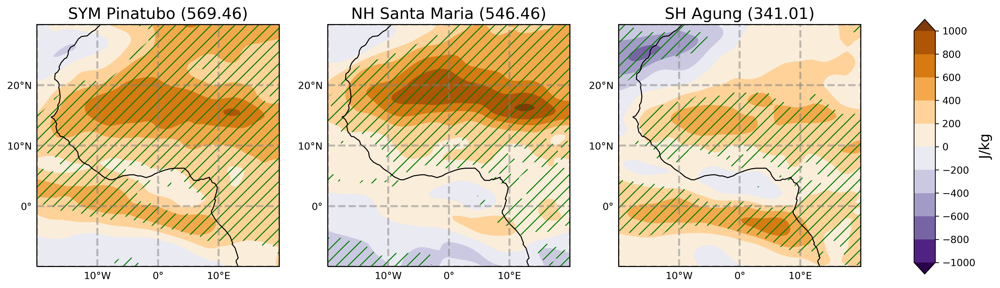

In [244]:
fig = plt.figure(figsize=(15,6))
levels=[-1000,-800,-600,-400,-200,0,200,400,600,800,1000]

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_stab_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both',cmap='PuOr_r', add_colorbar=False)
shift_longitude(pvalue_p.where(pvalue_p<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo (%.2f)' %pinatubo_stab_ms.isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']),fontsize=16)

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_stab_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap='PuOr_r', add_colorbar=False)
shift_longitude(pvalue_s.where(pvalue_s<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria (%.2f)' %stmaria_stab_ms.isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']),fontsize=16)

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_stab_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both',cmap='PuOr_r', add_colorbar=False)
shift_longitude(pvalue_a.where(pvalue_a<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung (%.2f)' %agung_stab_ms.isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']), fontsize=16)

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical').set_label(label='J/kg',size=14)

#plt.suptitle('MS $\Delta$MSE anomaly [J/kg]')
plt.savefig('del_mse_ms_smooth.png',bbox_inches='tight')

/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/dataarray.py:2710: FutureWarning: roll_coords will be set to False in the future. Explicitly set roll_coords to silence warning.
  shifts=shifts, roll_coords=roll_coords, **shifts_kwargs


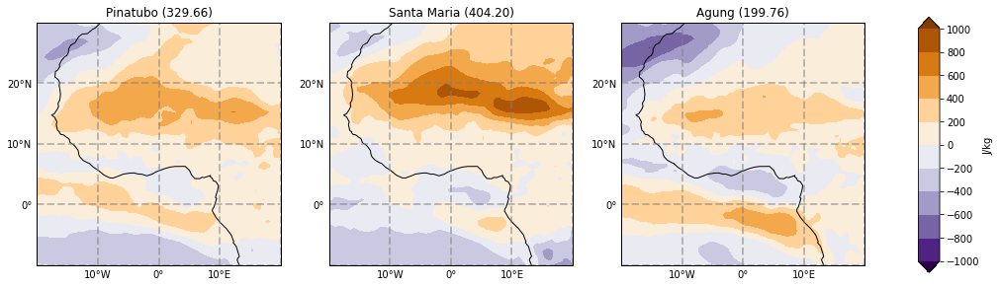

In [121]:
fig = plt.figure(figsize=(15,6))
levels=[-1000,-800,-600,-400,-200,0,200,400,600,800,1000]

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_stab_ms-pinatubo_stab_trop).plot.contourf(robust=True, levels=levels,extend='both',cmap='PuOr_r', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo (%.2f)' %(pinatubo_stab_ms-pinatubo_stab_trop).isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_stab_ms-stmaria_stab_trop).plot.contourf(robust=True, levels=levels,extend='both', cmap='PuOr_r', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria (%.2f)' %(stmaria_stab_ms-stmaria_stab_trop).isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_stab_ms-agung_stab_trop).plot.contourf(robust=True, levels=levels,extend='both',cmap='PuOr_r', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung (%.2f)' %(agung_stab_ms-agung_stab_trop).isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical',label='J/kg')

#plt.suptitle('MS $\Delta$MSE anomaly - trop avg [J/kg]')


In [62]:
pinatubo_stab.isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat','en','time'])

<xarray.DataArray ()>
array(197.95485, dtype=float32)

/home/tessj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:46: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


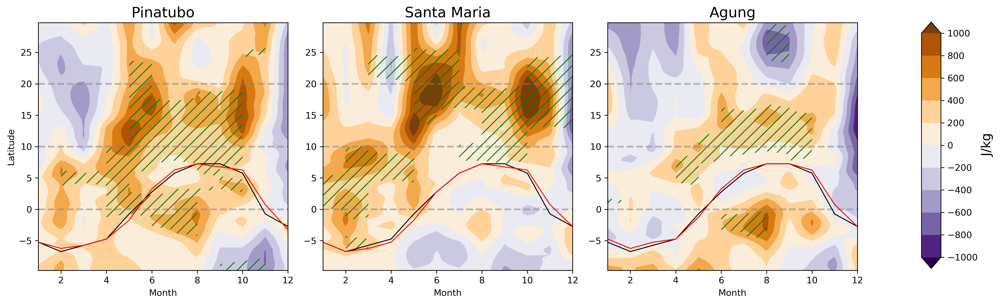

In [245]:
da_pinatubo_mse_za = (pinatubo_stab)[:,12:].groupby('time.month').mean(['time'])



da_stmaria_mse_za = (stmaria_stab)[:,12:].groupby('time.month').mean(['time'])



da_agung_mse_za = (agung_stab)[:,:48].groupby('time.month').mean(['time'])


da = [da_pinatubo_mse_za, da_stmaria_mse_za, da_agung_mse_za]
levels=[-1000,-800,-600,-400,-200,0,200,400,600,800,1000]

da_za = [0,1,2]
pvalue=[0,0,0]
for i in da_za:
    da_za[i] = da[i].isel(lon=(da_pinatubo_mse_za.lon<=10)|(da_pinatubo_mse_za.lon>=340)).sel(lat=slice(-10,30)).mean(['lon'])
    tt, pp = ttest_1samp(da_za[i], 0)
    da_za[i] = da_za[i].mean('en').load()
    pvalue[i] = xr.DataArray(pp, dims=da_za[i].dims, coords=[da_za[i][dim] for dim in da_za[i].dims])


fig, axes = plt.subplots(1, 3, figsize=(15,6))
titles = ['Pinatubo','Santa Maria', 'Agung']

# for ii, ax in enumerate(f.axes.flat):
for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1)
    im = da_za[ii].plot.contourf(y='lat',robust=True, cmap='PuOr_r',levels=levels,extend='both', add_colorbar=False)
    pvalue[ii].where(pvalue[ii]<0.05).pipe(lambda x:x*0).plot.contourf(y='lat',colors='None', hatches=['//'], add_colorbar=False, add_labels=False)
    ax.axhline(0, lw = 2, color='gray', alpha=.5, linestyle='--')
    ax.axhline(10, lw = 2, color='gray', alpha=.5, linestyle='--')
    ax.axhline(20, lw = 2, color='gray', alpha=.5, linestyle='--')
    da_max[0].plot(c='k',lw=1)
    da_max[ii+1].plot(c='r', lw=1)
    if ii==0:
        ax.set_ylabel('Latitude')
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Month')
    ax.set_title(titles[ii],fontsize=16)

ax = fig.add_axes((.95,.1,.02,.635))
plt.colorbar(im,ticks=levels,cax=ax,orientation='vertical',extend='both').set_label(label='J/kg',size=14)
plt.tight_layout(rect=(0,0,.9,.8))

#plt.suptitle('$\Delta$MSE anomaly monthly zonal averages (20W-10E)[J/kg]')
plt.savefig('mse_za.png',bbox_inches='tight')

Text(0.5,0.98,'MS $\\Delta$Lq anomaly [J/kg]')

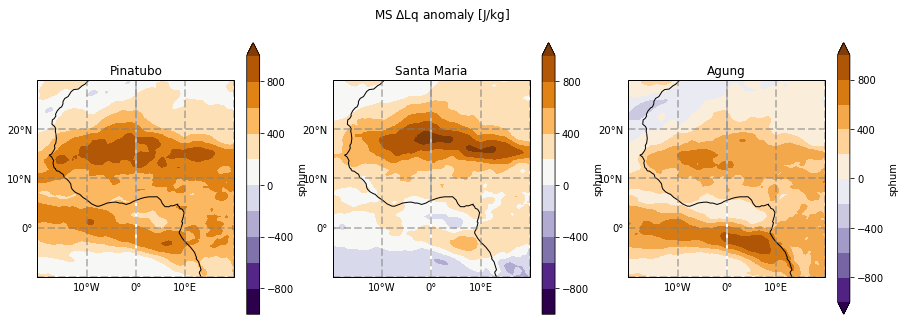

In [91]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
pinatubo_stab_lq_ms.plot.contourf(robust=True, center=0, vmin = -1000, vmax=1000,levels=11,cmap='PuOr_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
stmaria_stab_lq_ms.plot.contourf(robust=True, center=0, vmin = -1000, vmax=1000,levels = 11, cmap='PuOr_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
agung_stab_lq_ms.plot.contourf(robust=True, center=0,  vmin = -1000, vmax=1000, levels=11,cmap='PuOr_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('MS $\Delta$Lq anomaly [J/kg]')
#plt.savefig('del_lq_ms.png')

Text(0.5,0.98,'MS $\\Delta$(c$_p$T + gZ) anomaly [J/kg]')

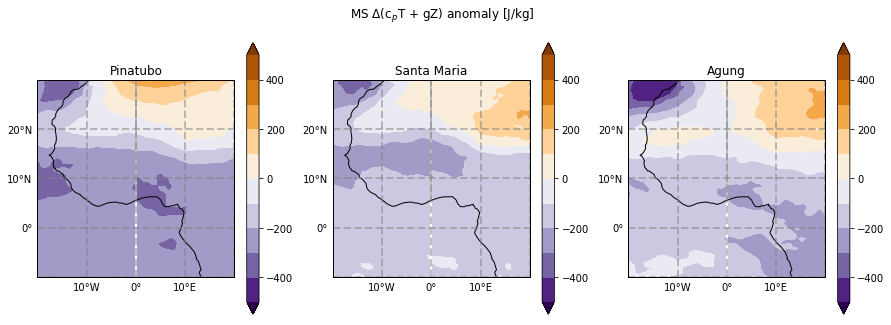

In [94]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_stab_ms-pinatubo_stab_lq_ms).plot.contourf(robust=True, center=0, vmin = -500, vmax=500,levels=11,cmap='PuOr_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_stab_ms - stmaria_stab_lq_ms).plot.contourf(robust=True, center=0, vmin = -500, vmax=500,levels = 11, cmap='PuOr_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_stab_ms - agung_stab_lq_ms).plot.contourf(robust=True, center=0,  vmin = -500, vmax=500, levels=11,cmap='PuOr_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('MS $\Delta$(c$_p$T + gZ) anomaly [J/kg]')
#plt.savefig('del_lq_ms.png')

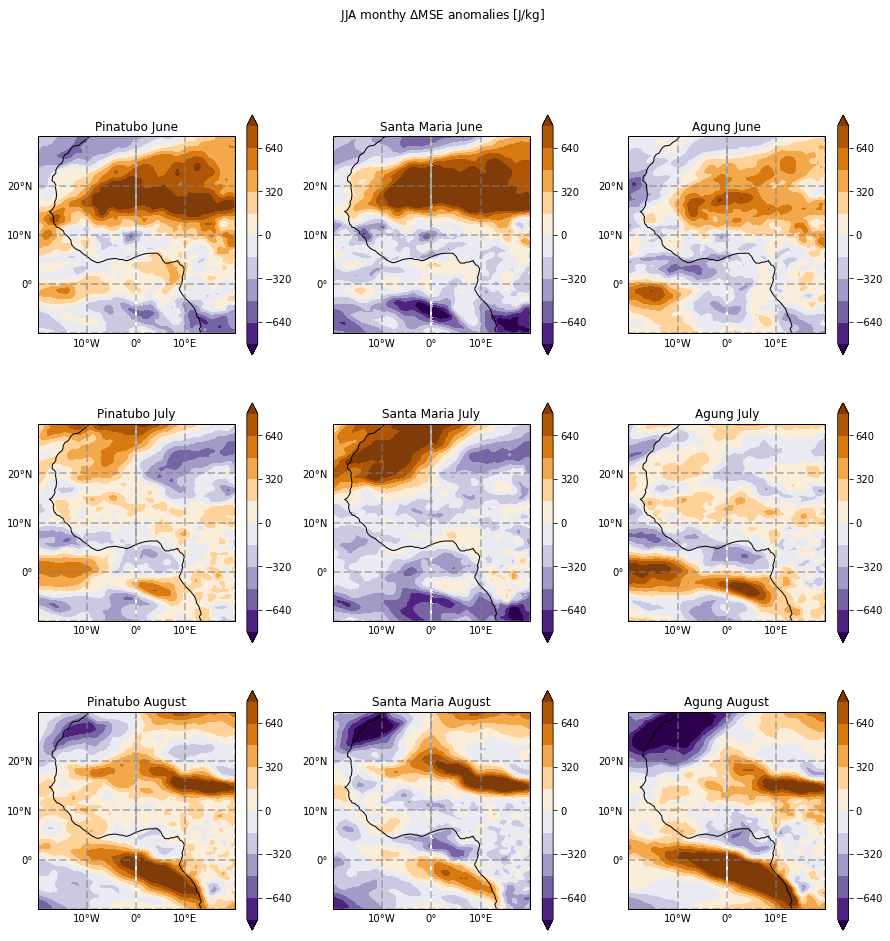

In [19]:
plt.figure(figsize=(15,15))

ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
pinatubo_stab_jja_m[0].plot.contourf(robust=True, center=0, vmin = -800, vmax=800,levels=11,cmap='PuOr_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo June')

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
stmaria_stab_jja_m[0].plot.contourf(robust=True, center=0, vmin = -800, vmax=800,levels = 11, cmap='PuOr_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria June')

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
agung_stab_jja_m[0].plot.contourf(robust=True, center=0,  vmin = -800, vmax=800, levels=11,cmap='PuOr_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung June')


ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
pinatubo_stab_jja_m[1].plot.contourf(robust=True, center=0, vmin = -800, vmax=800,levels=11,cmap='PuOr_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo July')

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
stmaria_stab_jja_m[1].plot.contourf(robust=True, center=0, vmin = -800, vmax=800,levels = 11, cmap='PuOr_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria July')

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
agung_stab_jja_m[1].plot.contourf(robust=True, center=0,  vmin = -800, vmax=800, levels=11,cmap='PuOr_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung July')


ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
pinatubo_stab_jja_m[2].plot.contourf(robust=True, center=0, vmin = -800, vmax=800,levels=11,cmap='PuOr_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo August')

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
stmaria_stab_jja_m[2].plot.contourf(robust=True, center=0, vmin = -800, vmax=800,levels = 11, cmap='PuOr_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria August')

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
agung_stab_jja_m[2].plot.contourf(robust=True, center=0,  vmin = -800, vmax=800, levels=11,cmap='PuOr_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung August')

plt.suptitle('JJA monthy $\Delta$MSE anomalies [J/kg]')
#plt.savefig('del_mse_jja_m.png')

In [3]:
pinatubo_omega = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.omega.500hPa.nc/') 
stmaria_omega = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.omega.500hPa.nc/') 
agung_omega = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.omega.500hPa.nc/')
#ctl_omega = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.sphum.850hPa.nc/') 


## Sahel $\Delta$MSE time series

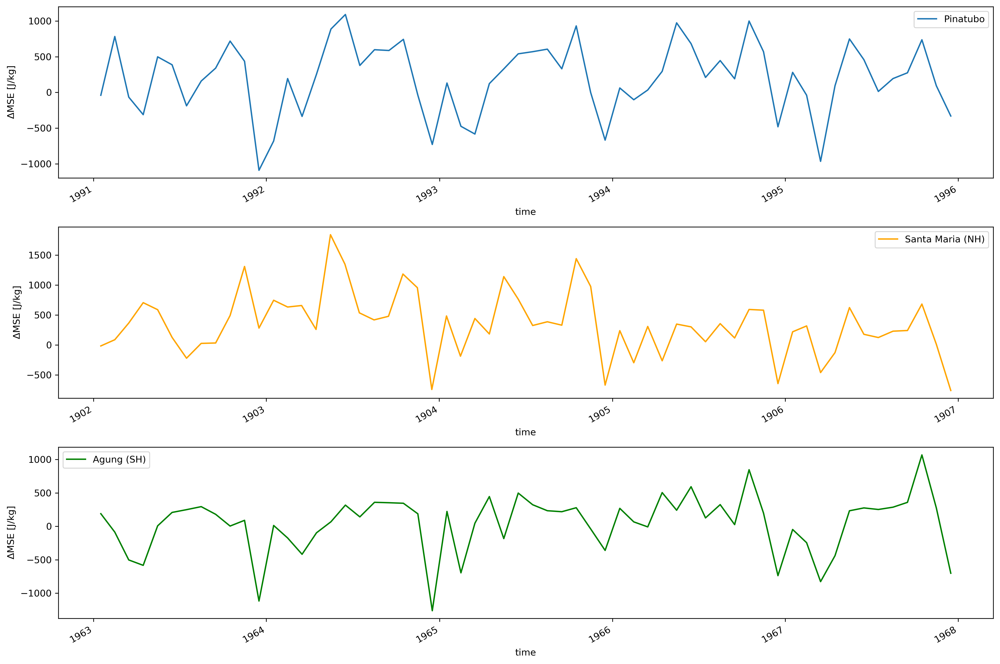

In [92]:
#make monthly climatologies & time series for each volcano of MSE850 - MSE200 
plt.figure(figsize=(15,10))

ax1=plt.subplot(3,1,1)
pinatubo_stab_s = pinatubo_stab.mean('en').isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
pinatubo_stab_s.plot(label='Pinatubo')
plt.legend()
plt.ylabel('$\Delta$MSE [J/kg]')


ax2=plt.subplot(3,1,2)
stmaria_stab_s = stmaria_stab.mean('en').isel(lon=(stmaria_stab.lon<=10)|(stmaria_stab.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
stmaria_stab_s.plot(label='Santa Maria (NH)',color='orange')
plt.legend()
plt.ylabel('$\Delta$MSE [J/kg]')

ax3=plt.subplot(3,1,3)
agung_stab_s = agung_stab.mean('en').isel(lon=(agung_stab.lon<=10)|(agung_stab.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
agung_stab_s.plot(label='Agung (SH)',color='green')
plt.legend()
plt.ylabel('$\Delta$MSE [J/kg]')

plt.tight_layout()


## Sahel $\Delta$MSE monthly climatologies

Text(0.5, 1.0, 'Monthly $\\Delta$MSE anomaly climatology in Sahel, 4-year average')

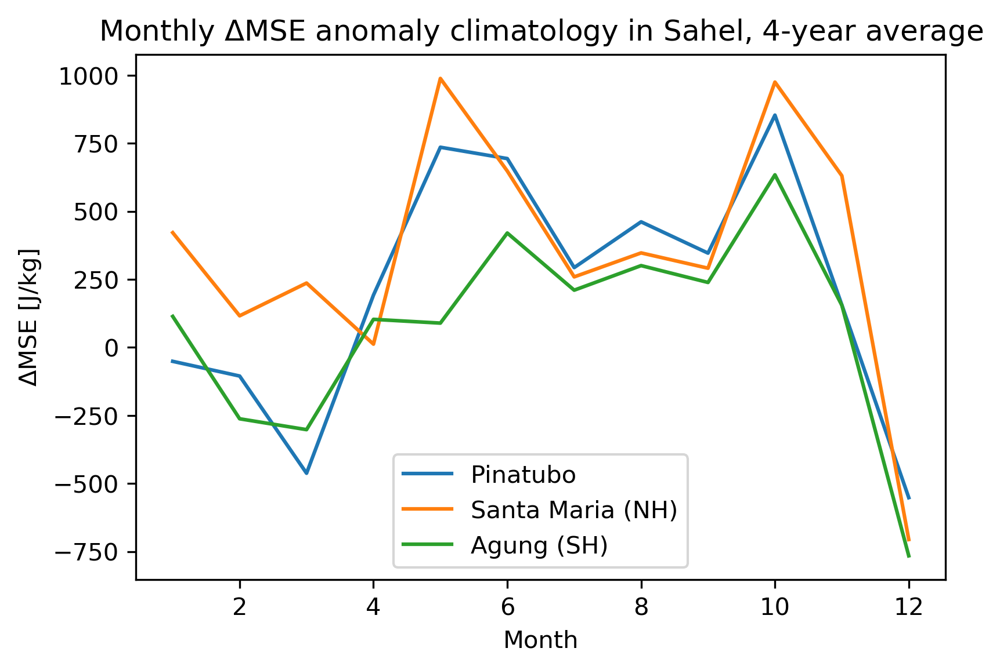

In [93]:
p_clim = pinatubo_stab_s[12:].groupby('time.month').mean('time')
s_clim = stmaria_stab_s[12:].groupby('time.month').mean('time')
a_clim = agung_stab_s[12:].groupby('time.month').mean('time')

plt.plot(p_clim.month, p_clim, label='Pinatubo')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)')
plt.plot(a_clim.month, a_clim, label='Agung (SH)')
plt.legend()
plt.xlabel('Month')
plt.ylabel('$\Delta$MSE [J/kg]')
plt.title('Monthly $\Delta$MSE anomaly climatology in Sahel, 4-year average')


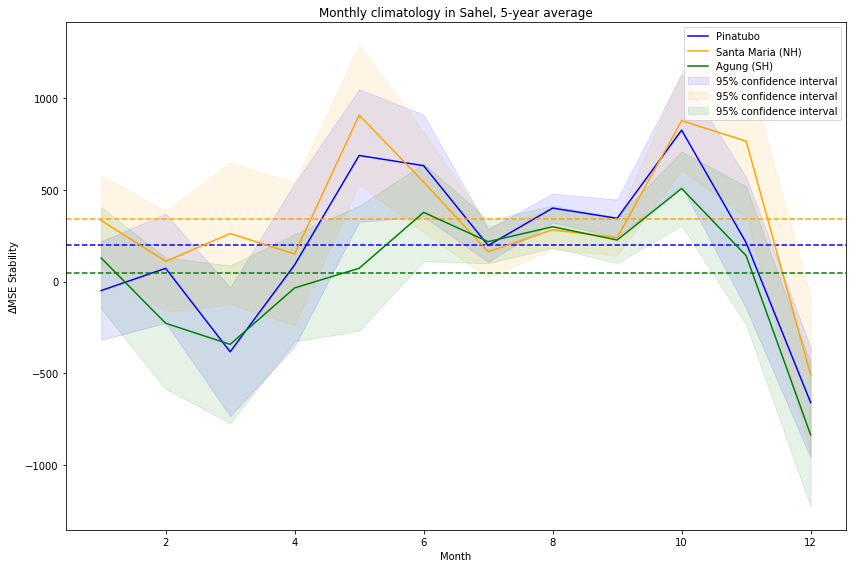

In [80]:
Z = 1.96
n = len(pinatubo_stab.en)

#undo ensemble mean to get confidence intervals
'''da_ctl['time']=da_agung['time']
da_ctl_s = da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
'''
da_p_s = pinatubo_stab.isel(lon=(da_pinatubo.lon<=10)|(da_pinatubo.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_s_s = stmaria_stab.isel(lon=(da_pinatubo.lon<=10)|(da_pinatubo.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_a_s = agung_stab.isel(lon=(da_pinatubo.lon<=10)|(da_pinatubo.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

'''da_ctl['time']=da_pinatubo['time']
da_ctl_s = da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_p_s = da_p_s - da_ctl_s

da_ctl['time']=da_stmaria['time']
da_ctl_s = da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_s_s = da_s_s - da_ctl_s

da_ctl['time']=da_agung['time']
da_ctl_s = da_ctl.isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
da_a_s = da_a_s - da_ctl_s
'''
p_clim = da_p_s.groupby('time.month').mean(['time','en'])
s_clim = da_s_s.groupby('time.month').mean(['time','en'])
a_clim = da_a_s.groupby('time.month').mean(['time','en'])

plt.figure(figsize=[12,8])
plt.plot(p_clim.month, p_clim, label='Pinatubo',color='b')
plt.axhline(y=p_clim.mean(), color='b', linestyle="--")
plt.fill_between(p_clim.month,
        p_clim - (Z * da_p_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        p_clim + (Z * da_p_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='b', alpha=0.1, label='95% confidence interval')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)',color='orange')
plt.fill_between(s_clim.month,
        s_clim - (Z * da_s_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        s_clim + (Z * da_s_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='orange', alpha=0.1, label='95% confidence interval')
plt.axhline(y=s_clim.mean(), color='orange', linestyle="--" )
plt.plot(a_clim.month, a_clim, label='Agung (SH)',color='g')
plt.fill_between(p_clim.month,
        a_clim - (Z * da_a_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        a_clim + (Z * da_a_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='g', alpha=0.1, label='95% confidence interval')
plt.axhline(y=a_clim.mean(), color='g', linestyle="--")


#plt.legend()
plt.xlabel('Month')
plt.ylabel('$\Delta$MSE Stability')
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('Month',size=16)
plt.title('Monthly climatology in Sahel, 5-year average')
plt.tight_layout()
plt.savefig('all3_mse_confidence.png')
#

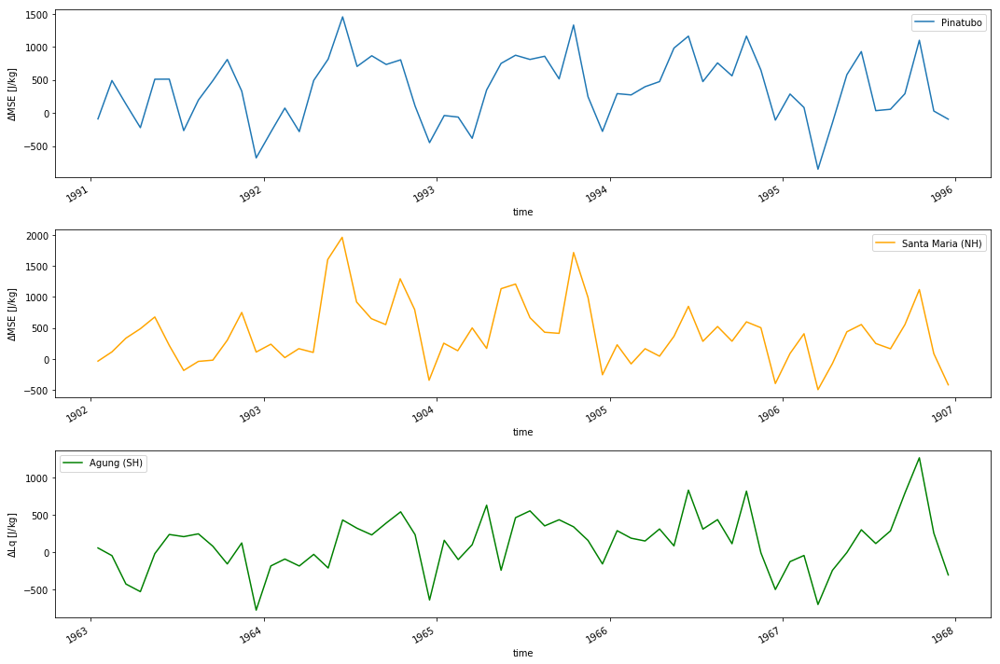

In [95]:
#make monthly climatologies & time series for each volcano of MSE850 - MSE200 
plt.figure(figsize=(15,10))

ax1=plt.subplot(3,1,1)
pinatubo_stab_lq_s = pinatubo_stab_lq.mean('en').isel(lon=(pinatubo_stab_lq.lon<=10)|(pinatubo_stab_lq.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
pinatubo_stab_lq_s.plot(label='Pinatubo')
plt.legend()
plt.ylabel('$\Delta$MSE [J/kg]')


ax2=plt.subplot(3,1,2)
stmaria_stab_lq_s = stmaria_stab_lq.mean('en').isel(lon=(stmaria_stab_lq.lon<=10)|(stmaria_stab_lq.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
stmaria_stab_lq_s.plot(label='Santa Maria (NH)',color='orange')
plt.legend()
plt.ylabel('$\Delta$MSE [J/kg]')

ax3=plt.subplot(3,1,3)
agung_stab_lq_s = agung_stab_lq.mean('en').isel(lon=(agung_stab_lq.lon<=10)|(agung_stab_lq.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
agung_stab_lq_s.plot(label='Agung (SH)',color='green')
plt.legend()
plt.ylabel('$\Delta$Lq [J/kg]')

plt.tight_layout()


Text(0.5,1,'Monthly $\\Delta$Lq anomaly climatology in Sahel, 4-year average')

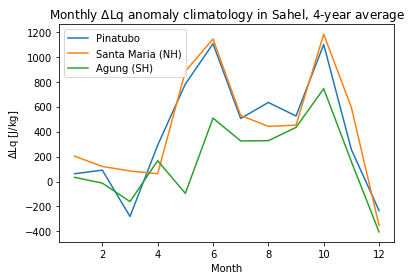

In [96]:
p_clim = pinatubo_stab_lq_s[12:].groupby('time.month').mean('time')
s_clim = stmaria_stab_lq_s[12:].groupby('time.month').mean('time')
a_clim = agung_stab_lq_s[12:].groupby('time.month').mean('time')

plt.plot(p_clim.month, p_clim, label='Pinatubo')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)')
plt.plot(a_clim.month, a_clim, label='Agung (SH)')
plt.legend()
plt.xlabel('Month')
plt.ylabel('$\Delta$Lq [J/kg]')
plt.title('Monthly $\Delta$Lq anomaly climatology in Sahel, 4-year average')


In [39]:
p_clim.mean()

<xarray.DataArray ()>
array(181.045, dtype=float32)

In [40]:
s_clim.mean()

<xarray.DataArray ()>
array(324.67554, dtype=float32)

In [41]:
a_clim.mean()

<xarray.DataArray ()>
array(39.91942, dtype=float32)

In [17]:
a_clim.mean()

<xarray.DataArray ()>
array(44.41908, dtype=float32)

# Winds

In [143]:
ctl_v200 = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.vcomp.200hPa.nc')
ctl_u200 = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.ucomp.200hPa.nc')

/tigress/wenchang/miniconda3/lib/python3.6/site-packages/xarray/coding/times.py:132: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using dummy cftime.datetime objects instead, reason: dates out of range
  enable_cftimeindex)
/tigress/wenchang/miniconda3/lib/python3.6/site-packages/xarray/coding/variables.py:66: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using dummy cftime.datetime objects instead, reason: dates out of range
  return self.func(self.array[key])


In [142]:
ctl_v200

<xarray.DataArray 'vcomp' (en: 30, time: 60, lat: 360, lon: 576)>
[373248000 values with dtype=float32]
Coordinates:
  * lat      (lat) float64 -89.75 -89.25 -88.75 -88.25 -87.75 -87.25 -86.75 ...
  * lon      (lon) float64 0.3125 0.9375 1.562 2.188 2.812 3.438 4.062 4.688 ...
  * time     (time) object 0001-01-16 12:00:00 0001-02-15 00:00:00 ...
    pfull    int64 ...
  * en       (en) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
Attributes:
    long_name:      meridional wind
    units:          m/sec
    valid_range:    [-330.  330.]
    cell_methods:   time: mean
    time_avg_info:  average_T1,average_T2,average_DT
    interp_method:  conserve_order1

# WVP

In [311]:
pinatubo_wvp = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.WVP.nc')
stmaria_wvp = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.WVP.nc')
agung_wvp = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.WVP.nc')
ctl_wvp = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.WVP.nc')

# subtract ctl
ctl_wvp['time']=pinatubo_wvp['time']
pinatubo_wvp_a = pinatubo_wvp - ctl_wvp

ctl_wvp['time']=stmaria_wvp['time']
stmaria_wvp_a = stmaria_wvp - ctl_wvp

ctl_wvp['time']=agung_wvp['time']
agung_wvp_a = agung_wvp - ctl_wvp

In [312]:
pinatubo_wvp_a_ms = pinatubo_wvp_a.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_wvp_a_ms= stmaria_wvp_a.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_wvp_a_ms=agung_wvp_a.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_wvp_ms = pinatubo_wvp.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_wvp_ms= stmaria_wvp.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_wvp_ms=agung_wvp.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

In [313]:
da_a_ms = [pinatubo_wvp_a_ms, stmaria_wvp_a_ms, agung_wvp_a_ms]
da_a_s = [0,1,2]
for i in da_a_s:
    da_a_s[i] = da_a_ms[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo (Sahel = %.2f)' %da_a_s[0], 'Santa Maria (Sahel = %.2f)' %da_a_s[1], 'Agung (Sahel = %.2f)' %da_a_s[2]]

da_ms = [pinatubo_wvp_ms, stmaria_wvp_ms, agung_wvp_ms]


Text(0.5, 0.9, 'Monsoon season WVP')

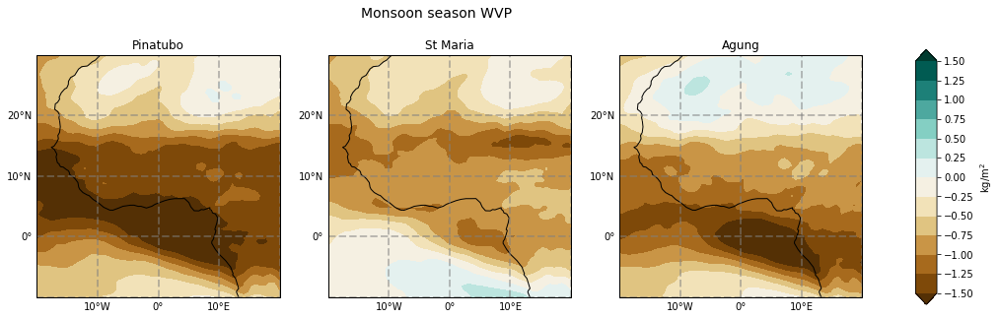

In [407]:
# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(1, 3, figsize=(15,6))
levels = [-1.5,-1.25,-1,-0.75,-.5,-.25,0,.25,.5,.75,1,1.25,1.5]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(da_a_ms[ii]).plot.contourf(robust=True, cmap='BrBG', levels=levels, extend='both',add_labels=False, add_colorbar=False)
    #shift_longitude(da_ms[ii]).plot.contour(cmap='Blues',levels = [15,20,25,30,35,40,45,50],add_colorbar=False,linewidth=2)#add_labels=False,)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im, ticks=levels,cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('Monsoon season WVP',fontsize=14,y=.9)
#plt.savefig('ms_wvp.png', bbox_inches='tight')

Text(0.5, 0.9, 'Monsoon season WVP')

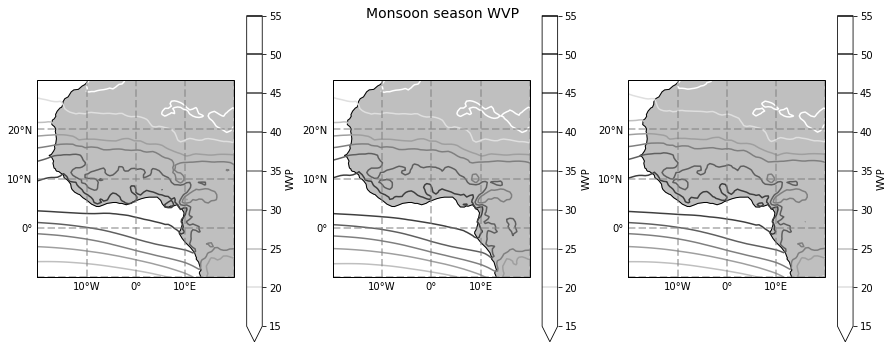

In [331]:
# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(1, 3, figsize=(15,6))
levels = [-1.5,-1.25,-1,-0.75,-.5,-.25,0,.25,.5,.75,1]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(da_ms[ii]).plot.contour(cmap='gist_yarg',levels = [15,20,25,30,35,40,45,50,55],add_colorbar=True)#add_labels=False,)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    #ax.set_title(titles[ii])

#ax = fig.add_axes((.95,.2,.02,.6))
#plt.colorbar(im, ticks=levels,cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('Monsoon season WVP',fontsize=14,y=.9)
#plt.savefig('ms_wvp.png', bbox_inches='tight')

# radiative flux

## forcing experiments TOA netrad

In [94]:
pinatubo_nudge_toa = xr.open_dataarray('/tigress/tessj/data/Pinatubo_ens_noleap_nudgeclimo_all_model1860.atmos_month.netrad_toa.nc/') 
stmaria_nudge_toa = xr.open_dataarray('/tigress/tessj/data/StMaria_ens_noleap_nudgeclimo_all_model1860.atmos_month.netrad_toa.nc/') 
agung_nudge_toa = xr.open_dataarray('/tigress/tessj/data/Agung_ens_noleap_nudgeclimo_all_model1860.atmos_month.netrad_toa.nc/')
ctl_nudge_toa = xr.open_dataarray('/tigress/tessj/data/nudgeclimo_all_model_CTL1860_tigercpu_intelmpi_18_576PE.atmos_month.netrad_toa.nc/') 


In [95]:
# subtract ctl
ctl_nudge_toa['time']=pinatubo_nudge_toa['time']
pinatubo_nudge_toa = pinatubo_nudge_toa - ctl_nudge_toa

ctl_nudge_toa['time']=stmaria_nudge_toa['time']
stmaria_nudge_toa = stmaria_nudge_toa - ctl_nudge_toa

ctl_nudge_toa['time']=agung_nudge_toa['time']
agung_nudge_toa = agung_nudge_toa - ctl_nudge_toa

In [526]:
pinatubo_nudge_toa[:,12:].mean(['lon','lat','en','time'])

<xarray.DataArray 'netrad_toa' ()>
array(-1.0467688, dtype=float32)

In [434]:
agung_nudge_toa[:,:48]

<xarray.DataArray 'netrad_toa' (en: 10, time: 48, lat: 360, lon: 576)>
array([[[[-7.18910217e-01, -7.18910217e-01, -7.18910217e-01, ...,
          -7.18910217e-01, -7.18910217e-01, -7.18910217e-01],
         [-9.36050415e-01, -9.34719086e-01, -9.33380127e-01, ...,
          -9.40006256e-01, -9.38694000e-01, -9.37377930e-01],
         [-1.62846375e+00, -1.62333298e+00, -1.61818314e+00, ...,
          -1.64377594e+00, -1.63868713e+00, -1.63357925e+00],
         ...,
         [-5.49075317e+00, -5.48953247e+00, -5.48829651e+00, ...,
          -5.49441528e+00, -5.49320984e+00, -5.49197388e+00],
         [-5.35026550e+00, -5.35076904e+00, -5.35124207e+00, ...,
          -5.34880066e+00, -5.34927368e+00, -5.34977722e+00],
         [-5.43075562e+00, -5.43075562e+00, -5.43075562e+00, ...,
          -5.43075562e+00, -5.43075562e+00, -5.43075562e+00]],

        [[ 1.66707611e+00,  1.66707611e+00,  1.66707611e+00, ...,
           1.66707611e+00,  1.66707611e+00,  1.66707611e+00],
         [ 9.5549

In [437]:
stmaria_nudge_toa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean(['month']).mean(['lon','lat'])



<xarray.DataArray 'netrad_toa' ()>
array(-0.6873492, dtype=float32)

## TOA clear sky

In [96]:
# W/m^2, TOA netrad (lw + sw), clear sky
pinatubo_toa_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.netrad_toa_clr.nc/') 
stmaria_toa_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.netrad_toa_clr.nc/') 
agung_toa_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.netrad_toa_clr.nc/')
ctl_toa_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.netrad_toa_clr.nc/') 

# subtract ctl
ctl_toa_clr['time']=pinatubo_toa_clr['time']
pinatubo_toa_clr = pinatubo_toa_clr - ctl_toa_clr

ctl_toa_clr['time']=stmaria_toa_clr['time']
stmaria_toa_clr = stmaria_toa_clr - ctl_toa_clr

ctl_toa_clr['time']=agung_toa_clr['time']
agung_toa_clr = agung_toa_clr - ctl_toa_clr

In [535]:
pinatubo_toa_clr[:,12:].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean()

<xarray.DataArray 'netrad_toa_clr' ()>
array(-0.7121381, dtype=float32)

In [97]:
# W/m^2, TOA SW, clear sky
pinatubo_swup_toa_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swup_toa_clr.nc/') 
pinatubo_swdn_toa_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/') 
stmaria_swup_toa_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swup_toa_clr.nc/')
stmaria_swdn_toa_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/') 
agung_swup_toa_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swup_toa_clr.nc/')
agung_swdn_toa_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')
ctl_swup_toa_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swup_toa_clr.nc/') 
ctl_swdn_toa_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_toa_clr.nc/') 

# subtract ctl
ctl_swup_toa_clr['time']=pinatubo_swup_toa_clr['time']
pinatubo_swup_toa_clr = pinatubo_swup_toa_clr - ctl_swup_toa_clr

ctl_swup_toa_clr['time']=stmaria_swup_toa_clr['time']
stmaria_swup_toa_clr = stmaria_swup_toa_clr - ctl_swup_toa_clr

ctl_swup_toa_clr['time']=agung_swup_toa_clr['time']
agung_swup_toa_clr = agung_swup_toa_clr - ctl_swup_toa_clr


ctl_swdn_toa_clr['time']=pinatubo_swdn_toa_clr['time']
pinatubo_swdn_toa_clr = pinatubo_swdn_toa_clr - ctl_swdn_toa_clr

ctl_swdn_toa_clr['time']=stmaria_swdn_toa_clr['time']
stmaria_swdn_toa_clr = stmaria_swdn_toa_clr - ctl_swdn_toa_clr

ctl_swdn_toa_clr['time']=agung_swdn_toa_clr['time']
agung_swdn_toa_clr = agung_swdn_toa_clr - ctl_swdn_toa_clr

#net SW TOA CLR
pinatubo_sw_toa_clr = pinatubo_swup_toa_clr - pinatubo_swdn_toa_clr

stmaria_sw_toa_clr = stmaria_swup_toa_clr - stmaria_swdn_toa_clr

agung_sw_toa_clr = agung_swup_toa_clr - agung_swdn_toa_clr

In [98]:
# W/m^2, TOA LW (OLR), clear sky
pinatubo_olr_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.olr_clr.nc/') 
stmaria_olr_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.olr_clr.nc/') 
agung_olr_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.olr_clr.nc/')
ctl_olr_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.olr_clr.nc/') 

# subtract ctl
ctl_olr_clr['time']=pinatubo_olr_clr['time']
pinatubo_olr_clr = pinatubo_olr_clr - ctl_olr_clr

ctl_olr_clr['time']=stmaria_olr_clr['time']
stmaria_olr_clr = stmaria_olr_clr - ctl_olr_clr

ctl_olr_clr['time']=agung_olr_clr['time']
agung_olr_clr = agung_olr_clr - ctl_olr_clr

Text(0.5,0.98,'TOA clear sky net radiation [W/m$^2$], Sahel region')

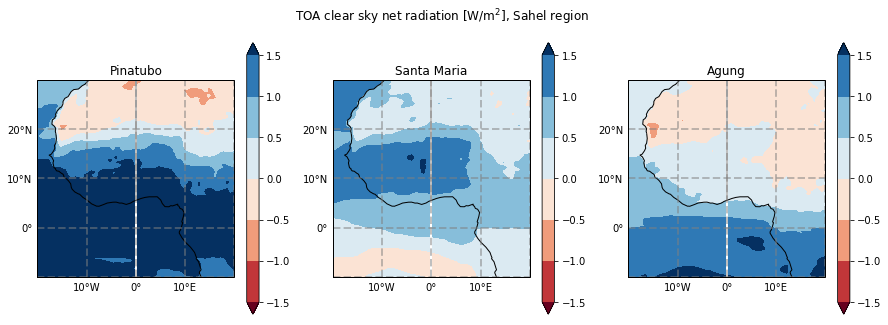

In [4]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1*pinatubo_toa_clr.mean(['en','time'])).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1*stmaria_toa_clr.mean(['en','time'])).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1*agung_toa_clr.mean(['en','time'])).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('TOA clear sky net radiation [W/m$^2$], Sahel region')
#positive up
#plt.savefig('clearsky_toa.png')


In [48]:
#Sahel regional mean anomalies
pinatubo_toa_clr_s = pinatubo_toa_clr.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat','en','time'])
stmaria_toa_clr_s = stmaria_toa_clr.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat','en','time'])
agung_toa_clr_s = agung_toa_clr.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat','en','time'])





In [455]:
agung_toa_clr_s

<xarray.DataArray 'netrad_toa_clr' ()>
array(-0.12720017, dtype=float32)

In [20]:
agung_toa_clr.mean(['lon','lat','en','time'])

<xarray.DataArray 'netrad_toa_clr' ()>
array(-0.75568, dtype=float32)

Text(0.5,0.98,'TOA clear sky SW radiation [W/m$^2$], Sahel region')

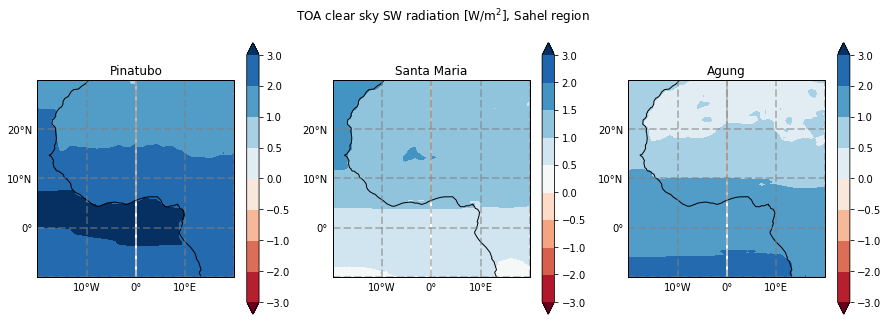

In [121]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_sw_toa_clr.mean(['en','time'])).plot.contourf(robust=True, levels=[-3,-2,-1,-0.5,0,0.5,1,2,3], add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_sw_toa_clr.mean(['en','time'])).plot.contourf(robust=True, levels=[-3,-2,-1,-0.5,0,0.5,1,1.5,2,3], add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_sw_toa_clr.mean(['en','time'])).plot.contourf(robust=True, levels=[-3,-2,-1,-0.5,0,0.5,1,2,3], add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('TOA clear sky SW radiation [W/m$^2$], Sahel region')
#positive up

Text(0.5,0.98,'TOA clear sky LW radiation [W/m$^2$], Sahel region')

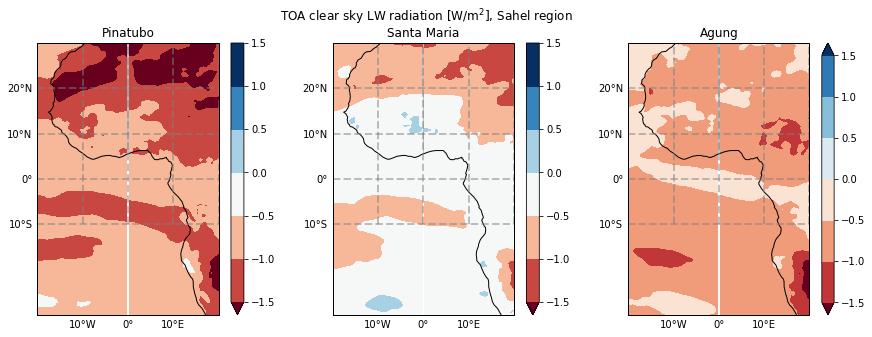

In [122]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -30, 30], ccrs.PlateCarree())
(pinatubo_olr_clr.mean(['en','time'])).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -30, 30], ccrs.PlateCarree())
(stmaria_olr_clr.mean(['en','time'])).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -30, 30], ccrs.PlateCarree())
(agung_olr_clr.mean(['en','time'])).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('TOA clear sky LW radiation [W/m$^2$], Sahel region')
#positive up

Text(0.5,0.98,'TOA clear sky net radiation [W/m$^2$], Sahel region')

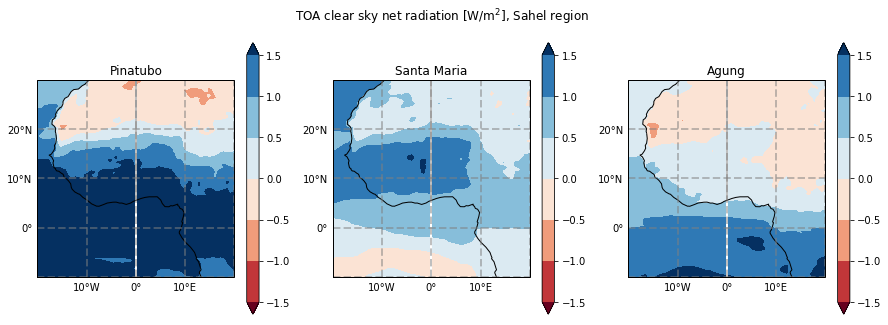

In [17]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_sw_toa_clr.mean(['en','time'])+(pinatubo_olr_clr.mean(['en','time']))).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_sw_toa_clr.mean(['en','time'])+(stmaria_olr_clr.mean(['en','time']))).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_sw_toa_clr.mean(['en','time'])+(agung_olr_clr.mean(['en','time']))).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('TOA clear sky net radiation [W/m$^2$], Sahel region')
#positive up

# JJA/MS anomalies

## TOA Clear sky

In [12]:
#lets call the monsoon season June thru October (look at FLOR climatology)

#so change to this
#pinatubo_clr_ms = pinatubo_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

#from this
#pinatubo_clr_jja = pinatubo_toa_clr.groupby('time.season').mean(['time','en']).sel(season='JJA')


<xarray.DataArray 'netrad_toa_clr' (lat: 360, lon: 576)>
array([[ 0.745861,  0.745861,  0.745861, ...,  0.745861,  0.745861,  0.745861],
       [ 0.742184,  0.742207,  0.742229, ...,  0.742117,  0.742139,  0.742162],
       [ 0.751574,  0.751494,  0.751415, ...,  0.75181 ,  0.751732,  0.751653],
       ...,
       [-1.44777 , -1.447455, -1.447138, ..., -1.448712, -1.448398, -1.448085],
       [-1.400059, -1.399808, -1.399556, ..., -1.400804, -1.400556, -1.400309],
       [-1.35915 , -1.35915 , -1.35915 , ..., -1.35915 , -1.35915 , -1.35915 ]],
      dtype=float32)
Coordinates:
  * lat      (lat) float64 -89.75 -89.25 -88.75 -88.25 -87.75 -87.25 -86.75 ...
  * lon      (lon) float64 0.3125 0.9375 1.562 2.188 2.812 3.438 4.062 4.688 ...

In [246]:
pvalue=[0,0,0,0,0,0,0,0,0]

pinatubo_clr_ms = pinatubo_toa_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_clr_ms, 0)
pinatubo_clr_ms=pinatubo_clr_ms.mean('en').load()
pvalue[0] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_clr_ms = stmaria_toa_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_clr_ms, 0)
stmaria_clr_ms=stmaria_clr_ms.mean('en').load()
pvalue[1] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_clr_ms = agung_toa_clr[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_clr_ms, 0)
agung_clr_ms=agung_clr_ms.mean('en').load()
pvalue[2] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

pinatubo_sw_toa_clr_ms = pinatubo_sw_toa_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_sw_toa_clr_ms, 0)
pinatubo_sw_toa_clr_ms=pinatubo_sw_toa_clr_ms.mean('en').load()
pvalue[3] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_sw_toa_clr_ms = stmaria_sw_toa_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_sw_toa_clr_ms, 0)
stmaria_sw_toa_clr_ms=stmaria_sw_toa_clr_ms.mean('en').load()
pvalue[4] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_sw_toa_clr_ms = agung_sw_toa_clr[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_sw_toa_clr_ms, 0)
agung_sw_toa_clr_ms=agung_sw_toa_clr_ms.mean('en').load()
pvalue[5] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

pinatubo_olr_clr_ms = pinatubo_olr_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_olr_clr_ms, 0)
pinatubo_olr_clr_ms=pinatubo_olr_clr_ms.mean('en').load()
pvalue[6] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_olr_clr_ms = stmaria_olr_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_olr_clr_ms, 0)
stmaria_olr_clr_ms=stmaria_olr_clr_ms.mean('en').load()
pvalue[7] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_olr_clr_ms = agung_olr_clr[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_olr_clr_ms, 0)
agung_olr_clr_ms=agung_olr_clr_ms.mean('en').load()
pvalue[8] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])


In [444]:
pinatubo_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

<xarray.DataArray 'netrad_toa_clr' ()>
array(-1.0044374, dtype=float32)

In [447]:
agung_clr_ms.mean(['lat','lon'])

<xarray.DataArray 'netrad_toa_clr' ()>
array(-0.7577916, dtype=float32)

In [102]:
ms_olr_clrs = [pinatubo_sw_toa_clr_ms, stmaria_sw_toa_clr_ms, agung_sw_toa_clr_ms,pinatubo_olr_clr_ms, stmaria_olr_clr_ms,agung_olr_clr_ms, -1*pinatubo_clr_ms, -1*stmaria_clr_ms, -1*agung_clr_ms]
ms_olr_clrs = [a.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']) for a in ms_olr_clrs]
ms_olr_clrs
        

[<xarray.DataArray ()>
 array(1.8248315, dtype=float32), <xarray.DataArray ()>
 array(1.1413229, dtype=float32), <xarray.DataArray ()>
 array(0.9627264, dtype=float32), <xarray.DataArray 'olr_clr' ()>
 array(-0.8203941, dtype=float32), <xarray.DataArray 'olr_clr' ()>
 array(0.31134012, dtype=float32), <xarray.DataArray 'olr_clr' ()>
 array(-0.8379293, dtype=float32), <xarray.DataArray 'netrad_toa_clr' ()>
 array(1.0044374, dtype=float32), <xarray.DataArray 'netrad_toa_clr' ()>
 array(1.452663, dtype=float32), <xarray.DataArray 'netrad_toa_clr' ()>
 array(0.12479709, dtype=float32)]

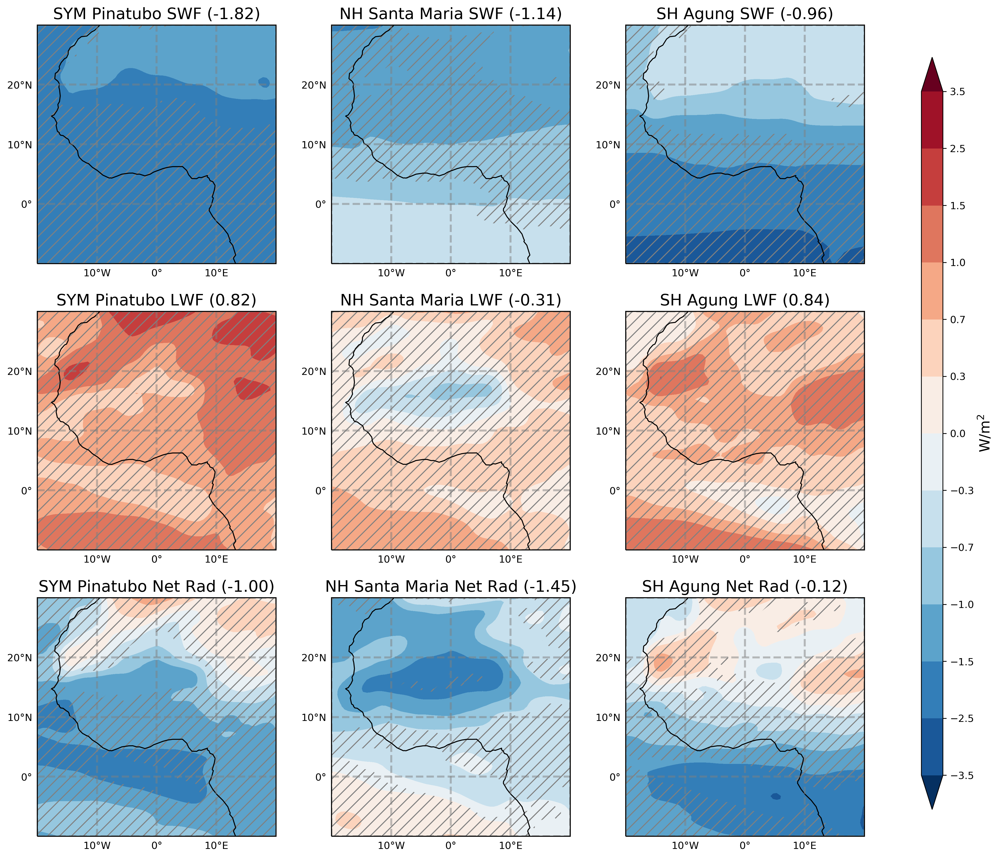

In [247]:
fig = plt.figure(figsize=(15,15))
levels=[-3.5,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,3.5]
plt.rcParams['hatch.color'] = 'grey'
ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*pinatubo_sw_toa_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[0].where(pvalue[0]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo SWF (%.2f)'%-ms_olr_clrs[0], fontsize=16)

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*stmaria_sw_toa_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[1].where(pvalue[1]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria SWF (%.2f)'%-ms_olr_clrs[1], fontsize=16)

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*agung_sw_toa_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[2].where(pvalue[2]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung SWF (%.2f)'%-ms_olr_clrs[2], fontsize=16)

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*pinatubo_olr_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[3].where(pvalue[3]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo LWF (%.2f)'%-ms_olr_clrs[3], fontsize=16)

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*stmaria_olr_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[4].where(pvalue[4]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria LWF (%.2f)'%-ms_olr_clrs[4], fontsize=16)

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*agung_olr_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[5].where(pvalue[5]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung LWF (%.2f)'%-ms_olr_clrs[5], fontsize=16)

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[6].where(pvalue[6]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo Net Rad (%.2f)'%-ms_olr_clrs[6],fontsize=16)

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[7].where(pvalue[7]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria Net Rad (%.2f)'%-ms_olr_clrs[7],fontsize=16)

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[8].where(pvalue[8]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung Net Rad (%.2f)'%-ms_olr_clrs[8],fontsize=16)

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical').set_label(label='W/m$^2$',size=14)
#plt.tight_layout(rect=(0,0,.9,1))


#plt.suptitle('MS TOA clear sky fluxes [W/m$^2$], Sahel region',fontsize=20)
#positive down
plt.savefig('clearsky_toa_ms_3x3_smooth.png', bbox_inches='tight')
#flag



In [ ]:
## ax2=plt.subplot(1,1,1,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
#shift_longitude(stmaria_sw_toa_clr_ms).plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
shift_longitude(pvalue[1].where(pvalue[1]<0.1).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria SWF (%.2f)'%ms_olr_clrs[1], fontsize=16)

## 200hPa clear sky

In [113]:
# W/m^2, 200hPa SW, clear sky
pinatubo_swup_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swup_200hPa_clr.nc/') 
pinatubo_swdn_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_200hPa_clr.nc/') 
stmaria_swup_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swup_200hPa_clr.nc/')
stmaria_swdn_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_200hPa_clr.nc/') 
agung_swup_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swup_200hPa_clr.nc/')
agung_swdn_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_200hPa_clr.nc/')
ctl_swup_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swup_200hPa_clr.nc/') 
ctl_swdn_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_200hPa_clr.nc/') 

# subtract ctl
ctl_swup_200hPa_clr['time']=pinatubo_swup_200hPa_clr['time']
pinatubo_swup_200hPa_clr = pinatubo_swup_200hPa_clr - ctl_swup_200hPa_clr

ctl_swup_200hPa_clr['time']=stmaria_swup_200hPa_clr['time']
stmaria_swup_200hPa_clr = stmaria_swup_200hPa_clr - ctl_swup_200hPa_clr

ctl_swup_200hPa_clr['time']=agung_swup_200hPa_clr['time']
agung_swup_200hPa_clr = agung_swup_200hPa_clr - ctl_swup_200hPa_clr


ctl_swdn_200hPa_clr['time']=pinatubo_swdn_200hPa_clr['time']
pinatubo_swdn_200hPa_clr = pinatubo_swdn_200hPa_clr - ctl_swdn_200hPa_clr

ctl_swdn_200hPa_clr['time']=stmaria_swdn_200hPa_clr['time']
stmaria_swdn_200hPa_clr = stmaria_swdn_200hPa_clr - ctl_swdn_200hPa_clr

ctl_swdn_200hPa_clr['time']=agung_swdn_200hPa_clr['time']
agung_swdn_200hPa_clr = agung_swdn_200hPa_clr - ctl_swdn_200hPa_clr

#net SW 200 CLR
pinatubo_sw_200hPa_clr = pinatubo_swup_200hPa_clr - pinatubo_swdn_200hPa_clr

stmaria_sw_200hPa_clr = stmaria_swup_200hPa_clr - stmaria_swdn_200hPa_clr

agung_sw_200hPa_clr = agung_swup_200hPa_clr - agung_swdn_200hPa_clr


# W/m^2, 200 lw, clear sky
pinatubo_netlw_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.netlw_200hPa_clr.nc/') 
stmaria_netlw_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.netlw_200hPa_clr.nc/')
agung_netlw_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.netlw_200hPa_clr.nc/')
ctl_netlw_200hPa_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.netlw_200hPa_clr.nc/') 

# subtract ctl
ctl_netlw_200hPa_clr['time']=pinatubo_netlw_200hPa_clr['time']
pinatubo_lw_200hPa_clr = pinatubo_netlw_200hPa_clr - ctl_netlw_200hPa_clr

ctl_netlw_200hPa_clr['time']=stmaria_netlw_200hPa_clr['time']
stmaria_lw_200hPa_clr = stmaria_netlw_200hPa_clr - ctl_netlw_200hPa_clr

ctl_netlw_200hPa_clr['time']=agung_netlw_200hPa_clr['time']
agung_lw_200hPa_clr = agung_netlw_200hPa_clr - ctl_netlw_200hPa_clr




In [114]:
pinatubo_sw_200hPa_clr_ms = pinatubo_sw_200hPa_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

stmaria_sw_200hPa_clr_ms = stmaria_sw_200hPa_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

agung_sw_200hPa_clr_ms = agung_sw_200hPa_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_lw_200hPa_clr_ms = pinatubo_lw_200hPa_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

stmaria_lw_200hPa_clr_ms = stmaria_lw_200hPa_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

agung_lw_200hPa_clr_ms = agung_lw_200hPa_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')


#netrad 200 clr
pinatubo_200hPa_clr_ms = pinatubo_sw_200hPa_clr_ms + pinatubo_lw_200hPa_clr_ms
stmaria_200hPa_clr_ms = stmaria_sw_200hPa_clr_ms + stmaria_lw_200hPa_clr_ms
agung_200hPa_clr_ms = agung_sw_200hPa_clr_ms + agung_lw_200hPa_clr_ms

Text(0.5, 0.92, 'Control SW dn, Positive down')

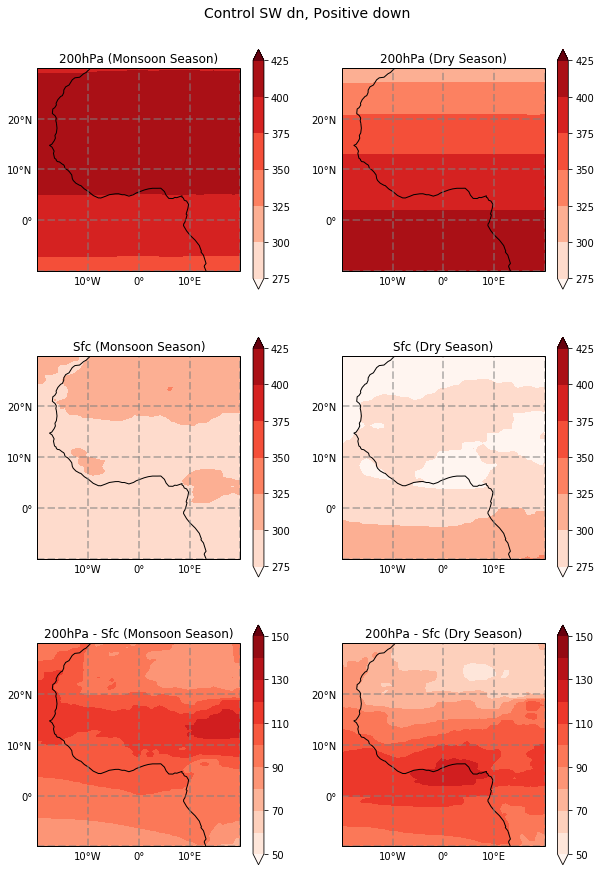

In [288]:
plt.figure(figsize=(10,15))

ax1=plt.subplot(3,2,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_200hPa_clr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').plot.contourf(robust=True, levels=[275,300,325,350,375,400,425],extend='both', add_labels=False, cmap='Reds')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('200hPa (Monsoon Season)')

ax2=plt.subplot(3,2,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_200hPa_clr).groupby('time.month').mean(['time','en']).sel(month=[1,2,3,4,5,11,12]).mean('month').plot.contourf(robust=True, levels=[275,300,325,350,375,400,425],extend='both',add_labels=False, cmap='Reds')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('200hPa (Dry Season)')

ax3=plt.subplot(3,2,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_sfc_clr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').plot.contourf(robust=True, levels=[275,300,325,350,375,400,425],extend='both',add_labels=False, cmap='Reds')
gl=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines()
plt.title('Sfc (Monsoon Season)')

ax4=plt.subplot(3,2,4,projection=ccrs.PlateCarree())
ax4.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_sfc_clr).groupby('time.month').mean(['time','en']).sel(month=[1,2,3,4,5,11,12]).mean('month').plot.contourf(robust=True, levels=[275,300,325,350,375,400,425],extend='both',add_labels=False, cmap='Reds')
g2=ax4.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax4.add_feature(cfeature.LAND, facecolor='0.75')
ax4.coastlines() 
plt.title('Sfc (Dry Season)')

ax5=plt.subplot(3,2,5,projection=ccrs.PlateCarree())
ax5.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_200hPa_clr - ctl_swdn_sfc_clr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').plot.contourf(robust=True, levels=[50,60,70,80,90,100,110,120,130,140,150],extend='both',add_labels=False, cmap='Reds')
gl=ax5.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax5.add_feature(cfeature.LAND, facecolor='0.75')
ax5.coastlines()
plt.title('200hPa - Sfc (Monsoon Season)')

ax6=plt.subplot(3,2,6,projection=ccrs.PlateCarree())
ax6.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_200hPa_clr - ctl_swdn_sfc_clr).groupby('time.month').mean(['time','en']).sel(month=[1,2,3,4,5,11,12]).mean('month').plot.contourf(robust=True, levels=[50,60,70,80,90,100,110,120,130,140,150],extend='both',add_labels=False, cmap='Reds')
g2=ax6.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax6.add_feature(cfeature.LAND, facecolor='0.75')
ax6.coastlines() 
plt.title('200hPa - Sfc (Dry Season)')

plt.suptitle('Control SW dn, Positive down',y=.92,size=14)

In [ ]:
plt.figure(figsize=(10,15))

ax1=plt.subplot(3,2,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_200hPa_clr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').plot.contourf(robust=True, levels=[275,300,325,350,375,400,425],extend='both', add_labels=False, cmap='Reds')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('200hPa (Monsoon Season)')

ax2=plt.subplot(3,2,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_200hPa_clr).groupby('time.month').mean(['time','en']).sel(month=[1,2,3,4,5,11,12]).mean('month').plot.contourf(robust=True, levels=[275,300,325,350,375,400,425],extend='both',add_labels=False, cmap='Reds')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('200hPa (Dry Season)')

ax3=plt.subplot(3,2,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_sfc_clr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').plot.contourf(robust=True, levels=[275,300,325,350,375,400,425],extend='both',add_labels=False, cmap='Reds')
gl=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines()
plt.title('Sfc (Monsoon Season)')

ax4=plt.subplot(3,2,4,projection=ccrs.PlateCarree())
ax4.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_sfc_clr).groupby('time.month').mean(['time','en']).sel(month=[1,2,3,4,5,11,12]).mean('month').plot.contourf(robust=True, levels=[275,300,325,350,375,400,425],extend='both',add_labels=False, cmap='Reds')
g2=ax4.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax4.add_feature(cfeature.LAND, facecolor='0.75')
ax4.coastlines() 
plt.title('Sfc (Dry Season)')

ax5=plt.subplot(3,2,5,projection=ccrs.PlateCarree())
ax5.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_200hPa_clr - ctl_swdn_sfc_clr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').plot.contourf(robust=True, levels=[50,60,70,80,90,100,110,120,130,140,150],extend='both',add_labels=False, cmap='Reds')
gl=ax5.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax5.add_feature(cfeature.LAND, facecolor='0.75')
ax5.coastlines()
plt.title('200hPa - Sfc (Monsoon Season)')

ax6=plt.subplot(3,2,6,projection=ccrs.PlateCarree())
ax6.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_swdn_200hPa_clr - ctl_swdn_sfc_clr).groupby('time.month').mean(['time','en']).sel(month=[1,2,3,4,5,11,12]).mean('month').plot.contourf(robust=True, levels=[50,60,70,80,90,100,110,120,130,140,150],extend='both',add_labels=False, cmap='Reds')
g2=ax6.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax6.add_feature(cfeature.LAND, facecolor='0.75')
ax6.coastlines() 
plt.title('200hPa - Sfc (Dry Season)')

plt.suptitle('Control SW dn, Positive down',y=.96)

In [54]:
ms_200hPa_clrs = [pinatubo_sw_200hPa_clr_ms, stmaria_sw_200hPa_clr_ms, agung_sw_200hPa_clr_ms,pinatubo_lw_200hPa_clr_ms, stmaria_lw_200hPa_clr_ms,agung_lw_200hPa_clr_ms, pinatubo_200hPa_clr_ms, stmaria_200hPa_clr_ms, agung_200hPa_clr_ms]
ms_200hPa_clrs = [a.isel(lon=(pinatubo_200hPa_clr_ms.lon<=10)|(pinatubo_200hPa_clr_ms.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']) for a in ms_200hPa_clrs]
ms_200hPa_clrs
        

[<xarray.DataArray ()>
 array(1.9076241, dtype=float32), <xarray.DataArray ()>
 array(1.1769633, dtype=float32), <xarray.DataArray ()>
 array(1.1090988, dtype=float32), <xarray.DataArray 'netlw_200hPa_clr' ()>
 array(-0.47041014, dtype=float32), <xarray.DataArray 'netlw_200hPa_clr' ()>
 array(0.494216, dtype=float32), <xarray.DataArray 'netlw_200hPa_clr' ()>
 array(-0.86296517, dtype=float32), <xarray.DataArray ()>
 array(1.4372139, dtype=float32), <xarray.DataArray ()>
 array(1.6711793, dtype=float32), <xarray.DataArray ()>
 array(0.24613367, dtype=float32)]

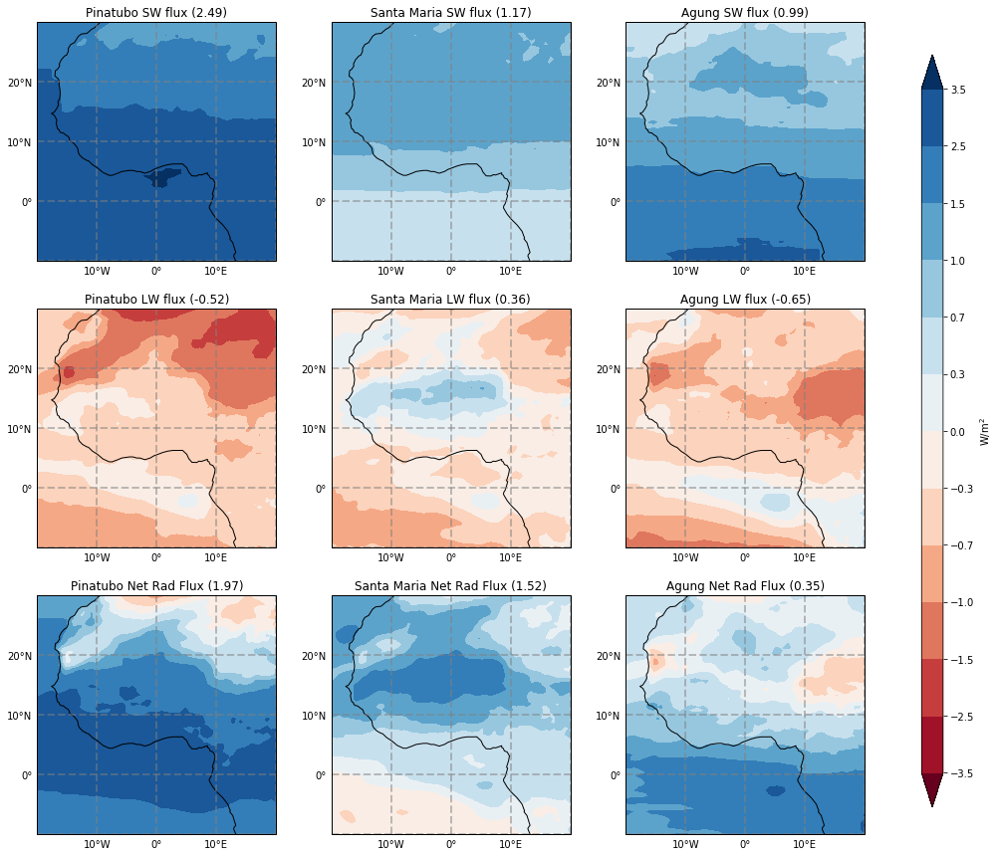

In [23]:
fig = plt.figure(figsize=(15,15))
levels=[-3.5,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,3.5]

ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sw_200hPa_clr_ms).plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title(f'Pinatubo SW flux (%.2f)'%ms_200hPa_clrs[0])

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_sw_200hPa_clr_ms).plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux (%.2f)'%ms_200hPa_clrs[1])

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_sw_200hPa_clr_ms).plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung SW flux (%.2f)'%ms_200hPa_clrs[2])

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_lw_200hPa_clr_ms).plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo LW flux (%.2f)'%ms_200hPa_clrs[3])

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_lw_200hPa_clr_ms).plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria LW flux (%.2f)'%ms_200hPa_clrs[4])

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_lw_200hPa_clr_ms).plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung LW flux (%.2f)'%ms_200hPa_clrs[5])

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_200hPa_clr_ms).plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Net Rad Flux (%.2f)'%ms_200hPa_clrs[6])

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_200hPa_clr_ms).plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Net Rad Flux (%.2f)'%ms_200hPa_clrs[7])

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_200hPa_clr_ms).plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Net Rad Flux (%.2f)'%ms_200hPa_clrs[8])

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical',label='W/m$^2$')
#plt.tight_layout(rect=(0,0,.9,1))


#plt.suptitle('MS 200hPa clear sky fluxes [W/m$^2$], Sahel region',fontsize=20)
#positive up
#plt.savefig('clearsky_200hPa_ms_3x3.png', bbox_inches='tight')



## Sfc clear sky

In [115]:
# W/m^2, sfc SW, clear sky
pinatubo_swup_sfc_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swup_sfc_clr.nc/') 
pinatubo_swdn_sfc_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/') 
stmaria_swup_sfc_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swup_sfc_clr.nc/')
stmaria_swdn_sfc_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/') 
agung_swup_sfc_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swup_sfc_clr.nc/')
agung_swdn_sfc_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/')
ctl_swup_sfc_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swup_sfc_clr.nc/') 
ctl_swdn_sfc_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_sfc_clr.nc/') 

# subtract ctl
ctl_swup_sfc_clr['time']=pinatubo_swup_sfc_clr['time']
pinatubo_swup_sfc_clr = pinatubo_swup_sfc_clr - ctl_swup_sfc_clr

ctl_swup_sfc_clr['time']=stmaria_swup_sfc_clr['time']
stmaria_swup_sfc_clr = stmaria_swup_sfc_clr - ctl_swup_sfc_clr

ctl_swup_sfc_clr['time']=agung_swup_sfc_clr['time']
agung_swup_sfc_clr = agung_swup_sfc_clr - ctl_swup_sfc_clr


ctl_swdn_sfc_clr['time']=pinatubo_swdn_sfc_clr['time']
pinatubo_swdn_sfc_clr = pinatubo_swdn_sfc_clr - ctl_swdn_sfc_clr

ctl_swdn_sfc_clr['time']=stmaria_swdn_sfc_clr['time']
stmaria_swdn_sfc_clr = stmaria_swdn_sfc_clr - ctl_swdn_sfc_clr

ctl_swdn_sfc_clr['time']=agung_swdn_sfc_clr['time']
agung_swdn_sfc_clr = agung_swdn_sfc_clr - ctl_swdn_sfc_clr

#net SW sfc CLR
pinatubo_sw_sfc_clr = pinatubo_swup_sfc_clr - pinatubo_swdn_sfc_clr

stmaria_sw_sfc_clr = stmaria_swup_sfc_clr - stmaria_swdn_sfc_clr

agung_sw_sfc_clr = agung_swup_sfc_clr - agung_swdn_sfc_clr


# W/m^2, sfc lw, clear sky
pinatubo_lwup_sfc_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.lwup_sfc_clr.nc/') 
pinatubo_lwdn_sfc_clr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.lwdn_sfc_clr.nc/') 
stmaria_lwup_sfc_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.lwup_sfc_clr.nc/')
stmaria_lwdn_sfc_clr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.lwdn_sfc_clr.nc/') 
agung_lwup_sfc_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.lwup_sfc_clr.nc/')
agung_lwdn_sfc_clr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.lwdn_sfc_clr.nc/')
ctl_lwup_sfc_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.lwup_sfc_clr.nc/') 
ctl_lwdn_sfc_clr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.lwdn_sfc_clr.nc/') 

# subtract ctl
ctl_lwup_sfc_clr['time']=pinatubo_lwup_sfc_clr['time']
pinatubo_lwup_sfc_clr = pinatubo_lwup_sfc_clr - ctl_lwup_sfc_clr

ctl_lwup_sfc_clr['time']=stmaria_lwup_sfc_clr['time']
stmaria_lwup_sfc_clr = stmaria_lwup_sfc_clr - ctl_lwup_sfc_clr

ctl_lwup_sfc_clr['time']=agung_lwup_sfc_clr['time']
agung_lwup_sfc_clr = agung_lwup_sfc_clr - ctl_lwup_sfc_clr


ctl_lwdn_sfc_clr['time']=pinatubo_lwdn_sfc_clr['time']
pinatubo_lwdn_sfc_clr = pinatubo_lwdn_sfc_clr - ctl_lwdn_sfc_clr

ctl_lwdn_sfc_clr['time']=stmaria_lwdn_sfc_clr['time']
stmaria_lwdn_sfc_clr = stmaria_lwdn_sfc_clr - ctl_lwdn_sfc_clr

ctl_lwdn_sfc_clr['time']=agung_lwdn_sfc_clr['time']
agung_lwdn_sfc_clr = agung_lwdn_sfc_clr - ctl_lwdn_sfc_clr

#net lw sfc CLR
pinatubo_lw_sfc_clr = pinatubo_lwup_sfc_clr - pinatubo_lwdn_sfc_clr

stmaria_lw_sfc_clr = stmaria_lwup_sfc_clr - stmaria_lwdn_sfc_clr

agung_lw_sfc_clr = agung_lwup_sfc_clr - agung_lwdn_sfc_clr

#netrad sfc clr
pinatubo_sfc_clr = pinatubo_sw_sfc_clr + pinatubo_lw_sfc_clr
stmaria_sfc_clr = stmaria_sw_sfc_clr + stmaria_lw_sfc_clr
agung_sfc_clr = agung_sw_sfc_clr + agung_lw_sfc_clr

In [297]:
# % SW absorbed from toa to surface (opacity) (call it t for tau?)
pinatubo_clr_sw_t = (xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')-xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/'))/xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')
stmaria_clr_sw_t = (xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')-xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/'))/xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')
agung_clr_sw_t = (xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')-xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/'))/xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')
ctl_clr_sw_t = (xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_toa_clr.nc/')-xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_sfc_clr.nc/'))/xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_toa_clr.nc/')

# subtract control
ctl_clr_sw_t['time']=pinatubo_clr_sw_t['time']
pinatubo_clr_sw_t = pinatubo_clr_sw_t - ctl_clr_sw_t

ctl_clr_sw_t['time']=stmaria_clr_sw_t['time']
stmaria_clr_sw_t = stmaria_clr_sw_t - ctl_clr_sw_t

ctl_clr_sw_t['time']=agung_clr_sw_t['time']
agung_clr_sw_t = agung_clr_sw_t - ctl_clr_sw_t

#monsoon season changes
pinatubo_clr_sw_t_ms = pinatubo_clr_sw_t.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_clr_sw_t_ms = stmaria_clr_sw_t.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_clr_sw_t_ms = agung_clr_sw_t.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')


/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


In [248]:
pvalue=[0,0,0,0,0,0,0,0,0]

pinatubo_sfc_clr_ms = pinatubo_sfc_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_sfc_clr_ms, 0)
pinatubo_sfc_clr_ms=pinatubo_sfc_clr_ms.mean('en').load()
pvalue[0] = xr.DataArray(pp, dims=pinatubo_sfc_clr_ms.dims, coords=[pinatubo_sfc_clr_ms[dim] for dim in list(pinatubo_sfc_clr_ms.dims)])

stmaria_sfc_clr_ms = stmaria_sfc_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_sfc_clr_ms, 0)
stmaria_sfc_clr_ms=stmaria_sfc_clr_ms.mean('en').load()
pvalue[1] = xr.DataArray(pp, dims=pinatubo_sfc_clr_ms.dims, coords=[pinatubo_sfc_clr_ms[dim] for dim in list(pinatubo_sfc_clr_ms.dims)])

agung_sfc_clr_ms = agung_sfc_clr[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_sfc_clr_ms, 0)
agung_sfc_clr_ms=agung_sfc_clr_ms.mean('en').load()
pvalue[2] = xr.DataArray(pp, dims=pinatubo_sfc_clr_ms.dims, coords=[pinatubo_sfc_clr_ms[dim] for dim in list(pinatubo_sfc_clr_ms.dims)])

pinatubo_sw_sfc_clr_ms = pinatubo_sw_sfc_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_sw_sfc_clr_ms, 0)
pinatubo_sw_sfc_clr_ms=pinatubo_sw_sfc_clr_ms.mean('en').load()
pvalue[3] = xr.DataArray(pp, dims=pinatubo_sfc_clr_ms.dims, coords=[pinatubo_sfc_clr_ms[dim] for dim in list(pinatubo_sfc_clr_ms.dims)])

stmaria_sw_sfc_clr_ms = stmaria_sw_sfc_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_sw_sfc_clr_ms, 0)
stmaria_sw_sfc_clr_ms=stmaria_sw_sfc_clr_ms.mean('en').load()
pvalue[4] = xr.DataArray(pp, dims=pinatubo_sfc_clr_ms.dims, coords=[pinatubo_sfc_clr_ms[dim] for dim in list(pinatubo_sfc_clr_ms.dims)])

agung_sw_sfc_clr_ms = agung_sw_sfc_clr[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_sw_sfc_clr_ms, 0)
agung_sw_sfc_clr_ms=agung_sw_sfc_clr_ms.mean('en').load()
pvalue[5] = xr.DataArray(pp, dims=pinatubo_sfc_clr_ms.dims, coords=[pinatubo_sfc_clr_ms[dim] for dim in list(pinatubo_sfc_clr_ms.dims)])

pinatubo_lw_sfc_clr_ms = pinatubo_lw_sfc_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_lw_sfc_clr_ms, 0)
pinatubo_lw_sfc_clr_ms=pinatubo_lw_sfc_clr_ms.mean('en').load()
pvalue[6] = xr.DataArray(pp, dims=pinatubo_sfc_clr_ms.dims, coords=[pinatubo_sfc_clr_ms[dim] for dim in list(pinatubo_sfc_clr_ms.dims)])

stmaria_lw_sfc_clr_ms = stmaria_lw_sfc_clr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_lw_sfc_clr_ms, 0)
stmaria_lw_sfc_clr_ms=stmaria_lw_sfc_clr_ms.mean('en').load()
pvalue[7] = xr.DataArray(pp, dims=pinatubo_sfc_clr_ms.dims, coords=[pinatubo_sfc_clr_ms[dim] for dim in list(pinatubo_sfc_clr_ms.dims)])

agung_lw_sfc_clr_ms = agung_lw_sfc_clr[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_lw_sfc_clr_ms, 0)
agung_lw_sfc_clr_ms=agung_lw_sfc_clr_ms.mean('en').load()
pvalue[8] = xr.DataArray(pp, dims=pinatubo_sfc_clr_ms.dims, coords=[pinatubo_sfc_clr_ms[dim] for dim in list(pinatubo_sfc_clr_ms.dims)])
'''
pinatubo_sfc_clr_ms = pinatubo_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_sfc_clr_ms = stmaria_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_sfc_clr_ms = agung_sfc_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_sw_sfc_clr_ms = pinatubo_sw_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

stmaria_sw_sfc_clr_ms = stmaria_sw_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

agung_sw_sfc_clr_ms = agung_sw_sfc_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_lw_sfc_clr_ms = pinatubo_lw_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

stmaria_lw_sfc_clr_ms = stmaria_lw_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

agung_lw_sfc_clr_ms = agung_lw_sfc_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')'''

"\npinatubo_sfc_clr_ms = pinatubo_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\nstmaria_sfc_clr_ms = stmaria_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\nagung_sfc_clr_ms = agung_sfc_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\npinatubo_sw_sfc_clr_ms = pinatubo_sw_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\nstmaria_sw_sfc_clr_ms = stmaria_sw_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\nagung_sw_sfc_clr_ms = agung_sw_sfc_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\npinatubo_lw_sfc_clr_ms = pinatubo_lw_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\nstmaria_lw_sfc_clr_ms = stmaria_lw_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(m

In [122]:
ms_sfc_clrs = [pinatubo_sw_sfc_clr_ms, stmaria_sw_sfc_clr_ms, agung_sw_sfc_clr_ms,pinatubo_lw_sfc_clr_ms, stmaria_lw_sfc_clr_ms,agung_lw_sfc_clr_ms, pinatubo_sfc_clr_ms, stmaria_sfc_clr_ms, agung_sfc_clr_ms]
ms_sfc_clrs = [a.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']) for a in ms_sfc_clrs]
ms_sfc_clrs
        

[<xarray.DataArray ()>
 array(0.64492667, dtype=float32), <xarray.DataArray ()>
 array(0.15390505, dtype=float32), <xarray.DataArray ()>
 array(0.4080545, dtype=float32), <xarray.DataArray ()>
 array(1.3735485, dtype=float32), <xarray.DataArray ()>
 array(2.3908486, dtype=float32), <xarray.DataArray ()>
 array(-0.17900483, dtype=float32), <xarray.DataArray ()>
 array(2.018475, dtype=float32), <xarray.DataArray ()>
 array(2.5447536, dtype=float32), <xarray.DataArray ()>
 array(0.22904967, dtype=float32)]

Text(0.5, 1.0, 'Santa Maria SW flux (0.25)')

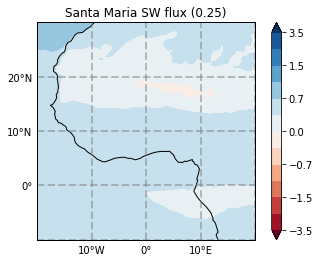

In [151]:
ax2=plt.subplot(1,1,1,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_sw_sfc_clr_ms).plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux (%.2f)'%ms_sfc_clrs[1])

In [158]:
stmaria_sw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).min()

<xarray.DataArray ()>
array(-0.07495891)

Text(0.5, 1.0, 'Santa Maria SW flux (0.25)')

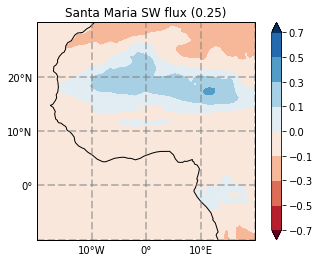

In [155]:
ax2=plt.subplot(1,1,1,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_swup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')).plot.contourf(robust=True, levels=[-.7,-.5,-.3,-.1,0,.1,.3,.5,.7],extend='both', add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux (%.2f)'%ms_sfc_clrs[1])

Text(0.5, 1.0, 'Santa Maria SW flux (0.25)')

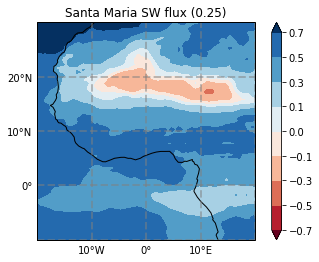

In [157]:
ax2=plt.subplot(1,1,1,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-stmaria_swdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')).plot.contourf(robust=True, levels=[-.7,-.5,-.3,-.1,0,.1,.3,.5,.7],extend='both', add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux (%.2f)'%ms_sfc_clrs[1])

Text(0.5, 1.0, 'Agung Sfc SW dn')

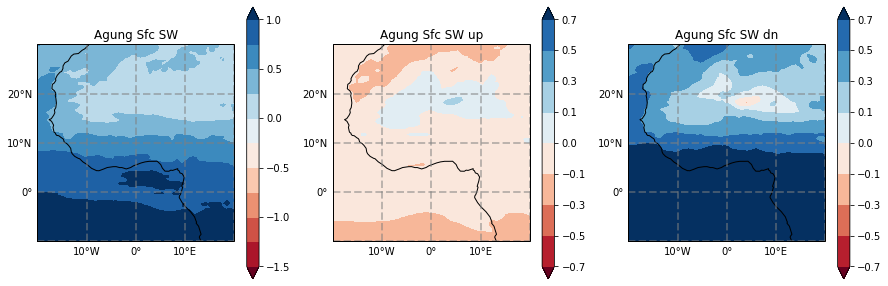

In [305]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_sw_sfc_clr_ms).plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu')
g2=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines() 
plt.title('Agung Sfc SW')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_swup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')).plot.contourf(robust=True, levels=[-.7,-.5,-.3,-.1,0,.1,.3,.5,.7],extend='both', add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Agung Sfc SW up')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-agung_swdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')).plot.contourf(robust=True, levels=[-.7,-.5,-.3,-.1,0,.1,.3,.5,.7],extend='both', add_labels=False, cmap='RdBu')
g2=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Sfc SW dn')

Text(0.5, 1.0, 'Pinatubo Sfc SW dn')

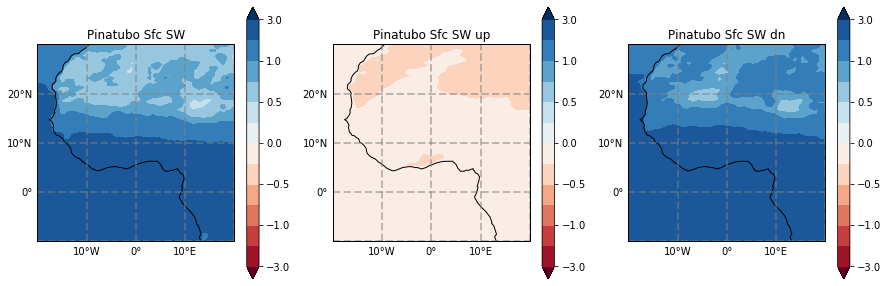

In [310]:
plt.figure(figsize=(15,5))
levels=[-3,-1.5,-1,-.75,-.5,-.25,0,0.25,.5,.75,1,1.5,3]

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sw_sfc_clr_ms).plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu')
g2=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines() 
plt.title('Pinatubo Sfc SW')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_swup_sfc_clr).plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Pinatubo Sfc SW up')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-pinatubo_swdn_sfc_clr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').plot.contourf(robust=True,levels=levels,extend='both', add_labels=False, cmap='RdBu')
g2=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Pinatubo Sfc SW dn')

## checking swdn stuff

In [338]:
len(das)

8

Text(0.5, 0.9, 'Monsoon season')

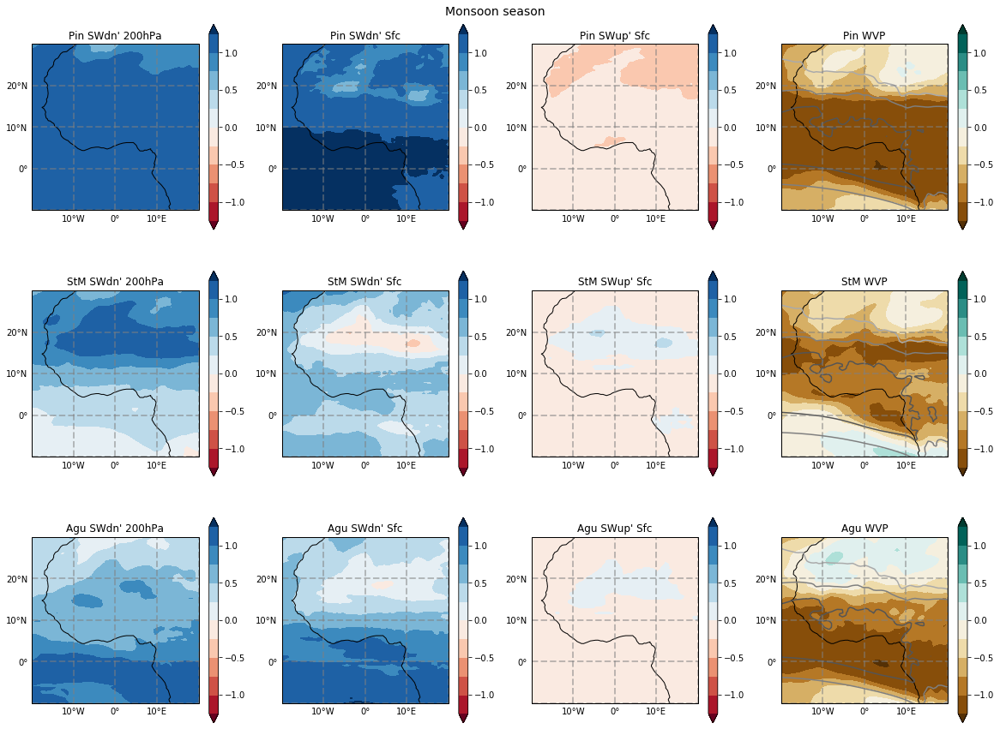

In [372]:
# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(3, 4, figsize=(20,15))
levels_sw = [-2,-1,-0.75,-0.5,-.25,0,.25,.5,.75,1,2]
cmaps=['RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG']
#das=[-1*(pinatubo_swdn_200hPa_clr-pinatubo_swdn_sfc_clr),-pinatubo_swdn_sfc_clr,pinatubo_swup_sfc_clr,pinatubo_wvp_a,-1*(stmaria_swdn_200hPa_clr-stmaria_swdn_sfc_clr),-stmaria_swdn_sfc_clr,stmaria_swup_sfc_clr,stmaria_wvp_a,-1*(agung_swdn_200hPa_clr-agung_swdn_sfc_clr),-agung_swdn_sfc_clr,agung_swup_sfc_clr,agung_wvp_a]
das=[-1*(pinatubo_swdn_200hPa_clr),-pinatubo_swdn_sfc_clr,pinatubo_swup_sfc_clr,pinatubo_wvp_a,-1*(stmaria_swdn_200hPa_clr),-stmaria_swdn_sfc_clr,stmaria_swup_sfc_clr,stmaria_wvp_a,-1*(agung_swdn_200hPa_clr),-agung_swdn_sfc_clr,agung_swup_sfc_clr,agung_wvp_a]
titles = ["Pin SWdn' 200hPa","Pin SWdn' Sfc", "Pin SWup' Sfc", "Pin WVP","StM SWdn' 200hPa","StM SWdn' Sfc", "StM SWup' Sfc", "StM WVP" ,"Agu SWdn' 200hPa","Agu SWdn' Sfc", "Agu SWup' Sfc", "Agu WVP"]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,4,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(das[ii]).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').plot.contourf(robust=True, cmap=cmaps[ii], levels=levels_sw, extend='both',add_labels=False)
    if (ii+1==4):
        shift_longitude(da_ms[0]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==8):
        shift_longitude(da_ms[1]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==12):
        shift_longitude(da_ms[2]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

#ax = fig.add_axes((.95,.2,.02,.6))
#plt.colorbar(im, ticks=levels,cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('Monsoon season',fontsize=14,y=.9)
#plt.savefig('ms_wvp.png', bbox_inches='tight')

In [408]:
# SW absorbed from toa to surface or 200hPa (call it t for tau?)
#pinatubo_clr_sw_t = (xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')-xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/'))/xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')
#stmaria_clr_sw_t = (xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')-xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/'))/xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')
#agung_clr_sw_t = (xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')-xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/'))/xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_toa_clr.nc/')
#ctl_clr_sw_t = (xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_toa_clr.nc/')-xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_sfc_clr.nc/'))/xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_toa_clr.nc/')

pinatubo_clr_sw_t = -1*np.log(xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/')/xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_200hPa_clr.nc/'))
stmaria_clr_sw_t = -1*np.log(xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/')/xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_200hPa_clr.nc/'))
agung_clr_sw_t = -1*np.log(xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_sfc_clr.nc/')/xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_200hPa_clr.nc/'))
ctl_clr_sw_t = -1* np.log(xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_sfc_clr.nc/')/xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_200hPa_clr.nc/'))


# subtract control
ctl_clr_sw_t['time']=pinatubo_clr_sw_t['time']
pinatubo_clr_sw_t = pinatubo_clr_sw_t - ctl_clr_sw_t

ctl_clr_sw_t['time']=stmaria_clr_sw_t['time']
stmaria_clr_sw_t = stmaria_clr_sw_t - ctl_clr_sw_t

ctl_clr_sw_t['time']=agung_clr_sw_t['time']
agung_clr_sw_t = agung_clr_sw_t - ctl_clr_sw_t

#monsoon season changes
pinatubo_clr_sw_t_ms = pinatubo_clr_sw_t.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_clr_sw_t_ms = stmaria_clr_sw_t.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_clr_sw_t_ms = agung_clr_sw_t.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')


/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


Text(0.5, 0.95, 'SWdn absorption anomaly from 200hPa to Sfc and WVP')

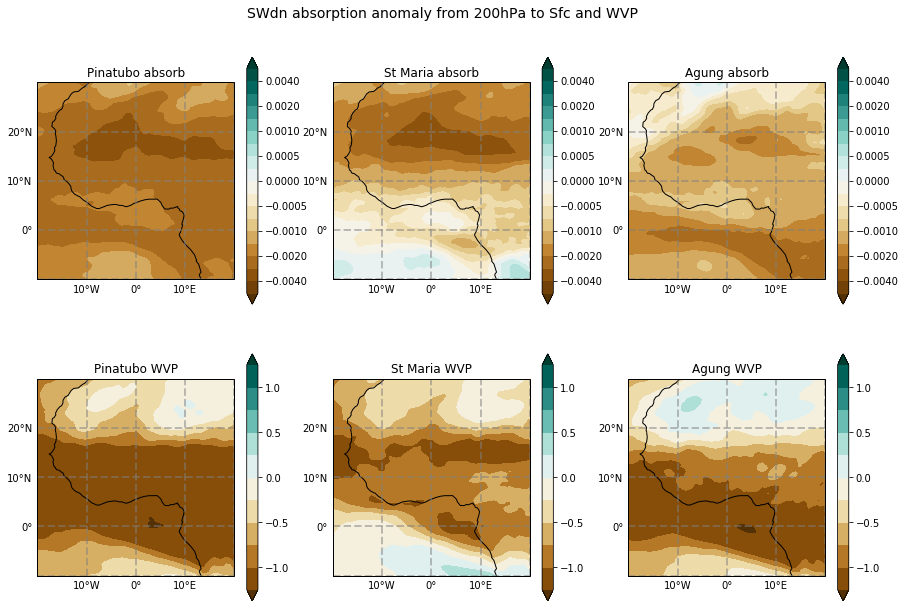

In [429]:
#SWdn absorption coeff between 200hPa and sfc = $_clr_sw_t_ms
fig, axes = plt.subplots(2, 3, figsize=(15,10))
levels_abs = [-.005,-.004,-.003,-.002,-.0015,-0.001,-.00075,-.0005,-.00025,0,.00025,.0005,.00075,.001,.0015,.002,.003,.004,.005]
levels_wvp = [-2,-1,-0.75,-0.5,-.25,0,.25,.5,.75,1,2]
da_ms = [pinatubo_clr_sw_t_ms, stmaria_clr_sw_t_ms, agung_clr_sw_t_ms, pinatubo_wvp_a,stmaria_wvp_a,agung_wvp_a]
titles = ['Pinatubo absorb','St Maria absorb', 'Agung absorb','Pinatubo WVP','St Maria WVP', 'Agung WVP']

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(2,3,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    if ii<3:
        shift_longitude(da_ms[ii]).plot.contourf(cmap='BrBG',levels=levels_abs,extend='both',add_colorbar=True, add_labels=False)
    else:
        shift_longitude(da_ms[ii].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')).plot.contourf(cmap='BrBG',levels=levels_wvp,extend='both',add_colorbar=True, add_labels=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

#ax = fig.add_axes((.95,.2,.02,.6))
#plt.colorbar(im, cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('Monsoon Season SWdn absorption anomaly from 200hPa to Sfc and WVP',fontsize=14,y=.95)

#plt.savefig(, bbox_inches='tight')

Text(0.5, 0.95, 'October SWdn absorption anomaly from 200hPa to Sfc and WVP')

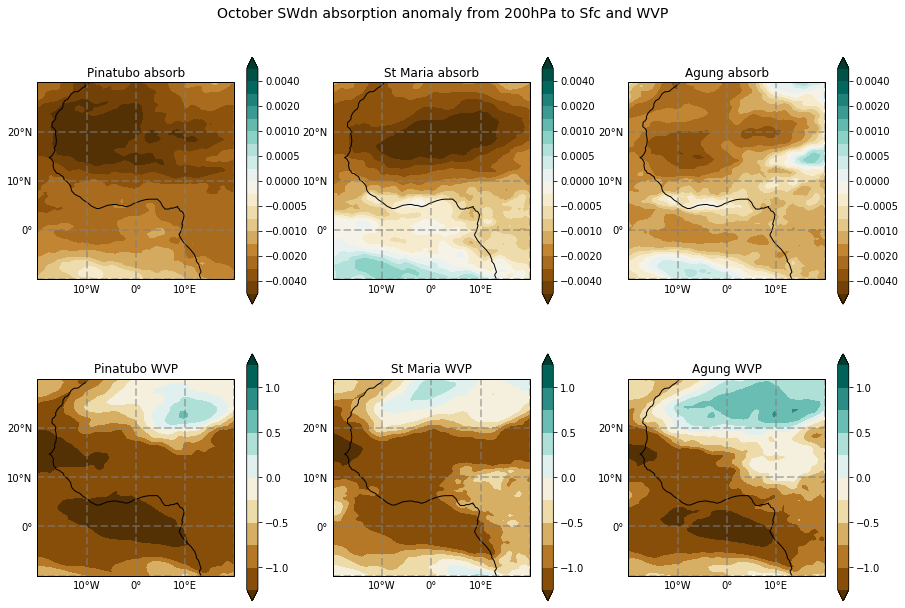

In [439]:
#SWdn absorption coeff between 200hPa and sfc = $_clr_sw_t_ms
fig, axes = plt.subplots(2, 3, figsize=(15,10))
levels_abs = [-.005,-.004,-.003,-.002,-.0015,-0.001,-.00075,-.0005,-.00025,0,.00025,.0005,.00075,.001,.0015,.002,.003,.004,.005]
levels_wvp = [-2,-1,-0.75,-0.5,-.25,0,.25,.5,.75,1,2]
da_ms = [pinatubo_clr_sw_t, stmaria_clr_sw_t, agung_clr_sw_t, pinatubo_wvp_a,stmaria_wvp_a,agung_wvp_a]
titles = ['Pinatubo absorb','St Maria absorb', 'Agung absorb','Pinatubo WVP','St Maria WVP', 'Agung WVP']
month = 10

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(2,3,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    if ii<3:
        shift_longitude(da_ms[ii].groupby('time.month').mean(['time','en']).sel(month=month).squeeze()).plot.contourf(cmap='BrBG',levels=levels_abs,extend='both',add_colorbar=True, add_labels=False)
    else:
        shift_longitude(da_ms[ii].groupby('time.month').mean(['time','en']).sel(month=month).squeeze()).plot.contourf(cmap='BrBG',levels=levels_wvp,extend='both',add_colorbar=True, add_labels=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

#ax = fig.add_axes((.95,.2,.02,.6))
#plt.colorbar(im, cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('October SWdn absorption anomaly from 200hPa to Sfc and WVP',fontsize=14,y=.95)

#plt.savefig(, bbox_inches='tight')

/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/dataarray.py:2710: FutureWarning: roll_coords will be set to False in the future. Explicitly set roll_coords to silence warning.
  shifts=shifts, roll_coords=roll_coords, **shifts_kwargs


Text(0.5, 1.0, 'Control WVP')

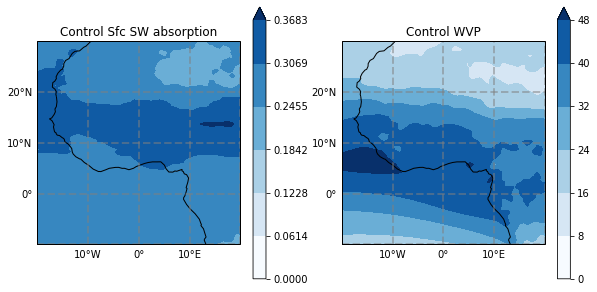

In [424]:
plt.figure(figsize=(10,5))
ax1=plt.subplot(1,2,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_clr_sw_t.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')).plot.contourf(robust=True, vmin=0,add_labels=False, cmap='Blues')
g2=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines() 
plt.title('Control Sfc SW absorption')

ax2=plt.subplot(1,2,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(ctl_wvp.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')).plot.contourf(robust=True, vmin=0,add_labels=False, cmap='Blues')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Control WVP')

Text(0.5, 0.9, 'June')

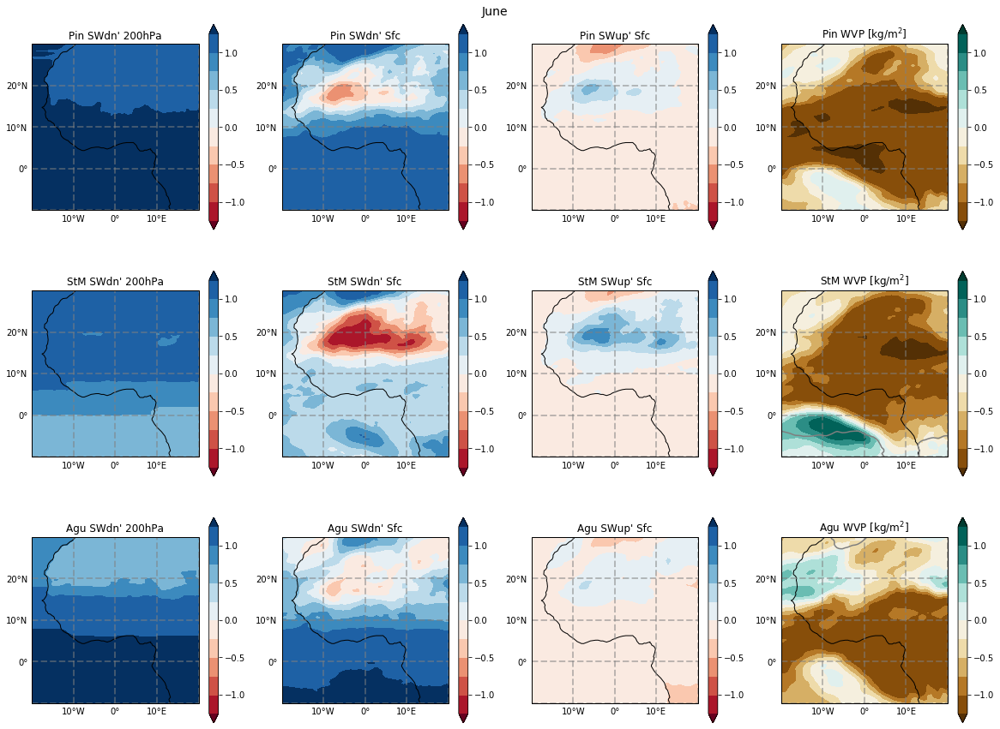

In [422]:
# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(3, 4, figsize=(20,15))
levels_sw = [-2,-1,-0.75,-0.5,-.25,0,.25,.5,.75,1,2]
cmaps=['RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG']
das=[-1*pinatubo_swdn_200hPa_clr,-pinatubo_swdn_sfc_clr,pinatubo_swup_sfc_clr,pinatubo_wvp_a,-1*stmaria_swdn_200hPa_clr,-stmaria_swdn_sfc_clr,stmaria_swup_sfc_clr,stmaria_wvp_a,-1*agung_swdn_200hPa_clr,-agung_swdn_sfc_clr,agung_swup_sfc_clr,agung_wvp_a]
titles = ["Pin SWdn' 200hPa","Pin SWdn' Sfc", "Pin SWup' Sfc", "Pin WVP [kg/m$^2$]","StM SWdn' 200hPa","StM SWdn' Sfc", "StM SWup' Sfc", "StM WVP [kg/m$^2$]" ,"Agu SWdn' 200hPa","Agu SWdn' Sfc", "Agu SWup' Sfc", "Agu WVP [kg/m$^2$]"]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,4,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(das[ii]).groupby('time.month').mean(['time','en']).sel(month=6).squeeze().plot.contourf(robust=True, cmap=cmaps[ii], levels=levels_sw, extend='both',add_labels=False)
    #if (ii+1==4):
    #    shift_longitude(da_ms[0]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    #if (ii+1==8):
    #    shift_longitude(da_ms[1]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    #if (ii+1==12):
    #    shift_longitude(da_ms[2]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

#ax = fig.add_axes((.95,.2,.02,.6))
#plt.colorbar(im, ticks=levels,cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('June',fontsize=14,y=.9)
#plt.savefig('ms_wvp.png', bbox_inches='tight')

Text(0.5, 0.9, 'July')

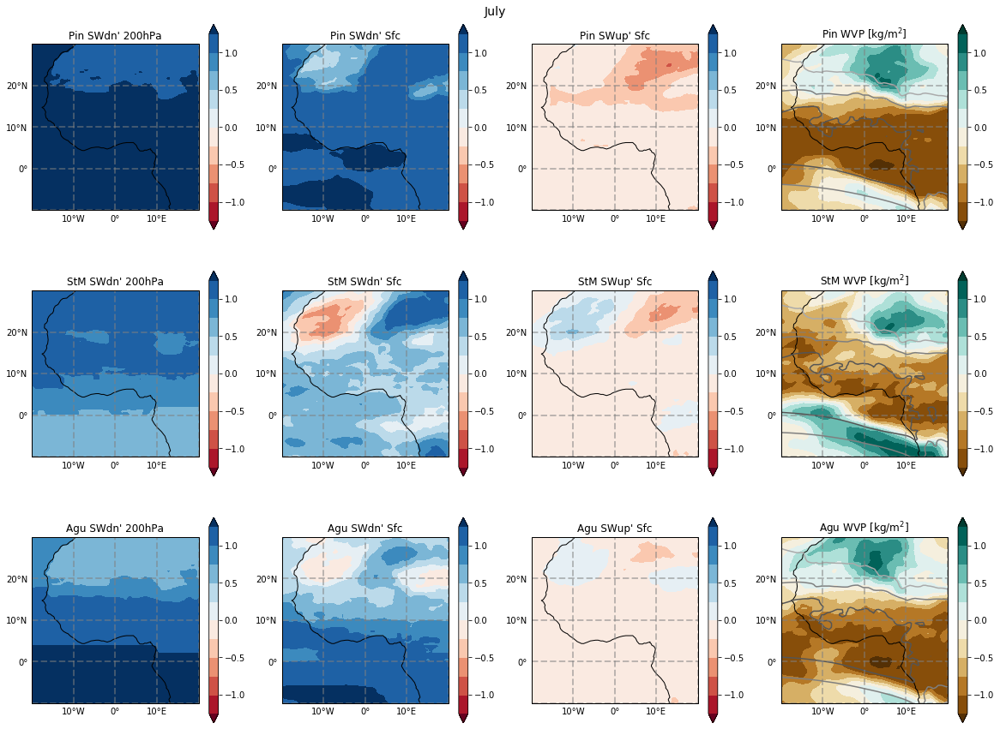

In [360]:
# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(3, 4, figsize=(20,15))
levels_sw = [-2,-1,-0.75,-0.5,-.25,0,.25,.5,.75,1,2]
cmaps=['RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG']
das=[-1*pinatubo_swdn_200hPa_clr,-pinatubo_swdn_sfc_clr,pinatubo_swup_sfc_clr,pinatubo_wvp_a,-1*stmaria_swdn_200hPa_clr,-stmaria_swdn_sfc_clr,stmaria_swup_sfc_clr,stmaria_wvp_a,-1*agung_swdn_200hPa_clr,-agung_swdn_sfc_clr,agung_swup_sfc_clr,agung_wvp_a]
titles = ["Pin SWdn' 200hPa","Pin SWdn' Sfc", "Pin SWup' Sfc", "Pin WVP [kg/m$^2$]","StM SWdn' 200hPa","StM SWdn' Sfc", "StM SWup' Sfc", "StM WVP [kg/m$^2$]" ,"Agu SWdn' 200hPa","Agu SWdn' Sfc", "Agu SWup' Sfc", "Agu WVP [kg/m$^2$]"]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,4,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(das[ii]).groupby('time.month').mean(['time','en']).sel(month=7).squeeze().plot.contourf(robust=True, cmap=cmaps[ii], levels=levels_sw, extend='both',add_labels=False)
    if (ii+1==4):
        shift_longitude(da_ms[0]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==8):
        shift_longitude(da_ms[1]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==12):
        shift_longitude(da_ms[2]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

#ax = fig.add_axes((.95,.2,.02,.6))
#plt.colorbar(im, ticks=levels,cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('July',fontsize=14,y=.9)
#plt.savefig('ms_wvp.png', bbox_inches='tight')

Text(0.5, 0.9, 'August')

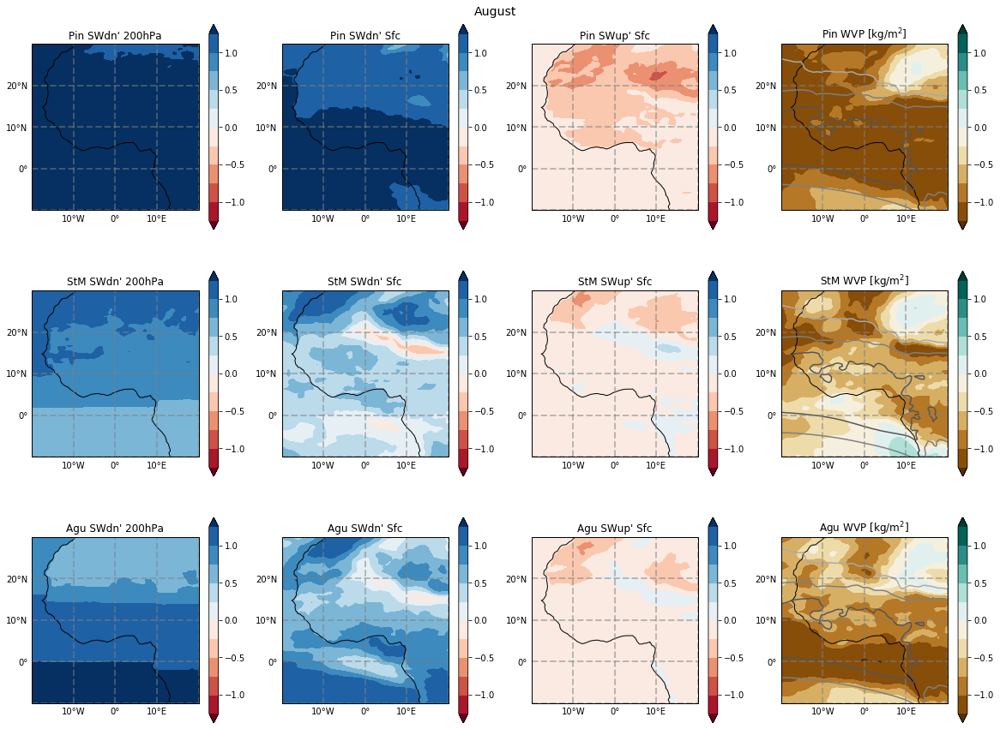

In [361]:
# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(3, 4, figsize=(20,15))
levels_sw = [-2,-1,-0.75,-0.5,-.25,0,.25,.5,.75,1,2]
cmaps=['RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG']
das=[-1*pinatubo_swdn_200hPa_clr,-pinatubo_swdn_sfc_clr,pinatubo_swup_sfc_clr,pinatubo_wvp_a,-1*stmaria_swdn_200hPa_clr,-stmaria_swdn_sfc_clr,stmaria_swup_sfc_clr,stmaria_wvp_a,-1*agung_swdn_200hPa_clr,-agung_swdn_sfc_clr,agung_swup_sfc_clr,agung_wvp_a]
titles = ["Pin SWdn' 200hPa","Pin SWdn' Sfc", "Pin SWup' Sfc", "Pin WVP [kg/m$^2$]","StM SWdn' 200hPa","StM SWdn' Sfc", "StM SWup' Sfc", "StM WVP [kg/m$^2$]" ,"Agu SWdn' 200hPa","Agu SWdn' Sfc", "Agu SWup' Sfc", "Agu WVP [kg/m$^2$]"]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,4,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(das[ii]).groupby('time.month').mean(['time','en']).sel(month=8).squeeze().plot.contourf(robust=True, cmap=cmaps[ii], levels=levels_sw, extend='both',add_labels=False)
    if (ii+1==4):
        shift_longitude(da_ms[0]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==8):
        shift_longitude(da_ms[1]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==12):
        shift_longitude(da_ms[2]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

#ax = fig.add_axes((.95,.2,.02,.6))
#plt.colorbar(im, ticks=levels,cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('August',fontsize=14,y=.9)
#plt.savefig('ms_wvp.png', bbox_inches='tight')

Text(0.5, 0.9, 'September')

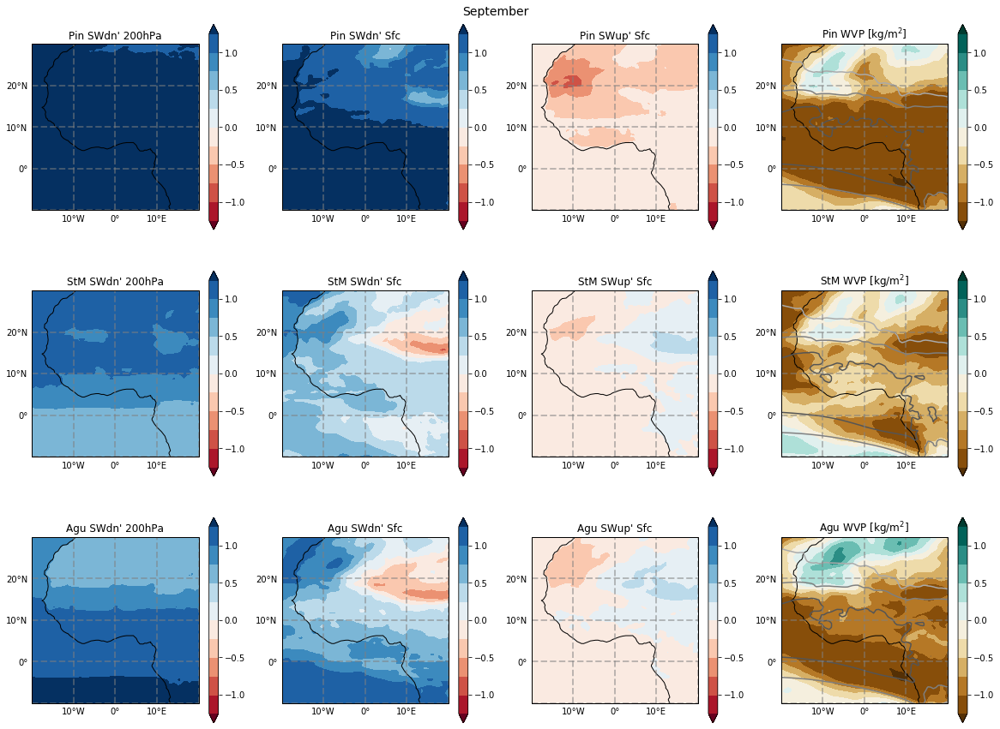

In [362]:
# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(3, 4, figsize=(20,15))
levels_sw = [-2,-1,-0.75,-0.5,-.25,0,.25,.5,.75,1,2]
cmaps=['RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG']
das=[-1*pinatubo_swdn_200hPa_clr,-pinatubo_swdn_sfc_clr,pinatubo_swup_sfc_clr,pinatubo_wvp_a,-1*stmaria_swdn_200hPa_clr,-stmaria_swdn_sfc_clr,stmaria_swup_sfc_clr,stmaria_wvp_a,-1*agung_swdn_200hPa_clr,-agung_swdn_sfc_clr,agung_swup_sfc_clr,agung_wvp_a]
titles = ["Pin SWdn' 200hPa","Pin SWdn' Sfc", "Pin SWup' Sfc", "Pin WVP [kg/m$^2$]","StM SWdn' 200hPa","StM SWdn' Sfc", "StM SWup' Sfc", "StM WVP [kg/m$^2$]" ,"Agu SWdn' 200hPa","Agu SWdn' Sfc", "Agu SWup' Sfc", "Agu WVP [kg/m$^2$]"]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,4,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(das[ii]).groupby('time.month').mean(['time','en']).sel(month=9).squeeze().plot.contourf(robust=True, cmap=cmaps[ii], levels=levels_sw, extend='both',add_labels=False)
    if (ii+1==4):
        shift_longitude(da_ms[0]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==8):
        shift_longitude(da_ms[1]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==12):
        shift_longitude(da_ms[2]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

#ax = fig.add_axes((.95,.2,.02,.6))
#plt.colorbar(im, ticks=levels,cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('September',fontsize=14,y=.9)
#plt.savefig('ms_wvp.png', bbox_inches='tight')

Text(0.5, 0.9, 'October')

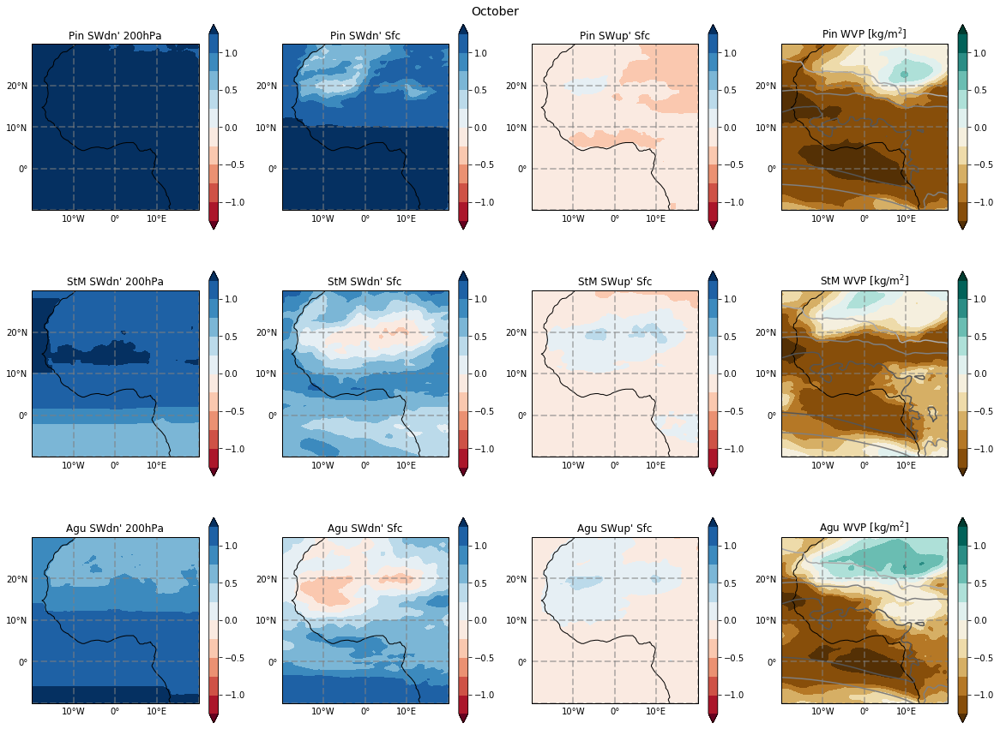

In [363]:
# plt.figure(figsize=(20,10))
fig, axes = plt.subplots(3, 4, figsize=(20,15))
levels_sw = [-2,-1,-0.75,-0.5,-.25,0,.25,.5,.75,1,2]
cmaps=['RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG','RdBu','RdBu','RdBu','BrBG']
das=[-1*pinatubo_swdn_200hPa_clr,-pinatubo_swdn_sfc_clr,pinatubo_swup_sfc_clr,pinatubo_wvp_a,-1*stmaria_swdn_200hPa_clr,-stmaria_swdn_sfc_clr,stmaria_swup_sfc_clr,stmaria_wvp_a,-1*agung_swdn_200hPa_clr,-agung_swdn_sfc_clr,agung_swup_sfc_clr,agung_wvp_a]
titles = ["Pin SWdn' 200hPa","Pin SWdn' Sfc", "Pin SWup' Sfc", "Pin WVP [kg/m$^2$]","StM SWdn' 200hPa","StM SWdn' Sfc", "StM SWup' Sfc", "StM WVP [kg/m$^2$]" ,"Agu SWdn' 200hPa","Agu SWdn' Sfc", "Agu SWup' Sfc", "Agu WVP [kg/m$^2$]"]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,4,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
    im = shift_longitude(das[ii]).groupby('time.month').mean(['time','en']).sel(month=10).squeeze().plot.contourf(robust=True, cmap=cmaps[ii], levels=levels_sw, extend='both',add_labels=False)
    if (ii+1==4):
        shift_longitude(da_ms[0]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==8):
        shift_longitude(da_ms[1]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    if (ii+1==12):
        shift_longitude(da_ms[2]).plot.contour(cmap='gist_yarg',add_colorbar=False)#add_labels=False,)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER
    g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
    g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

#ax = fig.add_axes((.95,.2,.02,.6))
#plt.colorbar(im, ticks=levels,cax=ax,orientation='vertical',label='kg/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('October',fontsize=14,y=.9)
#plt.savefig('ms_wvp.png', bbox_inches='tight')

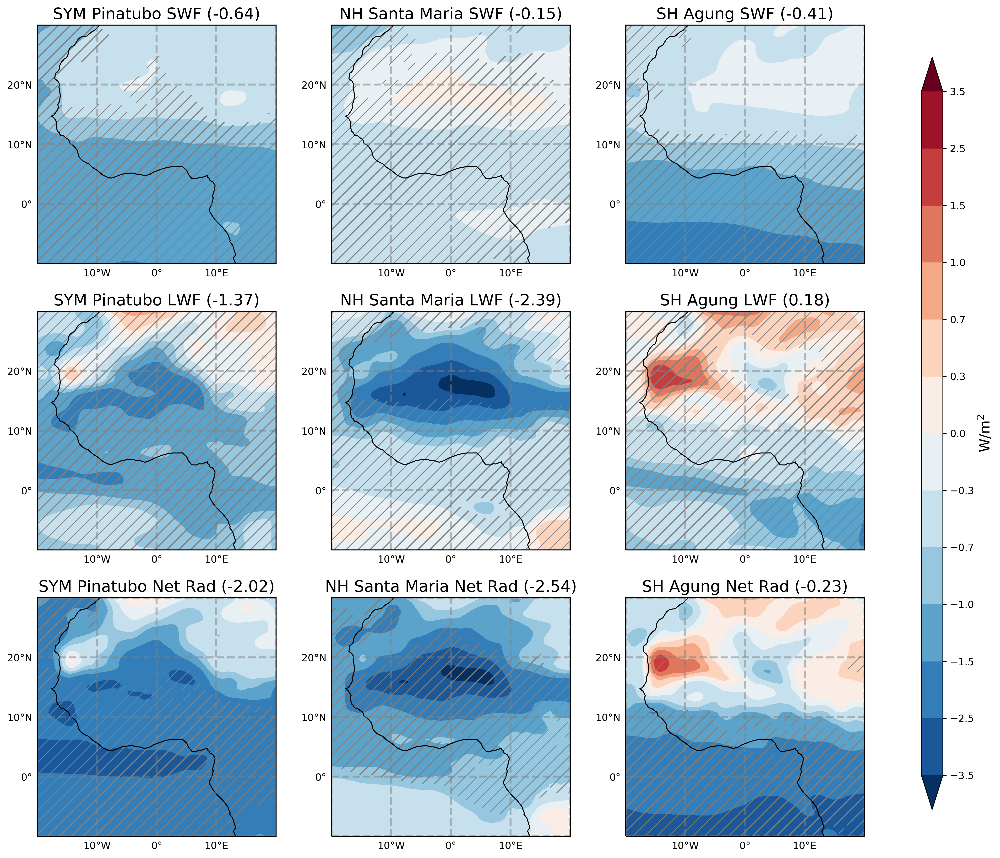

In [249]:
fig = plt.figure(figsize=(15,15))
levels=[-3.5,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,3.5]
plt.rcParams['hatch.color'] = 'grey'

ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-pinatubo_sw_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[0].where(pvalue[0]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo SWF (%.2f)'%-ms_sfc_clrs[0],fontsize=16)

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-stmaria_sw_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[1].where(pvalue[1]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria SWF (%.2f)'%-ms_sfc_clrs[1],fontsize=16)

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-agung_sw_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[2].where(pvalue[2]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung SWF (%.2f)'%-ms_sfc_clrs[2],fontsize=16)

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-pinatubo_lw_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[3].where(pvalue[3]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo LWF (%.2f)'%-ms_sfc_clrs[3],fontsize=16)

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-stmaria_lw_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[4].where(pvalue[4]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria LWF (%.2f)'%-ms_sfc_clrs[4],fontsize=16)

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-agung_lw_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[5].where(pvalue[5]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung LWF (%.2f)'%-ms_sfc_clrs[5], fontsize=16)

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-pinatubo_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[6].where(pvalue[6]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo Net Rad (%.2f)'%-ms_sfc_clrs[6],fontsize=16)

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-stmaria_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[7].where(pvalue[7]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria Net Rad (%.2f)'%-ms_sfc_clrs[7],fontsize=16)

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(-agung_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[8].where(pvalue[8]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung Net Rad (%.2f)'%-ms_sfc_clrs[8],fontsize=16)

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical').set_label(label='W/m$^2$',size=14)
#plt.tight_layout(rect=(0,0,.9,1))

#plt.suptitle('MS sfc clear sky fluxes [W/m$^2$], Sahel region',fontsize=20)
#positive down
plt.savefig('clearsky_sfc_ms_3x3_smooth.png', bbox_inches='tight')

## 200hPa all sky

In [127]:
# W/m^2, 200hPa SW, all sky
pinatubo_swup_200hPa = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swup_200hPa.nc/') 
pinatubo_swdn_200hPa = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_200hPa.nc/') 
stmaria_swup_200hPa = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swup_200hPa.nc/')
stmaria_swdn_200hPa = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_200hPa.nc/') 
agung_swup_200hPa = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swup_200hPa.nc/')
agung_swdn_200hPa = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_200hPa.nc/')
ctl_swup_200hPa = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swup_200hPa.nc/') 
ctl_swdn_200hPa = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_200hPa.nc/') 

# subtract ctl
ctl_swup_200hPa['time']=pinatubo_swup_200hPa['time']
pinatubo_swup_200hPa = pinatubo_swup_200hPa - ctl_swup_200hPa

ctl_swup_200hPa['time']=stmaria_swup_200hPa['time']
stmaria_swup_200hPa = stmaria_swup_200hPa - ctl_swup_200hPa

ctl_swup_200hPa['time']=agung_swup_200hPa['time']
agung_swup_200hPa = agung_swup_200hPa - ctl_swup_200hPa


ctl_swdn_200hPa['time']=pinatubo_swdn_200hPa['time']
pinatubo_swdn_200hPa = pinatubo_swdn_200hPa - ctl_swdn_200hPa

ctl_swdn_200hPa['time']=stmaria_swdn_200hPa['time']
stmaria_swdn_200hPa = stmaria_swdn_200hPa - ctl_swdn_200hPa

ctl_swdn_200hPa['time']=agung_swdn_200hPa['time']
agung_swdn_200hPa = agung_swdn_200hPa - ctl_swdn_200hPa

#net SW 200hPa 
pinatubo_sw_200hPa = pinatubo_swup_200hPa - pinatubo_swdn_200hPa

stmaria_sw_200hPa = stmaria_swup_200hPa - stmaria_swdn_200hPa

agung_sw_200hPa = agung_swup_200hPa - agung_swdn_200hPa


In [128]:
# W/m^2, 200hPa LW, all sky
pinatubo_netlw_200hPa = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.netlw_200hPa.nc/') 
stmaria_netlw_200hPa = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.netlw_200hPa.nc/') 
agung_netlw_200hPa = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.netlw_200hPa.nc/')
ctl_netlw_200hPa = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.netlw_200hPa.nc/') 

# subtract ctl
ctl_netlw_200hPa['time']=pinatubo_netlw_200hPa['time']
pinatubo_netlw_200hPa = pinatubo_netlw_200hPa - ctl_netlw_200hPa

ctl_netlw_200hPa['time']=stmaria_netlw_200hPa['time']
stmaria_netlw_200hPa = stmaria_netlw_200hPa - ctl_netlw_200hPa

ctl_netlw_200hPa['time']=agung_netlw_200hPa['time']
agung_netlw_200hPa = agung_netlw_200hPa - ctl_netlw_200hPa

In [129]:
#200hPa netrad (sw + lw), all sky
pinatubo_netrad_200hPa = pinatubo_netlw_200hPa + pinatubo_sw_200hPa
stmaria_netrad_200hPa = stmaria_netlw_200hPa + stmaria_sw_200hPa
agung_netrad_200hPa = agung_netlw_200hPa + agung_sw_200hPa
ctl_netrad_200hPa = ctl_swup_200hPa - ctl_swdn_200hPa + ctl_netlw_200hPa

In [160]:
#ms 
pinatubo_netrad_200hPa_ms = pinatubo_netrad_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_netrad_200hPa_ms = stmaria_netrad_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_netrad_200hPa_ms = agung_netrad_200hPa[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_netrad_200hPa_jja = pinatubo_netrad_200hPa.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_netrad_200hPa_jja = stmaria_netrad_200hPa.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_netrad_200hPa_jja = agung_netrad_200hPa.groupby('time.season').mean(['time','en']).sel(season='JJA')

pinatubo_netrad_200hPa_djf = pinatubo_netrad_200hPa.groupby('time.season').mean(['time','en']).sel(season='DJF')
stmaria_netrad_200hPa_djf = stmaria_netrad_200hPa.groupby('time.season').mean(['time','en']).sel(season='DJF')
agung_netrad_200hPa_djf = agung_netrad_200hPa.groupby('time.season').mean(['time','en']).sel(season='DJF')


In [182]:
pinatubo_sw_200hPa_ms = pinatubo_sw_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_sw_200hPa_ms = stmaria_sw_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_sw_200hPa_ms = agung_sw_200hPa[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_sw_200hPa_jja = pinatubo_sw_200hPa[:,12:].groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_sw_200hPa_jja = stmaria_sw_200hPa[:,12:].groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_sw_200hPa_jja = agung_sw_200hPa[:,:48].groupby('time.season').mean(['time','en']).sel(season='JJA')

pinatubo_sw_200hPa_djf = pinatubo_sw_200hPa[:,12:].groupby('time.season').mean(['time','en']).sel(season='DJF')
stmaria_sw_200hPa_djf = stmaria_sw_200hPa[:,12:].groupby('time.season').mean(['time','en']).sel(season='DJF')
agung_sw_200hPa_djf = agung_sw_200hPa[:,:48].groupby('time.season').mean(['time','en']).sel(season='DJF')


pinatubo_netlw_200hPa_ms = pinatubo_netlw_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_netlw_200hPa_ms = stmaria_netlw_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_netlw_200hPa_ms = agung_netlw_200hPa[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_netlw_200hPa_jja = pinatubo_netlw_200hPa.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_netlw_200hPa_jja = stmaria_netlw_200hPa.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_netlw_200hPa_jja = agung_netlw_200hPa.groupby('time.season').mean(['time','en']).sel(season='JJA')

pinatubo_netlw_200hPa_djf = pinatubo_netlw_200hPa.groupby('time.season').mean(['time','en']).sel(season='DJF')
stmaria_netlw_200hPa_djf = stmaria_netlw_200hPa.groupby('time.season').mean(['time','en']).sel(season='DJF')
agung_netlw_200hPa_djf = agung_netlw_200hPa.groupby('time.season').mean(['time','en']).sel(season='DJF')


In [10]:
ms_200hPa_all = [pinatubo_sw_200hPa_ms, stmaria_sw_200hPa_ms, agung_sw_200hPa_ms,pinatubo_netlw_200hPa_ms, stmaria_netlw_200hPa_ms,agung_netlw_200hPa_ms, pinatubo_netrad_200hPa_ms, stmaria_netrad_200hPa_ms, agung_netrad_200hPa_ms]
ms_200hPa_all = [a.isel(lon=(pinatubo_sw_200hPa.lon<=10)|(pinatubo_sw_200hPa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']) for a in ms_200hPa_all]
ms_200hPa_all

[<xarray.DataArray ()>
 array(1.8209891, dtype=float32), <xarray.DataArray ()>
 array(0.28494745, dtype=float32), <xarray.DataArray ()>
 array(1.6487199, dtype=float32), <xarray.DataArray 'netlw_200hPa' ()>
 array(-1.3725053, dtype=float32), <xarray.DataArray 'netlw_200hPa' ()>
 array(0.5067449, dtype=float32), <xarray.DataArray 'netlw_200hPa' ()>
 array(-1.9427485, dtype=float32), <xarray.DataArray ()>
 array(0.44848374, dtype=float32), <xarray.DataArray ()>
 array(0.7916924, dtype=float32), <xarray.DataArray ()>
 array(-0.29402858, dtype=float32)]

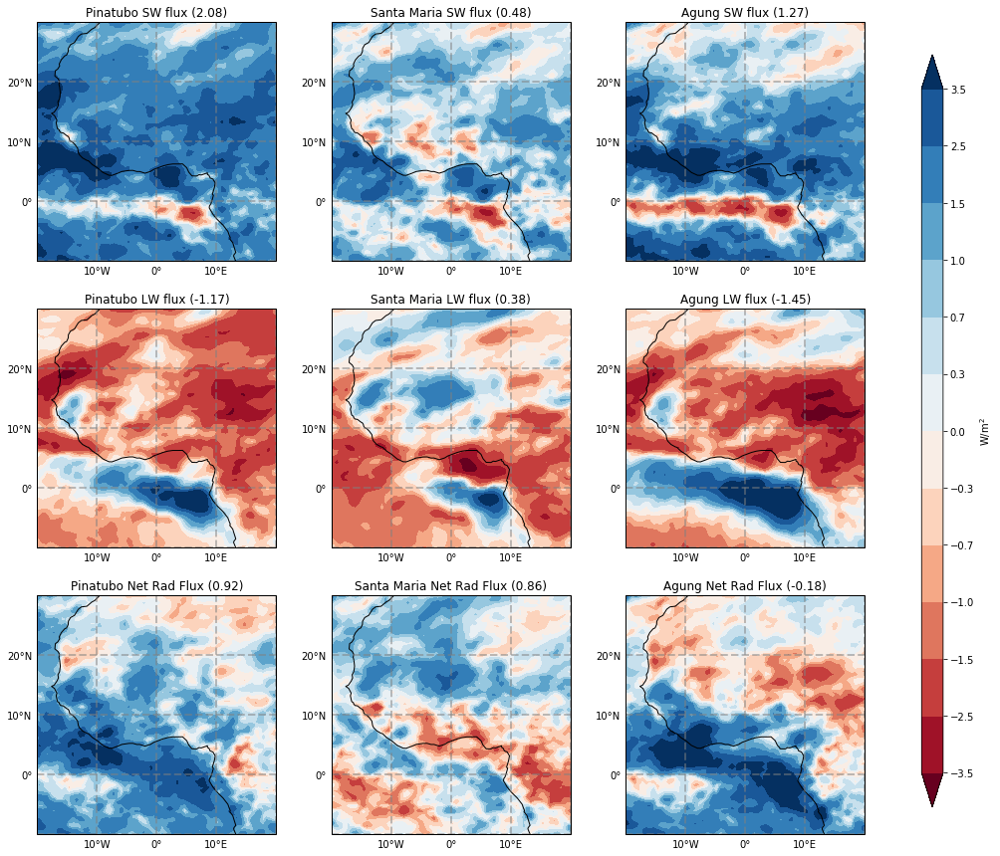

In [24]:
fig = plt.figure(figsize=(15,15))
levels=[-3.5,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,3.5]

ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sw_200hPa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo SW flux (%.2f)'%ms_200hPa_all[0])

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_sw_200hPa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux (%.2f)'%ms_200hPa_all[1])

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_sw_200hPa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung SW flux (%.2f)'%ms_200hPa_all[2])

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_netlw_200hPa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo LW flux (%.2f)'%ms_200hPa_all[3])

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_netlw_200hPa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria LW flux (%.2f)'%ms_200hPa_all[4])

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_netlw_200hPa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung LW flux (%.2f)'%ms_200hPa_all[5])

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_netrad_200hPa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Net Rad Flux (%.2f)'%ms_200hPa_all[6])

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_netrad_200hPa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Net Rad Flux (%.2f)'%ms_200hPa_all[7])

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_netrad_200hPa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Net Rad Flux (%.2f)'%ms_200hPa_all[8])

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical',label='W/m$^2$')

#plt.suptitle('MS 200hPa all sky fluxes [W/m$^2$]',fontsize=20)
#positive up
#plt.savefig('200hPa_ms_3x3.png', bbox_inches='tight')

## Linear tropopause all sky

In [23]:
# W/m^2, lin_trop SW, all sky
pinatubo_swup_lin_trop = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swup_lin_trop.nc/') 
pinatubo_swdn_lin_trop = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_lin_trop.nc/') 
stmaria_swup_lin_trop = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swup_lin_trop.nc/')
stmaria_swdn_lin_trop = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_lin_trop.nc/') 
agung_swup_lin_trop = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swup_lin_trop.nc/')
agung_swdn_lin_trop = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_lin_trop.nc/')
ctl_swup_lin_trop = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swup_lin_trop.nc/') 
ctl_swdn_lin_trop = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_lin_trop.nc/') 

# subtract ctl
ctl_swup_lin_trop['time']=pinatubo_swup_lin_trop['time']
pinatubo_swup_lin_trop = pinatubo_swup_lin_trop - ctl_swup_lin_trop

ctl_swup_lin_trop['time']=stmaria_swup_lin_trop['time']
stmaria_swup_lin_trop = stmaria_swup_lin_trop - ctl_swup_lin_trop

ctl_swup_lin_trop['time']=agung_swup_lin_trop['time']
agung_swup_lin_trop = agung_swup_lin_trop - ctl_swup_lin_trop


ctl_swdn_lin_trop['time']=pinatubo_swdn_lin_trop['time']
pinatubo_swdn_lin_trop = pinatubo_swdn_lin_trop - ctl_swdn_lin_trop

ctl_swdn_lin_trop['time']=stmaria_swdn_lin_trop['time']
stmaria_swdn_lin_trop = stmaria_swdn_lin_trop - ctl_swdn_lin_trop

ctl_swdn_lin_trop['time']=agung_swdn_lin_trop['time']
agung_swdn_lin_trop = agung_swdn_lin_trop - ctl_swdn_lin_trop

#net SW lin_trop 
pinatubo_sw_lin_trop = pinatubo_swup_lin_trop - pinatubo_swdn_lin_trop

stmaria_sw_lin_trop = stmaria_swup_lin_trop - stmaria_swdn_lin_trop

agung_sw_lin_trop = agung_swup_lin_trop - agung_swdn_lin_trop

# W/m^2, lin_trop LW, all sky
pinatubo_netlw_lin_trop = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.netlw_lin_trop.nc/') 
stmaria_netlw_lin_trop = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.netlw_lin_trop.nc/') 
agung_netlw_lin_trop = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.netlw_lin_trop.nc/')
ctl_netlw_lin_trop = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.netlw_lin_trop.nc/') 

# subtract ctl
ctl_netlw_lin_trop['time']=pinatubo_netlw_lin_trop['time']
pinatubo_netlw_lin_trop = pinatubo_netlw_lin_trop - ctl_netlw_lin_trop

ctl_netlw_lin_trop['time']=stmaria_netlw_lin_trop['time']
stmaria_netlw_lin_trop = stmaria_netlw_lin_trop - ctl_netlw_lin_trop

ctl_netlw_lin_trop['time']=agung_netlw_lin_trop['time']
agung_netlw_lin_trop = agung_netlw_lin_trop - ctl_netlw_lin_trop

#lin_trop netrad (sw + lw), all sky
pinatubo_netrad_lin_trop = pinatubo_netlw_lin_trop + pinatubo_sw_lin_trop
stmaria_netrad_lin_trop = stmaria_netlw_lin_trop + stmaria_sw_lin_trop
agung_netrad_lin_trop = agung_netlw_lin_trop + agung_sw_lin_trop
ctl_netrad_lin_trop = ctl_swup_lin_trop - ctl_swdn_lin_trop + ctl_netlw_lin_trop


In [100]:
#ms 
pinatubo_netrad_lin_trop_ms = pinatubo_netrad_lin_trop.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_netrad_lin_trop_ms = stmaria_netrad_lin_trop.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_netrad_lin_trop_ms = agung_netrad_lin_trop.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_netrad_lin_trop_jja = pinatubo_netrad_lin_trop.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_netrad_lin_trop_jja = stmaria_netrad_lin_trop.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_netrad_lin_trop_jja = agung_netrad_lin_trop.groupby('time.season').mean(['time','en']).sel(season='JJA')

pinatubo_netrad_lin_trop_djf = pinatubo_netrad_lin_trop.groupby('time.season').mean(['time','en']).sel(season='DJF')
stmaria_netrad_lin_trop_djf = stmaria_netrad_lin_trop.groupby('time.season').mean(['time','en']).sel(season='DJF')
agung_netrad_lin_trop_djf = agung_netrad_lin_trop.groupby('time.season').mean(['time','en']).sel(season='DJF')

pinatubo_sw_lin_trop_ms = pinatubo_sw_lin_trop.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_sw_lin_trop_ms = stmaria_sw_lin_trop.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_sw_lin_trop_ms = agung_sw_lin_trop.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_sw_lin_trop_jja = pinatubo_sw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_sw_lin_trop_jja = stmaria_sw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_sw_lin_trop_jja = agung_sw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='JJA')

pinatubo_sw_lin_trop_djf = pinatubo_sw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='DJF')
stmaria_sw_lin_trop_djf = stmaria_sw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='DJF')
agung_sw_lin_trop_djf = agung_sw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='DJF')

pinatubo_netlw_lin_trop_ms = pinatubo_netlw_lin_trop.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_netlw_lin_trop_ms = stmaria_netlw_lin_trop.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_netlw_lin_trop_ms = agung_netlw_lin_trop.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_netlw_lin_trop_jja = pinatubo_netlw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_netlw_lin_trop_jja = stmaria_netlw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_netlw_lin_trop_jja = agung_netlw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='JJA')

pinatubo_netlw_lin_trop_djf = pinatubo_netlw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='DJF')
stmaria_netlw_lin_trop_djf = stmaria_netlw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='DJF')
agung_netlw_lin_trop_djf = agung_netlw_lin_trop.groupby('time.season').mean(['time','en']).sel(season='DJF')


In [26]:
ms_lin_trop_all = [pinatubo_sw_lin_trop_ms, stmaria_sw_lin_trop_ms, agung_sw_lin_trop_ms,pinatubo_netlw_lin_trop_ms, stmaria_netlw_lin_trop_ms,agung_netlw_lin_trop_ms, pinatubo_netrad_lin_trop_ms, stmaria_netrad_lin_trop_ms, agung_netrad_lin_trop_ms]
ms_lin_trop_all = [a.isel(lon=(pinatubo_sw_lin_trop.lon<=10)|(pinatubo_sw_lin_trop.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']) for a in ms_lin_trop_all]
ms_lin_trop_all

[<xarray.DataArray ()>
 array(2.2680428, dtype=float32), <xarray.DataArray ()>
 array(0.6108594, dtype=float32), <xarray.DataArray ()>
 array(1.3979312, dtype=float32), <xarray.DataArray 'netlw_lin_trop' ()>
 array(-1.9828486, dtype=float32), <xarray.DataArray 'netlw_lin_trop' ()>
 array(-0.43456474, dtype=float32), <xarray.DataArray 'netlw_lin_trop' ()>
 array(-2.162453, dtype=float32), <xarray.DataArray ()>
 array(0.28519416, dtype=float32), <xarray.DataArray ()>
 array(0.17629468, dtype=float32), <xarray.DataArray ()>
 array(-0.76452184, dtype=float32)]

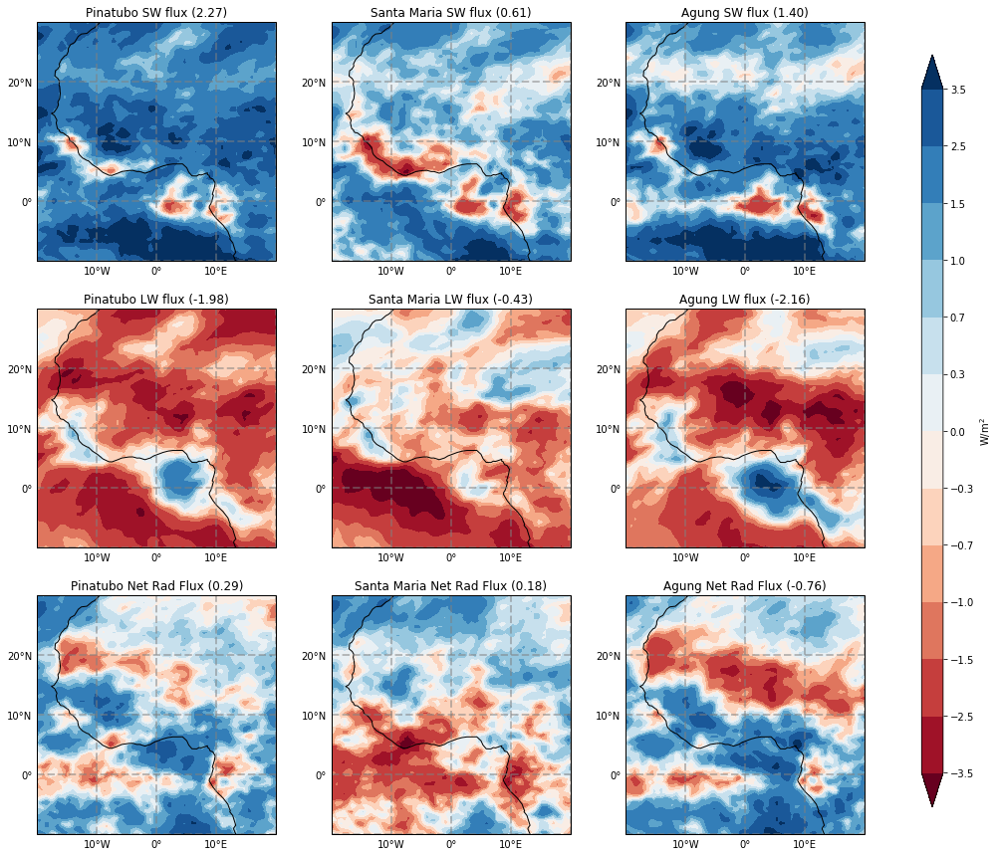

In [28]:
fig = plt.figure(figsize=(15,15))
levels=[-3.5,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,3.5]

ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sw_lin_trop_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo SW flux (%.2f)'%ms_lin_trop_all[0])

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_sw_lin_trop_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux (%.2f)'%ms_lin_trop_all[1])

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_sw_lin_trop_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung SW flux (%.2f)'%ms_lin_trop_all[2])

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_netlw_lin_trop_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo LW flux (%.2f)'%ms_lin_trop_all[3])

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_netlw_lin_trop_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria LW flux (%.2f)'%ms_lin_trop_all[4])

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_netlw_lin_trop_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung LW flux (%.2f)'%ms_lin_trop_all[5])

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_netrad_lin_trop_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Net Rad Flux (%.2f)'%ms_lin_trop_all[6])

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_netrad_lin_trop_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Net Rad Flux (%.2f)'%ms_lin_trop_all[7])

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_netrad_lin_trop_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Net Rad Flux (%.2f)'%ms_lin_trop_all[8])

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical',label='W/m$^2$')

#plt.suptitle('MS lin_trop all sky fluxes [W/m$^2$]',fontsize=20)
#positive up
plt.savefig('lin_trop_ms_3x3.png', bbox_inches='tight')

## TOA All sky

In [130]:
# W/m^2, TOA netrad (lw + sw), all sky
pinatubo_toa = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.netrad_toa.nc/') 
stmaria_toa = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.netrad_toa.nc/') 
agung_toa = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.netrad_toa.nc/')
ctl_toa = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.netrad_toa.nc/') 


In [131]:
# subtract ctl
ctl_toa['time']=pinatubo_toa['time']
pinatubo_toa_max = pinatubo_toa
pinatubo_toa = pinatubo_toa - ctl_toa

ctl_toa['time']=stmaria_toa['time']
stmaria_toa_max=stmaria_toa
stmaria_toa = stmaria_toa - ctl_toa

ctl_toa['time']=agung_toa['time']
agung_toa_max=agung_toa
agung_toa = agung_toa - ctl_toa

In [541]:
pinatubo_toa[:,12:].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['time','en','lon','lat'])

<xarray.DataArray 'netrad_toa' ()>
array(-0.7022037, dtype=float32)

In [132]:
# W/m^2, TOA SW, all sky
pinatubo_swup_toa = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swup_toa.nc/') 
pinatubo_swdn_toa = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_toa.nc/') 
stmaria_swup_toa = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swup_toa.nc/')
stmaria_swdn_toa = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_toa.nc/') 
agung_swup_toa = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swup_toa.nc/')
agung_swdn_toa = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_toa.nc/')
ctl_swup_toa = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swup_toa.nc/') 
ctl_swdn_toa = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_toa.nc/') 

# subtract ctl
ctl_swup_toa['time']=pinatubo_swup_toa['time']
pinatubo_swup_toa = pinatubo_swup_toa - ctl_swup_toa

ctl_swup_toa['time']=stmaria_swup_toa['time']
stmaria_swup_toa = stmaria_swup_toa - ctl_swup_toa

ctl_swup_toa['time']=agung_swup_toa['time']
agung_swup_toa = agung_swup_toa - ctl_swup_toa


ctl_swdn_toa['time']=pinatubo_swdn_toa['time']
pinatubo_swdn_toa = pinatubo_swdn_toa - ctl_swdn_toa

ctl_swdn_toa['time']=stmaria_swdn_toa['time']
stmaria_swdn_toa = stmaria_swdn_toa - ctl_swdn_toa

ctl_swdn_toa['time']=agung_swdn_toa['time']
agung_swdn_toa = agung_swdn_toa - ctl_swdn_toa

#net SW TOA 
pinatubo_sw_toa = pinatubo_swup_toa - pinatubo_swdn_toa

stmaria_sw_toa = stmaria_swup_toa - stmaria_swdn_toa

agung_sw_toa = agung_swup_toa - agung_swdn_toa


In [135]:
# W/m^2, TOA LW (OLR), all sky
pinatubo_olr = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.olr.nc/') 
stmaria_olr = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.olr.nc/') 
agung_olr = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.olr.nc/')
ctl_olr = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.olr.nc/') 

# subtract ctl
ctl_olr['time']=pinatubo_olr['time']
pinatubo_olr = pinatubo_olr - ctl_olr

ctl_olr['time']=stmaria_olr['time']
stmaria_olr = stmaria_olr - ctl_olr

ctl_olr['time']=agung_olr['time']
agung_olr = agung_olr - ctl_olr

Text(0.5, 0.98, 'TOA all sky net radiation [W/m$^2$], Sahel region')

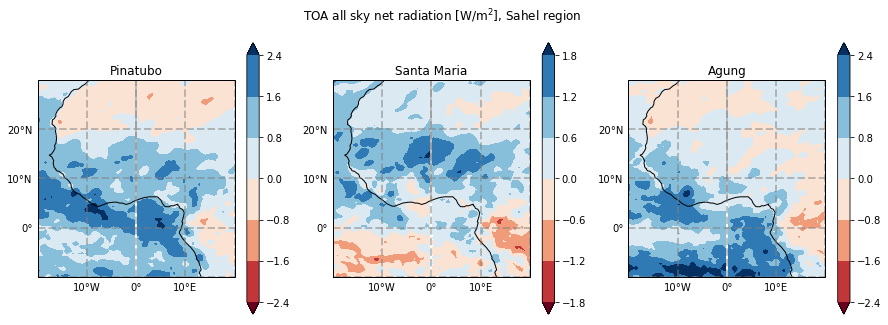

In [44]:
#negative so it's positive up
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1 * pinatubo_toa.mean(['en','time'])).plot.contourf(robust=True, center=0, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1 * stmaria_toa.mean(['en','time'])).plot.contourf(robust=True, center=0, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1* agung_toa.mean(['en','time'])).plot.contourf(robust=True, center=0, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('TOA all sky net radiation [W/m$^2$], Sahel region')
#positive up
#plt.savefig('allsky_toa.png')


In [133]:
pinatubo_toa_s = pinatubo_toa.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat','en','time'])
stmaria_toa_s = stmaria_toa.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat','en','time'])
agung_toa_s = agung_toa.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat','en','time'])


In [311]:
agung_toa_s

<xarray.DataArray 'netrad_toa' ()>
array(-0.37796015, dtype=float32)

In [250]:
pvalue=[0,0,0,0,0,0,0,0,0]

pinatubo_toa_ms = pinatubo_toa[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_toa_ms, 0)
pinatubo_toa_ms=pinatubo_toa_ms.mean('en').load()
pvalue[0] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_toa_ms = stmaria_toa[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_toa_ms, 0)
stmaria_toa_ms=stmaria_toa_ms.mean('en').load()
pvalue[1] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_toa_ms = agung_toa[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_toa_ms, 0)
agung_toa_ms=agung_toa_ms.mean('en').load()
pvalue[2] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

pinatubo_sw_toa_ms = pinatubo_sw_toa[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_sw_toa_ms, 0)
pinatubo_sw_toa_ms=pinatubo_sw_toa_ms.mean('en').load()
pvalue[3] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_sw_toa_ms = stmaria_sw_toa[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_sw_toa_ms, 0)
stmaria_sw_toa_ms=stmaria_sw_toa_ms.mean('en').load()
pvalue[4] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_sw_toa_ms = agung_sw_toa[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_sw_toa_ms, 0)
agung_sw_toa_ms=agung_sw_toa_ms.mean('en').load()
pvalue[5] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

pinatubo_olr_ms = pinatubo_olr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_olr_ms, 0)
pinatubo_olr_ms=pinatubo_olr_ms.mean('en').load()
pvalue[6] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_olr_ms = stmaria_olr[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_olr_ms, 0)
stmaria_olr_ms=stmaria_olr_ms.mean('en').load()
pvalue[7] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_olr_ms = agung_olr[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_olr_ms, 0)
agung_olr_ms=agung_olr_ms.mean('en').load()
pvalue[8] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])


In [313]:
pinatubo_toa_jja = pinatubo_toa.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_toa_jja = stmaria_toa.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_toa_jja = agung_toa.groupby('time.season').mean(['time','en']).sel(season='JJA')
pinatubo_sw_toa_jja = pinatubo_sw_toa.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_sw_toa_jja = stmaria_sw_toa.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_sw_toa_jja = agung_sw_toa.groupby('time.season').mean(['time','en']).sel(season='JJA')
pinatubo_olr_jja = pinatubo_olr.groupby('time.season').mean(['time','en']).sel(season='JJA')
stmaria_olr_jja = stmaria_olr.groupby('time.season').mean(['time','en']).sel(season='JJA')
agung_olr_jja = agung_olr.groupby('time.season').mean(['time','en']).sel(season='JJA')

In [314]:
pinatubo_toa_djf = pinatubo_toa.groupby('time.season').mean(['time','en']).sel(season='DJF')
stmaria_toa_djf = stmaria_toa.groupby('time.season').mean(['time','en']).sel(season='DJF')
agung_toa_djf = agung_toa.groupby('time.season').mean(['time','en']).sel(season='DJF')
pinatubo_sw_toa_djf = pinatubo_sw_toa.groupby('time.season').mean(['time','en']).sel(season='DJF')
stmaria_sw_toa_djf = stmaria_sw_toa.groupby('time.season').mean(['time','en']).sel(season='DJF')
agung_sw_toa_djf = agung_sw_toa.groupby('time.season').mean(['time','en']).sel(season='DJF')
pinatubo_olr_djf = pinatubo_olr.groupby('time.season').mean(['time','en']).sel(season='DJF')
stmaria_olr_djf = stmaria_olr.groupby('time.season').mean(['time','en']).sel(season='DJF')
agung_olr_djf = agung_olr.groupby('time.season').mean(['time','en']).sel(season='DJF')

In [473]:
stmaria_toa_ms.mean(['lon','lat'])

<xarray.DataArray 'netrad_toa' ()>
array(-0.11764169, dtype=float32)

In [137]:
ms_toa_all = [pinatubo_sw_toa_ms, stmaria_sw_toa_ms, agung_sw_toa_ms,pinatubo_olr_ms, stmaria_olr_ms,agung_olr_ms, -1*pinatubo_toa_ms, -1*stmaria_toa_ms, -1*agung_toa_ms]
ms_toa_all = [a.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']) for a in ms_toa_all]
ms_toa_all
        

[<xarray.DataArray ()>
 array(1.826326, dtype=float32), <xarray.DataArray ()>
 array(0.33950627, dtype=float32), <xarray.DataArray ()>
 array(1.6531687, dtype=float32), <xarray.DataArray 'olr' ()>
 array(-1.1665658, dtype=float32), <xarray.DataArray 'olr' ()>
 array(0.5509109, dtype=float32), <xarray.DataArray 'olr' ()>
 array(-1.4597136, dtype=float32), <xarray.DataArray 'netrad_toa' ()>
 array(0.6597603, dtype=float32), <xarray.DataArray 'netrad_toa' ()>
 array(0.89041716, dtype=float32), <xarray.DataArray 'netrad_toa' ()>
 array(0.19345501, dtype=float32)]

Text(0.5,0.98,'MS TOA all sky net radiation [W/m$^2$], Sahel region')

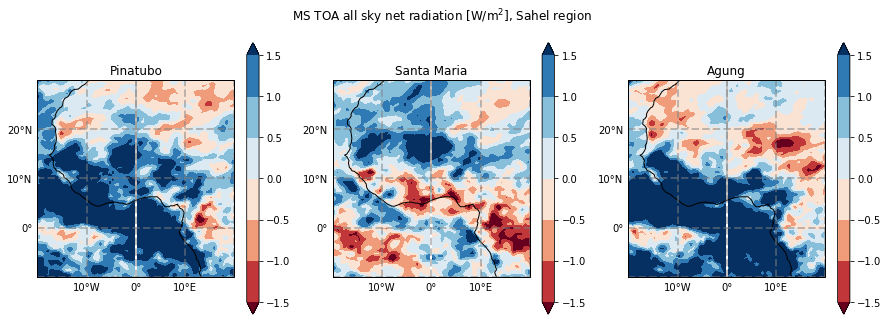

In [24]:
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1*pinatubo_toa_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1*stmaria_toa_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1*agung_toa_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('MS TOA all sky net radiation [W/m$^2$], Sahel region')
#positive up
#plt.savefig('allsky_toa_ms.png')

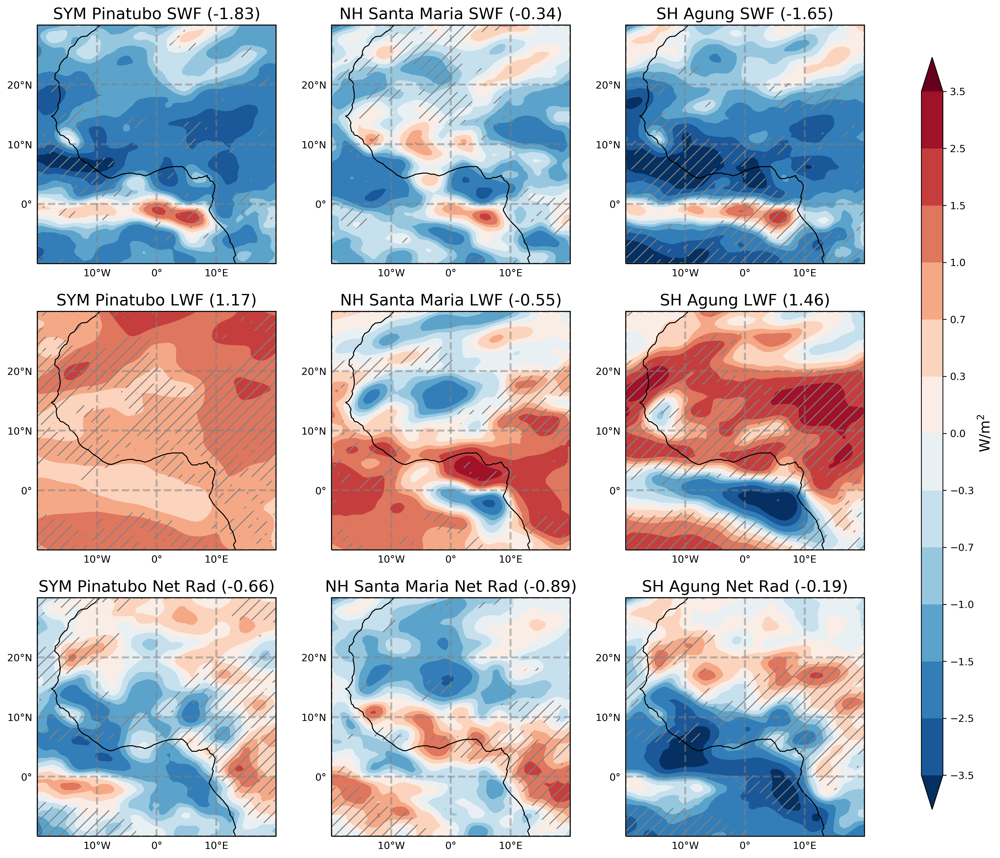

In [251]:
fig = plt.figure(figsize=(15,15))
levels=[-3.5,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,3.5]
plt.rcParams['hatch.color'] = 'grey'
ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*pinatubo_sw_toa_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[0].where(pvalue[0]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo SWF (%.2f)'%-ms_toa_all[0], fontsize=16)

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*stmaria_sw_toa_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[1].where(pvalue[1]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria SWF (%.2f)'%-ms_toa_all[1], fontsize=16)

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*agung_sw_toa_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[2].where(pvalue[2]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung SWF (%.2f)'%-ms_toa_all[2], fontsize=16)

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*pinatubo_olr_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[3].where(pvalue[3]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo LWF (%.2f)'%-ms_toa_all[3], fontsize=16)

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*stmaria_olr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[4].where(pvalue[4]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria LWF (%.2f)'%-ms_toa_all[4], fontsize=16)

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*agung_olr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[5].where(pvalue[5]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung LWF (%.2f)'%-ms_toa_all[5], fontsize=16)

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_toa_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[6].where(pvalue[6]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo Net Rad (%.2f)'%-ms_toa_all[6],fontsize=16)

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_toa_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[7].where(pvalue[7]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria Net Rad (%.2f)'%-ms_toa_all[7],fontsize=16)

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_toa_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[8].where(pvalue[8]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung Net Rad (%.2f)'%-ms_toa_all[8],fontsize=16)

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical').set_label(label='W/m$^2$',size=14)
#plt.tight_layout(rect=(0,0,.9,1))
'''
fig = plt.figure(figsize=(15,15))
levels=[-3.5,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,3.5]

ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sw_toa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo SW flux (%.2f)'%ms_toa_all[0])

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_sw_toa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux (%.2f)'%ms_toa_all[1])

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_sw_toa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung SW flux (%.2f)'%ms_toa_all[2])

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_olr_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo LW flux (%.2f)'%ms_toa_all[3])

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_olr_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria LW flux (%.2f)'%ms_toa_all[4])

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_olr_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung LW flux (%.2f)'%ms_toa_all[5])

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*pinatubo_toa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Net Rad Flux (%.2f)'%ms_toa_all[6])

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*stmaria_toa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Net Rad Flux (%.2f)'%ms_toa_all[7])

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(-1*agung_toa_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Net Rad Flux (%.2f)'%ms_toa_all[8])

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical',label='W/m$^2$')'''

#plt.suptitle('MS TOA all sky fluxes [W/m$^2$]',fontsize=20)
#positive down
plt.savefig('toa_ms_3x3_smooth.png', bbox_inches='tight')

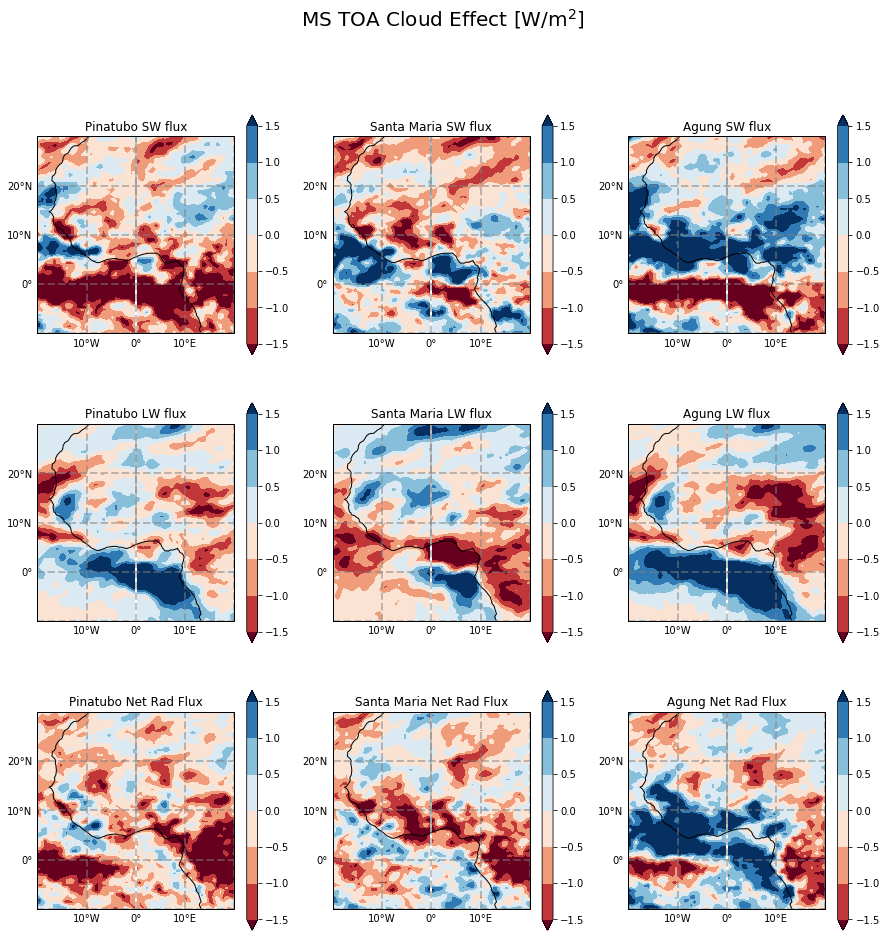

In [37]:
#cloud effect
plt.figure(figsize=(15,15))

ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_sw_toa_ms-pinatubo_sw_toa_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo SW flux')



ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_sw_toa_ms - stmaria_sw_toa_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux')

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_sw_toa_ms - agung_sw_toa_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung SW flux')

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_olr_ms - pinatubo_olr_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo LW flux')

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_olr_ms - stmaria_olr_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria LW flux')

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_olr_ms - agung_olr_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung LW flux')

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1*(pinatubo_toa_ms - pinatubo_clr_ms)).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Net Rad Flux')

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1*(stmaria_toa_ms-stmaria_clr_ms)).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Net Rad Flux')

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(-1*(agung_toa_ms-agung_clr_ms)).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Net Rad Flux')

plt.suptitle('MS TOA Cloud Effect [W/m$^2$]',fontsize=20)
#positive up
plt.savefig('toa_ms_cloud.png')

In [36]:
#mean Sahel anomalies
pinatubo_toa_jja.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])



<xarray.DataArray 'netrad_toa' ()>
array(-1.501693, dtype=float32)
Coordinates:
    season   <U3 'JJA'

In [40]:
#mean Sahel anomalies
stmaria_toa_jja.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])



<xarray.DataArray 'netrad_toa' ()>
array(-1.10309, dtype=float32)
Coordinates:
    season   <U3 'JJA'

In [39]:
#mean Sahel anomalies
agung_toa_jja.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])



<xarray.DataArray 'netrad_toa' ()>
array(-0.883426, dtype=float32)
Coordinates:
    season   <U3 'JJA'

## Surface allsky 

### for paper - separate turbulent fluxes


#### SW + LW

In [142]:
# W/m^2, sfc SW, all sky
pinatubo_swup_sfc = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swup_sfc.nc/') 
pinatubo_swdn_sfc = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_sfc.nc/') 
stmaria_swup_sfc = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swup_sfc.nc/')
stmaria_swdn_sfc = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_sfc.nc/') 
agung_swup_sfc = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swup_sfc.nc/')
agung_swdn_sfc = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_sfc.nc/')
ctl_swup_sfc = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swup_sfc.nc/') 
ctl_swdn_sfc = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_sfc.nc/') 

# subtract ctl
ctl_swup_sfc['time']=pinatubo_swup_sfc['time']
pinatubo_swup_sfc = pinatubo_swup_sfc - ctl_swup_sfc

ctl_swup_sfc['time']=stmaria_swup_sfc['time']
stmaria_swup_sfc = stmaria_swup_sfc - ctl_swup_sfc

ctl_swup_sfc['time']=agung_swup_sfc['time']
agung_swup_sfc = agung_swup_sfc - ctl_swup_sfc


ctl_swdn_sfc['time']=pinatubo_swdn_sfc['time']
pinatubo_swdn_sfc = pinatubo_swdn_sfc - ctl_swdn_sfc

ctl_swdn_sfc['time']=stmaria_swdn_sfc['time']
stmaria_swdn_sfc = stmaria_swdn_sfc - ctl_swdn_sfc

ctl_swdn_sfc['time']=agung_swdn_sfc['time']
agung_swdn_sfc = agung_swdn_sfc - ctl_swdn_sfc

#net SW sfc all
pinatubo_sw_sfc = pinatubo_swup_sfc - pinatubo_swdn_sfc

stmaria_sw_sfc = stmaria_swup_sfc - stmaria_swdn_sfc

agung_sw_sfc = agung_swup_sfc - agung_swdn_sfc


# W/m^2, sfc lw, all sky
pinatubo_lwup_sfc = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.lwup_sfc.nc/') 
pinatubo_lwdn_sfc = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.lwdn_sfc.nc/') 
stmaria_lwup_sfc = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.lwup_sfc.nc/')
stmaria_lwdn_sfc = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.lwdn_sfc.nc/') 
agung_lwup_sfc = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.lwup_sfc.nc/')
agung_lwdn_sfc = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.lwdn_sfc.nc/')
ctl_lwup_sfc = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.lwup_sfc.nc/') 
ctl_lwdn_sfc = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.lwdn_sfc.nc/') 

# subtract ctl
ctl_lwup_sfc['time']=pinatubo_lwup_sfc['time']
pinatubo_lwup_sfc = pinatubo_lwup_sfc - ctl_lwup_sfc

ctl_lwup_sfc['time']=stmaria_lwup_sfc['time']
stmaria_lwup_sfc = stmaria_lwup_sfc - ctl_lwup_sfc

ctl_lwup_sfc['time']=agung_lwup_sfc['time']
agung_lwup_sfc = agung_lwup_sfc - ctl_lwup_sfc


ctl_lwdn_sfc['time']=pinatubo_lwdn_sfc['time']
pinatubo_lwdn_sfc = pinatubo_lwdn_sfc - ctl_lwdn_sfc

ctl_lwdn_sfc['time']=stmaria_lwdn_sfc['time']
stmaria_lwdn_sfc = stmaria_lwdn_sfc - ctl_lwdn_sfc

ctl_lwdn_sfc['time']=agung_lwdn_sfc['time']
agung_lwdn_sfc = agung_lwdn_sfc - ctl_lwdn_sfc

#net lw sfc all
pinatubo_lw_sfc = pinatubo_lwup_sfc - pinatubo_lwdn_sfc

stmaria_lw_sfc = stmaria_lwup_sfc - stmaria_lwdn_sfc

agung_lw_sfc = agung_lwup_sfc - agung_lwdn_sfc

#netrad sfc all
pinatubo_sfc = pinatubo_sw_sfc + pinatubo_lw_sfc
stmaria_sfc = stmaria_sw_sfc + stmaria_lw_sfc
agung_sfc = agung_sw_sfc + agung_lw_sfc
ctl_sfc = ctl_swup_sfc - ctl_swdn_sfc + ctl_lwup_sfc - ctl_lwdn_sfc

In [252]:
pvalue=[0,0,0,0,0,0,0,0,0]

pinatubo_sfc_ms = pinatubo_sfc[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_sfc_ms, 0)
pinatubo_sfc_ms=pinatubo_sfc_ms.mean('en').load()
pvalue[0] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_sfc_ms = stmaria_sfc[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_sfc_ms, 0)
stmaria_sfc_ms=stmaria_sfc_ms.mean('en').load()
pvalue[1] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_sfc_ms = agung_sfc[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_sfc_ms, 0)
agung_sfc_ms=agung_sfc_ms.mean('en').load()
pvalue[2] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

pinatubo_sw_sfc_ms = pinatubo_sw_sfc[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_sw_sfc_ms, 0)
pinatubo_sw_sfc_ms=pinatubo_sw_sfc_ms.mean('en').load()
pvalue[3] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_sw_sfc_ms = stmaria_sw_sfc[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_sw_sfc_ms, 0)
stmaria_sw_sfc_ms=stmaria_sw_sfc_ms.mean('en').load()
pvalue[4] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_sw_sfc_ms = agung_sw_sfc[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_sw_sfc_ms, 0)
agung_sw_sfc_ms=agung_sw_sfc_ms.mean('en').load()
pvalue[5] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

pinatubo_lw_sfc_ms = pinatubo_lw_sfc[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_lw_sfc_ms, 0)
pinatubo_lw_sfc_ms=pinatubo_lw_sfc_ms.mean('en').load()
pvalue[6] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_lw_sfc_ms = stmaria_lw_sfc[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_lw_sfc_ms, 0)
stmaria_lw_sfc_ms=stmaria_lw_sfc_ms.mean('en').load()
pvalue[7] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_lw_sfc_ms = agung_lw_sfc[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_lw_sfc_ms, 0)
agung_lw_sfc_ms=agung_lw_sfc_ms.mean('en').load()
pvalue[8] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

'''
pinatubo_sfc_ms = pinatubo_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_sfc_ms = stmaria_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_sfc_ms = agung_sfc[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_sw_sfc_ms = pinatubo_sw_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

stmaria_sw_sfc_ms = stmaria_sw_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

agung_sw_sfc_ms = agung_sw_sfc[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

pinatubo_lw_sfc_ms = pinatubo_lw_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

stmaria_lw_sfc_ms = stmaria_lw_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

agung_lw_sfc_ms = agung_lw_sfc[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')'''

"\npinatubo_sfc_ms = pinatubo_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\nstmaria_sfc_ms = stmaria_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\nagung_sfc_ms = agung_sfc[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\npinatubo_sw_sfc_ms = pinatubo_sw_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\nstmaria_sw_sfc_ms = stmaria_sw_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\nagung_sw_sfc_ms = agung_sw_sfc[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\npinatubo_lw_sfc_ms = pinatubo_lw_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\nstmaria_lw_sfc_ms = stmaria_lw_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')\n\nagung_lw_sfc_ms = agung_lw_sf

In [144]:
ms_sfc_all = [pinatubo_sw_sfc_ms, stmaria_sw_sfc_ms, agung_sw_sfc_ms,pinatubo_lw_sfc_ms, stmaria_lw_sfc_ms,agung_lw_sfc_ms, pinatubo_sfc_ms, stmaria_sfc_ms, agung_sfc_ms]
ms_sfc_all = [a.isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']) for a in ms_sfc_all]
ms_sfc_all
        

[<xarray.DataArray ()>
 array(0.7745249, dtype=float32), <xarray.DataArray ()>
 array(-0.540858, dtype=float32), <xarray.DataArray ()>
 array(1.1388023, dtype=float32), <xarray.DataArray ()>
 array(1.0998944, dtype=float32), <xarray.DataArray ()>
 array(2.3052962, dtype=float32), <xarray.DataArray ()>
 array(-0.43586066, dtype=float32), <xarray.DataArray ()>
 array(1.8744192, dtype=float32), <xarray.DataArray ()>
 array(1.7644382, dtype=float32), <xarray.DataArray ()>
 array(0.70294154, dtype=float32)]

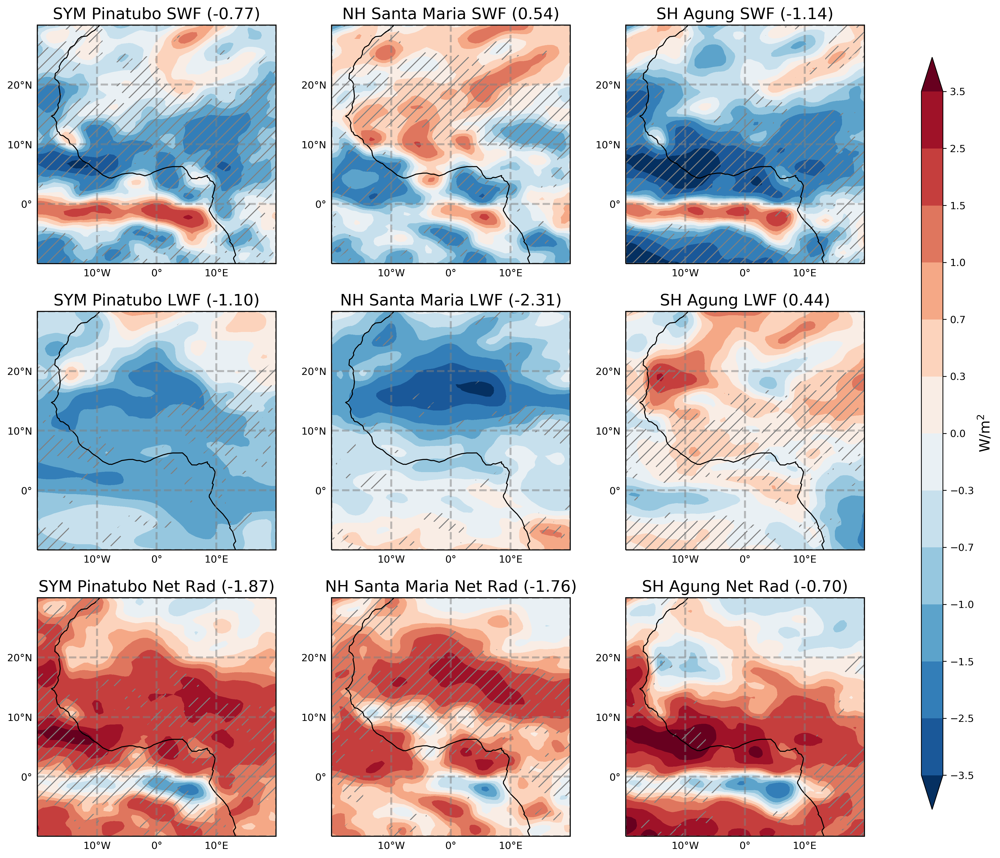

In [253]:
fig = plt.figure(figsize=(15,15))
levels=[-3.5,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,3.5]
plt.rcParams['hatch.color'] = 'grey'
ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*pinatubo_sw_sfc_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[0].where(pvalue[0]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo SWF (%.2f)'%-ms_sfc_all[0], fontsize=16)

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*stmaria_sw_sfc_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[1].where(pvalue[1]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria SWF (%.2f)'%-ms_sfc_all[1], fontsize=16)

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*agung_sw_sfc_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[2].where(pvalue[2]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung SWF (%.2f)'%-ms_sfc_all[2], fontsize=16)

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*pinatubo_lw_sfc_clr_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[3].where(pvalue[3]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo LWF (%.2f)'%-ms_sfc_all[3], fontsize=16)

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*stmaria_lw_sfc_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[4].where(pvalue[4]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria LWF (%.2f)'%-ms_sfc_all[4], fontsize=16)

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*agung_lw_sfc_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[5].where(pvalue[5]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung LWF (%.2f)'%-ms_sfc_all[5], fontsize=16)

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sfc_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[6].where(pvalue[6]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo Net Rad (%.2f)'%-ms_sfc_all[6],fontsize=16)

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_sfc_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[7].where(pvalue[7]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria Net Rad (%.2f)'%-ms_sfc_all[7],fontsize=16)

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_sfc_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[8].where(pvalue[8]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung Net Rad (%.2f)'%-ms_sfc_all[8],fontsize=16)

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical').set_label(label='W/m$^2$',size=14)
#plt.tight_layout(rect=(0,0,.9,1))
'''
ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sw_sfc_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu',add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo SW flux (%.2f)'%ms_sfc_all[0])

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_sw_sfc_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu',add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux (%.2f)'%ms_sfc_all[1])

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_sw_sfc_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu',add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung SW flux (%.2f)'%ms_sfc_all[2])

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_lw_sfc_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu',add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo LW flux (%.2f)'%ms_sfc_all[3])

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_lw_sfc_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu',add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria LW flux (%.2f)'%ms_sfc_all[4])

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_lw_sfc_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu',add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung LW flux (%.2f)'%ms_sfc_all[5])

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sfc_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu',add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Net Rad Flux (%.2f)'%ms_sfc_all[6])

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_sfc_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu',add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Net Rad Flux (%.2f)'%ms_sfc_all[7])

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_sfc_ms).plot.contourf(robust=True, levels=levels, add_labels=False, cmap='RdBu',add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Net Rad Flux (%.2f)'%ms_sfc_all[8])

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical',label='W/m$^2$')'''

#plt.suptitle('MS sfc all sky fluxes [W/m$^2$]',fontsize=20)
#positive down
plt.savefig('sfc_ms_3x3_smooth.png',bbox_inches='tight')

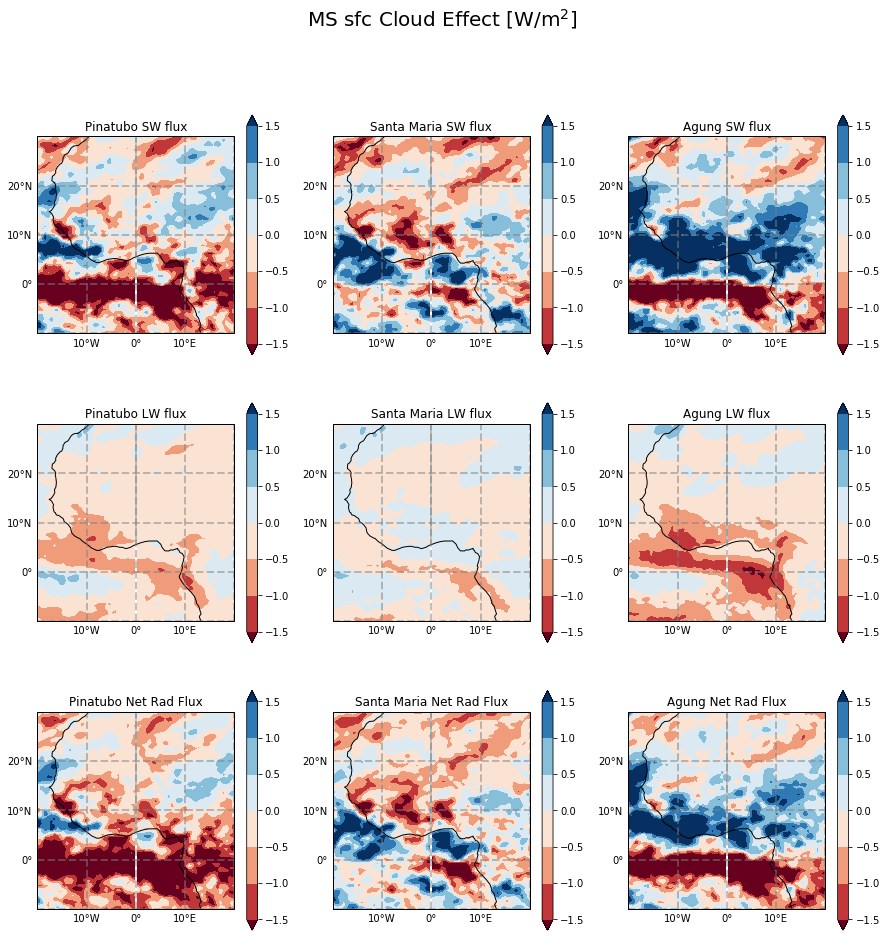

In [43]:
#cloud effect
plt.figure(figsize=(15,15))

ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_sw_sfc_ms-pinatubo_sw_sfc_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo SW flux')


ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_sw_sfc_ms-stmaria_sw_sfc_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria SW flux')

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_sw_sfc_ms- agung_sw_sfc_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung SW flux')

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_lw_sfc_ms - pinatubo_lw_sfc_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo LW flux')

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_lw_sfc_ms - stmaria_lw_sfc_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria LW flux')

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_lw_sfc_ms- agung_lw_sfc_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung LW flux')

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_sfc_ms - pinatubo_sfc_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Net Rad Flux')

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_sfc_ms - stmaria_sfc_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Net Rad Flux')

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_sfc_ms - agung_sfc_clr_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Net Rad Flux')

plt.suptitle('MS sfc Cloud Effect [W/m$^2$]',fontsize=20)
#positive up
plt.savefig('allsky_toa_cloud.png')

#### SHFlx + LHFlx

In [147]:
pinatubo_shflx = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.shflx.nc/') 
stmaria_shflx = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.shflx.nc/') 
agung_shflx = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.shflx.nc/')
ctl_shflx = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.shflx.nc/') 

#get evap data as dataarray (in kg/m2/s)
#1 kg/m2/s = 86400 mm/day
#scale_factor_e = 86400 
L = 2.5e6 #J/kg

#get evap
pinatubo_e = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.evap.nc/') 
stmaria_e = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.evap.nc/') 
agung_e = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.evap.nc/') 
ctl_e = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.evap.nc/') 

#get anomaly
ctl_shflx['time']=pinatubo_shflx['time']
pinatubo_shflx = pinatubo_shflx - ctl_shflx

ctl_shflx['time']=stmaria_shflx['time']
stmaria_shflx = stmaria_shflx - ctl_shflx

ctl_shflx['time']=agung_shflx['time']
agung_shflx = agung_shflx - ctl_shflx

ctl_e['time']=pinatubo_e['time']
pinatubo_e = pinatubo_e - ctl_e

ctl_e['time']=stmaria_e['time']
stmaria_e = stmaria_e - ctl_e

ctl_e['time']=agung_e['time']
agung_e = agung_e - ctl_e

#latent heat flux = L*evap
pinatubo_lhflx = L*pinatubo_e
stmaria_lhflx = L*stmaria_e
agung_lhflx = L*agung_e

#surface energy = surface radiative flux + SHF + LHF
pinatubo_sfc_en = pinatubo_sfc + pinatubo_shflx + pinatubo_lhflx
stmaria_sfc_en = stmaria_sfc + stmaria_shflx + stmaria_lhflx
agung_sfc_en = agung_sfc + agung_shflx + agung_lhflx
ctl_sfc_en = ctl_sfc + ctl_shflx + L*ctl_e

In [254]:
pvalue=[0,0,0,0,0,0]
pinatubo_shflx_ms = pinatubo_shflx[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_shflx_ms, 0)
pinatubo_shflx_ms=pinatubo_shflx_ms.mean('en').load()
pvalue[0] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_shflx_ms = stmaria_shflx[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_shflx_ms, 0)
stmaria_shflx_ms=stmaria_shflx_ms.mean('en').load()
pvalue[1] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_shflx_ms = agung_shflx[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_shflx_ms, 0)
agung_shflx_ms=agung_shflx_ms.mean('en').load()
pvalue[2] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

pinatubo_lhflx_ms = pinatubo_lhflx[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_lhflx_ms, 0)
pinatubo_lhflx_ms=pinatubo_lhflx_ms.mean('en').load()
pvalue[3] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_lhflx_ms = stmaria_lhflx[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_lhflx_ms, 0)
stmaria_lhflx_ms=stmaria_lhflx_ms.mean('en').load()
pvalue[4] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_lhflx_ms = agung_lhflx[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_lhflx_ms, 0)
agung_lhflx_ms=agung_lhflx_ms.mean('en').load()
pvalue[5] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])


pinatubo_sfc_en_ms = pinatubo_sfc_en[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
stmaria_sfc_en_ms = stmaria_sfc_en[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')
agung_sfc_en_ms = agung_sfc_en[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month')

In [151]:
ms_sfc_turb = [pinatubo_shflx_ms, stmaria_shflx_ms, agung_shflx_ms,pinatubo_lhflx_ms, stmaria_lhflx_ms,agung_lhflx_ms, pinatubo_sfc_en_ms, stmaria_sfc_en_ms, agung_sfc_en_ms]
ms_sfc_turb = [a.isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']) for a in ms_sfc_turb]
ms_sfc_turb
        

[<xarray.DataArray 'shflx' ()>
 array(-0.68708664, dtype=float32), <xarray.DataArray 'shflx' ()>
 array(0.29763466, dtype=float32), <xarray.DataArray 'shflx' ()>
 array(-1.2019271, dtype=float32), <xarray.DataArray 'evap' ()>
 array(-1.1556529, dtype=float32), <xarray.DataArray 'evap' ()>
 array(-2.164771, dtype=float32), <xarray.DataArray 'evap' ()>
 array(0.6440534, dtype=float32), <xarray.DataArray ()>
 array(0.03167978, dtype=float32), <xarray.DataArray ()>
 array(-0.10269843, dtype=float32), <xarray.DataArray ()>
 array(0.14506786, dtype=float32)]

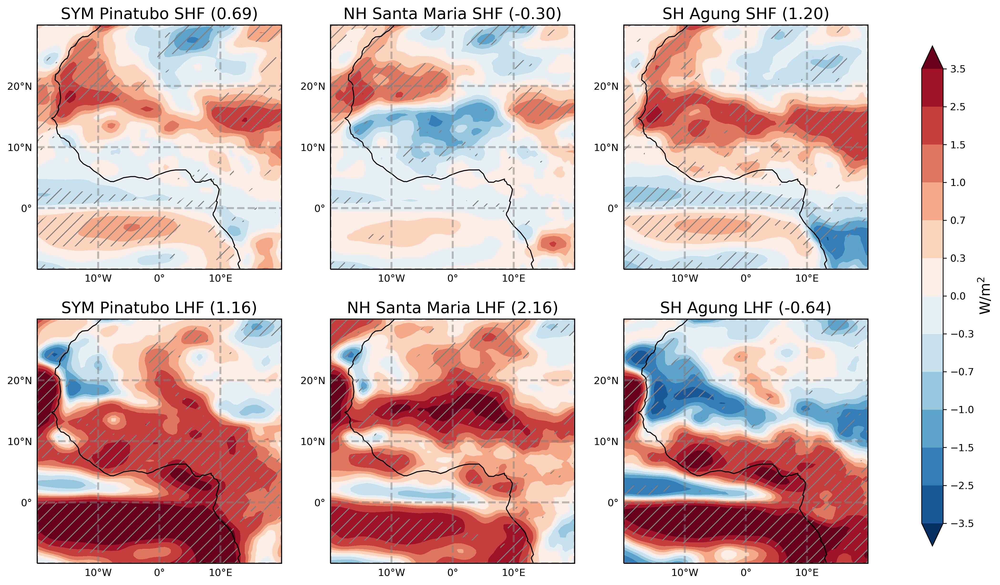

In [255]:
fig = plt.figure(figsize=(15,10))
levels=[-3.5,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,3.5]
plt.rcParams['hatch.color'] = 'grey'

ax1=plt.subplot(2,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*pinatubo_shflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[0].where(pvalue[0]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo SHF (%.2f)'%-ms_sfc_turb[0], fontsize=16)

ax2=plt.subplot(2,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*stmaria_shflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[1].where(pvalue[1]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria SHF (%.2f)'%-ms_sfc_turb[1], fontsize=16)

ax3=plt.subplot(2,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*agung_shflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[2].where(pvalue[2]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung SHF (%.2f)'%-ms_sfc_turb[2], fontsize=16)

ax1=plt.subplot(2,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*pinatubo_lhflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[3].where(pvalue[3]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo LHF (%.2f)'%-ms_sfc_turb[3], fontsize=16)

ax2=plt.subplot(2,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*stmaria_lhflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[4].where(pvalue[4]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria LHF (%.2f)'%-ms_sfc_turb[4], fontsize=16)

ax3=plt.subplot(2,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(-1*agung_lhflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True,  levels=levels,extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[5].where(pvalue[5]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3, colors='None', hatches=['//'], facecolor='g', add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung LHF (%.2f)'%-ms_sfc_turb[5], fontsize=16)

'''
ax1=plt.subplot(2,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_shflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Sensible Heat Flux (%.2f)'%ms_sfc_turb[0])

ax2=plt.subplot(2,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_shflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Sensible Heat Flux (%.2f)'%ms_sfc_turb[1])

ax3=plt.subplot(2,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(agung_shflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Sensible Heat Flux (%.2f)'%ms_sfc_turb[2])

ax1=plt.subplot(2,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_lhflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Latent Heat Flux (%.2f)'%ms_sfc_turb[3])

ax2=plt.subplot(2,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_lhflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Latent Heat Flux (%.2f)'%ms_sfc_turb[4])

ax3=plt.subplot(2,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_lhflx_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Latent Heat Flux (%.2f)'%ms_sfc_turb[5])'''


ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,ticks=levels,cax=ax,orientation='vertical').set_label(label='W/m$^2$',fontsize=14)


#plt.suptitle('MS Turbulent energy fluxes [W/m$^2$]',fontsize=20)
#positive down
#smoothed
plt.savefig('allsky_en_ms_3x3_smooth.png',bbox_inches='tight')

In [179]:
'''fig = plt.figure(figsize=(15,15))

ax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_shflx_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Sensible Heat Flux (%.2f)'%ms_sfc_turb[0])

ax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_shflx_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Sensible Heat Flux (%.2f)'%ms_sfc_turb[1])

ax3=plt.subplot(3,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_shflx_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Sensible Heat Flux (%.2f)'%ms_sfc_turb[2])

ax1=plt.subplot(3,3,4,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_lhflx_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Latent Heat Flux (%.2f)'%ms_sfc_turb[3])

ax2=plt.subplot(3,3,5,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_lhflx_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Latent Heat Flux (%.2f)'%ms_sfc_turb[4])

ax3=plt.subplot(3,3,6,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_lhflx_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Latent Heat Flux (%.2f)'%ms_sfc_turb[5])

ax1=plt.subplot(3,3,7,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_sfc_en_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo Net Energy Flux (%.2f)'%ms_sfc_turb[6])

ax2=plt.subplot(3,3,8,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_sfc_en_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria Net Energy Flux (%.2f)'%ms_sfc_turb[7])

ax3=plt.subplot(3,3,9,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = (agung_sfc_en_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung Net Energy Flux (%.2f)'%ms_sfc_turb[8])

ax = fig.add_axes((.95,0.15,.02,.7))
plt.colorbar(im,cax=ax,orientation='vertical',label='W/m$^2$')


#plt.suptitle('MS Turbulent energy fluxes [W/m$^2$]',fontsize=20)
#positive up
#plt.savefig('allsky_en_ms_3x3.png',bbox_inches='tight')'''

"fig = plt.figure(figsize=(15,15))\n\nax1=plt.subplot(3,3,1,projection=ccrs.PlateCarree())\nax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())\n(pinatubo_shflx_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)\ngl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')\ngl.xlabels_top=False\ngl.ylabels_right=False\ngl.xformatter=LONGITUDE_FORMATTER\ngl.yformatter=LATITUDE_FORMATTER\ngl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])\ngl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])\nax1.add_feature(cfeature.LAND, facecolor='0.75')\nax1.coastlines()\nplt.title('Pinatubo Sensible Heat Flux (%.2f)'%ms_sfc_turb[0])\n\nax2=plt.subplot(3,3,2,projection=ccrs.PlateCarree())\nax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())\n(stmaria_shflx_ms).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, add_labels=False, cmap='RdBu', add_colorbar=False)\ng2=ax2.

# Convergence

## Sfc - TOA convergence

In [1]:
#same as above but MS
#plot NEGATIVE so its Fb - Ft
fig = plt.figure(figsize=(15,6))
levels=[-4,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,4]


ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sfc_en_ms + pinatubo_toa_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo (%.2f)' %(pinatubo_sfc_en_ms + pinatubo_toa_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_toa_ms + stmaria_sfc_en_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria (%.2f)' %(stmaria_sfc_en_ms + stmaria_toa_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_toa_ms + agung_sfc_en_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung (%.2f)' %(agung_sfc_en_ms + agung_toa_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical',label='W/m$^2$')

#plt.suptitle('MS Atmospheric convergence [W/m$^2$]')
#smoothed
#plt.savefig('del_netrad_ms.png',bbox_inches='tight')

NameError: name 'plt' is not defined

NameError: name 'da_max' is not defined

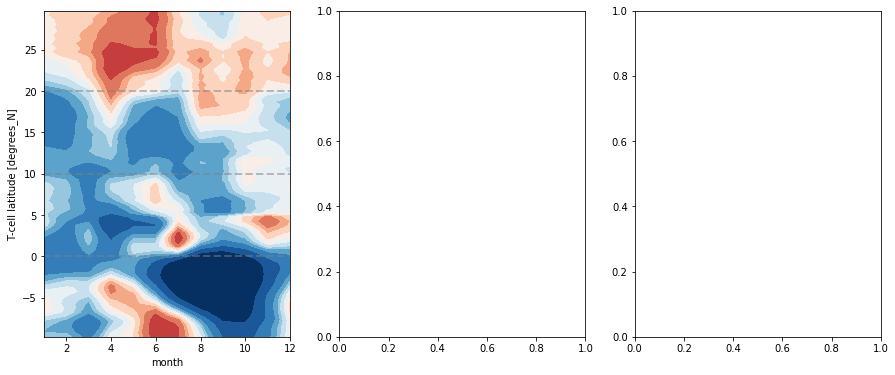

In [322]:
da_pinatubo_conv_za = (pinatubo_sfc_en + pinatubo_toa).groupby('time.month').mean(['time','en'])



da_stmaria_conv_za = (stmaria_sfc_en + stmaria_toa).groupby('time.month').mean(['time','en'])



da_agung_conv_za = (agung_sfc_en + agung_toa).groupby('time.month').mean(['time','en'])
levels=[-4,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,4]


da = [da_pinatubo_conv_za,da_stmaria_conv_za,da_agung_conv_za]
da_za = [0,1,2]
for i in da_za:
    da_za[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(-10,30)).mean(['lon'])
    da1 = da_za[i].sel(month=12)
    da1['month'] = da1['month']-12
    da2 = da_za[i].sel(month=1)
    da2['month'] = da2['month']+12
    da_za[i]=xr.concat([da1,da_za[i],da2],dim='month')
    da_za[i] = da_za[i].rolling(month=3,center=True).mean().dropna('month')
    

fig, axes = plt.subplots(1, 3, figsize=(15,6))
titles = ['Pinatubo','Santa Maria', 'Agung']

# for ii, ax in enumerate(f.axes.flat):
for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1)
    im = da_za[ii].plot.contourf(y='lat',robust=True, cmap='RdBu_r',levels=levels,extend='both', add_colorbar=False)
    ax.axhline(0, lw = 2, color='gray', alpha=.5, linestyle='--')
    ax.axhline(10, lw = 2, color='gray', alpha=.5, linestyle='--')
    ax.axhline(20, lw = 2, color='gray', alpha=.5, linestyle='--')
    da_max[0].plot(c='k',lw=0.7)
    da_max[ii+1].plot(c='r', lw=0.7)
    if ii==0:
        ax.set_ylabel('Latitude')
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Month')
    ax.set_title(titles[ii])
    
ax = fig.add_axes((.95,.1,.02,.6))
plt.colorbar(im,ticks=levels,cax=ax,orientation='vertical',label='W/m$^2$',extend='both')
plt.tight_layout(rect=(0,0,.9,.8))

#plt.suptitle('Convergence anomaly monthly zonal averages (20W-10E)[W/m$^2$]')
#plt.savefig('conv_za_smooth.png', bbox_inches = 'tight')


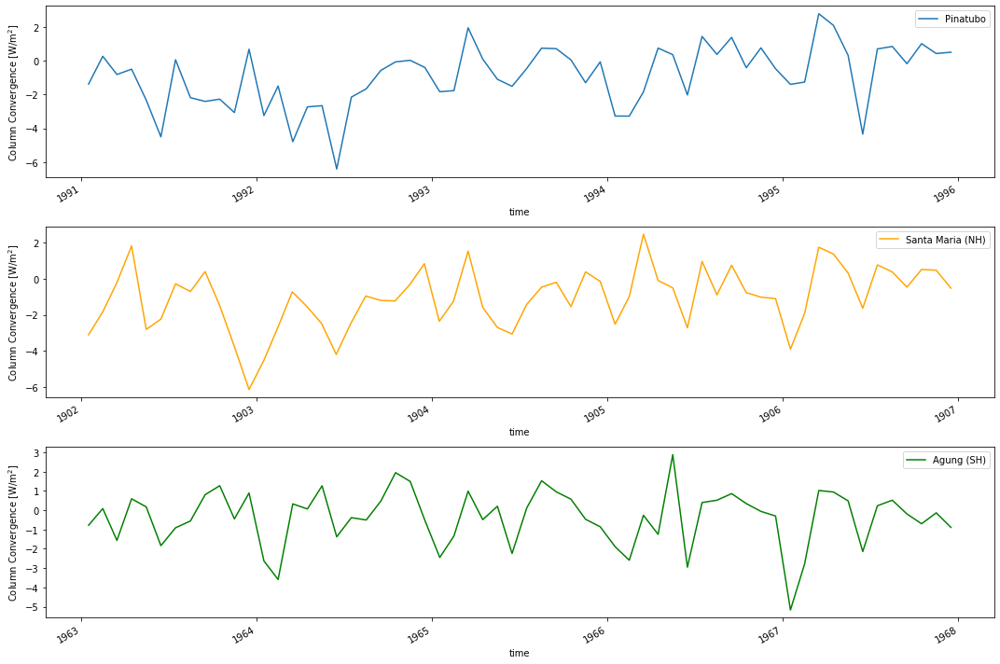

In [189]:
#make monthly climatologies & time series for each volcano
plt.figure(figsize=(15,10))

ax1=plt.subplot(3,1,1)
pinatubo_conv_s = (pinatubo_sfc_en + pinatubo_toa).mean('en').isel(lon=(pinatubo.lon<=10)|(pinatubo.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
pinatubo_conv_s.plot(label='Pinatubo')
plt.legend()
plt.ylabel('Column Convergence [W/m$^2$]')


ax2=plt.subplot(3,1,2)
stmaria_conv_s = (stmaria_sfc_en + stmaria_toa).mean('en').isel(lon=(stmaria.lon<=10)|(stmaria.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
stmaria_conv_s.plot(label='Santa Maria (NH)',color='orange')
plt.legend()
plt.ylabel('Column Convergence [W/m$^2$]')

ax3=plt.subplot(3,1,3)
agung_conv_s = (agung_sfc_en + agung_toa).mean('en').isel(lon=(agung.lon<=10)|(agung.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
agung_conv_s.plot(label='Agung (SH)',color='green')
plt.legend()
plt.ylabel('Column Convergence [W/m$^2$]')

plt.tight_layout()


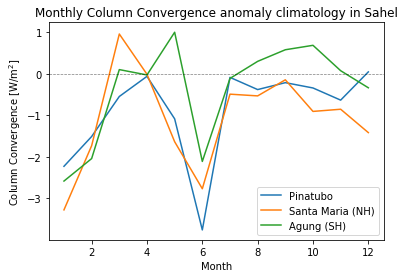

In [195]:
p_clim = pinatubo_conv_s.groupby('time.month').mean('time')
s_clim = stmaria_conv_s.groupby('time.month').mean('time')
a_clim = agung_conv_s.groupby('time.month').mean('time')

plt.plot(p_clim.month, p_clim, label='Pinatubo')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)')
plt.plot(a_clim.month, a_clim, label='Agung (SH)')
plt.legend()
plt.axhline(0, c='k', linestyle='--', alpha=0.5, lw = 0.7)
plt.xlabel('Month')
plt.ylabel('Column Convergence [W/m$^2$]')
plt.title('Monthly Column Convergence anomaly climatology in Sahel')
plt.savefig('conv_clim.png')

## 200 hPa convergence

In [256]:
pvalue = [0,0,0]

pinatubo_conv = pinatubo_sfc_en - pinatubo_netrad_200hPa
pinatubo_conv_ms = pinatubo_conv[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_conv_ms, 0)
pinatubo_conv_ms=pinatubo_conv_ms.mean('en').load()
pvalue[0] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

stmaria_conv = stmaria_sfc_en - stmaria_netrad_200hPa
stmaria_conv_ms = stmaria_conv[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_conv_ms, 0)
stmaria_conv_ms=stmaria_conv_ms.mean('en').load()
pvalue[1] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_conv = agung_sfc_en - agung_netrad_200hPa
agung_conv_ms = agung_conv[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_conv_ms, 0)
agung_conv_ms=agung_conv_ms.mean('en').load()
pvalue[2] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])


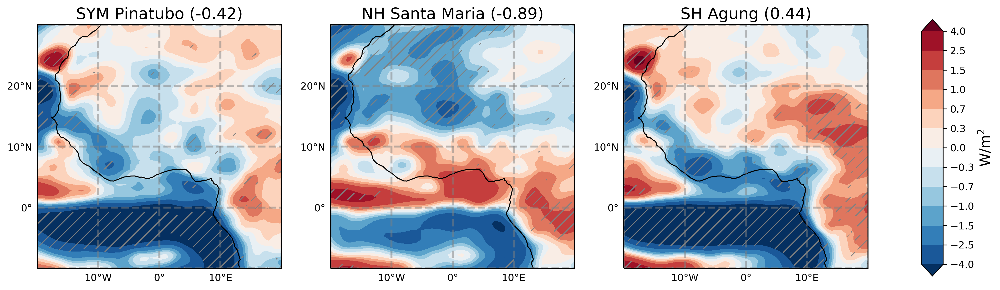

In [257]:
#plot NEGATIVE so its Fb - Ft
fig = plt.figure(figsize=(15,6))
levels=[-4,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,4]
plt.rcParams['hatch.color'] = 'grey'

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_conv_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
shift_longitude(pvalue[0].where(pvalue[0]<0.05).pipe(lambda x:x*0)).plot.contourf(colors='None', hatches=['//'], add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo (%.2f)' %(pinatubo_sfc_en_ms - pinatubo_netrad_200hPa_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']),fontsize=16)

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_conv_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
shift_longitude(pvalue[1].where(pvalue[1]<0.05).pipe(lambda x:x*0)).plot.contourf(colors='None', hatches=['//'], add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria (%.2f)' %(stmaria_sfc_en_ms - stmaria_netrad_200hPa_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']),fontsize=16)

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_conv_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
shift_longitude(pvalue[2].where(pvalue[2]<0.05).pipe(lambda x:x*0)).plot.contourf(colors='None', hatches=['//'], add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung (%.2f)' %(agung_sfc_en_ms - agung_netrad_200hPa_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']),fontsize=16)

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical').set_label(label='W/m$^2$',size=14)

#plt.suptitle('MS Atmospheric convergence, surface to 200hPa [W/m$^2$]')
#smoothed
plt.savefig('del_netrad_ms_smooth.png',bbox_inches='tight')

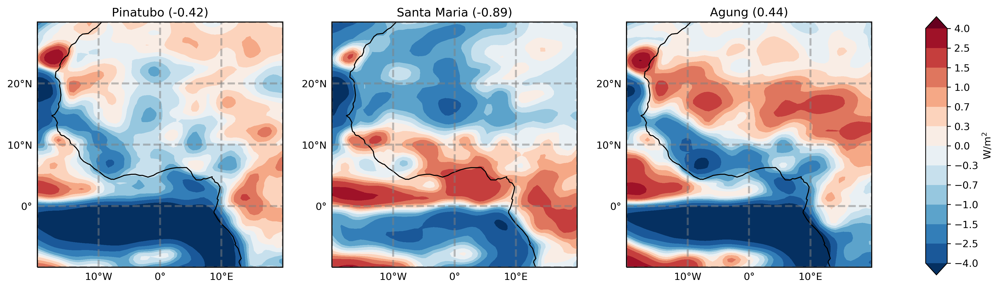

In [51]:
#plot NEGATIVE so its Fb - Ft
fig = plt.figure(figsize=(15,6))
levels=[-4,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,4]


ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sfc_en_ms - pinatubo_netrad_200hPa_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo (%.2f)' %(pinatubo_sfc_en_ms - pinatubo_netrad_200hPa_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(- stmaria_netrad_200hPa_ms + stmaria_sfc_en_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria (%.2f)' %(stmaria_sfc_en_ms - stmaria_netrad_200hPa_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(- agung_netrad_200hPa_ms + agung_sfc_en_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung (%.2f)' %(agung_sfc_en_ms - agung_netrad_200hPa_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical',label='W/m$^2$')

#plt.suptitle('MS Atmospheric convergence, surface to 200hPa [W/m$^2$]')
#smoothed
#plt.savefig('del_netrad_ms.png',bbox_inches='tight')

/home/tessj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:50: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


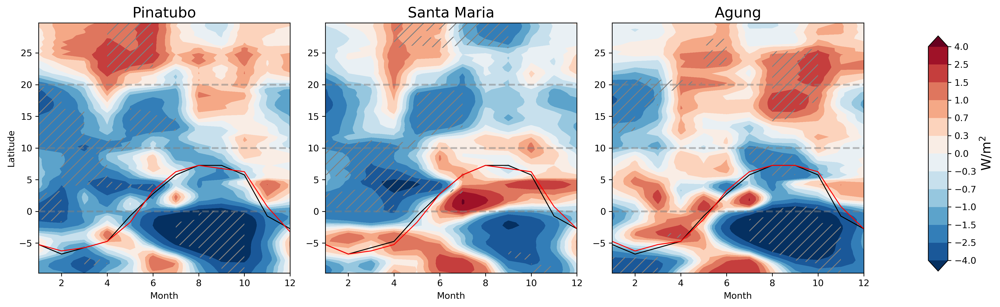

In [258]:
da_pinatubo_conv_za = (pinatubo_sfc_en - pinatubo_netrad_200hPa)[:,12:].groupby('time.month').mean(['time'])



da_stmaria_conv_za = (stmaria_sfc_en - stmaria_netrad_200hPa)[:,12:].groupby('time.month').mean(['time'])



da_agung_conv_za = (agung_sfc_en - agung_netrad_200hPa)[:,:48].groupby('time.month').mean(['time'])
levels=[-4,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,4]


da = [da_pinatubo_conv_za,da_stmaria_conv_za,da_agung_conv_za]
da_za = [0,1,2]
pvalue=[0,0,0]
for i in da_za:
    da_za[i] = da[i].isel(lon=(pinatubo_sfc_en.lon<=10)|(pinatubo_sfc_en.lon>=340)).sel(lat=slice(-10,30)).mean(['lon'])
    da1 = da_za[i].sel(month=12)
    da1['month'] = da1['month']-12
    da2 = da_za[i].sel(month=1)
    da2['month'] = da2['month']+12
    da_za[i]=xr.concat([da1,da_za[i],da2],dim='month')
    da_za[i] = da_za[i].rolling(month=3,center=True).mean().dropna('month')
    tt, pp = ttest_1samp(da_za[i], 0)
    da_za[i] = da_za[i].mean('en').load()
    pvalue[i] = xr.DataArray(pp, dims=da_za[i].dims, coords=[da_za[i][dim] for dim in da_za[i].dims])

fig, axes = plt.subplots(1, 3, figsize=(15,6))
titles = ['Pinatubo','Santa Maria', 'Agung']

# for ii, ax in enumerate(f.axes.flat):
for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(1,3,ii+1)
    im = da_za[ii].plot.contourf(y='lat',robust=True, cmap='RdBu_r',levels=levels,extend='both', add_colorbar=False)
    pvalue[ii].where(pvalue[ii]<0.05).pipe(lambda x:x*0).plot.contourf(y='lat',colors='None', hatches=['//'], add_colorbar=False, add_labels=False)
    ax.axhline(0, lw = 2, color='gray', alpha=.5, linestyle='--')
    ax.axhline(10, lw = 2, color='gray', alpha=.5, linestyle='--')
    ax.axhline(20, lw = 2, color='gray', alpha=.5, linestyle='--')
    da_max[0].plot(c='k',lw=1)
    da_max[ii+1].plot(c='r', lw=1)
    if ii==0:
        ax.set_ylabel('Latitude')
    else:
        ax.set_ylabel('')
    ax.set_xlabel('Month')
    ax.set_title(titles[ii],fontsize=16)
    
ax = fig.add_axes((.95,.1,.02,.6))
plt.colorbar(im,ticks=levels,cax=ax,orientation='vertical',extend='both').set_label(label='W/m$^2$',fontsize=14)
plt.tight_layout(rect=(0,0,.9,.8))

#plt.suptitle('Convergence anomaly monthly zonal averages (20W-10E)[W/m$^2$]')
plt.savefig('conv_za_smooth_200hPa.png', bbox_inches = 'tight')


In [168]:
#make monthly climatologies & time series for each volcano

pinatubo_conv_200hPa_s = (pinatubo_sfc_en - pinatubo_netrad_200hPa)[:,12:].mean('en').isel(lon=(pinatubo_sfc_en.lon<=10)|(pinatubo_sfc_en.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
stmaria_conv_200hPa_s = (stmaria_sfc_en - stmaria_netrad_200hPa)[:,12:].mean('en').isel(lon=(stmaria_sfc_en.lon<=10)|(stmaria_sfc_en.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
agung_conv_200hPa_s = (agung_sfc_en - agung_netrad_200hPa)[:,:48].mean('en').isel(lon=(agung_sfc_en.lon<=10)|(agung_sfc_en.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])


Text(0.5, 1.0, 'Monthly Column Convergence anomaly climatology in Sahel')

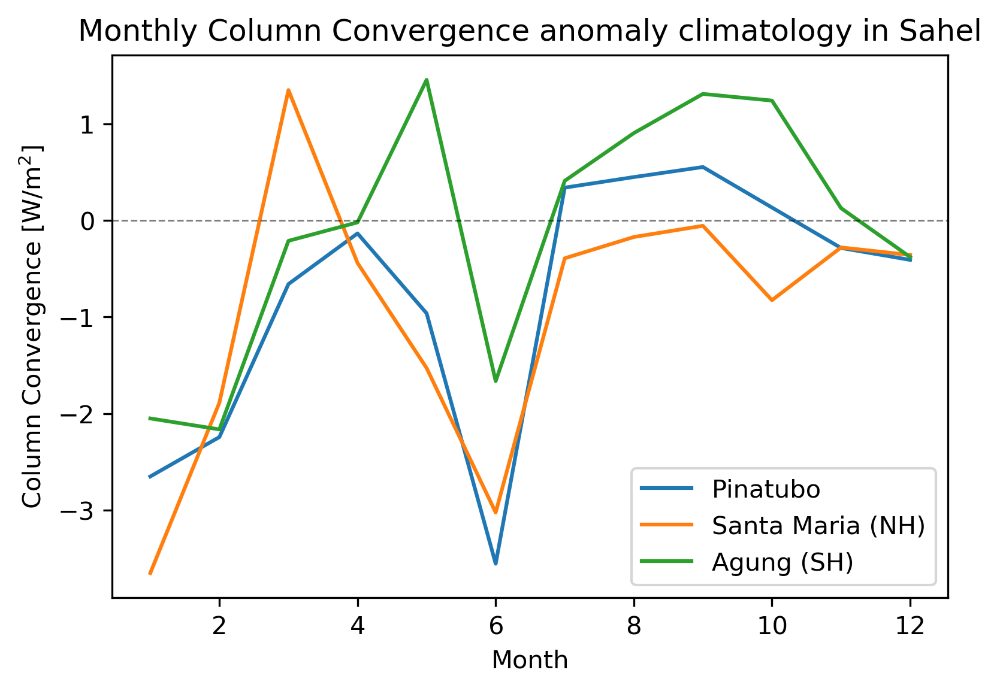

In [169]:
p_clim = pinatubo_conv_200hPa_s.groupby('time.month').mean('time')
s_clim = stmaria_conv_200hPa_s.groupby('time.month').mean('time')
a_clim = agung_conv_200hPa_s.groupby('time.month').mean('time')

plt.plot(p_clim.month, p_clim, label='Pinatubo')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)')
plt.plot(a_clim.month, a_clim, label='Agung (SH)')
plt.legend()
plt.axhline(0, c='k', linestyle='--', alpha=0.5, lw = 0.7)
plt.xlabel('Month')
plt.ylabel('Column Convergence [W/m$^2$]')
plt.title('Monthly Column Convergence anomaly climatology in Sahel')
#plt.savefig('conv_clim.png')

<xarray.DataArray (en: 30, time: 60, lat: 360, lon: 576)>
array([[[[ -44.84662 ,  -44.84662 ,  -44.84662 , ...,  -44.84662 ,
           -44.84662 ,  -44.84662 ],
         [ -45.11797 ,  -45.116283,  -45.114662, ...,  -45.12291 ,
           -45.121254,  -45.11964 ],
         [ -45.443546,  -45.44136 ,  -45.439213, ...,  -45.44996 ,
           -45.447815,  -45.44567 ],
         ...,
         [-103.11932 , -103.1114  , -103.10346 , ..., -103.143005,
          -103.13514 , -103.12725 ],
         [-102.58266 , -102.59811 , -102.61363 , ..., -102.53679 ,
          -102.55201 , -102.567276],
         [-105.10016 , -105.10016 , -105.10016 , ..., -105.10016 ,
          -105.10016 , -105.10016 ]],

        [[ -67.12262 ,  -67.12262 ,  -67.12262 , ...,  -67.12262 ,
           -67.12262 ,  -67.12262 ],
         [ -66.96689 ,  -66.96786 ,  -66.968834, ...,  -66.96407 ,
           -66.96502 ,  -66.96596 ],
         [ -66.64247 ,  -66.64478 ,  -66.64715 , ...,  -66.63554 ,
           -66.63785 ,  -66

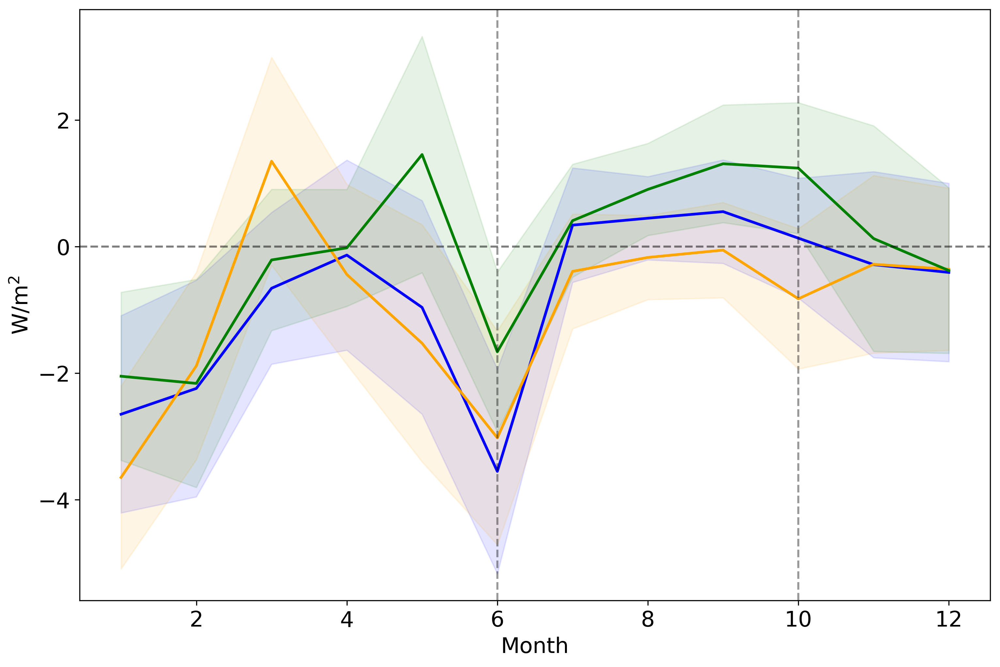

In [171]:
# drop first year for climatology(response)
#p_clim = da_p_s[11:].groupby('time.month').mean('time')
#s_clim = da_s_s[11:].groupby('time.month').mean('time')
#a_clim = da_a_s[11:].groupby('time.month').mean('time')
da_ctl_conv = ctl_sfc_en - ctl_netrad_200hPa

Z = 1.96
n = len(da_ctl_conv.en)


da_pinatubo_conv = pinatubo_sfc_en - pinatubo_netrad_200hPa
da_ctl_conv['time']=da_pinatubo_conv['time']
da_pinatubo_conv = da_pinatubo_conv + da_ctl_conv

da_stmaria_conv = stmaria_sfc_en - stmaria_netrad_200hPa
da_ctl_conv['time']=da_stmaria_conv['time']
da_stmaria_conv = da_stmaria_conv + da_ctl_conv

da_agung_conv = agung_sfc_en - agung_netrad_200hPa
da_ctl_conv['time']=da_agung_conv['time']
da_agung_conv = da_agung_conv + da_ctl_conv

#undo ensemble mean to get confidence intervals
da_ctl_conv['time']=da_agung_conv['time']
da_ctl_conv_s = da_ctl_conv.isel(lon=(da_ctl_conv.lon<=10)|(da_ctl_conv.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])

da_p_s = da_pinatubo_conv.isel(lon=(da_pinatubo_conv.lon<=10)|(da_pinatubo_conv.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_s_s = da_stmaria_conv.isel(lon=(da_pinatubo_conv.lon<=10)|(da_pinatubo_conv.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_a_s = da_agung_conv.isel(lon=(da_pinatubo_conv.lon<=10)|(da_pinatubo_conv.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])

da_ctl_conv['time']=da_pinatubo_conv['time']
da_ctl_conv_s = da_ctl_conv.isel(lon=(da_ctl_conv.lon<=10)|(da_ctl_conv.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_p_s = da_p_s - da_ctl_conv_s

da_ctl_conv['time']=da_stmaria_conv['time']
da_ctl_conv_s = da_ctl_conv.isel(lon=(da_ctl_conv.lon<=10)|(da_ctl_conv.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_s_s = da_s_s - da_ctl_conv_s

da_ctl_conv['time']=da_agung_conv['time']
da_ctl_conv_s = da_ctl_conv.isel(lon=(da_ctl_conv.lon<=10)|(da_ctl_conv.lon>=340)).sel(lat=slice(10,20)).where(land_mask>0.9).mean(['lon','lat'])
da_a_s = da_a_s - da_ctl_conv_s

p_clim = da_p_s[:,12:].groupby('time.month').mean(['time','en'])
s_clim = da_s_s[:,12:].groupby('time.month').mean(['time','en'])
a_clim = da_a_s[:,:48].groupby('time.month').mean(['time','en'])

plt.figure(figsize=(12,8))
plt.plot(p_clim.month, p_clim, label='Pinatubo',color='b',linewidth=2)
#plt.axhline(y=p_clim.mean(), color='b', linestyle="--")
plt.fill_between(p_clim.month,
        p_clim - (Z * da_p_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        p_clim + (Z * da_p_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='b', alpha=0.1, label='95% confidence interval')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)',color='orange',linewidth=2)
plt.fill_between(s_clim.month,
        s_clim - (Z * da_s_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        s_clim + (Z * da_s_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='orange', alpha=0.1, label='95% confidence interval')
#plt.axhline(y=s_clim.mean(), color='orange', linestyle="--" )
plt.plot(a_clim.month, a_clim, label='Agung (SH)',color='g',linewidth=2)
plt.fill_between(p_clim.month,
        a_clim - (Z * da_a_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        a_clim + (Z * da_a_s.groupby('time.month').mean('time').std('en')/ np.sqrt(n)),
        color='g', alpha=0.1, label='95% confidence interval')
#plt.axhline(y=a_clim.mean(), color='g', linestyle="--")
plt.axhline(0, color ='k',linestyle='--',alpha=0.5)
plt.axvline(x=6,color='k',linestyle='--',alpha=0.4)
plt.axvline(x=10,color='k',linestyle='--',alpha=0.4)



#plt.legend(loc=4)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('Month',size=16)
plt.ylabel('W/m$^2$',size=16)
#plt.title('Monthly climatology in Sahel, 5-year average',fontsize=20, fontweight='bold')
#plt.savefig('conv_clim.png', bbox_inches='tight')
#

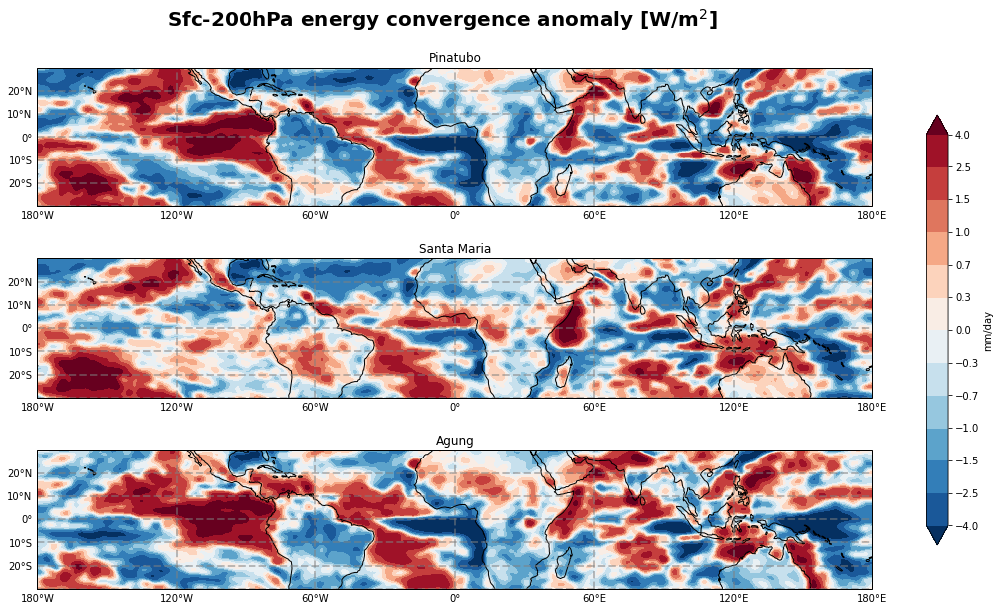

In [64]:
da_pinatubo_conv_ms = pinatubo_sfc_en_ms - pinatubo_netrad_200hPa_ms

da_stmaria_conv_ms = stmaria_sfc_en_ms - stmaria_netrad_200hPa_ms

da_agung_conv_ms = agung_sfc_en_ms - agung_netrad_200hPa_ms



da = [da_pinatubo_conv_ms, da_stmaria_conv_ms, da_agung_conv_ms]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo', 'Santa Maria', 'Agung' ]

fig, axes = plt.subplots(3, 1, figsize=(15,10))

levels=[-4,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,4]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-180,180, -30, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='RdBu_r',levels=levels,extend='both', add_labels=False, add_colorbar=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER

    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =levels, cax=ax,orientation='vertical',label='mm/day')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('Sfc-200hPa energy convergence anomaly [W/m$^2$]',fontsize=20, fontweight='demi',y=.95)
#smoothed over 5x5 degrees
plt.savefig('glob_tropic_conv200.png', bbox_inches='tight')

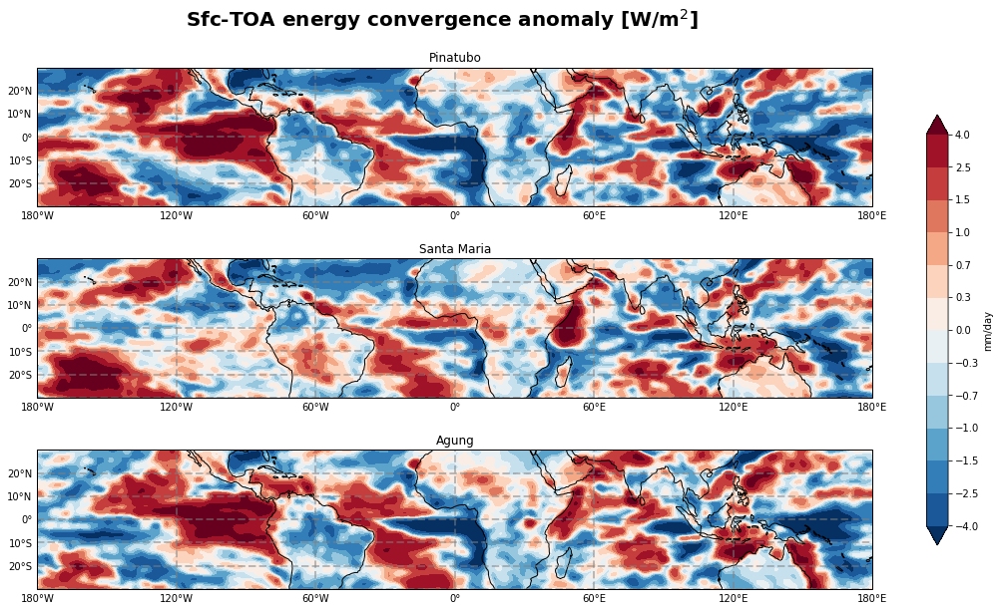

In [65]:
da_pinatubo_conv_ms = pinatubo_sfc_en_ms + pinatubo_toa_ms

da_stmaria_conv_ms = stmaria_sfc_en_ms + stmaria_toa_ms

da_agung_conv_ms = agung_sfc_en_ms + agung_toa_ms



da = [da_pinatubo_conv_ms, da_stmaria_conv_ms, da_agung_conv_ms]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo', 'Santa Maria', 'Agung' ]

fig, axes = plt.subplots(3, 1, figsize=(15,10))

levels=[-4,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,4]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-180,180, -30, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='RdBu_r',levels=levels,extend='both', add_labels=False, add_colorbar=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER

    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =levels, cax=ax,orientation='vertical',label='mm/day')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('Sfc-TOA energy convergence anomaly [W/m$^2$]',fontsize=20, fontweight='demi',y=.95)
#smoothed over 5x5 degrees
plt.savefig('glob_tropic_conv.png', bbox_inches='tight')

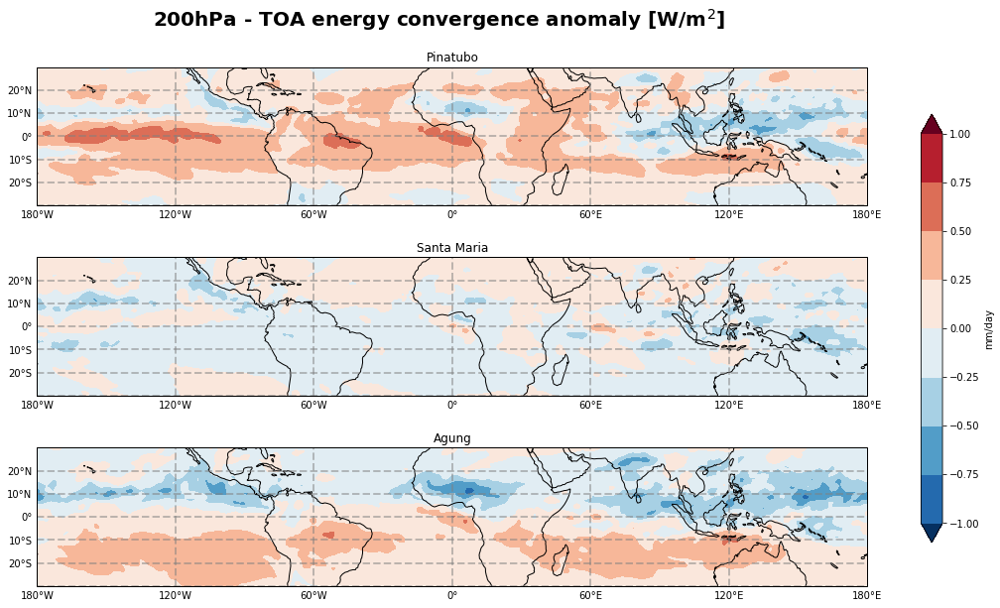

In [67]:
da_pinatubo_conv_ms = pinatubo_netrad_200hPa_ms + pinatubo_toa_ms

da_stmaria_conv_ms = stmaria_netrad_200hPa_ms + stmaria_toa_ms

da_agung_conv_ms = agung_netrad_200hPa_ms + agung_toa_ms



da = [da_pinatubo_conv_ms, da_stmaria_conv_ms, da_agung_conv_ms]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(da_ctl.lon<=10)|(da_ctl.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo', 'Santa Maria', 'Agung' ]

fig, axes = plt.subplots(3, 1, figsize=(15,10))

levels=[-1,-.75,-.5,-.25,0,.25,.5,.75,1]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-180,180, -30, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='RdBu_r',levels=levels,extend='both', add_labels=False, add_colorbar=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER

    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =levels, cax=ax,orientation='vertical',label='mm/day')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('200hPa - TOA energy convergence anomaly [W/m$^2$]',fontsize=20, fontweight='demi',y=.95)
#smoothed over 5x5 degrees
plt.savefig('glob_strat_conv.png', bbox_inches='tight')

/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/dataarray.py:2710: FutureWarning: roll_coords will be set to False in the future. Explicitly set roll_coords to silence warning.
  shifts=shifts, roll_coords=roll_coords, **shifts_kwargs


Text(0.5, 0.95, 'JJA 200hPa - TOA energy convergence anomaly [W/m$^2$]')

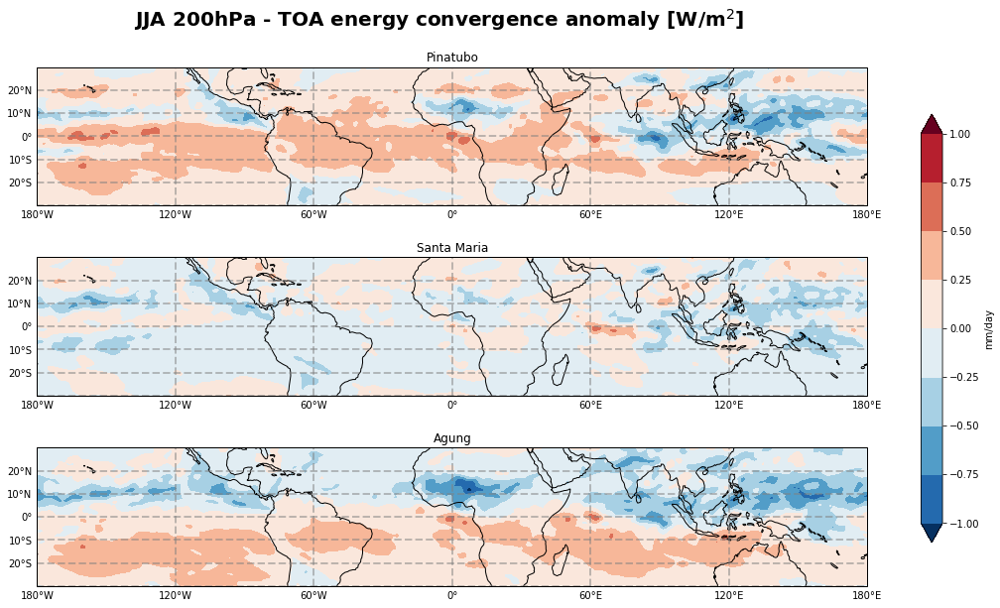

In [34]:
da_pinatubo_conv_jja = pinatubo_netrad_200hPa_jja + pinatubo_toa_jja

da_stmaria_conv_jja = stmaria_netrad_200hPa_jja + stmaria_toa_jja

da_agung_conv_jja = agung_netrad_200hPa_jja + agung_toa_jja



da = [da_pinatubo_conv_jja, da_stmaria_conv_jja, da_agung_conv_jja]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo', 'Santa Maria', 'Agung' ]

fig, axes = plt.subplots(3, 1, figsize=(15,10))

levels=[-1,-.75,-.5,-.25,0,.25,.5,.75,1]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-180,180, -30, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='RdBu_r',levels=levels,extend='both', add_labels=False, add_colorbar=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER

    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =levels, cax=ax,orientation='vertical',label='mm/day')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('JJA 200hPa - TOA energy convergence anomaly [W/m$^2$]',fontsize=20, fontweight='demi',y=.95)
#smoothed over 5x5 degrees
#plt.savefig('glob_strat_conv.png', bbox_inches='tight')

/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/dataarray.py:2710: FutureWarning: roll_coords will be set to False in the future. Explicitly set roll_coords to silence warning.
  shifts=shifts, roll_coords=roll_coords, **shifts_kwargs


Text(0.5, 0.95, 'DJF 200hPa - TOA energy convergence anomaly [W/m$^2$]')

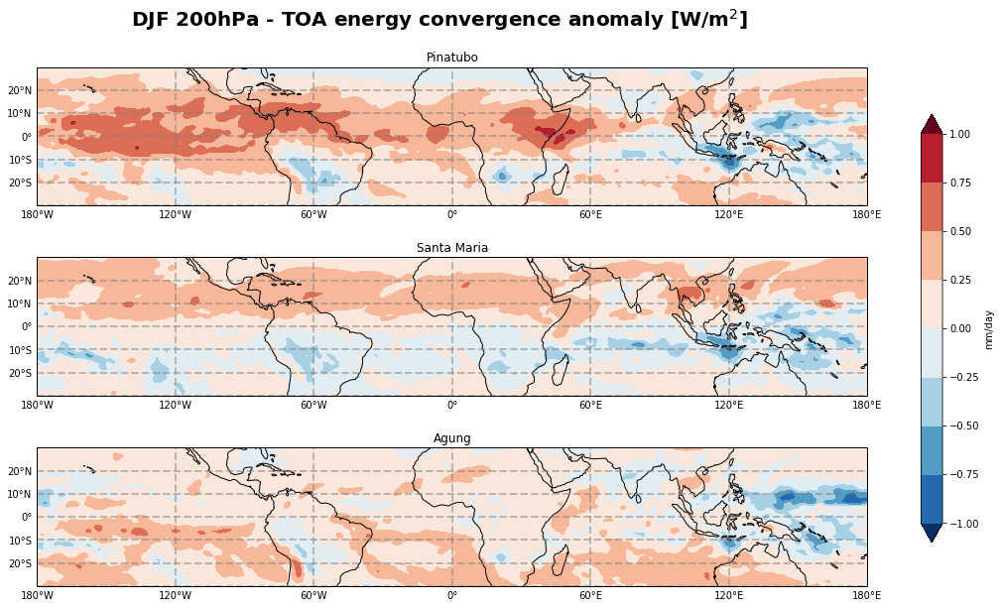

In [37]:
da_pinatubo_conv_djf = pinatubo_netrad_200hPa_djf + pinatubo_toa_djf

da_stmaria_conv_djf = stmaria_netrad_200hPa_djf + stmaria_toa_djf

da_agung_conv_djf = agung_netrad_200hPa_djf + agung_toa_djf



da = [da_pinatubo_conv_djf, da_stmaria_conv_djf, da_agung_conv_djf]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo', 'Santa Maria', 'Agung' ]

fig, axes = plt.subplots(3, 1, figsize=(15,10))

levels=[-1,-.75,-.5,-.25,0,.25,.5,.75,1]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-180,180, -30, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='RdBu_r',levels=levels,extend='both', add_labels=False, add_colorbar=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER

    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =levels, cax=ax,orientation='vertical',label='mm/day')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('DJF 200hPa - TOA energy convergence anomaly [W/m$^2$]',fontsize=20, fontweight='demi',y=.95)
#smoothed over 5x5 degrees
#plt.savefig('glob_strat_conv.png', bbox_inches='tight')

Text(0.5, 0.98, '200hPa to TOA Energy Convergence')

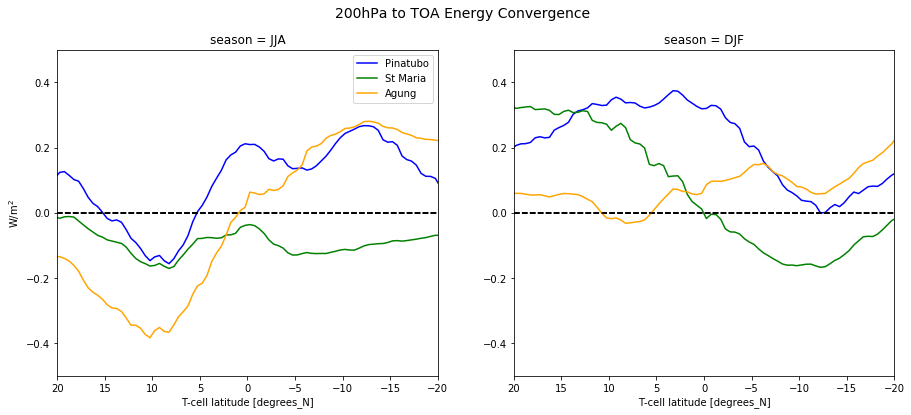

In [85]:
da_jja = [da_pinatubo_conv_jja,da_stmaria_conv_jja,da_agung_conv_jja]
da_djf = [da_pinatubo_conv_djf,da_stmaria_conv_djf,da_agung_conv_djf]
da_za_jja = [0,1,2]
da_za_djf = [0,1,2]
colors = ['b','g','orange']
titles = ['Pinatubo','St Maria', 'Agung']
plt.subplots(1, 2, figsize=(15,6))
jja = plt.subplot(1,2,1)
for i in da_za_jja:
    da_za_jja[i] = da_jja[i].mean(['lon'])
    da_za_jja[i].plot(color=colors[i],label=titles[i])
    jja.set_xlim([20,-20])
    jja.set_ylim(-.5,.5)
    jja.axhline(0,color='k',linestyle='--')
    jja.set_ylabel('W/m$^2$')
    jja.legend()
    
    
djf = plt.subplot(1,2,2)
da_djf = [da_pinatubo_conv_djf,da_stmaria_conv_djf,da_agung_conv_djf]
for i in da_za_djf:
    da_za_djf[i] = da_djf[i].mean(['lon'])
    da_za_djf[i].plot(color=colors[i])
    djf.set_xlim([20,-20])
    djf.set_ylim(-.5,.5)
    djf.axhline(0,color='k',linestyle='--')
    
plt.suptitle('200hPa to TOA Energy Convergence',fontsize=14)


<module 'matplotlib.pyplot' from '/home/tessj/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py'>

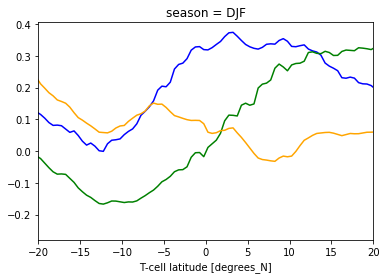

In [45]:
da = [da_pinatubo_conv_djf,da_stmaria_conv_djf,da_agung_conv_djf]
da_za = [0,1,2]
colors = ['b','g','orange']
for i in da_za:
    da_za[i] = da[i].mean(['lon'])
    da_za[i].plot(color=colors[i])
    plt.xlim([-20,20])

## Lin trop convergence

/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/dataarray.py:2710: FutureWarning: roll_coords will be set to False in the future. Explicitly set roll_coords to silence warning.
  shifts=shifts, roll_coords=roll_coords, **shifts_kwargs


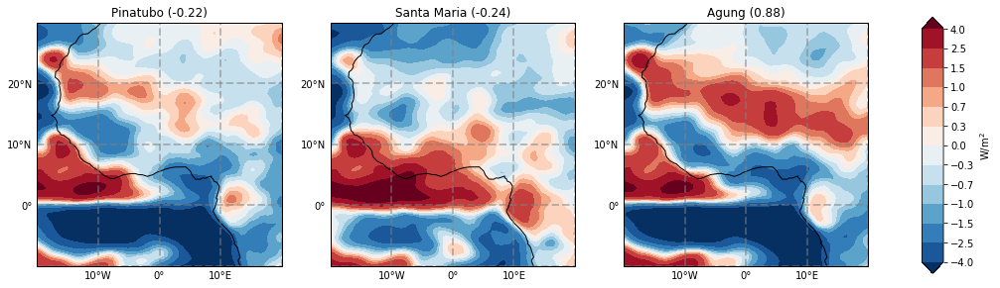

In [86]:
#plot NEGATIVE so its Fb - Ft
fig = plt.figure(figsize=(15,6))
levels=[-4,-2.5,-1.5,-1,-.7,-.3,0,.3,.7,1,1.5,2.5,4]


ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_sfc_en_ms - pinatubo_netrad_lin_trop_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo (%.2f)' %(pinatubo_sfc_en_ms - pinatubo_netrad_lin_trop_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(- stmaria_netrad_lin_trop_ms + stmaria_sfc_en_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria (%.2f)' %(stmaria_sfc_en_ms - stmaria_netrad_lin_trop_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(- agung_netrad_lin_trop_ms + agung_sfc_en_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, levels=levels,extend='both', cmap = 'RdBu_r', add_colorbar=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung (%.2f)' %(agung_sfc_en_ms - agung_netrad_lin_trop_ms).isel(lon=(pinatubo_sfc.lon<=10)|(pinatubo_sfc.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']))

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,cax=ax,ticks=levels,orientation='vertical',label='W/m$^2$')

#plt.suptitle('MS Atmospheric convergence, surface to lin trop [W/m$^2$]')
#smoothed
#plt.savefig('del_netrad_ms.png',bbox_inches='tight')

In [89]:
#make monthly climatologies & time series for each volcano

pinatubo_conv_lin_trop_s = (pinatubo_sfc_en - pinatubo_netrad_lin_trop).mean('en').isel(lon=(pinatubo_sfc_en.lon<=10)|(pinatubo_sfc_en.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
stmaria_conv_lin_trop_s = (stmaria_sfc_en - stmaria_netrad_lin_trop).mean('en').isel(lon=(stmaria_sfc_en.lon<=10)|(stmaria_sfc_en.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
agung_conv_lin_trop_s = (agung_sfc_en - agung_netrad_lin_trop).mean('en').isel(lon=(agung_sfc_en.lon<=10)|(agung_sfc_en.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])


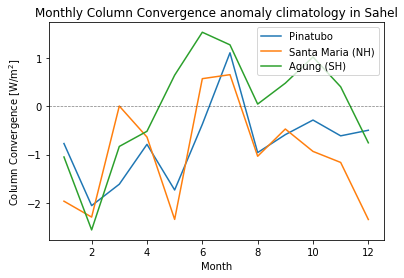

In [90]:
p_clim = pinatubo_conv_lin_trop_s.groupby('time.month').mean('time')
s_clim = stmaria_conv_lin_trop_s.groupby('time.month').mean('time')
a_clim = agung_conv_lin_trop_s.groupby('time.month').mean('time')

plt.plot(p_clim.month, p_clim, label='Pinatubo')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)')
plt.plot(a_clim.month, a_clim, label='Agung (SH)')
plt.legend()
plt.axhline(0, c='k', linestyle='--', alpha=0.5, lw = 0.7)
plt.xlabel('Month')
plt.ylabel('Column Convergence [W/m$^2$]')
plt.title('Monthly Column Convergence anomaly climatology in Sahel')
#plt.savefig('conv_clim.png')

/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/dataarray.py:2710: FutureWarning: roll_coords will be set to False in the future. Explicitly set roll_coords to silence warning.
  shifts=shifts, roll_coords=roll_coords, **shifts_kwargs


Text(0.5, 0.95, 'JJA lin_trop - TOA energy convergence anomaly [W/m$^2$]')

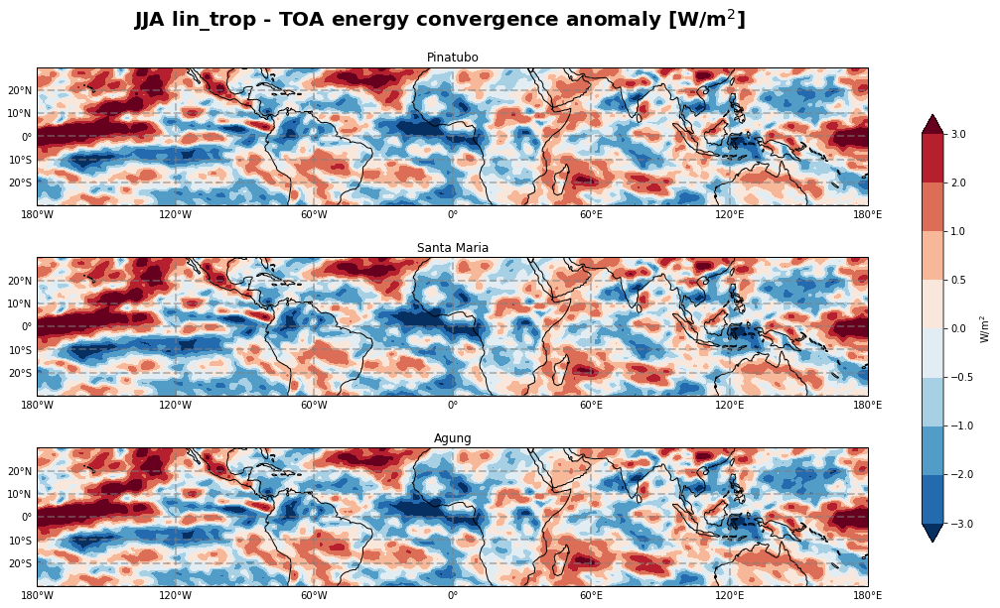

In [98]:
da_pinatubo_conv_jja = pinatubo_netrad_lin_trop_jja + pinatubo_toa_jja

da_stmaria_conv_jja = stmaria_netrad_lin_trop_jja + stmaria_toa_jja

da_agung_conv_jja = agung_netrad_lin_trop_jja + agung_toa_jja



da = [da_pinatubo_conv_jja, da_stmaria_conv_jja, da_agung_conv_jja]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo', 'Santa Maria', 'Agung' ]

fig, axes = plt.subplots(3, 1, figsize=(15,10))

levels=[-3,-2,-1,-.5,0,.5,1,2,3]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-180,180, -30, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='RdBu_r',levels=levels,extend='both', add_labels=False, add_colorbar=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER

    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =levels, cax=ax,orientation='vertical',label='W/m$^2$')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('JJA lin_trop - TOA energy convergence anomaly [W/m$^2$]',fontsize=20, fontweight='demi',y=.95)
#smoothed over 5x5 degrees
#plt.savefig('glob_strat_conv.png', bbox_inches='tight')

/home/tessj/anaconda3/lib/python3.7/site-packages/xarray/core/dataarray.py:2710: FutureWarning: roll_coords will be set to False in the future. Explicitly set roll_coords to silence warning.
  shifts=shifts, roll_coords=roll_coords, **shifts_kwargs


Text(0.5, 0.95, 'DJF lin_trop - TOA energy convergence anomaly [W/m$^2$]')

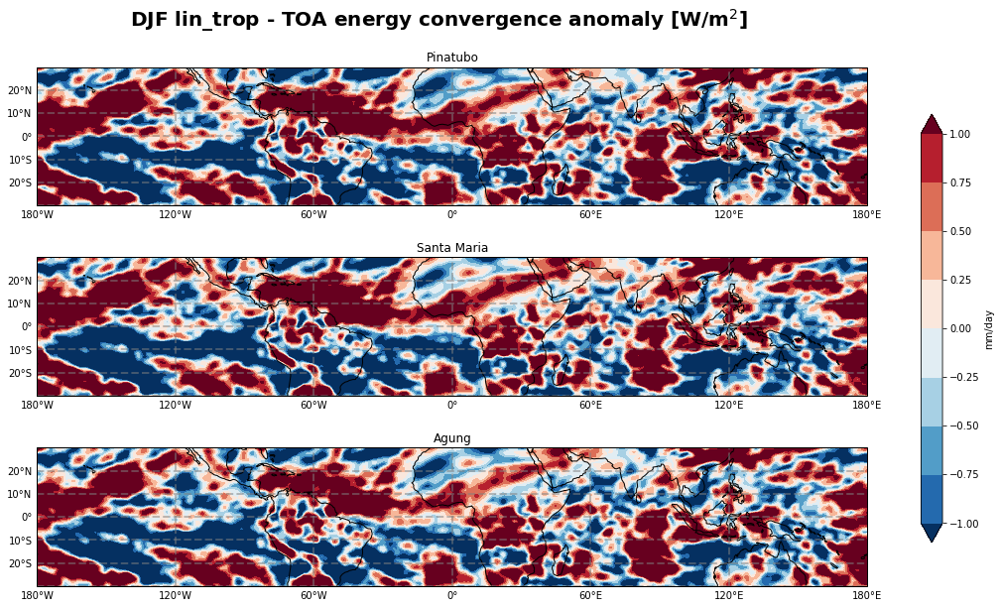

In [101]:
da_pinatubo_conv_djf = pinatubo_netrad_lin_trop_djf + pinatubo_toa_djf

da_stmaria_conv_djf = stmaria_netrad_lin_trop_djf + stmaria_toa_djf

da_agung_conv_djf = agung_netrad_lin_trop_djf + agung_toa_djf



da = [da_pinatubo_conv_djf, da_stmaria_conv_djf, da_agung_conv_djf]
da_s = [0,1,2]
for i in da_s:
    da_s[i] = da[i].isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
titles = ['Pinatubo', 'Santa Maria', 'Agung' ]

fig, axes = plt.subplots(3, 1, figsize=(15,10))

levels=[-1,-.75,-.5,-.25,0,.25,.5,.75,1]

for ii, ax in enumerate(axes.flat):
    ax=plt.subplot(3,1,ii+1,projection=ccrs.PlateCarree())
    ax.set_extent([-180,180, -30, 30], ccrs.PlateCarree())
    im = shift_longitude(da[ii]).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, cmap='RdBu_r',levels=levels,extend='both', add_labels=False, add_colorbar=False)
    g3=ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    g3.xlabels_top=False
    g3.ylabels_right=False
    g3.xformatter=LONGITUDE_FORMATTER
    g3.yformatter=LATITUDE_FORMATTER

    ax.add_feature(cfeature.LAND, facecolor='0.75')
    ax.coastlines() 
    ax.set_title(titles[ii])

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks =levels, cax=ax,orientation='vertical',label='mm/day')
#plt.tight_layout()#(rect=(0,0,1,1))

plt.suptitle('DJF lin_trop - TOA energy convergence anomaly [W/m$^2$]',fontsize=20, fontweight='demi',y=.95)
#smoothed over 5x5 degrees
#plt.savefig('glob_strat_conv.png', bbox_inches='tight')

### Sfc allsky from thesis- includes turbulent fluxes

In [ ]:
# W/m^2
pinatubo_lwup_sfc = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.lwup_sfc.nc/') 
stmaria_lwup_sfc = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.lwup_sfc.nc/') 
agung_lwup_sfc = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.lwup_sfc.nc/')
ctl_lwup_sfc = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.lwup_sfc.nc/') 

pinatubo_lwdn_sfc = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.lwdn_sfc.nc/') 
stmaria_lwdn_sfc = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.lwdn_sfc.nc/') 
agung_lwdn_sfc = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.lwdn_sfc.nc/')
ctl_lwdn_sfc = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.lwdn_sfc.nc/') 

pinatubo_swup_sfc = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swup_sfc.nc/') 
stmaria_swup_sfc = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swup_sfc.nc/') 
agung_swup_sfc = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swup_sfc.nc/')
ctl_swup_sfc = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swup_sfc.nc/') 

pinatubo_swdn_sfc = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.swdn_sfc.nc/') 
stmaria_swdn_sfc = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.swdn_sfc.nc/') 
agung_swdn_sfc = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.swdn_sfc.nc/')
ctl_swdn_sfc = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.swdn_sfc.nc/') 

pinatubo_shflx = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.shflx.nc/') 
stmaria_shflx = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.shflx.nc/') 
agung_shflx = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.shflx.nc/')
ctl_shflx = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.shflx.nc/') 



#### F$_b$ - F$_t$ (warming) (kind of a mess from here)


In [ ]:
pinatubo_netrad =  (-pinatubo_lwdn_sfc + pinatubo_lwup_sfc - pinatubo_swdn_sfc + pinatubo_swup_sfc + pinatubo_shflx + L*pinatubo_e) + pinatubo_toa 
stmaria_netrad =  (-stmaria_lwdn_sfc + stmaria_lwup_sfc - stmaria_swdn_sfc + stmaria_swup_sfc + stmaria_shflx + L*stmaria_e) + stmaria_toa
agung_netrad =  (-agung_lwdn_sfc + agung_lwup_sfc - agung_swdn_sfc + agung_swup_sfc + agung_shflx + L*agung_e) + agung_toa

#^^ ya really messed up over here... the _toa fluxes are *already* anomalies. fixed below
pinatubo_sfc = pinatubo_netrad - pinatubo_toa
stmaria_sfc = stmaria_netrad - stmaria_toa
agung_sfc = agung_netrad - agung_toa


In [ ]:
ctl_lwup_sfc['time']=pinatubo_shflx['time']
ctl_lwdn_sfc['time']=pinatubo_shflx['time']
ctl_swup_sfc['time']=pinatubo_shflx['time']
ctl_swdn_sfc['time']=pinatubo_shflx['time']
ctl_shflx['time']=pinatubo_shflx['time']
ctl_e['time']=pinatubo_shflx['time']
ctl_toa['time']=pinatubo_toa['time']
ctl_netrad = (-ctl_lwdn_sfc + ctl_lwup_sfc - ctl_swdn_sfc + ctl_swup_sfc + ctl_shflx + L*ctl_e) + ctl_toa
da_pinatubo_netrad = pinatubo_netrad-ctl_netrad
pinatubo_netrad_jja= da_pinatubo_netrad.groupby('time.season').mean(['time','en']).sel(season='JJA')
ctl_sfc = ctl_netrad - ctl_toa
da_pinatubo_sfc = pinatubo_sfc - ctl_sfc
pinatubo_sfc_jja = da_pinatubo_sfc.groupby('time.season').mean(['time','en']).sel(season='JJA')

In [ ]:
ctl_lwup_sfc['time']=stmaria_shflx['time']
ctl_lwdn_sfc['time']=stmaria_shflx['time']
ctl_swup_sfc['time']=stmaria_shflx['time']
ctl_swdn_sfc['time']=stmaria_shflx['time']
ctl_shflx['time']=stmaria_shflx['time']
ctl_e['time']=stmaria_shflx['time']
ctl_toa['time']=stmaria_toa['time']
ctl_netrad = (-ctl_lwdn_sfc + ctl_lwup_sfc - ctl_swdn_sfc + ctl_swup_sfc + ctl_shflx + L*ctl_e) + ctl_toa
da_stmaria_netrad = stmaria_netrad-ctl_netrad
stmaria_netrad_jja= da_stmaria_netrad.groupby('time.season').mean(['time','en']).sel(season='JJA')
ctl_sfc = ctl_netrad - ctl_toa
da_stmaria_sfc = stmaria_sfc - ctl_sfc
stmaria_sfc_jja = da_stmaria_sfc.groupby('time.season').mean(['time','en']).sel(season='JJA')

In [ ]:
ctl_lwup_sfc['time']=agung_shflx['time']
ctl_lwdn_sfc['time']=agung_shflx['time']
ctl_swup_sfc['time']=agung_shflx['time']
ctl_swdn_sfc['time']=agung_shflx['time']
ctl_shflx['time']=agung_shflx['time']
ctl_e['time']=agung_shflx['time']
ctl_toa['time']=agung_toa['time']
ctl_netrad = (-ctl_lwdn_sfc + ctl_lwup_sfc - ctl_swdn_sfc + ctl_swup_sfc + ctl_shflx+ L*ctl_e) + ctl_toa
da_agung_netrad = agung_netrad - ctl_netrad
agung_netrad_jja= da_agung_netrad.groupby('time.season').mean(['time','en']).sel(season='JJA')
ctl_sfc = ctl_netrad - ctl_toa
da_agung_sfc = agung_sfc - ctl_sfc
agung_sfc_jja = da_agung_sfc.groupby('time.season').mean(['time','en']).sel(season='JJA')

Text(0.5, 0.98, 'All sky surface netrad, positive up [W/m$^2$]')

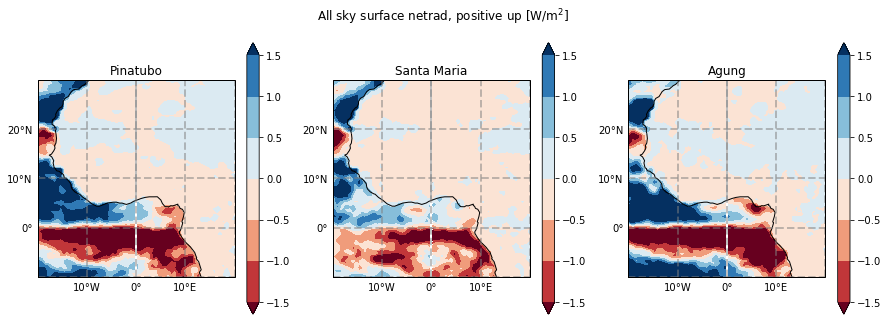

In [56]:
#allsky surface flux (positive up)
#
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(da_pinatubo_sfc.mean(['en','time'])).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, cmap = 'RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(da_stmaria_sfc.mean(['en','time'])).plot.contourf(robust=True, center=0, vmin=-1.5,vmax=1.5,cmap = 'RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(da_agung_sfc.mean(['en','time'])).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, cmap = 'RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')


plt.suptitle('All sky surface netrad, positive up [W/m$^2$]')
#plt.savefig('sfc_netrad.png')
#other anomalies on order of 4.5 W/m^2

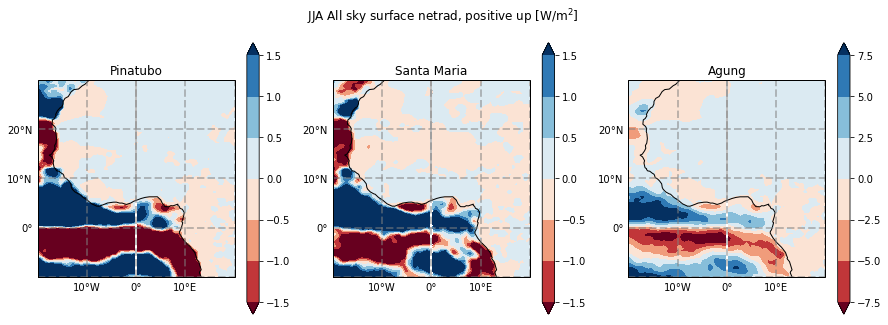

In [192]:
#allsky surface flux jja (positive up)

plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
pinatubo_sfc_jja.plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, cmap = 'RdBu')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
stmaria_sfc_jja.plot.contourf(robust=True, center=0, vmin=-1.5,vmax=1.5,cmap = 'RdBu')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
agung_sfc_jja.plot.contourf(robust=True, center=0, vmin=-1.5,vmax=1.5,cmap = 'RdBu')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')


plt.suptitle('JJA All sky surface netrad, positive up [W/m$^2$]')
##plt.savefig('sfc_netrad_jja.png')
#other anomalies on order of 8 W/m^2

In [181]:
da_pinatubo_sfc.isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat','time','en'])

<xarray.DataArray ()>
array(0.006162, dtype=float32)

In [135]:
print((L*pinatubo_e).mean(['lon','lat','time','en']),(L*ctl_e).mean(['lon','lat','time','en']))

<xarray.DataArray 'evap' ()>
array(61.31551, dtype=float32) <xarray.DataArray 'evap' ()>
array(61.76026, dtype=float32)


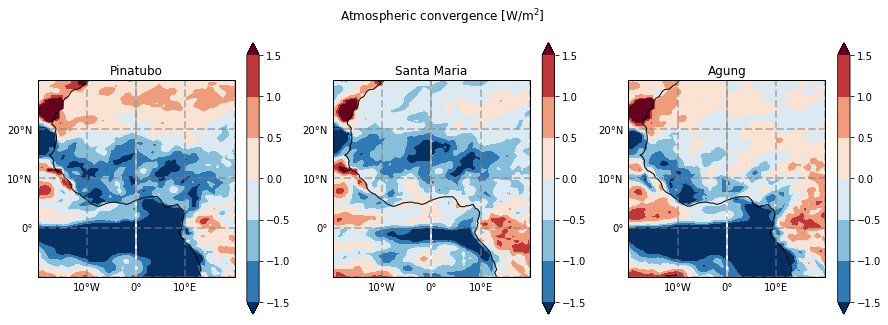

In [61]:
#plot NEGATIVE so its Fb - Ft (pinatubo_toa is positive down)
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_toa + da_pinatubo_sfc).mean(['en','time']).plot.contourf(robust=True, center=0,vmin=-1.5,vmax=1.5, cmap = 'RdBu_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_toa + da_stmaria_sfc).mean(['en','time']).plot.contourf(robust=True, center=0, vmin=-1.5,vmax=1.5,cmap = 'RdBu_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_toa + da_agung_sfc).mean(['en','time']).plot.contourf(robust=True, center=0, vmin=-1.5,vmax=1.5,cmap = 'RdBu_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')


plt.suptitle('Atmospheric convergence [W/m$^2$]')
#plt.savefig('del_netrad.png')
#max on order of 3 W/m^2

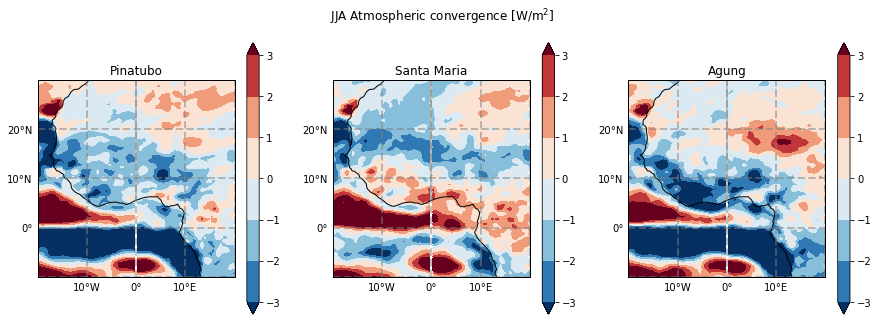

In [60]:
#same as above but JJA
#plot NEGATIVE so its Fb - Ft
plt.figure(figsize=(15,5))

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(pinatubo_toa_jja + pinatubo_sfc_jja).plot.contourf(robust=True, center=0,vmin=-3,vmax=3, cmap = 'RdBu_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(stmaria_toa_jja + stmaria_sfc_jja).plot.contourf(robust=True, center=0,vmin=-3,vmax=3, cmap = 'RdBu_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
(agung_toa_jja + agung_sfc_jja).plot.contourf(robust=True, center=0,vmin=-3,vmax=3, cmap = 'RdBu_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('JJA Atmospheric convergence [W/m$^2$]')
#plt.savefig('del_netrad_jja.png')


In [ ]:
p_netrad_clim = da_pinatubo_netrad[:,5:17].mean('en').isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat']).groupby('time.month')
p_netrad_clim.mean('time').plot()
s_netrad_clim = da_stmaria_netrad[:,5:17].mean('en').isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat']).groupby('time.month')
s_netrad_clim.mean('time').plot()
a_netrad_clim = da_agung_netrad[:,5:17].mean('en').isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat']).groupby('time.month')
a_netrad_clim.mean('time').plot()
                                         

In [62]:
(agung_toa + da_agung_sfc).mean(['en','time']).isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])


<xarray.DataArray ()>
array(-0.438518, dtype=float32)

In [63]:
(pinatubo_toa + da_pinatubo_sfc).mean(['en','time']).isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

<xarray.DataArray ()>
array(-0.916411, dtype=float32)

In [64]:
(stmaria_toa + da_stmaria_sfc).mean(['en','time']).isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])


<xarray.DataArray ()>
array(-1.017751, dtype=float32)

In [65]:
(pinatubo_toa_jja + pinatubo_sfc_jja).isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

<xarray.DataArray ()>
array(-1.665127, dtype=float32)
Coordinates:
    season   <U3 'JJA'

In [66]:
(stmaria_toa_jja + stmaria_sfc_jja).isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

<xarray.DataArray ()>
array(-1.420664, dtype=float32)
Coordinates:
    season   <U3 'JJA'

In [67]:
(agung_toa_jja + agung_sfc_jja).isel(lon=(da_pinatubo_netrad.lon<=10)|(da_pinatubo_netrad.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

<xarray.DataArray ()>
array(-0.823645, dtype=float32)
Coordinates:
    season   <U3 'JJA'

# Energy barplots (Sahel, monsoon season)

## Clr sky

### TOA

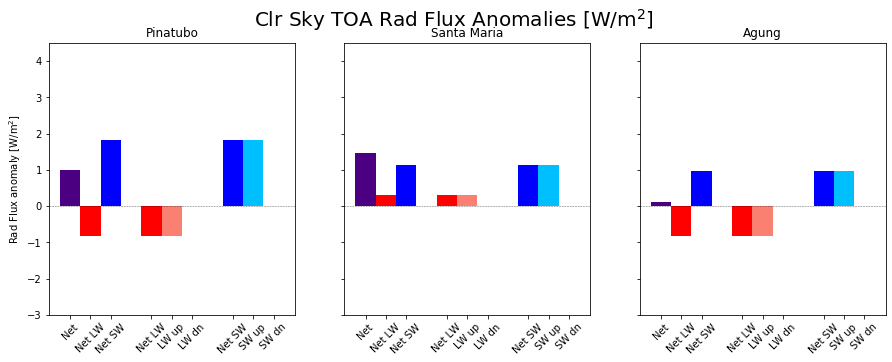

In [45]:
#clrsky TOA 
'''
#st maria 
net = (-1)*stmaria_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = stmaria_olr_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = stmaria_sw_toa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

swup = stmaria_swup_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = stmaria_swdn_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])


N=3
nets = (net, netLW, netSW)
ups = (netLW, netLW, swup)
dns = (netSW, 0, swdn)

ind = np.arange(N)
width=0.25

plt.bar(ind, nets, width)
plt.bar(ind+width, ups, width)
plt.bar(ind+2*width, dns, width)
plt.show()'''


N=3
ind = np.arange(N)
width=0.25


f, ((pin,stm,agu)) = plt.subplots(1,3,figsize=(15,5),sharex='row',sharey='row')

#pinatubo
net = (-1)*pinatubo_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = pinatubo_olr_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = pinatubo_sw_toa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = pinatubo_swup_toa_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = pinatubo_swdn_toa_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, netLW, swup)
dns = (netSW, 0, -swdn)
pin.bar(ind, nets, width, color = ['indigo','red','blue'])
pin.bar(ind+width, ups, width, color = ['red','salmon','deepskyblue'])
pin.bar(ind+2*width, dns, width, color = ['blue','salmon','deepskyblue'])
pin.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
pin.set_ylabel('Rad Flux anomaly [W/m$^2$]')
pin.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
pin.set_ylim((-3,4.5))
pin.title.set_text('Pinatubo')


#st maria 
net = (-1)*stmaria_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = stmaria_olr_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = stmaria_sw_toa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = stmaria_swup_toa_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = stmaria_swdn_toa_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, netLW, swup)
dns = (netSW, 0, -swdn)
stm.bar(ind, nets, width, color = ['indigo','red','blue'])
stm.bar(ind+width, ups, width, color = ['red','salmon','deepskyblue'])
stm.bar(ind+2*width, dns, width, color = ['blue','salmon','deepskyblue'])
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
stm.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
stm.title.set_text('Santa Maria')


#agung
net = (-1)*agung_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = agung_olr_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = agung_sw_toa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = agung_swup_toa_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = agung_swdn_toa_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, netLW, swup)
dns = (netSW, 0, -swdn)
agu.bar(ind,nets, width, color = ['indigo','red','blue'])
agu.bar(ind+width, ups, width, color = ['red','salmon','deepskyblue'])
agu.bar(ind+2*width, dns, width, color = ['blue','salmon','deepskyblue'])
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
agu.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
agu.title.set_text('Agung')

plt.suptitle('Clr Sky TOA Rad Flux Anomalies [W/m$^2$]',fontsize=20)
plt.show()


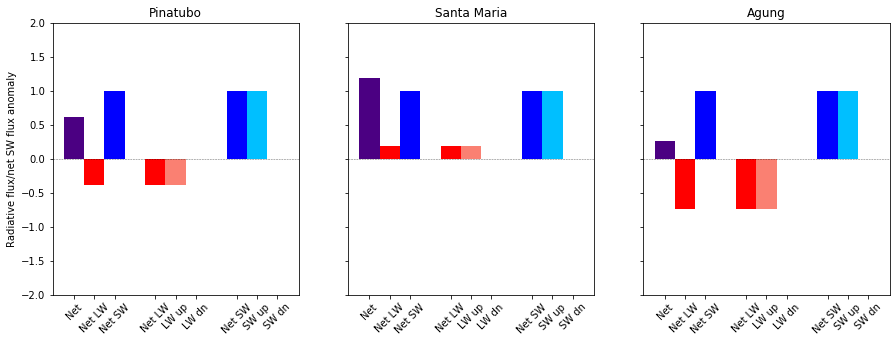

In [197]:
#clrsky TOA 
'''
#st maria 
net = (-1)*stmaria_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = stmaria_olr_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = stmaria_sw_toa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

swup = stmaria_swup_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = stmaria_swdn_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])


N=3
nets = (net, netLW, netSW)
ups = (netLW, netLW, swup)
dns = (netSW, 0, swdn)

ind = np.arange(N)
width=0.25

plt.bar(ind, nets, width)
plt.bar(ind+width, ups, width)
plt.bar(ind+2*width, dns, width)
plt.show()'''


N=3
ind = np.arange(N)
width=0.25


f, ((pin,stm,agu)) = plt.subplots(1,3,figsize=(15,5),sharex='row',sharey='row')

#pinatubo
net = (-1)*pinatubo_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = pinatubo_olr_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = pinatubo_sw_toa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = pinatubo_swup_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = pinatubo_swdn_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, netLW, swup)
dns = (netSW, 0, -swdn)
pin.bar(ind, [net/netSW for net in nets], width, color = ['indigo','red','blue'])
pin.bar(ind+width, [up/netSW for up in ups], width, color = ['red','salmon','deepskyblue'])
pin.bar(ind+2*width, [dn/netSW for dn in dns], width, color = ['blue','salmon','deepskyblue'])
pin.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
pin.set_ylabel('Radiative flux/net SW flux anomaly')
pin.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
pin.set_ylim((-2,2))
pin.title.set_text('Pinatubo')
netSW_toa_p = netSW


#st maria 
net = (-1)*stmaria_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = stmaria_olr_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = stmaria_sw_toa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = stmaria_swup_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = stmaria_swdn_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, netLW, swup)
dns = (netSW, 0, -swdn)
stm.bar(ind, [net/netSW for net in nets], width, color = ['indigo','red','blue'])
stm.bar(ind+width, [up/netSW for up in ups], width, color = ['red','salmon','deepskyblue'])
stm.bar(ind+2*width, [dn/netSW for dn in dns], width, color = ['blue','salmon','deepskyblue'])
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
stm.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
stm.title.set_text('Santa Maria')
netSW_toa_s = netSW

#agung
net = (-1)*agung_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = agung_olr_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = agung_sw_toa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = agung_swup_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = agung_swdn_toa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, netLW, swup)
dns = (netSW, 0, -swdn)
agu.bar(ind, [net/netSW for net in nets], width, color = ['indigo','red','blue'])
agu.bar(ind+width, [up/netSW for up in ups], width, color = ['red','salmon','deepskyblue'])
agu.bar(ind+2*width, [dn/netSW for dn in dns], width, color = ['blue','salmon','deepskyblue'])
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
agu.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
agu.title.set_text('Agung')
netSW_toa_a = netSW

#plt.suptitle('Clr Sky TOA Rad Flux/SW Flux Anomalies',fontsize=20)
plt.show()
#plt.savefig('clr_toa_rad_sw_bar.png')

### 200 hPa

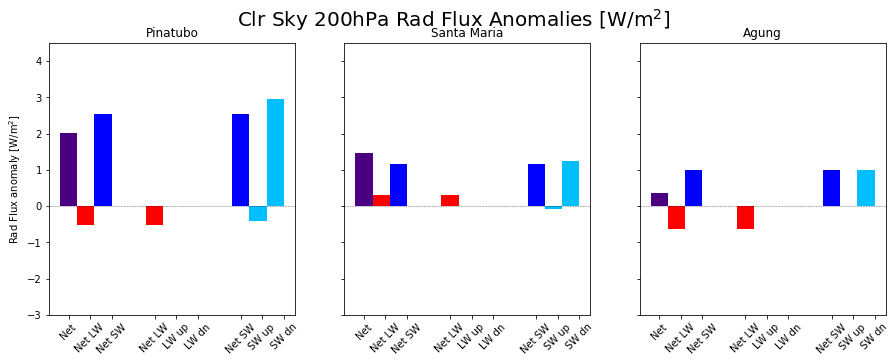

In [108]:
#clrsky 200hPa 


N=3
ind = np.arange(N)
width=0.25


f, ((pin,stm,agu)) = plt.subplots(1,3,figsize=(15,5),sharex='col',sharey='row')

#pinatubo
net = pinatubo_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = pinatubo_lw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = pinatubo_sw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swup = pinatubo_swup_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swdn = pinatubo_swdn_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, 0, swup)
dns = (netSW, 0, -swdn)
agu.bar(ind, [net/netSW for net in nets], width, color = ['indigo','red','blue'])
agu.bar(ind+width, [up/netSW for up in ups], width, color = ['red','salmon','deepskyblue'])
agu.bar(ind+2*width, [dn/netSW for dn in dns], width, color = ['blue','salmon','deepskyblue'])
pin.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
pin.set_ylabel('Rad Flux anomaly [W/m$^2$]')
pin.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
pin.set_ylim((-3,4.5))
pin.title.set_text('Pinatubo')


#st maria 
net = stmaria_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = stmaria_lw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = stmaria_sw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swup = stmaria_swup_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swdn = stmaria_swdn_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, 0, swup)
dns = (netSW, 0, -swdn)
stm.bar(ind, nets, width, color = ['indigo','red','blue'])
stm.bar(ind+width, ups, width, color = ['red','salmon','deepskyblue'])
stm.bar(ind+2*width, dns, width, color = ['blue','salmon','deepskyblue'])
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
stm.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
stm.title.set_text('Santa Maria')


#agung
net = agung_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = agung_lw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = agung_sw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swup = agung_swup_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swdn = agung_swdn_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, 0, swup)
dns = (netSW, 0, -swdn)
agu.bar(ind, nets, width, color = ['indigo','red','blue'])
agu.bar(ind+width, ups, width, color = ['red','salmon','deepskyblue'])
agu.bar(ind+2*width, dns, width, color = ['blue','salmon','deepskyblue'])
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
agu.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
agu.title.set_text('Agung')

plt.suptitle('Clr Sky 200hPa Rad Flux Anomalies [W/m$^2$]',fontsize=20)
plt.show()

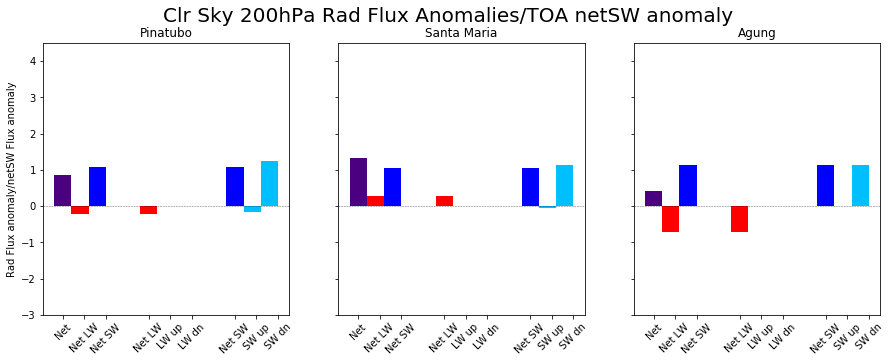

In [111]:
#clrsky 200hPa 


N=3
ind = np.arange(N)
width=0.25


f, ((pin,stm,agu)) = plt.subplots(1,3,figsize=(15,5),sharex='col',sharey='row')

#pinatubo
net = pinatubo_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = pinatubo_lw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = pinatubo_sw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = pinatubo_swup_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = pinatubo_swdn_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, 0, swup)
dns = (netSW, 0, -swdn)
pin.bar(ind, [net/netSW_toa_p for net in nets], width, color = ['indigo','red','blue'])
pin.bar(ind+width, [up/netSW_toa_p for up in ups], width, color = ['red','salmon','deepskyblue'])
pin.bar(ind+2*width, [dn/netSW_toa_p for dn in dns], width, color = ['blue','salmon','deepskyblue'])
pin.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
pin.set_ylabel('Rad Flux anomaly/netSW Flux anomaly')
pin.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
pin.set_ylim((-3,4.5))
pin.title.set_text('Pinatubo')


#st maria 
net = stmaria_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = stmaria_lw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = stmaria_sw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = stmaria_swup_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = stmaria_swdn_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, 0, swup)
dns = (netSW, 0, -swdn)
stm.bar(ind, [net/netSW_toa_s for net in nets], width, color = ['indigo','red','blue'])
stm.bar(ind+width, [up/netSW_toa_s for up in ups], width, color = ['red','salmon','deepskyblue'])
stm.bar(ind+2*width, [dn/netSW_toa_s for dn in dns], width, color = ['blue','salmon','deepskyblue'])
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
stm.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
stm.title.set_text('Santa Maria')


#agung
net = agung_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = agung_lw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = agung_sw_200hPa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = agung_swup_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = agung_swdn_200hPa_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

nets = (net, netLW, netSW)
ups = (netLW, 0, swup)
dns = (netSW, 0, -swdn)
agu.bar(ind, [net/netSW_toa_a for net in nets], width, color = ['indigo','red','blue'])
agu.bar(ind+width, [up/netSW_toa_a for up in ups], width, color = ['red','salmon','deepskyblue'])
agu.bar(ind+2*width, [dn/netSW_toa_a for dn in dns], width, color = ['blue','salmon','deepskyblue'])
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
agu.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
agu.title.set_text('Agung')

plt.suptitle('Clr Sky 200hPa Rad Flux Anomalies/TOA netSW anomaly',fontsize=20)
plt.show()

### Surface

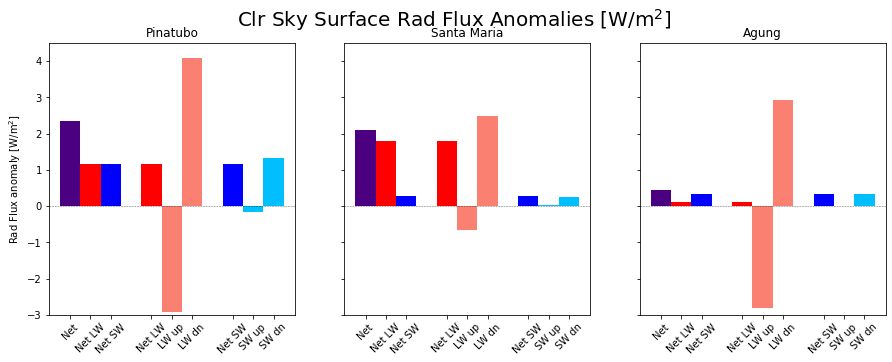

In [28]:
#clrsky surface 

'''st maria 
net = stmaria_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = stmaria_lw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = stmaria_sw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

swup = stmaria_swup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swdn = stmaria_swdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

lwup = stmaria_lwup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
lwdn = stmaria_lwdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])


N=3
nets = (net, netLW, netSW)
ups = (netLW, lwup, swup)
dns = (netSW, -lwdn, -swdn)

ind = np.arange(N)
width=0.25
plt.bar(ind, nets, width)
plt.bar(ind+width, ups, width)
plt.bar(ind+2*width, dns, width)
plt.show()
'''

N=3
ind = np.arange(N)
width=0.25


f, ((pin,stm,agu)) = plt.subplots(1,3,figsize=(15,5),sharex='col',sharey='row')

#pinatubo
net = pinatubo_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = pinatubo_lw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = pinatubo_sw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swup = pinatubo_swup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swdn = pinatubo_swdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
lwup = pinatubo_lwup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
lwdn = pinatubo_lwdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])


nets = (net, netLW, netSW)
ups = (netLW, lwup, swup)
dns = (netSW, -lwdn, -swdn)
pin.bar(ind, nets, width, color = ['indigo','red','blue'])
pin.bar(ind+width, ups, width, color = ['red','salmon','deepskyblue'])
pin.bar(ind+2*width, dns, width, color = ['blue','salmon','deepskyblue'])
pin.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
pin.set_ylabel('Rad Flux anomaly [W/m$^2$]')
pin.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
pin.set_ylim((-3,4.5))
pin.title.set_text('Pinatubo')


#st maria 
net = stmaria_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = stmaria_lw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = stmaria_sw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swup = stmaria_swup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swdn = stmaria_swdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
lwup = stmaria_lwup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
lwdn = stmaria_lwdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])


nets = (net, netLW, netSW)
ups = (netLW, lwup, swup)
dns = (netSW, -lwdn, -swdn)
stm.bar(ind, nets, width, color = ['indigo','red','blue'])
stm.bar(ind+width, ups, width, color = ['red','salmon','deepskyblue'])
stm.bar(ind+2*width, dns, width, color = ['blue','salmon','deepskyblue'])
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
stm.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
stm.title.set_text('Santa Maria')


#agung
net = agung_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = agung_lw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = agung_sw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swup = agung_swup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
swdn = agung_swdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
lwup = agung_lwup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
lwdn = agung_lwdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])


nets = (net, netLW, netSW)
ups = (netLW, lwup, swup)
dns = (netSW, -lwdn, -swdn)
agu.bar(ind, nets, width, color = ['indigo','red','blue'])
agu.bar(ind+width, ups, width, color = ['red','salmon','deepskyblue'])
agu.bar(ind+2*width, dns, width, color = ['blue','salmon','deepskyblue'])
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
agu.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
agu.title.set_text('Agung')

plt.suptitle('Clr Sky Surface Rad Flux Anomalies [W/m$^2$]',fontsize=20)
plt.show()

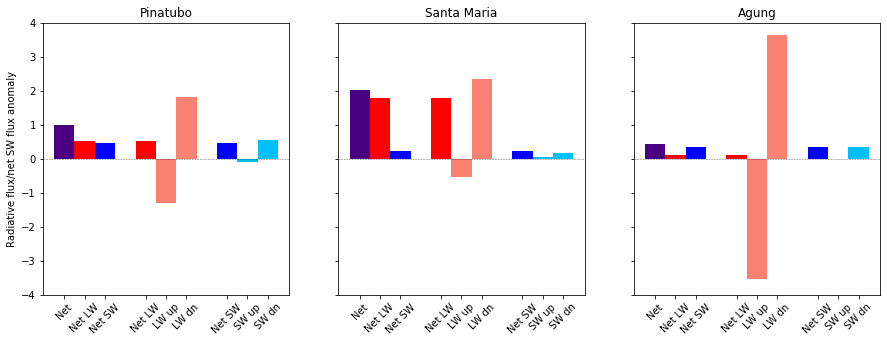

In [198]:
N=3
ind = np.arange(N)
width=0.25


f, ((pin,stm,agu)) = plt.subplots(1,3,figsize=(15,5),sharex='col',sharey='row')

#pinatubo
net = pinatubo_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = pinatubo_lw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = pinatubo_sw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = pinatubo_swup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = pinatubo_swdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwup = pinatubo_lwup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwdn = pinatubo_lwdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])


nets = (net, netLW, netSW)
ups = (netLW, lwup, swup)
dns = (netSW, -lwdn, -swdn)
pin.bar(ind, [net/netSW_toa_p for net in nets], width, color = ['indigo','red','blue'])
pin.bar(ind+width, [up/netSW_toa_p for up in ups], width, color = ['red','salmon','deepskyblue'])
pin.bar(ind+2*width, [dn/netSW_toa_p for dn in dns], width, color = ['blue','salmon','deepskyblue'])
pin.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
pin.set_ylabel('Radiative flux/net SW flux anomaly')
pin.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
pin.set_ylim((-4,4))
pin.title.set_text('Pinatubo')


#st maria 
net = stmaria_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = stmaria_lw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = stmaria_sw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = stmaria_swup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = stmaria_swdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwup = stmaria_lwup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwdn = stmaria_lwdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])


nets = (net, netLW, netSW)
ups = (netLW, lwup, swup)
dns = (netSW, -lwdn, -swdn)
stm.bar(ind, [net/netSW_toa_s for net in nets], width, color = ['indigo','red','blue'])
stm.bar(ind+width, [up/netSW_toa_s for up in ups], width, color = ['red','salmon','deepskyblue'])
stm.bar(ind+2*width, [dn/netSW_toa_s for dn in dns], width, color = ['blue','salmon','deepskyblue'])
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
stm.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
stm.title.set_text('Santa Maria')


#agung
net = agung_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = agung_lw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = agung_sw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = agung_swup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = agung_swdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwup = agung_lwup_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwdn = agung_lwdn_sfc_clr.groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])


nets = (net, netLW, netSW)
ups = (netLW, lwup, swup)
dns = (netSW, -lwdn, -swdn)
agu.bar(ind, [net/netSW_toa_a for net in nets], width, color = ['indigo','red','blue'])
agu.bar(ind+width, [up/netSW_toa_a for up in ups], width, color = ['red','salmon','deepskyblue'])
agu.bar(ind+2*width, [dn/netSW_toa_a for dn in dns], width, color = ['blue','salmon','deepskyblue'])
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.set_xticklabels(['Net','Net LW','Net SW', 'Net LW', 'LW up', 'LW dn', 'Net SW', 'SW up', 'SW dn'],rotation=45)
agu.set_xticks([0,.25,.5,1,1.25,1.5,2,2.25,2.5])
agu.title.set_text('Agung')

#plt.suptitle('Clr Sky Surface Rad Flux Anomalies/TOA netSW anomaly',fontsize=20)
plt.show()
#plt.savefig('clr_sfc_rad_sw_bar.png')

### all in one

In [172]:
def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')


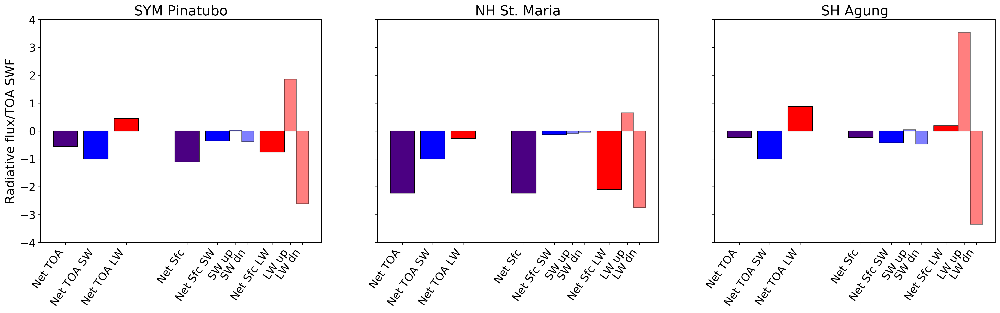

In [181]:

f, ((pin,stm,agu)) = plt.subplots(1,3,figsize=(25,6),sharex='col',sharey='row')


#pinatubo
netTOA = pinatubo_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLWTOA = pinatubo_olr_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSWTOA = pinatubo_sw_toa_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
net = pinatubo_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = pinatubo_lw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = pinatubo_sw_sfc_clr_ms.isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = pinatubo_swup_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = pinatubo_swdn_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwup = pinatubo_lwup_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwdn = pinatubo_lwdn_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

net_toa= (-netTOA,netSWTOA,netLWTOA)
net_sfc = (net, netSW, netLW)
p1 = pin.bar([0,.25,.5],[-net/netSWTOA for net in net_toa], .2, color = ['indigo','blue','red'],edgecolor='k')
p2 = pin.bar([1,1.25,1.7], [-net/netSWTOA for net in net_sfc], .2, color = ['indigo','blue','red'],edgecolor='k')
p3 = pin.bar([1.4,1.5], [-swup/netSWTOA,swdn/netSWTOA], .1, color = 'blue',alpha=.5,edgecolor='k')
p4 = pin.bar([1.85,1.95], [-lwup/netSWTOA,lwdn/netSWTOA], .1, color = 'red',alpha=.5,edgecolor='k')
pin.set_xticklabels(['Net TOA','Net TOA SW','Net TOA LW', 'Net Sfc', 'Net Sfc SW','SW up','SW dn', 'Net Sfc LW','LW up','LW dn'],rotation=55,size=16,ha='right')
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
pin.set_ylabel('Radiative flux/TOA SWF',size=18)
pin.set_xticks([0,.25,.5,1,1.25,1.4,1.5,1.7,1.85,1.95])
pin.set_ylim((-4,4))
pin.tick_params(axis="y", labelsize=16)

pin.set_title('SYM Pinatubo',fontsize=20)

#stmaria
netTOA = stmaria_clr_ms.isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLWTOA = stmaria_olr_clr_ms.isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSWTOA = stmaria_sw_toa_clr_ms.isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
net = stmaria_sfc_clr_ms.isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = stmaria_lw_sfc_clr_ms.isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = stmaria_sw_sfc_clr_ms.isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = stmaria_swup_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = stmaria_swdn_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwup = stmaria_lwup_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwdn = stmaria_lwdn_sfc_clr[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

net_toa= (netTOA,netSWTOA,netLWTOA)
net_sfc = (net, netSW, netLW)
s1 = stm.bar([0,.25,.5],[-net/netSWTOA for net in net_toa], .2, color = ['indigo','blue','red'],edgecolor='k')
s2 = stm.bar([1,1.25,1.7], [-net/netSWTOA for net in net_sfc], .2, color = ['indigo','blue','red'],edgecolor='k')
s3 = stm.bar([1.4,1.5], [-swup/netSWTOA,swdn/netSWTOA], .1, color = 'blue',alpha=.5,edgecolor='k')
s4 = stm.bar([1.85,1.95], [-lwup/netSWTOA,lwdn/netSWTOA], .1, color = 'red',alpha=.5,edgecolor='k')
stm.set_xticklabels(['Net TOA','Net TOA SW','Net TOA LW', 'Net Sfc', 'Net Sfc SW','SW up','SW dn', 'Net Sfc LW','LW up','LW dn'],rotation=55,size=16,ha='right')
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.set_ylabel('')
stm.set_xticks([0,.25,.5,1,1.25,1.4,1.5,1.7,1.85,1.95])
stm.set_ylim((-4,4))
stm.set_title('NH St. Maria',fontsize=20)

#agung
netTOA = agung_clr_ms.isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLWTOA = agung_olr_clr_ms.isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSWTOA = agung_sw_toa_clr_ms.isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
net = agung_sfc_clr_ms.isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW = agung_lw_sfc_clr_ms.isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW = agung_sw_sfc_clr_ms.isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup = agung_swup_sfc_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn = agung_swdn_sfc_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwup = agung_lwup_sfc_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwdn = agung_lwdn_sfc_clr[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

net_toa= (netTOA,netSWTOA,netLWTOA)
net_sfc = (net, netSW, netLW)
a1 = agu.bar([0,.25,.5],[-net/netSWTOA for net in net_toa], .2, color = ['indigo','blue','red'],edgecolor='k')
a2 = agu.bar([1,1.25,1.7], [-net/netSWTOA for net in net_sfc], .2, color = ['indigo','blue','red'],edgecolor='k')
a3 = agu.bar([1.4,1.5], [-swup/netSWTOA,swdn/netSWTOA], .1, color = 'blue',alpha=.5,edgecolor='k')
a4 = agu.bar([1.85,1.95], [-lwup/netSWTOA,lwdn/netSWTOA], .1, color = 'red',alpha=.5,edgecolor='k')
agu.set_xticklabels(['Net TOA','Net TOA SW','Net TOA LW', 'Net Sfc', 'Net Sfc SW','SW up','SW dn', 'Net Sfc LW','LW up','LW dn'],rotation=55,size=16,ha='right')
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.set_ylabel('')
agu.set_xticks([0,.25,.5,1,1.25,1.4,1.5,1.7,1.85,1.95])
agu.set_ylim((-4,4))
agu.set_title('SH Agung',fontsize=20)

#positive down

#plt.savefig('clr_rad_sw_bar.png',bbox_inches='tight')

## All-sky

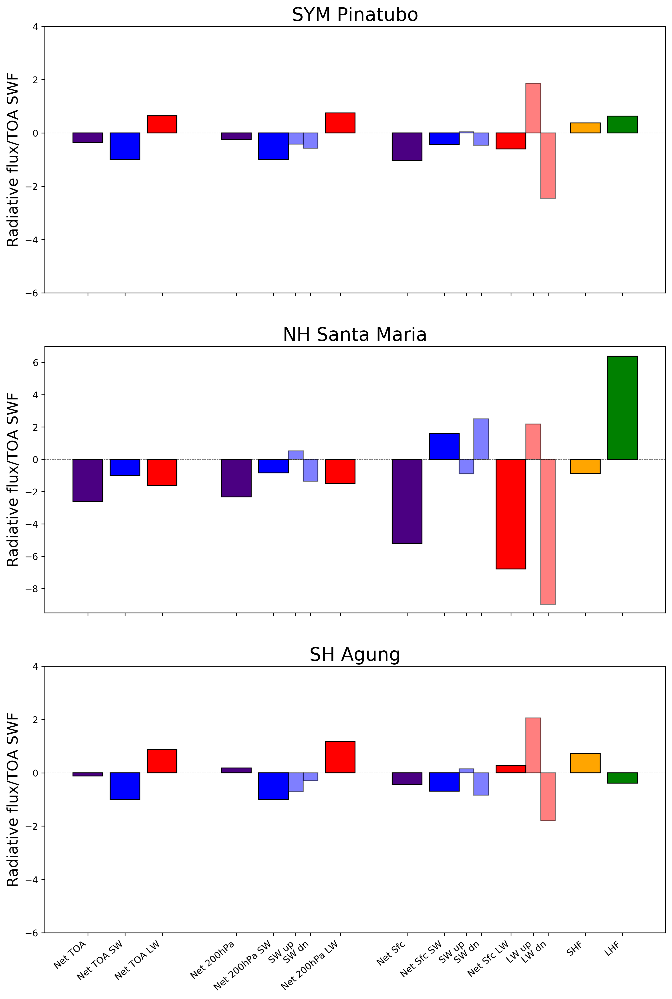

In [187]:
f, ((pin,stm,agu)) = plt.subplots(3,1,figsize=(12,18),sharex='col',sharey='row')

#pinatubo
netTOA = (-1)*pinatubo_toa_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLWTOA = pinatubo_olr_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSWTOA = pinatubo_sw_toa_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

net200 = pinatubo_netrad_200hPa_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW200 = pinatubo_netlw_200hPa_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW200 = pinatubo_sw_200hPa_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup200 = pinatubo_swup_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn200 = pinatubo_swdn_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

netSFC = pinatubo_sfc_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLWSFC = pinatubo_lw_sfc_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSWSFC = pinatubo_sw_sfc_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swupSFC = pinatubo_swup_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdnSFC = pinatubo_swdn_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwupSFC = pinatubo_lwup_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwdnSFC = pinatubo_lwdn_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

shflxSFC = pinatubo_shflx_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lhflxSFC = pinatubo_lhflx_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW_toa_p = pinatubo_sw_toa_ms.isel(lon=(pinatubo_toa.lon<=10)|(pinatubo_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

net_toa = (netTOA, netSWTOA, netLWTOA)
net_200= (net200,netSW200,netLW200)
net_sfc = (netSFC, netSWSFC, netLWSFC)
pin.bar([0,.25,.5],[-(net/netSW_toa_p) for net in net_toa], .2, color = ['indigo','blue','red'],edgecolor='k')
pin.bar([1,1.25,1.7], [-(net/netSW_toa_p) for net in net_200], .2, color = ['indigo','blue','red'],edgecolor='k')
pin.bar([1.4,1.5], [-(swup200/netSW_toa_p),swdn200/netSW_toa_p], .1, color = 'blue',alpha=.5,edgecolor='k')

pin.bar([2.15,2.4,2.85], [-(net/netSW_toa_p) for net in net_sfc], .2, color = ['indigo','blue','red'],edgecolor='k')

pin.bar([2.55,2.65], [-(swupSFC/netSW_toa_p),swdnSFC/netSW_toa_p], .1, color = 'blue',alpha=.5,edgecolor='k')
pin.bar([3,3.1], [-lwupSFC/netSW_toa_p,lwdnSFC/netSW_toa_p], .1, color = 'red',alpha=.5,edgecolor='k')

pin.bar([3.35,3.6],[-shflxSFC/netSW_toa_p,-lhflxSFC/netSW_toa_p],.2,color = ['orange','g'],edgecolor='k')

pin.set_xticklabels(['Net TOA','Net TOA SW','Net TOA LW', 'Net 200hPa', 'Net 200hPa SW','SW up','SW dn', 'Net 200hPa LW', 'Net Sfc', 'Net Sfc SW','SW up','SW dn', 'Net Sfc LW','LW up','LW dn','SHF','LHF'],rotation=40,ha='right')
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
pin.set_ylabel('Radiative flux/TOA SWF',fontsize=16)
pin.set_xticks([0,.25,.5,1,1.25,1.4,1.5,1.7,2.15,2.4,2.55,2.65,2.85,3,3.1,3.35,3.6])
pin.set_ylim((-6,4))
pin.set_title('SYM Pinatubo',fontsize=20)


#stmaria
netTOA = (-1)*stmaria_toa_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLWTOA = stmaria_olr_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSWTOA = stmaria_sw_toa_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

net200 = stmaria_netrad_200hPa_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW200 = stmaria_netlw_200hPa_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW200 = stmaria_sw_200hPa_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup200 = stmaria_swup_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn200 = stmaria_swdn_200hPa[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

netSFC = stmaria_sfc_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLWSFC = stmaria_lw_sfc_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSWSFC = stmaria_sw_sfc_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swupSFC = stmaria_swup_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdnSFC = stmaria_swdn_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwupSFC = stmaria_lwup_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwdnSFC = stmaria_lwdn_sfc[:,12:].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

shflxSFC = stmaria_shflx_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lhflxSFC = stmaria_lhflx_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW_toa_s = stmaria_sw_toa_ms.isel(lon=(stmaria_toa.lon<=10)|(stmaria_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

net_toa = (netTOA, netSWTOA, netLWTOA)
net_200= (net200,netSW200,netLW200)
net_sfc = (netSFC, netSWSFC, netLWSFC)
stm.bar([0,.25,.5],[-(net/netSW_toa_s) for net in net_toa], .2, color = ['indigo','blue','red'],edgecolor='k')
stm.bar([1,1.25,1.7], [-(net/netSW_toa_s) for net in net_200], .2, color = ['indigo','blue','red'],edgecolor='k')
stm.bar([1.4,1.5], [-swup200/netSW_toa_s,swdn200/netSW_toa_s], .1, color = 'blue',alpha=.5,edgecolor='k')

stm.bar([2.15,2.4,2.85], [-(net/netSW_toa_s) for net in net_sfc], .2, color = ['indigo','blue','red'],edgecolor='k')

stm.bar([2.55,2.65], [-swupSFC/netSW_toa_s,swdnSFC/netSW_toa_s], .1, color = 'blue',alpha=.5,edgecolor='k')
stm.bar([3,3.1], [-lwupSFC/netSW_toa_s,lwdnSFC/netSW_toa_s], .1, color = 'red',alpha=.5,edgecolor='k')

stm.bar([3.35,3.6],[-shflxSFC/netSW_toa_s,-lhflxSFC/netSW_toa_s],.2,color = ['orange','g'],edgecolor='k')

stm.set_xticklabels(['Net TOA','Net TOA SW','Net TOA LW', 'Net 200hPa', 'Net 200hPa SW','SW up','SW dn', 'Net 200hPa LW', 'Net Sfc', 'Net Sfc SW','SW up','SW dn', 'Net Sfc LW','LW up','LW dn','SHF','LHF'],rotation=40,ha='right')
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.set_ylabel('Radiative flux/TOA SWF',fontsize=16)
stm.set_xticks([0,.25,.5,1,1.25,1.4,1.5,1.7,2.15,2.4,2.55,2.65,2.85,3,3.1,3.35,3.6])
stm.set_ylim((-9.5,7))
stm.set_title('NH Santa Maria',fontsize=20)


#agung
netTOA = (-1)*agung_toa_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLWTOA = agung_olr_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSWTOA = agung_sw_toa_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

net200 = agung_netrad_200hPa_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLW200 = agung_netlw_200hPa_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW200 = agung_sw_200hPa_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swup200 = agung_swup_200hPa[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdn200 = agung_swdn_200hPa[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

netSFC = agung_sfc_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netLWSFC = agung_lw_sfc_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSWSFC = agung_sw_sfc_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swupSFC = agung_swup_sfc[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
swdnSFC = agung_swdn_sfc[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwupSFC = agung_lwup_sfc[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lwdnSFC = agung_lwdn_sfc[:,:48].groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

shflxSFC = agung_shflx_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
lhflxSFC = agung_lhflx_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])
netSW_toa_a = agung_sw_toa_ms.isel(lon=(agung_toa.lon<=10)|(agung_toa.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat'])

net_toa = (netTOA, netSWTOA, netLWTOA)
net_200= (net200,netSW200,netLW200)
net_sfc = (netSFC, netSWSFC, netLWSFC)
agu.bar([0,.25,.5],[-(net/netSW_toa_a) for net in net_toa], .2, color = ['indigo','blue','red'],edgecolor='k')
agu.bar([1,1.25,1.7], [-(net/netSW_toa_a) for net in net_200], .2, color = ['indigo','blue','red'],edgecolor='k')
agu.bar([1.4,1.5], [-swup200/netSW_toa_a,swdn200/netSW_toa_a], .1, color = 'blue',alpha=.5,edgecolor='k')

agu.bar([2.15,2.4,2.85], [-(net/netSW_toa_a) for net in net_sfc], .2, color = ['indigo','blue','red'],edgecolor='k')

agu.bar([2.55,2.65], [-swupSFC/netSW_toa_a,swdnSFC/netSW_toa_a], .1, color = 'blue',alpha=.5,edgecolor='k')
agu.bar([3,3.1], [-lwupSFC/netSW_toa_a,lwdnSFC/netSW_toa_a], .1, color = 'red',alpha=.5,edgecolor='k')

agu.bar([3.35,3.6],[-shflxSFC/netSW_toa_a,-lhflxSFC/netSW_toa_a],.2,color = ['orange','g'],edgecolor='k')

agu.set_xticklabels(['Net TOA','Net TOA SW','Net TOA LW', 'Net 200hPa', 'Net 200hPa SW','SW up','SW dn', 'Net 200hPa LW', 'Net Sfc', 'Net Sfc SW','SW up','SW dn', 'Net Sfc LW','LW up','LW dn','SHF','LHF'],rotation=40,ha='right')
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.set_ylabel('Radiative flux/TOA SWF',fontsize=16)
agu.set_xticks([0,.25,.5,1,1.25,1.4,1.5,1.7,2.15,2.4,2.55,2.65,2.85,3,3.1,3.35,3.6])
agu.set_ylim((-6,4))
agu.set_title('SH Agung',fontsize=20)

#positive down
plt.savefig('rad_sw_bar.png',bbox_inches='tight')

### Column convergence 

In [ ]:
net = (agung_sfc_en_ms + agung_toa_ms).isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = (agung_lw_sfc-agung_olr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = (agung_sw_sfc-agung_sw_toa).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netsh = (agung_shflx_ms).isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netlh = (agung_lhflx_ms).isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW, netsh, netlh)
names = ('Net', 'Net LW', 'Net SW', 'Net SH', 'Net LH')
agu.bar(ind, nets, align='center', alpha=0.5)
agu.set_xticks(ind, names)
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.title.set_text('Santa Maria')

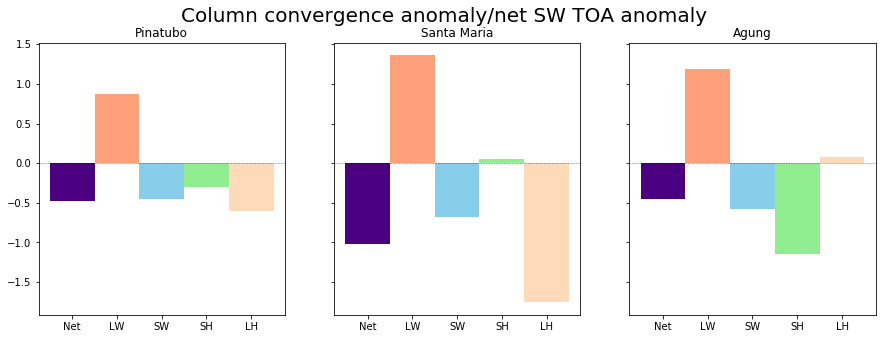

In [171]:
N=5
ind = (0,0.25,.5,.75,1)
width=0.25


f, ((pin,stm,agu)) = plt.subplots(1,3,figsize=(15,5),sharex='col',sharey='row')

#pinatubo
net = (pinatubo_sfc_en_ms + pinatubo_toa_ms).isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = (pinatubo_lw_sfc-pinatubo_olr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = (pinatubo_sw_sfc-pinatubo_sw_toa).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netsh = (pinatubo_shflx_ms).isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netlh = (pinatubo_lhflx_ms).isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW, netsh, netlh)
names = ('Net', 'LW', 'SW', 'SH', 'LH')
colors = ('indigo','lightsalmon','skyblue','lightgreen','peachpuff')
pin.bar(ind, [net/netSW_toa_p for net in nets], width, color=colors)
pin.set_xticks(ind)
pin.set_xticklabels(names)
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
#pin.set_ylabel('Atmospheric Convergence Anomaly/ ')
pin.title.set_text('Pinatubo')


#st maria 
net = (stmaria_sfc_en_ms + stmaria_toa_ms).isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = (stmaria_lw_sfc-stmaria_olr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = (stmaria_sw_sfc-stmaria_sw_toa).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netsh = (stmaria_shflx_ms).isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netlh = (stmaria_lhflx_ms).isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW, netsh, netlh)
stm.bar(ind, [net/netSW_toa_s for net in nets], width, color=colors)
stm.set_xticks(ind)
stm.set_xticklabels(names)
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.title.set_text('Santa Maria')


#agung
net = (agung_sfc_en_ms + agung_toa_ms).isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = (agung_lw_sfc-agung_olr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = (agung_sw_sfc-agung_sw_toa).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netsh = (agung_shflx_ms).isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netlh = (agung_lhflx_ms).isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW, netsh, netlh)
agu.bar(ind, [net/netSW_toa_a for net in nets], width, color=colors)
agu.set_xticks(ind)
agu.set_xticklabels(names)
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.title.set_text('Agung')

plt.suptitle('Column convergence anomaly/net SW TOA anomaly',fontsize=20)
plt.show()

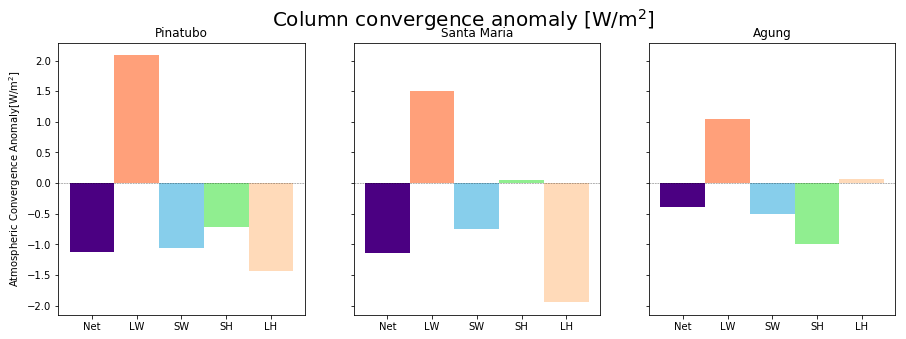

In [173]:
N=5
#ind = np.arange(N)
#width=0.2


f, ((pin,stm,agu)) = plt.subplots(1,3,figsize=(15,5),sharex='col',sharey='row')

#pinatubo
net = (pinatubo_sfc_en_ms + pinatubo_toa_ms).isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = (pinatubo_lw_sfc-pinatubo_olr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = (pinatubo_sw_sfc-pinatubo_sw_toa).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netsh = (pinatubo_shflx_ms).isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netlh = (pinatubo_lhflx_ms).isel(lon=(pinatubo_toa_clr.lon<=10)|(pinatubo_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW, netsh, netlh)
names = ('Net', 'LW', 'SW', 'SH', 'LH')
#colors = ('indigo','red','blue','g','orange')
alphas = (1,0.6,0.6,0.6,0.6)
pin.bar(ind, nets, width, color=colors)
pin.set_xticks(ind)
pin.set_xticklabels(names)
pin.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
pin.set_ylabel('Atmospheric Convergence Anomaly[W/m$^2$]')
pin.title.set_text('Pinatubo')


#st maria 
net = (stmaria_sfc_en_ms + stmaria_toa_ms).isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = (stmaria_lw_sfc-stmaria_olr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = (stmaria_sw_sfc-stmaria_sw_toa).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netsh = (stmaria_shflx_ms).isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netlh = (stmaria_lhflx_ms).isel(lon=(stmaria_toa_clr.lon<=10)|(stmaria_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW, netsh, netlh)
stm.bar(ind, nets, width, color=colors)
stm.set_xticks(ind)
stm.set_xticklabels(names)
stm.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
stm.title.set_text('Santa Maria')


#agung
net = (agung_sfc_en_ms + agung_toa_ms).isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netLW = (agung_lw_sfc-agung_olr).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netSW = (agung_sw_sfc-agung_sw_toa).groupby('time.month').mean(['time','en']).sel(month=slice(6,10)).mean('month').isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netsh = (agung_shflx_ms).isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
netlh = (agung_lhflx_ms).isel(lon=(agung_toa_clr.lon<=10)|(agung_toa_clr.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

nets = (net, netLW, netSW, netsh, netlh)
agu.bar(ind, nets, width, color=colors)
agu.set_xticks(ind)
agu.set_xticklabels(names)
agu.axhline(y=0,linestyle='--',c='k',alpha=0.6,lw=0.5)
agu.title.set_text('Agung')

plt.suptitle('Column convergence anomaly [W/m$^2$]',fontsize=20)
plt.show()

# Surface Temperature

In [200]:
pinatubo_tsurf = xr.open_dataarray('/tigress/tessj/data/Pinatubo_PI_ens_noleap.atmos_month.t_surf.nc/') 
stmaria_tsurf = xr.open_dataarray('/tigress/tessj/data/StMaria_PI_ens_noleap.atmos_month.t_surf.nc/') 
agung_tsurf = xr.open_dataarray('/tigress/tessj/data/Agung_PI_ens_noleap.atmos_month.t_surf.nc/')
ctl_tsurf = xr.open_dataarray('/tigress/tessj/data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.t_surf.nc/') 

# subtract ctl
ctl_tsurf['time']=pinatubo_tsurf['time']
pinatubo_tsurf = pinatubo_tsurf - ctl_tsurf

ctl_tsurf['time']=stmaria_tsurf['time']
stmaria_tsurf = stmaria_tsurf - ctl_tsurf

ctl_tsurf['time']=agung_tsurf['time']
agung_tsurf = agung_tsurf - ctl_tsurf

In [259]:
pvalue=[0,0,0]

pinatubo_tsurf_ms = pinatubo_tsurf[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(pinatubo_tsurf_ms, 0)
pinatubo_tsurf_ms=pinatubo_tsurf_ms.mean('en').load()
pvalue[0] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])


stmaria_tsurf_ms = stmaria_tsurf[:,12:].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(stmaria_tsurf_ms, 0)
stmaria_tsurf_ms=stmaria_tsurf_ms.mean('en').load()
pvalue[1] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])

agung_tsurf_ms = agung_tsurf[:,:48].groupby('time.month').mean(['time']).sel(month=slice(6,10)).mean('month')
tt, pp = ttest_1samp(agung_tsurf_ms, 0)
agung_tsurf_ms=agung_tsurf_ms.mean('en').load()
pvalue[2] = xr.DataArray(pp, dims=pinatubo_clr_ms.dims, coords=[pinatubo_clr_ms[dim] for dim in list(pinatubo_clr_ms.dims)])


In [190]:
sfc_temps = [pinatubo_tsurf_ms, stmaria_tsurf_ms, agung_tsurf_ms]
sfc_temps = [a.isel(lon=(pinatubo_tsurf.lon<=10)|(pinatubo_tsurf.lon>=340)).sel(lat=slice(10,20)).where(land_mask>.9,drop=True).mean(['lon','lat']) for a in sfc_temps]
sfc_temps
        

[<xarray.DataArray 't_surf' ()>
 array(-0.5279664, dtype=float32), <xarray.DataArray 't_surf' ()>
 array(-0.11863032, dtype=float32), <xarray.DataArray 't_surf' ()>
 array(-0.52701396, dtype=float32)]

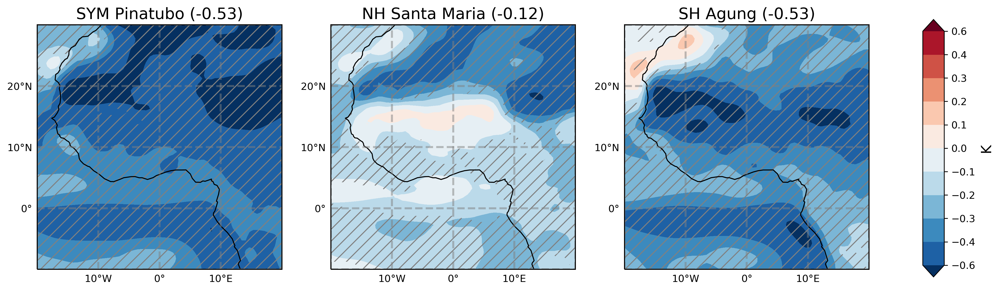

In [260]:
fig = plt.figure(figsize=(15,6))
plt.rcParams['hatch.color'] = 'grey'
levels=[-0.6,-.4,-.3,-.2,-.1,0,.1,.2,.3,.4,.6]

ax1=plt.subplot(1,3,1,projection=ccrs.PlateCarree())
ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(pinatubo_tsurf_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, center=0,levels=levels, extend='both', add_labels=False, cmap='RdBu_r', add_colorbar=False)
shift_longitude(pvalue[0].where(pvalue[0]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax1,colors='None', hatches=['//'], add_colorbar=False, add_labels=False)
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('SYM Pinatubo (%.2f)'%sfc_temps[0],fontsize=16)

ax2=plt.subplot(1,3,2,projection=ccrs.PlateCarree())
ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
shift_longitude(stmaria_tsurf_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, center=0,levels=levels, extend='both',add_labels=False, cmap='RdBu_r',add_colorbar=False)
shift_longitude(pvalue[1].where(pvalue[1]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax2,colors='None', hatches=['//'], add_colorbar=False, add_labels=False)
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('NH Santa Maria (%.2f)'%sfc_temps[1],fontsize=16)

ax3=plt.subplot(1,3,3,projection=ccrs.PlateCarree())
ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
im = shift_longitude(agung_tsurf_ms).rolling(lon=5, min_periods=1, center=True).mean().rolling(lat=5, min_periods=1, center=True).mean().plot.contourf(robust=True, center=0,levels=levels, extend='both', add_labels=False, cmap='RdBu_r',add_colorbar=False)
shift_longitude(pvalue[2].where(pvalue[2]<0.05).pipe(lambda x:x*0)).plot.contourf(ax=ax3,colors='None',hatches=['//'], add_colorbar=False, add_labels=False)
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('SH Agung (%.2f)'%sfc_temps[2],fontsize=16)

ax = fig.add_axes((.95,.2,.02,.6))
plt.colorbar(im,ticks=levels,cax=ax,orientation='vertical').set_label(label='K',size=14)
#plt.tight_layout(rect=(0,0,.9,1))

#plt.suptitle('MS Surface Temperature anomaly [K]',fontsize=20,fontweight='bold')
plt.savefig('tsurf_smooth.png', bbox_inches='tight')

Text(0.5,0.98,'MS Surface Temperature anomaly [K]')

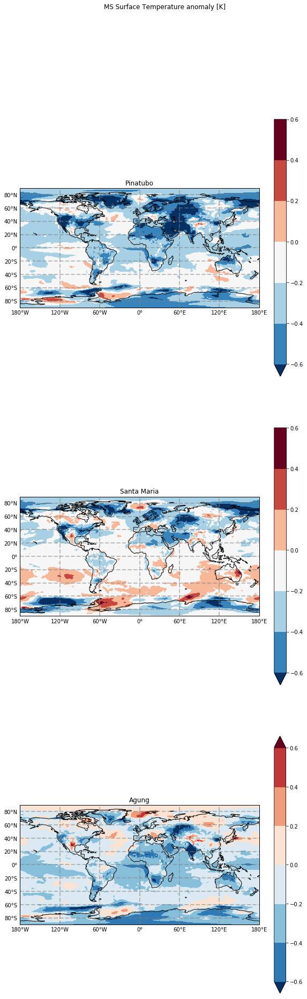

In [289]:
plt.figure(figsize=(10,30))

ax1=plt.subplot(3,1,1,projection=ccrs.PlateCarree())
#ax1.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
pinatubo_tsurf_ms.plot.contourf(robust=True, center=0,vmin=-0.6,vmax=0.6, add_labels=False, cmap='RdBu_r')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
#gl.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
#gl.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines()
plt.title('Pinatubo')

ax2=plt.subplot(3,1,2,projection=ccrs.PlateCarree())
#ax2.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
stmaria_tsurf_ms.plot.contourf(robust=True, center=0,vmin=-0.6,vmax=0.6, add_labels=False, cmap='RdBu_r')
g2=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g2.xlabels_top=False
g2.ylabels_right=False
g2.xformatter=LONGITUDE_FORMATTER
g2.yformatter=LATITUDE_FORMATTER
#g2.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
#g2.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 
plt.title('Santa Maria')

ax3=plt.subplot(3,1,3,projection=ccrs.PlateCarree())
#ax3.set_extent([-20, 20, -10, 30], ccrs.PlateCarree())
agung_tsurf_ms.plot.contourf(robust=True, center=0,vmin=-0.6,vmax=0.6, add_labels=False, cmap='RdBu_r')
g3=ax3.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
g3.xlabels_top=False
g3.ylabels_right=False
g3.xformatter=LONGITUDE_FORMATTER
g3.yformatter=LATITUDE_FORMATTER
#g3.xlocator = mticker.FixedLocator([-20, -10, 0, 10, 20])
#g3.ylocator = mticker.FixedLocator([-10, 0, 10, 20, 30])
ax3.add_feature(cfeature.LAND, facecolor='0.75')
ax3.coastlines() 
plt.title('Agung')

plt.suptitle('MS Surface Temperature anomaly [K]')
#plt.savefig('tsurf_glob.png')

Text(0.5,1,'Monthly Surface Temperature anomaly climatology in Sahel, 5-year average')

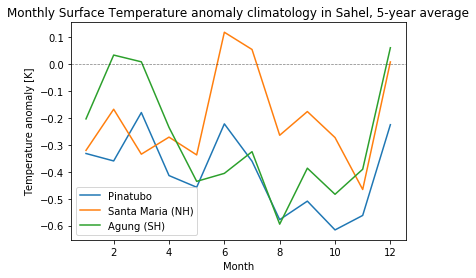

In [284]:
pinatubo_tsurf_s=pinatubo_tsurf.mean('en').isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
stmaria_tsurf_s=stmaria_tsurf.mean('en').isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])
agung_tsurf_s=agung_tsurf.mean('en').isel(lon=(pinatubo_stab.lon<=10)|(pinatubo_stab.lon>=340)).sel(lat=slice(10,20)).mean(['lon','lat'])

p_clim = pinatubo_tsurf_s.groupby('time.month').mean('time')
s_clim = stmaria_tsurf_s.groupby('time.month').mean('time')
a_clim = agung_tsurf_s.groupby('time.month').mean('time')

plt.plot(p_clim.month, p_clim, label='Pinatubo')
plt.plot(s_clim.month, s_clim, label='Santa Maria (NH)')
plt.plot(a_clim.month, a_clim, label='Agung (SH)')
plt.legend()
plt.axhline(0, c='k', linestyle='--', alpha=0.5, lw = 0.7)
plt.xlabel('Month')
plt.ylabel('Temperature anomaly [K]')
plt.title('Monthly Surface Temperature anomaly climatology in Sahel, 5-year average')




# TC tracks

In [2]:
pinatubo_tracks = xr.open_dataset('/tigress/tessj/data/pinatubo_tracks_NA.nc/') 
stmaria_tracks = xr.open_dataset('/tigress/tessj/data/stmaria_tracks_NA.nc/') 
agung_tracks = xr.open_dataset('/tigress/tessj/data/agung_tracks_NA.nc/')
ctl_tracks = xr.open_dataset('/tigress/tessj/data/ctl_tracks_NA.nc/') 
pinatubo_tracks = xr.Dataset.to_dataframe(pinatubo_tracks)
stmaria_tracks = xr.Dataset.to_dataframe(stmaria_tracks)
agung_tracks = xr.Dataset.to_dataframe(agung_tracks)
ctl_tracks = xr.Dataset.to_dataframe(ctl_tracks)

In [12]:
pinatubo_tracks

LON    LAT   WIND      SLP    YEAR  MONTH  \
XCOUNT YENS YRT    ZSTORM1                                                 
1.0    1.0  1991.0 1.0      282.95  30.76  14.98  1007.48  1989.0    3.0   
                   2.0      342.61  13.76  10.37  1006.44  1989.0    8.0   
                   3.0      321.29  11.63  10.85  1009.78  1989.0    9.0   
                   4.0      333.04  15.24  13.93  1006.42  1989.0    9.0   
                   5.0      342.92  13.08  13.52  1005.76  1989.0    9.0   
            1992.0 1.0      348.67  18.65  11.31  1005.92  1990.0    8.0   
                   2.0      292.71  21.35  17.58  1009.67  1990.0    9.0   
            1993.0 1.0      312.31  22.57  18.47  1007.20  1991.0    1.0   
                   2.0      327.28   7.63  20.77  1006.82  1991.0    7.0   
                   3.0      327.96  12.39  12.32  1010.72  1991.0    8.0   
                   4.0      338.53  14.08  10.26  1004.43  1991.0    8.0   
                   5.0      332.99  13.69  11.76  1006.42  1991.0    9.0   
            1994.0 1.0      280.49  28.76  13.78  1010.83  1992.0    1.0   
                   2.0      285.26  25.19  15.34  1007.38  1992.0    2.0   
                   3.0      298.34  22.07  14.69  1008.21  1992.0    9.0   
            1995.0 1.0      298.07  27.17  15.83  1010.27  1993.0   10.0   
                   2.0      299.00  21.75  21.65  1002.21  1993.0   11.0   
       2.0  1991.0 1.0      342.19  13.82  11.44  1002.54  1989.0    7.0   
                   2.0      330.83  11.71  12.13  1007.70  1989.0    8.0   
                   3.0      351.05  16.53   8.22  1004.51  1989.0    8.0   
                   4.0      309.93  13.93  14.01  1007.02  1989.0    8.0   
            1992.0 1.0      340.50  12.26  11.80  1005.98  1990.0    9.0   
            1993.0 1.0      319.11  12.24  15.43  1010.88  1991.0    8.0   
                   2.0      335.31  12.08  13.62  1008.37  1991.0    8.0   
                   3.0      324.33  12.00  13.21  1007.33  1991.0    9.0   
                   4.0      334.81  11.60  13.32  1006.70  1991.0    9.0   
                   5.0      339.59  12.61  13.65  1005.84  1991.0   10.0   
                   6.0      281.91  12.75  12.32  1006.02  1991.0   10.0   
            1994.0 1.0      283.48  34.60  13.45  1010.23  1992.0    2.0   
                   2.0      337.72  11.19  15.53  1005.90  1992.0    7.0   
...                            ...    ...    ...      ...     ...    ...   
97.0   16.0 1991.0 3.0      350.97  67.73  24.11   976.02  1989.0   10.0   
       21.0 1993.0 2.0      358.36  60.18  14.70   984.98  1991.0    9.0   
       25.0 1991.0 4.0      341.29  65.45  20.12   993.84  1989.0    9.0   
       27.0 1991.0 2.0      270.85  29.45  12.93  1010.38  1989.0    9.0   
98.0   13.0 1991.0 5.0      339.41  50.74  20.25   977.23  1989.0   10.0   
       16.0 1991.0 3.0      351.53  68.94  23.38   977.05  1989.0   10.0   
       21.0 1993.0 2.0      359.30  60.86  14.94   987.68  1991.0    9.0   
       25.0 1991.0 4.0      334.65  62.28  12.70   999.33  1989.0    9.0   
99.0   13.0 1991.0 5.0      340.42  51.34  19.79   978.69  1989.0   10.0   
       16.0 1991.0 3.0      351.89  70.39  22.76   977.86  1989.0   10.0   
       21.0 1993.0 2.0      359.95  61.82  13.19   989.67  1991.0    9.0   
100.0  13.0 1991.0 5.0      341.22  51.65  19.45   981.08  1989.0   10.0   
       16.0 1991.0 3.0      349.16  71.37  20.45   979.82  1989.0   10.0   
       21.0 1993.0 2.0      360.31  62.36  11.73   991.07  1991.0    9.0   
101.0  13.0 1991.0 5.0      342.26  51.67  20.77   982.80  1989.0   10.0   
       16.0 1991.0 3.0      346.09  71.95  12.86   980.97  1989.0   10.0   
       21.0 1993.0 2.0      361.56  62.73  11.87   991.99  1991.0    9.0   
102.0  13.0 1991.0 5.0      344.12  51.49  19.66   986.49  1989.0   10.0   
       21.0 1993.0 2.0      362.81  63.39  11.67   993.50  1991.0    9.0   
103.0  13.0 1991.0 5.0      346.29  51.61  19.46   989.58  1989.0   10.0   
   

In [3]:


pinatubo_tracks = pinatubo_tracks.dropna(how='all')
stormf = pinatubo_tracks.reset_index()[["YENS","YRT", "ZSTORM1"]].drop_duplicates()
stormf.insert(0,"Count",range(1,len(stormf)+1))
flattracks = pinatubo_tracks.reset_index()
flattracks = flattracks.merge(stormf, on = ["YENS","YRT", "ZSTORM1"])
ft_pinatubo = flattracks.sort_values(['Count'])#['YENS','ZSTORM1'])

stmaria_tracks = stmaria_tracks.dropna(how='all')
stormf = stmaria_tracks.reset_index()[["YENS","YRT", "ZSTORM1"]].drop_duplicates()
stormf.insert(0,"Count",range(1,len(stormf)+1))
flattracks = stmaria_tracks.reset_index()
flattracks = flattracks.merge(stormf, on = ["YENS","YRT", "ZSTORM1"])
ft_stmaria = flattracks.sort_values(['YENS','ZSTORM1'])

agung_tracks = agung_tracks.dropna(how='all')
stormf = agung_tracks.reset_index()[["YENS","YRT", "ZSTORM1"]].drop_duplicates()
stormf.insert(0,"Count",range(1,len(stormf)+1))
flattracks = agung_tracks.reset_index()
flattracks = flattracks.merge(stormf, on = ["YENS","YRT", "ZSTORM1"])
ft_agung = flattracks.sort_values(['YENS','ZSTORM1'])

ctl_tracks = ctl_tracks[ctl_tracks.YEAR >= 11.0]
ctl_tracks = ctl_tracks[ctl_tracks.YEAR <= 15.0]
ctl_tracks = ctl_tracks.dropna(how='all')
stormf = ctl_tracks.reset_index()[["YRT", "ZSTORM1"]].drop_duplicates()
stormf.insert(0,"Count",range(1,len(stormf)+1))
flattracks = ctl_tracks.reset_index()
flattracks = flattracks.merge(stormf, on = ["YRT", "ZSTORM1"])
ft_ctl = flattracks.sort_values('Count')


In [4]:
ft_pinatubo

,XCOUNT,YENS,YRT,ZSTORM1,LON,LAT,WIND,SLP,YEAR,MONTH,DAY,HOUR,WARM,Count
0,1.0,1.0,1991.0,1.0,282.95,30.76,14.98,1007.48,1989.0,3.0,20.0,12.0,-1.00,1
24,25.0,1.0,1991.0,1.0,311.67,52.67,10.07,998.27,1989.0,3.0,26.0,12.0,-1.00,1
23,24.0,1.0,1991.0,1.0,309.56,53.22,9.81,994.93,1989.0,3.0,26.0,6.0,230.10,1
22,23.0,1.0,1991.0,1.0,307.87,53.99,11.81,992.82,1989.0,3.0,26.0,0.0,230.31,1
21,22.0,1.0,1991.0,1.0,306.83,54.73,12.97,989.16,1989.0,3.0,25.0,18.0,230.48,1
19,20.0,1.0,1991.0,1.0,306.16,55.34,14.90,983.90,1989.0,3.0,25.0,6.0,231.12,1
18,19.0,1.0,1991.0,1.0,305.73,55.46,13.67,982.97,1989.0,3.0,25.0,0.0,231.89,1
17,18.0,1.0,1991.0,1.0,305.45,55.55,20.31,981.64,1989.0,3.0,24.0,18.0,232.36,1
16,17.0,1.0,1991.0,1.0,305.71,55.54,15.82,981.23,1989.0,3.0,24.0,12.0,232.58,1
15,16.0,1.0,1991.0,1.0,306.70,55.52,17.65,980.03,1989.0,3.0,24.0,6.0,232.94,1


In [5]:
# storms per year ? maybe?
print(ft_pinatubo.Count.nunique()/(30.0*5.0))
print(ft_stmaria.Count.nunique()/(30.0*5.0))
print(ft_agung.Count.nunique()/(30.0*5.0))
print(ft_ctl.Count.nunique()/(5.0))

4.0
3.566666666666667
4.433333333333334
4.0


In [6]:
# PINATUBO
#make dataset ft_storms for static veg with storm count, genesis lat/long, lysis lat/long, max wind lat/long, max wind value, and year
count = []
lat_gen = []
long_gen = []
lat_lys = []
long_lys = []
lat_max = []
long_max = []
wind_max = []
year = []
month = []
day = []
n = 1
ft = ft_pinatubo.reset_index(drop=True)
for index, row in ft.iterrows():
    if ft.Count[index]==n:
        ft_single = ft[ft.Count==n]
        count.append(ft_single.Count.iat[0])
        lat_gen.append(ft_single.LAT.iat[0])
        long_gen.append(ft_single.LON.iat[0])
        lat_lys.append(ft_single.LAT.iat[-1])
        long_lys.append(ft_single.LON.iat[-1])
        year.append(ft_single.YEAR.iat[0])
        month.append(ft_single.MONTH.iat[0])
        day.append(ft_single.DAY.iat[0])
        i = ft_single['WIND'].idxmax()
        wind_max.append(ft.WIND.iat[i])
        lat_max.append(ft.LAT.iat[i])
        long_max.append(ft.LON.iat[i])
        n += 1
    if not (n in ft.Count.values):
        n += 1
index = list(range(0,len(count)))
Count = xr.DataArray(count, coords=[index], dims=['index'])
Lat_gen = xr.DataArray(lat_gen, coords=[index], dims=['index'])
Long_gen = xr.DataArray(long_gen, coords=[index], dims=['index'])
Lat_lys = xr.DataArray(lat_lys, coords=[index], dims=['index'])
Long_lys = xr.DataArray(long_lys, coords=[index], dims=['index'])
Lat_max = xr.DataArray(lat_max, coords=[index], dims=['index'])
Long_max = xr.DataArray(long_max, coords=[index], dims=['index'])
Wind_max = xr.DataArray(wind_max, coords=[index], dims=['index'])
Year = xr.DataArray(year, coords=[index], dims=['index'])
Month = xr.DataArray(month, coords=[index], dims=['index'])
Day = xr.DataArray(day, coords=[index], dims=['index'])

ft_storms_p = xr.merge([xr.DataArray(Count, name='Count'), xr.DataArray(Lat_gen, name='Lat_gen'), 
                          xr.DataArray(Long_gen, name='Long_gen'), xr.DataArray(Lat_lys, name='Lat_lys'), 
                          xr.DataArray(Long_lys, name='Long_lys'), xr.DataArray(Lat_max, name='Lat_max'),
                         xr.DataArray(Long_max, name='Long_max'),xr.DataArray(Wind_max, name='Wind_max'),
                          xr.DataArray(Year, name='Year'), xr.DataArray(Month, name='Month'), 
                          xr.DataArray(Day, name='Day')])
                          
#in case we ever want to cluster - use these vars                          
ft_storms_p = xr.Dataset.to_dataframe(ft_storms_p)

In [7]:
# STMARIA
#make dataset ft_storms for static veg with storm count, genesis lat/long, lysis lat/long, max wind lat/long, max wind value, and year
count = []
lat_gen = []
long_gen = []
lat_lys = []
long_lys = []
lat_max = []
long_max = []
wind_max = []
year = []
month = []
day = []
n = 1
ft = ft_stmaria.reset_index(drop=True)
for index, row in ft.iterrows():
    if ft.Count[index]==n:
        ft_single = ft[ft.Count==n]
        count.append(ft_single.Count.iat[0])
        lat_gen.append(ft_single.LAT.iat[0])
        long_gen.append(ft_single.LON.iat[0])
        lat_lys.append(ft_single.LAT.iat[-1])
        long_lys.append(ft_single.LON.iat[-1])
        year.append(ft_single.YEAR.iat[0])
        month.append(ft_single.MONTH.iat[0])
        day.append(ft_single.DAY.iat[0])
        i = ft_single['WIND'].idxmax()
        wind_max.append(ft.WIND.iat[i])
        lat_max.append(ft.LAT.iat[i])
        long_max.append(ft.LON.iat[i])
        n += 1
    if not (n in ft.Count.values):
        n += 1
index = list(range(0,len(count)))
Count = xr.DataArray(count, coords=[index], dims=['index'])
Lat_gen = xr.DataArray(lat_gen, coords=[index], dims=['index'])
Long_gen = xr.DataArray(long_gen, coords=[index], dims=['index'])
Lat_lys = xr.DataArray(lat_lys, coords=[index], dims=['index'])
Long_lys = xr.DataArray(long_lys, coords=[index], dims=['index'])
Lat_max = xr.DataArray(lat_max, coords=[index], dims=['index'])
Long_max = xr.DataArray(long_max, coords=[index], dims=['index'])
Wind_max = xr.DataArray(wind_max, coords=[index], dims=['index'])
Year = xr.DataArray(year, coords=[index], dims=['index'])
Month = xr.DataArray(month, coords=[index], dims=['index'])
Day = xr.DataArray(day, coords=[index], dims=['index'])

ft_storms_s = xr.merge([xr.DataArray(Count, name='Count'), xr.DataArray(Lat_gen, name='Lat_gen'), 
                          xr.DataArray(Long_gen, name='Long_gen'), xr.DataArray(Lat_lys, name='Lat_lys'), 
                          xr.DataArray(Long_lys, name='Long_lys'), xr.DataArray(Lat_max, name='Lat_max'),
                         xr.DataArray(Long_max, name='Long_max'),xr.DataArray(Wind_max, name='Wind_max'),
                          xr.DataArray(Year, name='Year'), xr.DataArray(Month, name='Month'), 
                          xr.DataArray(Day, name='Day')])
                          
#in case we ever want to cluster - use these vars                          
ft_storms_s = xr.Dataset.to_dataframe(ft_storms_s)

In [8]:
# AGUNG
#make dataset ft_storms for static veg with storm count, genesis lat/long, lysis lat/long, max wind lat/long, max wind value, and year
count = []
lat_gen = []
long_gen = []
lat_lys = []
long_lys = []
lat_max = []
long_max = []
wind_max = []
year = []
month = []
day = []
n = 1
ft = ft_agung.reset_index(drop=True)
for index, row in ft.iterrows():
    if ft.Count[index]==n:
        ft_single = ft[ft.Count==n]
        count.append(ft_single.Count.iat[0])
        lat_gen.append(ft_single.LAT.iat[0])
        long_gen.append(ft_single.LON.iat[0])
        lat_lys.append(ft_single.LAT.iat[-1])
        long_lys.append(ft_single.LON.iat[-1])
        year.append(ft_single.YEAR.iat[0])
        month.append(ft_single.MONTH.iat[0])
        day.append(ft_single.DAY.iat[0])
        i = ft_single['WIND'].idxmax()
        wind_max.append(ft.WIND.iat[i])
        lat_max.append(ft.LAT.iat[i])
        long_max.append(ft.LON.iat[i])
        n += 1
    if not (n in ft.Count.values):
        n += 1
index = list(range(0,len(count)))
Count = xr.DataArray(count, coords=[index], dims=['index'])
Lat_gen = xr.DataArray(lat_gen, coords=[index], dims=['index'])
Long_gen = xr.DataArray(long_gen, coords=[index], dims=['index'])
Lat_lys = xr.DataArray(lat_lys, coords=[index], dims=['index'])
Long_lys = xr.DataArray(long_lys, coords=[index], dims=['index'])
Lat_max = xr.DataArray(lat_max, coords=[index], dims=['index'])
Long_max = xr.DataArray(long_max, coords=[index], dims=['index'])
Wind_max = xr.DataArray(wind_max, coords=[index], dims=['index'])
Year = xr.DataArray(year, coords=[index], dims=['index'])
Month = xr.DataArray(month, coords=[index], dims=['index'])
Day = xr.DataArray(day, coords=[index], dims=['index'])

ft_storms_a = xr.merge([xr.DataArray(Count, name='Count'), xr.DataArray(Lat_gen, name='Lat_gen'), 
                          xr.DataArray(Long_gen, name='Long_gen'), xr.DataArray(Lat_lys, name='Lat_lys'), 
                          xr.DataArray(Long_lys, name='Long_lys'), xr.DataArray(Lat_max, name='Lat_max'),
                         xr.DataArray(Long_max, name='Long_max'),xr.DataArray(Wind_max, name='Wind_max'),
                          xr.DataArray(Year, name='Year'), xr.DataArray(Month, name='Month'), 
                          xr.DataArray(Day, name='Day')])
                          
#in case we ever want to cluster - use these vars                          
ft_storms_a = xr.Dataset.to_dataframe(ft_storms_a)

In [9]:
# PINATUBO
#make dataset ft_storms for static veg with storm count, genesis lat/long, lysis lat/long, max wind lat/long, max wind value, and year
count = []
lat_gen = []
long_gen = []
lat_lys = []
long_lys = []
lat_max = []
long_max = []
wind_max = []
year = []
month = []
day = []
n = 1
ft = ft_ctl.reset_index(drop=True)
for index, row in ft.iterrows():
    if ft.Count[index]==n:
        ft_single = ft[ft.Count==n]
        count.append(ft_single.Count.iat[0])
        lat_gen.append(ft_single.LAT.iat[0])
        long_gen.append(ft_single.LON.iat[0])
        lat_lys.append(ft_single.LAT.iat[-1])
        long_lys.append(ft_single.LON.iat[-1])
        year.append(ft_single.YEAR.iat[0])
        month.append(ft_single.MONTH.iat[0])
        day.append(ft_single.DAY.iat[0])
        i = ft_single['WIND'].idxmax()
        wind_max.append(ft.WIND.iat[i])
        lat_max.append(ft.LAT.iat[i])
        long_max.append(ft.LON.iat[i])
        n += 1
    if not (n in ft.Count.values):
        n += 1
index = list(range(0,len(count)))
Count = xr.DataArray(count, coords=[index], dims=['index'])
Lat_gen = xr.DataArray(lat_gen, coords=[index], dims=['index'])
Long_gen = xr.DataArray(long_gen, coords=[index], dims=['index'])
Lat_lys = xr.DataArray(lat_lys, coords=[index], dims=['index'])
Long_lys = xr.DataArray(long_lys, coords=[index], dims=['index'])
Lat_max = xr.DataArray(lat_max, coords=[index], dims=['index'])
Long_max = xr.DataArray(long_max, coords=[index], dims=['index'])
Wind_max = xr.DataArray(wind_max, coords=[index], dims=['index'])
Year = xr.DataArray(year, coords=[index], dims=['index'])
Month = xr.DataArray(month, coords=[index], dims=['index'])
Day = xr.DataArray(day, coords=[index], dims=['index'])

ft_storms_ctl = xr.merge([xr.DataArray(Count, name='Count'), xr.DataArray(Lat_gen, name='Lat_gen'), 
                          xr.DataArray(Long_gen, name='Long_gen'), xr.DataArray(Lat_lys, name='Lat_lys'), 
                          xr.DataArray(Long_lys, name='Long_lys'), xr.DataArray(Lat_max, name='Lat_max'),
                         xr.DataArray(Long_max, name='Long_max'),xr.DataArray(Wind_max, name='Wind_max'),
                          xr.DataArray(Year, name='Year'), xr.DataArray(Month, name='Month'), 
                          xr.DataArray(Day, name='Day')])
                          
#in case we ever want to cluster - use these vars                          
ft_storms_ctl = xr.Dataset.to_dataframe(ft_storms_ctl)

In [1]:
ft_storms_ctl

NameError: name 'ft_storms_ctl' is not defined

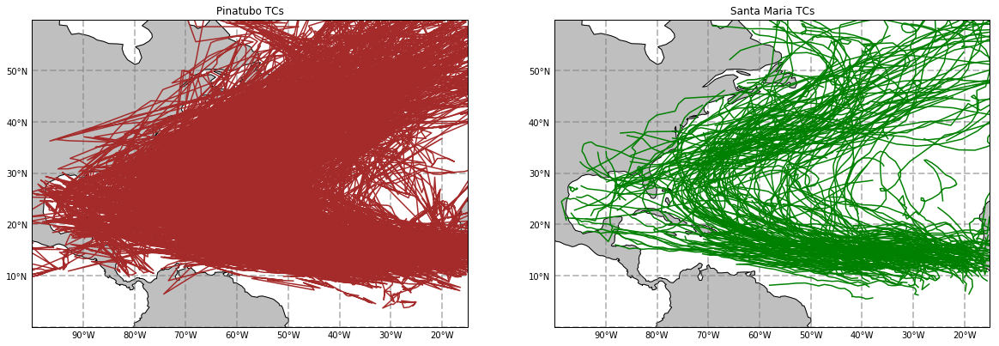

In [11]:
#plot all volc storms and ctl storm

plt.figure(figsize=(20,15))

ax1=plt.subplot(2,2,1,projection=ccrs.PlateCarree())
ax1.set_extent([-100, -15, 0, 60], ccrs.PlateCarree())
plt.title('Pinatubo TCs')
gl=ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax1.add_feature(cfeature.LAND, facecolor='0.75')
ax1.coastlines() 

n = 1
for index, row in ft_pinatubo.iterrows():
    if ft_pinatubo.Count[index]>n:
        n = ft.Count[index]
    if ft_pinatubo.Count[index]==n:
        ft_single = ft_pinatubo[ft_pinatubo.Count==n]
        plt.plot(ft_single.LON,ft_single.LAT,color='brown',transform=ccrs.PlateCarree())
        n += 1


ax2=plt.subplot(2,2,2,projection=ccrs.PlateCarree())
ax2.set_extent([-100, -15, 0, 60], ccrs.PlateCarree())
plt.title('Santa Maria TCs')
gl=ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
gl.xlabels_top=False
gl.ylabels_right=False
gl.xformatter=LONGITUDE_FORMATTER
gl.yformatter=LATITUDE_FORMATTER
ax2.add_feature(cfeature.LAND, facecolor='0.75')
ax2.coastlines() 

n = 1
for index, row in ft_stmaria.iterrows():
    if ft_stmaria.Count[index]>n:
        n = ft_stmaria.Count[index]
    if ft_stmaria.Count[index]==n:
        ft_stmaria_single = ft_stmaria[ft_stmaria.Count==n]
        plt.plot(ft_stmaria_single.LON,ft_stmaria_single.LAT,color='green',transform=ccrs.PlateCarree())
        n += 1

#plt.savefig('static_int_tracks.jpg')